In [1]:
import sys
sys.path.insert(0, '..')

import torch
import os
import wandb
import random
import numpy as np
import torch
from torch import nn
from torch.optim import Adam
from ignite.handlers.param_scheduler import create_lr_scheduler_with_warmup
from torch.utils.data import DataLoader
from datetime import datetime
import matplotlib.pyplot as plt
import pandas as pd
from scipy import stats
from tqdm import tqdm
from matplotlib import cm
import seaborn as sns
import matplotlib.lines as mlines
from sklearn.decomposition import PCA
from PIL import Image
import umap
import torch.nn.functional as F
from scipy.spatial.distance import cdist
from sklearn.neighbors import LocalOutlierFactor
from sklearn.ensemble import IsolationForest
from sklearn.cluster import DBSCAN
import random
import joblib
from scipy.signal import savgol_filter
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, WhiteKernel, Matern, ConstantKernel
from astropy.timeseries import LombScargle
from scipy.interpolate import UnivariateSpline
from scipy.stats import rice
from scipy.stats import lognorm
from tabulate import tabulate

from util.preprocess_data import clip_outliers
from core.dataset import PSMDataset
from core.model import GalSpecNet, MetaModel, Informer, AstroM3
from core.trainer import Trainer

/global/home/users/mariia/miniforge3/envs/astro/lib/python3.10/site-packages/ignite/handlers/checkpoint.py:16: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import ZeroRedundancyOptimizer


In [2]:
CLASSES = ['EW', 'SR', 'EA', 'RRAB', 'EB', 'ROT', 'RRC', 'HADS', 'M', 'DSCT']

METADATA_COLS = [
    'mean_vmag',  'phot_g_mean_mag', 'e_phot_g_mean_mag', 'phot_bp_mean_mag', 'e_phot_bp_mean_mag', 'phot_rp_mean_mag', 'e_phot_rp_mean_mag',
    'bp_rp', 'parallax', 'parallax_error', 'parallax_over_error', 'pmra', 'pmra_error', 'pmdec',
    'pmdec_error', 'j_mag', 'e_j_mag', 'h_mag', 'e_h_mag', 'k_mag', 'e_k_mag', 'w1_mag', 'e_w1_mag',
    'w2_mag', 'e_w2_mag', 'w3_mag', 'w4_mag', 'j_k', 'w1_w2', 'w3_w4', 'pm', 'ruwe', 'l', 'b'
]

PHOTO_COLS = ['amplitude', 'period', 'lksl_statistic', 'rfr_score']

METADATA_FUNC = {
    "abs": [
        "mean_vmag",
        "phot_g_mean_mag",
        "phot_bp_mean_mag",
        "phot_rp_mean_mag",
        "j_mag",
        "h_mag",
        "k_mag",
        "w1_mag",
        "w2_mag",
        "w3_mag",
        "w4_mag",
    ],
    "cos": ["l"],
    "sin": ["b"],
    "log": ["period"]
}

BOOK = ["id", "source_id", "asassn_name", "other_names", "raj2000", "dej2000", "epoch_hjd", "gdr2_id", "allwise_id", "apass_dr9_id", "edr3_source_id", "galex_id", "tic_id"]

LAMOST_DIR = '/home/mariia/AstroML/data/asassn/Spectra/v2'

## Load CLIP pre-trained model

In [3]:
# run_id = 'MeriDK/AstroCLIPResults3/2wz4ysvn'
run_id = 'MeriDK/AstroCLIPOptuna3/nksu4l24'
api = wandb.Api()
run = api.run(run_id)
config = run.config
config['use_wandb'] = False

model = AstroM3(config)
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
model.eval()

weights_path = os.path.join(config['weights_path'] + '-' + run_id.split('/')[-1], f'weights-best.pth')
model.load_state_dict(torch.load(weights_path, weights_only=False))

<All keys matched successfully>

## Create dataset class to be able to use its photo and spectra pre-processing functions

In [4]:
ds = PSMDataset(config)

## Load data 
- **df_org** - original csv file with LC info, load it to get bookmark info
- **df_v** - pre-processed info about LC with no duplicates, no missing LC, no missing metadata, with changed column names
- **df_s** - spectra info not pre-processed, has duplicates
- **scaler** - scaler for metadata and photo aux

In [5]:
df_org = pd.read_csv('/home/mariia/AstroML/data/asassn/asassn_catalog_full.csv')
df_v = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/v.csv')
df_s = pd.read_csv('/home/mariia/AstroML/data/asassn/Spectra/lamost_spec.csv')
scaler = joblib.load('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/scaler.pkl')

/tmp/ipykernel_32797/1418165920.py:1: DtypeWarning: Columns (69) have mixed types. Specify dtype option on import or set low_memory=False.
  df_org = pd.read_csv('/home/mariia/AstroML/data/asassn/asassn_catalog_full.csv')
/global/home/users/mariia/miniforge3/envs/astro/lib/python3.10/site-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.5.1 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [6]:
# change the name column in df_org so it matches df_v
df_org['asassn_name'] = df_org['asassn_name'].apply(lambda x: x.replace(' ', ''))

In [7]:
# drop filename duplicates from spectra df
df_s = df_s.drop_duplicates(subset=['spec_filename'])

## Note the class distribution, we're going to use all of them for this analysis, but during training we used only CLASSES = ['EW', 'SR', 'EA', 'RRAB', 'EB', 'ROT', 'RRC', 'HADS', 'M', 'DSCT']

In [8]:
df_v['target'].value_counts()

target
SR         187835
EW          71647
EA          44747
ROT         33721
RRAB        28581
EB          23143
RRC          9842
M            8872
VAR          8213
ROT:         4599
DSCT         4175
HADS         3954
DCEP         1516
GCAS:         668
CWB           633
CWA           611
DCEPS         541
RRD           482
YSO           382
M:            294
SRD           227
DSCT:         218
LSP           162
RVA           144
UG             71
ELL            46
GCAS           33
UV             30
RCB            30
SXPHE          29
RRAB:          27
ZAND           23
UGSU           20
CV             13
UGSS           12
AM             11
HMXB            8
RCB:            7
CV:             6
PPN             6
UV:             6
R               5
AM+E            5
WR              4
DQ              3
SXARI           3
UGZ             2
UGWZ            2
V838MON         1
SDOR            1
DYPer           1
AM:             1
UGER            1
ZZO             1
Name: count, dtype: i

## Normalize metadata

In [9]:
# this functions is from 028-meta-change.ipynb
def transform(df):
    for transformation_type, value in METADATA_FUNC.items():
        if transformation_type == "abs":
            for col in value:
                df[col] = (
                    df[col] - 10 + 5 * np.log10(np.where(df["parallax"] <= 0, 1, df["parallax"]))
                )
        elif transformation_type == "cos":
            for col in value:
                df[col] = np.cos(np.radians(df[col]))
        elif transformation_type == "sin":
            for col in value:
                df[col] = np.sin(np.radians(df[col]))
        elif transformation_type == "log":
            for col in value:
                df[col] = np.log10(df[col])

In [10]:
# save the period, it'll be used for plots
df_v.loc[:, 'org_period'] = df_v['period']

# do the metadata and photo aux transformations
transform(df_v)

# normalize the metadata and photo aux
cols = METADATA_COLS + PHOTO_COLS
df_v.loc[:, cols] = scaler.transform(df_v[cols])

## Get photometry embeddings for all target_class

In [88]:
eb = {}
target_class = 'M'

for _, el in tqdm(df_v[df_v['target'] == target_class].iterrows(), total=len(df_v[df_v['target'] == target_class])):
    photometry = ds.get_vlc(el['name'])
    photometry, photometry_mask = ds.preprocess_lc(photometry, None, list(el[PHOTO_COLS]))

    photometry, photometry_mask = torch.from_numpy(photometry), torch.from_numpy(photometry_mask)
    photometry, photometry_mask = photometry.unsqueeze(0), photometry_mask.unsqueeze(0)
    photometry, photometry_mask = photometry.to(device), photometry_mask.to(device)
    
    with torch.no_grad():
        p_emb = model.photometry_encoder(photometry, photometry_mask)
        p_emb = model.photometry_proj(p_emb)

    eb[el['name']] = p_emb

100%|████████████████████████████████████████████████████████████████████████| 8872/8872 [02:02<00:00, 72.55it/s]


In [89]:
eb_emb = torch.cat(list(eb.values()), dim=0)
eb_emb = eb_emb.detach().cpu()
eb_emb = eb_emb / eb_emb.norm(dim=-1, keepdim=True)

In [90]:
eb_center = eb_emb.mean(dim=0)
eb_center = eb_center / eb_center.norm(dim=-1, keepdim=True)

In [91]:
cosine_distances = 1 - torch.mm(eb_emb, eb_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_medoid = eb_emb[torch.argmin(distance_sums)]

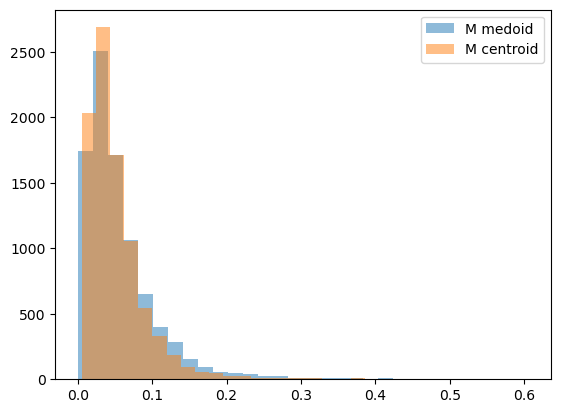

In [92]:
eb_dist_center = 1 - eb_emb @ eb_center
eb_dist_medoid = 1 - eb_emb @ eb_medoid
plt.hist(eb_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} medoid')
plt.hist(eb_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} centroid')
plt.legend()

In [109]:
sum(eb_dist_center > 0.2)

tensor(114)

In [94]:
eb100 = torch.topk(eb_dist_center, 100).indices
eb_names = list(df_v[df_v['target'] == target_class]['name'])
eb_out_names = [eb_names[el] for el in eb100]

## Get metadata embeddings for all target_class

In [95]:
eb_meta = {}

for _, el in tqdm(df_v[df_v['target'] == target_class].iterrows(), total=len(df_v[df_v['target'] == target_class])):
    metadata = el[METADATA_COLS].values.astype(np.float32)
    metadata = torch.tensor(metadata).unsqueeze(0).to(device)
    
    with torch.no_grad():
        m_emb = model.metadata_encoder(metadata)
        m_emb = model.metadata_proj(m_emb)

    eb_meta[el['name']] = m_emb

100%|██████████████████████████████████████████████████████████████████████| 8872/8872 [00:06<00:00, 1439.41it/s]


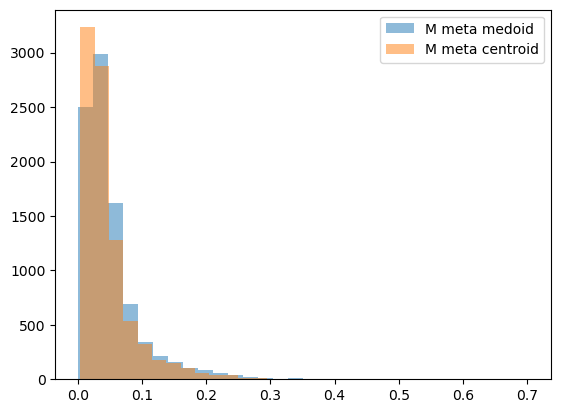

In [96]:
eb_meta_emb = torch.cat(list(eb_meta.values()), dim=0)
eb_meta_emb = eb_meta_emb.detach().cpu()
eb_meta_emb = eb_meta_emb / eb_meta_emb.norm(dim=-1, keepdim=True)

eb_meta_center = eb_meta_emb.mean(dim=0)
eb_meta_center = eb_meta_center / eb_meta_center.norm(dim=-1, keepdim=True)

cosine_distances = 1 - torch.mm(eb_meta_emb, eb_meta_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_meta_medoid = eb_meta_emb[torch.argmin(distance_sums)]

eb_meta_dist_center = 1 - eb_meta_emb @ eb_meta_center
eb_meta_dist_medoid = 1 - eb_meta_emb @ eb_meta_medoid
plt.hist(eb_meta_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} meta medoid')
plt.hist(eb_meta_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} meta centroid')
plt.legend()

In [110]:
sum(eb_meta_dist_center > 0.2)

tensor(153)

In [98]:
eb_meta100 = torch.topk(eb_meta_dist_center, 100).indices
eb_names = list(df_v[df_v['target'] == target_class]['name'])
eb_meta_out_names = [eb_names[el] for el in eb_meta100]

## Meta outliers that are also photo outliers

In [99]:
len(np.intersect1d(eb100.cpu(), eb_meta100.cpu()))

21

## Map spectra to targets

In [100]:
id_to_target = dict(zip(df_v['id'], df_v['target']))
id_to_name = dict(zip(df_v['id'], df_v['name']))

df_s['target'] = df_s['edr3_source_id'].map(id_to_target)
df_s['name'] = df_s['edr3_source_id'].map(id_to_name)

## Note 5.5k NaN

In [101]:
df_s['target'].value_counts(dropna=False)

target
EW       10408
SR        6515
NaN       5552
EA        4889
RRAB      4081
EB        3330
ROT       3206
RRC       1414
HADS       486
DSCT       437
M          404
ROT:       117
LSP        109
DCEP        83
VAR         33
DCEPS       28
SRD         27
CWB         26
RRD         24
CWA         18
DSCT:       15
SXPHE       11
YSO          7
ELL          6
M:           2
UG           1
ZAND         1
UV           1
GCAS:        1
Name: count, dtype: int64

In [102]:
eb_spec = {}

for _, el in tqdm(df_s[df_s['target'] == target_class].iterrows(), total=len(df_s[df_s['target'] == target_class])):

    try:
        spectra = ds.readLRSFits(os.path.join(LAMOST_DIR, el['spec_filename']))
        spectra = ds.preprocess_spectra(spectra)
        spectra = torch.tensor(spectra).unsqueeze(0).to(device)
        
        with torch.no_grad():
            s_emb = model.spectra_encoder(spectra)
            s_emb = model.spectra_proj(s_emb)
    
        eb_spec[el['edr3_source_id']] = s_emb
    except FileNotFoundError:
        print(el['spec_filename'], ' not found')

100%|██████████████████████████████████████████████████████████████████████████| 404/404 [00:19<00:00, 21.24it/s]


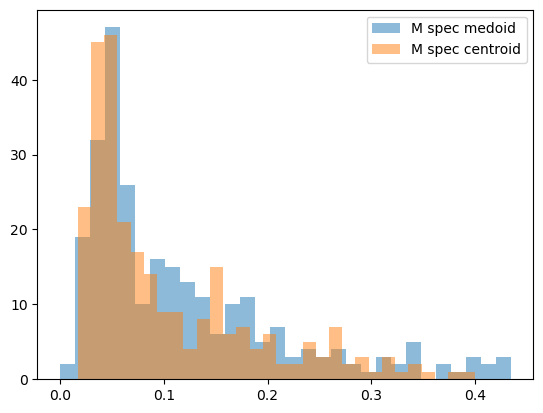

In [103]:
eb_spec_emb = torch.cat(list(eb_spec.values()), dim=0)
eb_spec_emb = eb_spec_emb.detach().cpu()
eb_spec_emb = eb_spec_emb / eb_spec_emb.norm(dim=-1, keepdim=True)

eb_spec_center = eb_spec_emb.mean(dim=0)
eb_spec_center = eb_spec_center / eb_spec_center.norm(dim=-1, keepdim=True)

cosine_distances = 1 - torch.mm(eb_spec_emb, eb_spec_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_spec_medoid = eb_spec_emb[torch.argmin(distance_sums)]

eb_spec_dist_center = 1 - eb_spec_emb @ eb_spec_center
eb_spec_dist_medoid = 1 - eb_spec_emb @ eb_spec_medoid
plt.hist(eb_spec_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} spec medoid')
plt.hist(eb_spec_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} spec centroid')
plt.legend()

In [111]:
sum(eb_spec_dist_center > 0.2)

tensor(39)

In [112]:
eb_spec25 = torch.topk(eb_spec_dist_center, 30).indices

eb_spec_names = list(df_s[df_s['target'] == target_class]['name'])
eb_spec_filename = list(df_s[df_s['target'] == target_class]['spec_filename'])

eb_out_spec_names = [eb_spec_names[el] for el in eb_spec25]
eb_out_spec_filenames = [eb_spec_filename[el] for el in eb_spec25]

## Intersection with outliers from photo and spectra, 1 from meta and spectra

In [113]:
[el for el in eb_out_names if el in eb_out_spec_names]

[]

In [114]:
[el for el in eb_meta_out_names if el in eb_out_spec_names]

[]

## Find the objects that have 2x and 2/3 aliases of 1 sidereal days

In [115]:
photo_alias23 = list(df_v[(df_v['name'].isin(eb_out_names)) & (df_v['org_period'] > 0.66) & (df_v['org_period'] < 0.67)]['name'])
photo_alias2 = list(df_v[(df_v['name'].isin(eb_out_names)) & (df_v['org_period'] > 1.99) & (df_v['org_period'] < 2.0)]['name'])

print(len(photo_alias23), len(photo_alias2))

0 0


## Plots

In [116]:
def plot_spectra(spec_filename, window_length=51, polyorder=3):    
    spectra = ds.readLRSFits(os.path.join(LAMOST_DIR, spec_filename))
    smoothed_spectra = savgol_filter(spectra[:, 1], window_length=window_length, polyorder=polyorder)

    plt.figure(figsize=(6, 5))
    plt.plot(spectra[:, 0], spectra[:, 1], color='gray', alpha=0.4, label='Original Spectra')
    plt.plot(spectra[:, 0], smoothed_spectra, color='blue', linewidth=1.5, label='Smoothed Spectra')
    plt.xlabel('Wavelength (Å)', fontsize=14)
    plt.ylabel('Flux', fontsize=14)
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.title('Spectra', fontsize=16)
    plt.tight_layout()
    plt.show()

In [117]:
def plot_photometry_flux(name, period=None, meta_warning=True):
    try:
        el = df_v[df_v['name'] == name].iloc[0]
        period = period if period else el['org_period']
        dr3_id = el['id']

        print('⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️\n', df_org[df_org['asassn_name'] == name][BOOK], '\n_________________\n')
        print('⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️\n', df_org[df_org['asassn_name'] == name][PHOTO_COLS], '\n_________________\n')
        print('⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️')
        
        with pd.option_context('display.max_columns', None, 'display.max_rows', None):
            print(df_org[df_org['asassn_name'] == name][METADATA_COLS], '\n_________________\n')

        spectra = df_s[df_s['edr3_source_id'] == dr3_id]['spec_filename']
        print(f"⬇️⬇️⬇️ WE HAVE {len(spectra)} SPECTRA FOR THIS OBJECT ⬇️⬇️⬇️\n")

        if meta_warning and name in eb_meta_out_names:
            print('⚠️⚠️⚠️ THIS IS ALSO METADATA OUTLIER ⚠️⚠️⚠️\n')
    
        photometry = ds.get_vlc(name)
        flux_time, flux, flux_err = photometry[:, 0], photometry[:, 1], photometry[:, 2]
        
        phased = (flux_time % period) / period
        phased_i = np.argsort(phased)
        
        phase = phased[phased_i]
        flux = flux[phased_i]
        flux_err = flux_err[phased_i]
        
        phase3 = np.hstack([phase - 1, phase, phase + 1])
        plt.figure(figsize=(8, 5))

        if (flux <= 0).any():
            print('🔴🔴🔴 FLUX HAS ZEROS OR NEGATIVE VALUES. PHOTO PLOT IN FLUX NOT IN MAG 🔴🔴🔴\n')
            
            flux3 = np.hstack([flux, flux, flux])
            flux_err3 = np.hstack([flux_err, flux_err, flux_err])

            plt.errorbar(phase3, flux3, yerr=flux_err3, fmt='.', label='Photometry', alpha=0.4)
            plt.ylabel('Flux', fontsize=14)
        else:
            mag = -2.5 * np.log10(flux)
            dmag = (2.5 / np.log(10)) * (flux_err / flux)
        
            mag3 = np.hstack([mag, mag, mag])
            dmag3 = np.hstack([dmag, dmag, dmag])
    
            plt.errorbar(phase3, mag3, yerr=dmag3, fmt='.', label='Photometry', alpha=0.4)
            plt.ylabel('Magnitude', fontsize=14)
            plt.gca().invert_yaxis()
    
        plt.xlim(-0.5, 1.5)    
        plt.xlabel('Phase', fontsize=14)
        plt.title(f'Photometry ($P_{{\\rm cat}} = {period:.6f}$)', fontsize=14)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        
        plt.suptitle(f"Gaia ID: {dr3_id}      Original Classification: {el['target']}", fontsize=16)
        plt.legend()
        plt.tight_layout()
        plt.show()

        if len(spectra) > 0:
            for el in spectra:
                print(el)

                if el in eb_out_spec_filenames:
                    print('\n💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥\n')
                    
                plot_spectra(el)
    
    except Exception as e:
        print(f"Error occurred while plotting photometry for {name}: {e}")
        plt.close('all')  # Ensure any active plots are removed if an error occurs

# Spectra Outliers Plots

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
230995  34fb319f-0938-5823-bb90-7ad449e547d3    110502   

                        asassn_name           other_names    raj2000  \
230995  ASASSN-VJ070559.66+522838.7  NSVS J0705594+522839  106.49857   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
230995  52.47743  2.457817e+06  9.813543e+17  J070559.57+522838.0   

        apass_dr9_id           edr3_source_id galex_id         tic_id  
230995     6838053.0  EDR3 981354264261147136      NaN  TIC 252939997   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
230995       2.61  240.979248            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
230995      14.89        13.033756           0.028494         15.616789   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

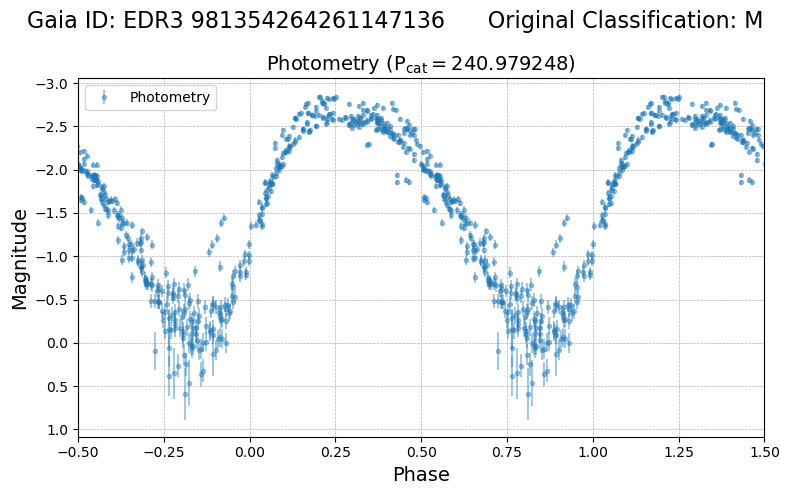

spec-57055-HD070402N511709V01_sp15-142.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



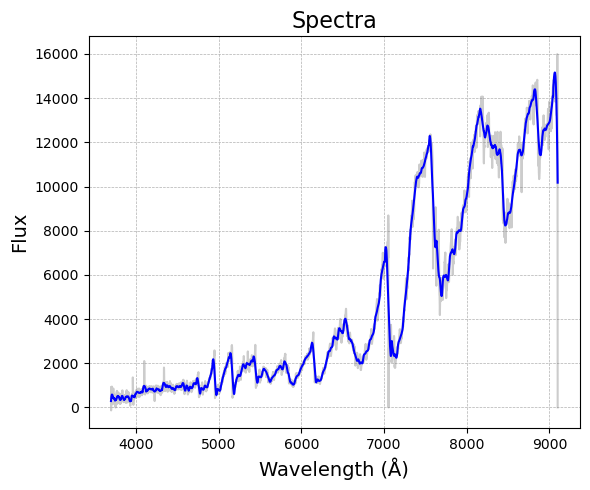

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
48021  b0383683-58d2-592d-97a3-3876b14228e6    468021   

                       asassn_name other_names   raj2000   dej2000  \
48021  ASASSN-VJ060535.05+135854.2         NaN  91.39603  13.98173   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
48021  2.458114e+06  3.345156e+18  J060535.07+135854.0    24181693.0   

                 edr3_source_id galex_id         tic_id  
48021  EDR3 3345156134851679232      NaN  TIC 151285611   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
48021        2.8   249.0            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
48021      15.27        12.894555           0.047848         15.967631   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
48021            0.377862

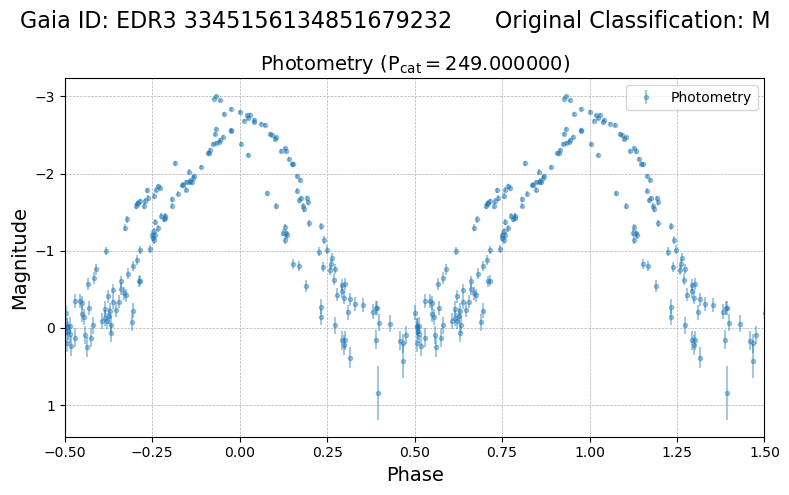

spec-57392-GAC092N13M1_sp03-114.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



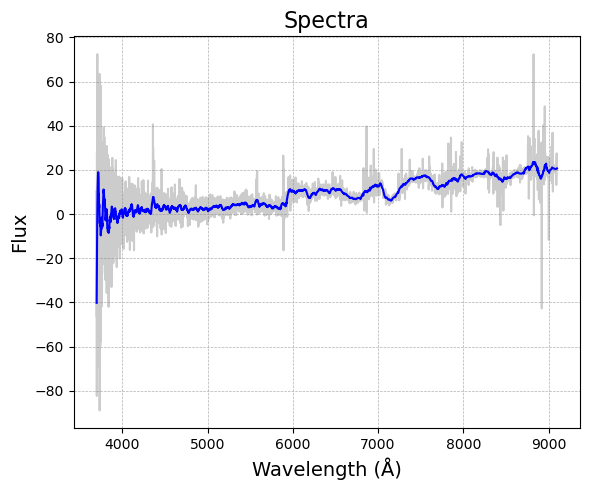

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288980  8319bbfc-91c8-5e04-bdf3-e805701d6a59     82295   

                        asassn_name other_names    raj2000   dej2000  \
288980  ASASSN-VJ134844.72+334334.2      RT CVn  207.18635  33.72618   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288980  2.456995e+06  1.458528e+18  J134844.68+334334.1           NaN   

                  edr3_source_id                galex_id         tic_id  
288980  EDR3 1458528154504309376  GALEX J134844.6+334335  TIC 165794645   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288980       3.65  250.332698            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288980      12.73        11.471961           0.018914         15.033325   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

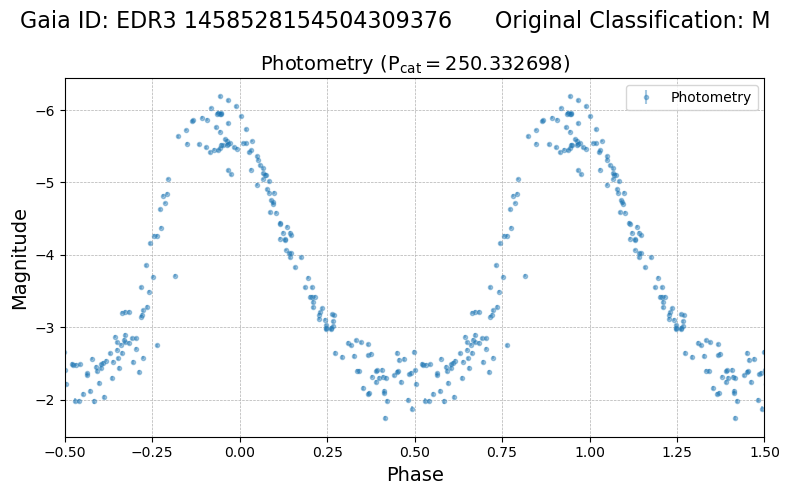

spec-57060-HD133738N334417V01_sp13-072.fits.gz


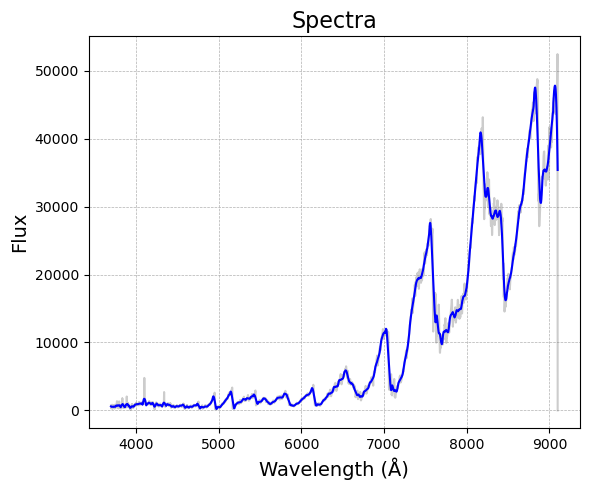

spec-57120-HD135323N334712V01_sp03-178.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



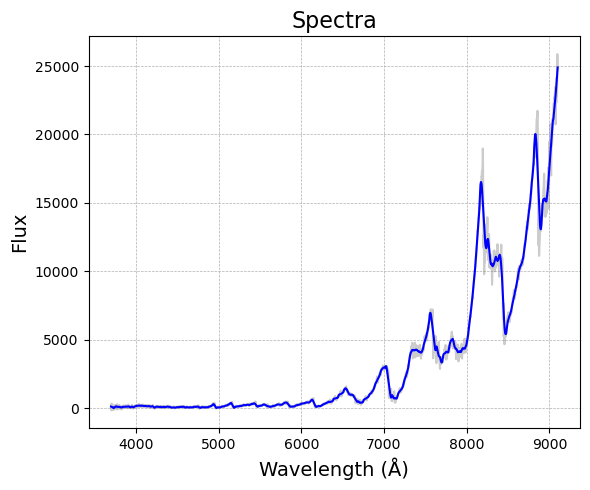

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
167440  5df0070a-0b0f-533b-b6fb-e7874762d337    332578   

                        asassn_name other_names   raj2000   dej2000  \
167440  ASASSN-VJ043511.72+391948.2      HI Per  68.79885  39.33006   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
167440  2.457697e+06  1.789103e+17  J043511.76+391948.1           NaN   

                 edr3_source_id galex_id         tic_id  
167440  EDR3 178910268626478848      NaN  TIC 155607301   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
167440       2.89  88.725575            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
167440      13.73        12.024672           0.027735         14.499735   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
167440  

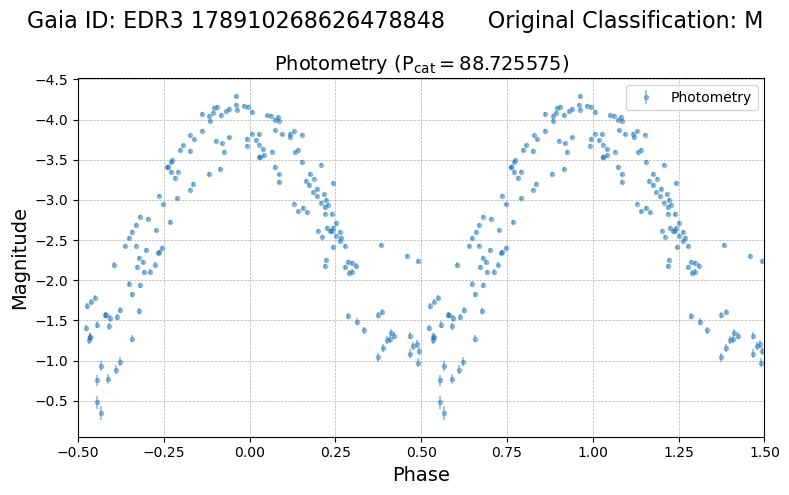

spec-57427-GAC069N36B1_sp11-141.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



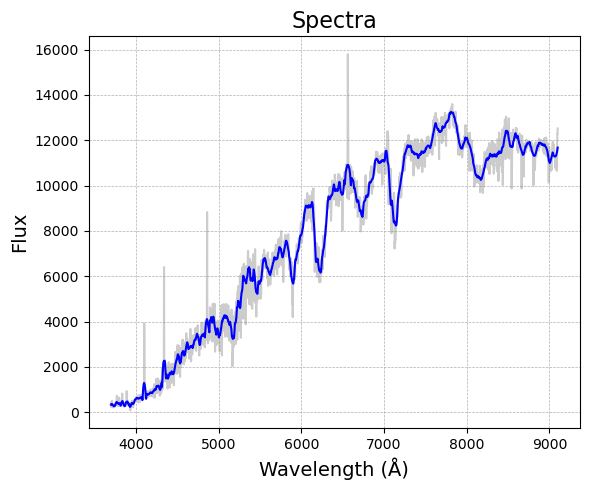

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
179467  e880bf26-f226-5ed3-9412-7012bca5c549    151097   

                        asassn_name           other_names   raj2000  dej2000  \
179467  ASASSN-VJ052749.29+064638.6  CSS_J052749.3+064638  81.95538  6.77738   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
179467  2.456906e+06  3.238016e+18  J052749.32+064638.6    23335460.0   

                  edr3_source_id galex_id         tic_id  
179467  EDR3 3238016118364248320      NaN  TIC 365782371   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
179467       2.28  530.03576            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
179467      15.79        14.012378           0.025011         19.112387   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

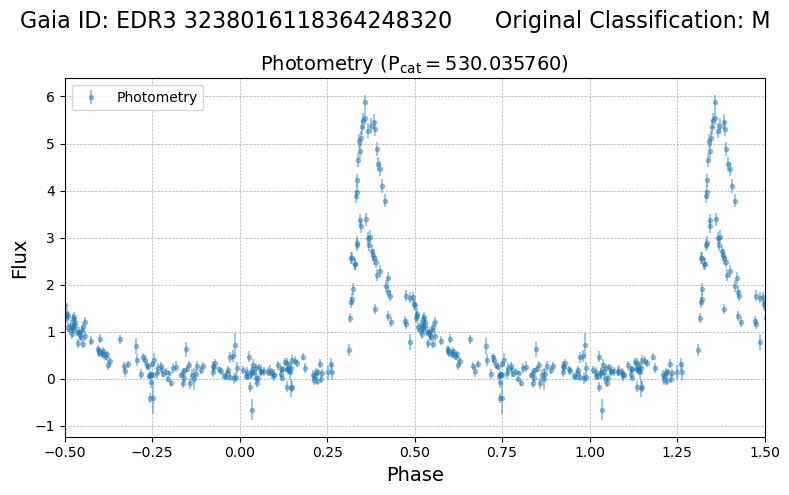

spec-57723-GAC081N07M1_sp04-093.fits.gz


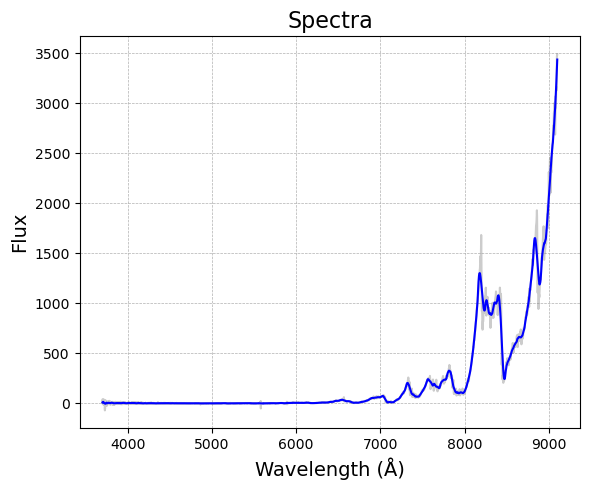

spec-58124-GAC081N07B1_sp04-093.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



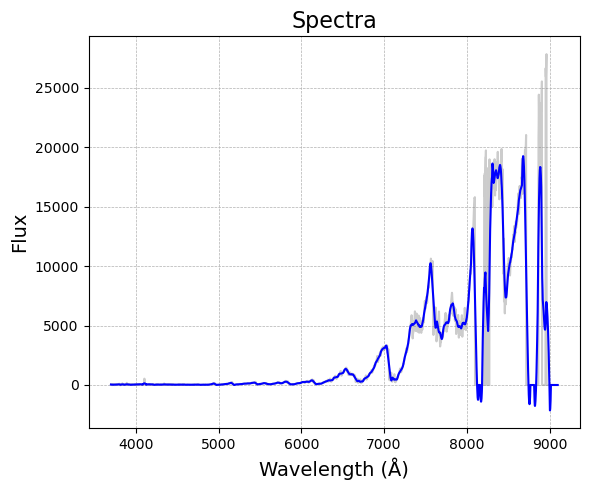

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
113354  75aed572-d0b5-5a1c-9960-f9f8ff949b1c     68848   

                        asassn_name other_names   raj2000   dej2000  \
113354  ASASSN-VJ185950.62+452139.5   V0396 Lyr  284.9609  45.36096   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
113354  2.457584e+06  2.107133e+18  J185950.71+452139.7    14498030.0   

                  edr3_source_id galex_id         tic_id  
113354  EDR3 2107132571992429696      NaN  TIC 164831785   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
113354        2.2  147.429405            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
113354      14.48        13.754738           0.029044         15.122372   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1133

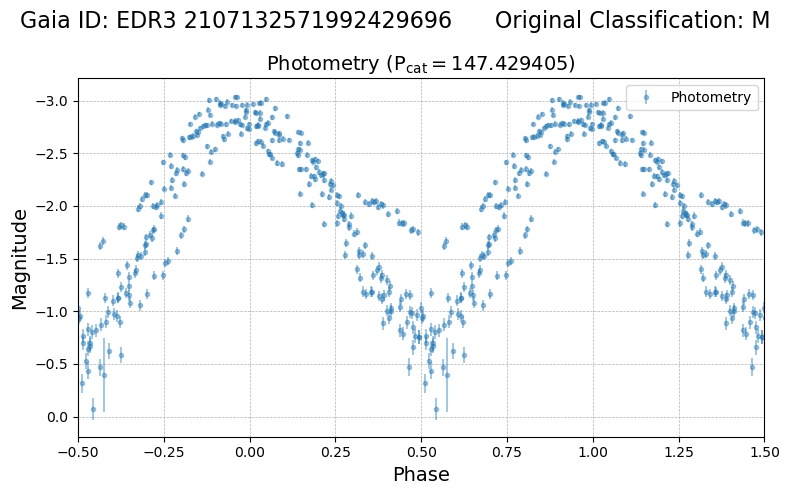

spec-56807-KP185111N464417V02_sp07-195.fits.gz


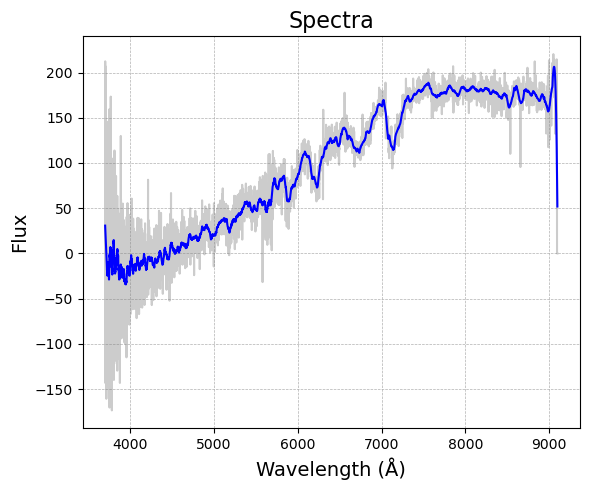

spec-56807-KP185111N464417V03_sp07-195.fits.gz


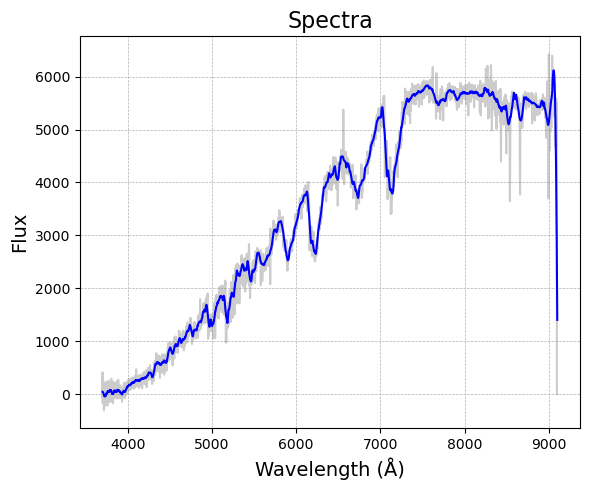

spec-57302-KP185111N464417V04_sp07-195.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



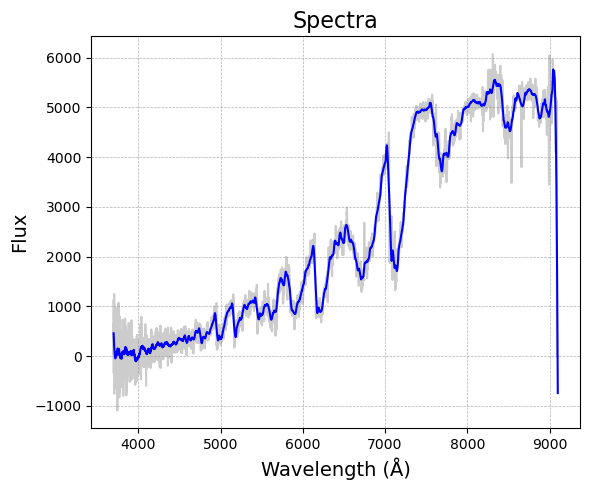

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289822  98f3a82e-cc22-5c45-9079-8263480e14f7     96178   

                        asassn_name           other_names    raj2000  \
289822  ASASSN-VJ180920.93+125528.2  NSVS J1809209+125529  272.33721   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
289822  12.92449  2.457849e+06  4.497138e+18  J180920.96+125528.1   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
289822    34906116.0  EDR3 4497137831895635200      NaN  TIC 150312506   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289822       3.51  291.132352            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289822      15.01        12.145335           0.019595         15.597727   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

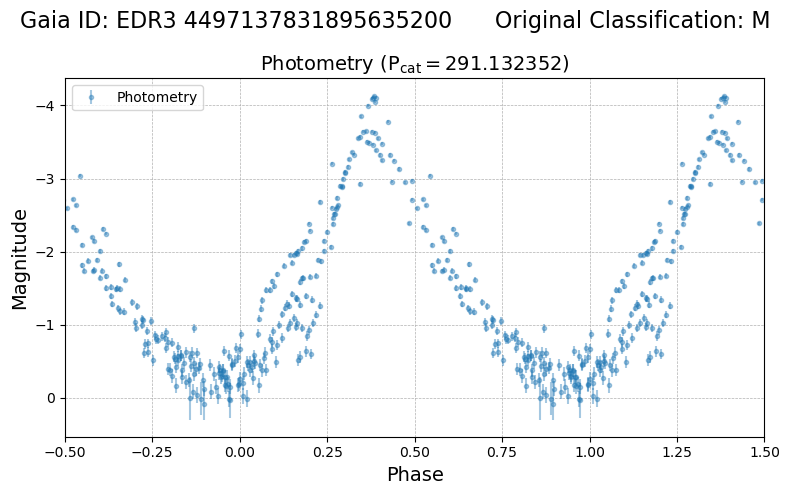

spec-57528-HD180335N140533V01_sp07-179.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



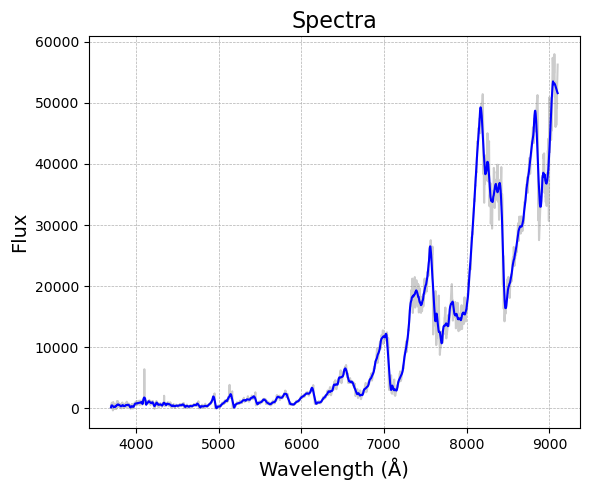

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288600  79c25205-3888-5d5f-84b9-5f205ae004b8     69154   

                        asassn_name other_names    raj2000  dej2000  \
288600  ASASSN-VJ202639.21+085233.3   NSV 13086  306.66337  8.87591   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288600  2.457689e+06  1.752353e+18  J202639.13+085233.9     9495888.0   

                  edr3_source_id galex_id         tic_id  
288600  EDR3 1752352910242716416      NaN  TIC 461452904   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288600       4.92  343.830579            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288600      15.52        11.963792           0.019566         15.855894   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2886

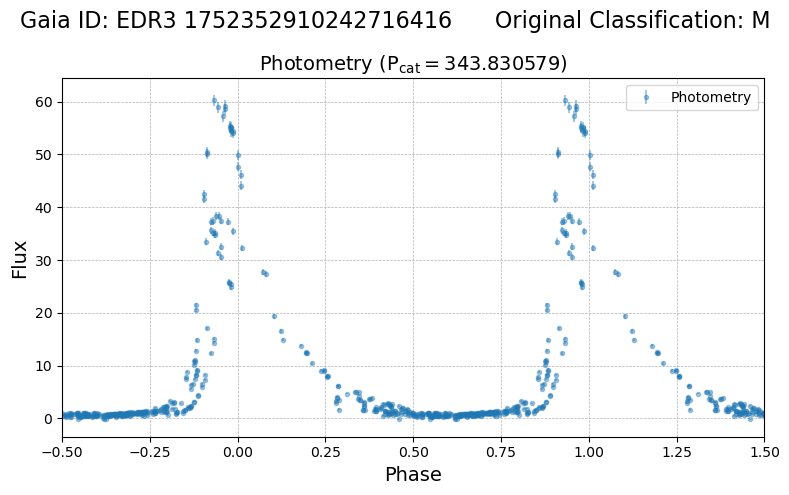

spec-58017-GACII305N07B1_sp12-159.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



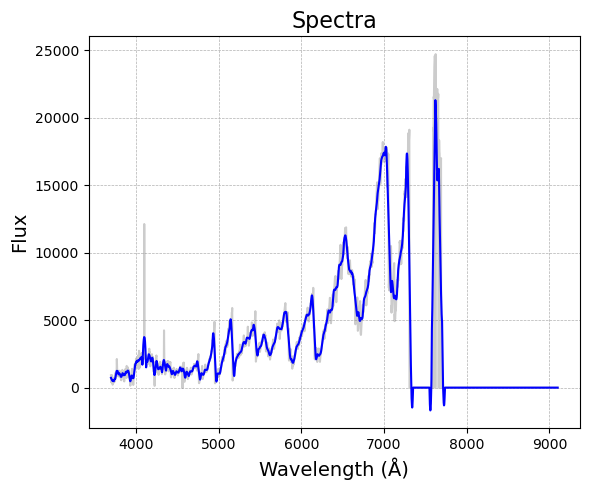

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288835  1ad2ca3d-bbe1-591d-9e9e-510fe67391c8    100128   

                        asassn_name other_names    raj2000  dej2000  \
288835  ASASSN-VJ174332.90+084203.6   V0819 Oph  265.88709  8.70099   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288835  2.457976e+06  4.488977e+18  J174332.92+084204.0    34798766.0   

                  edr3_source_id galex_id         tic_id  
288835  EDR3 4488977050435811968      NaN  TIC 288033382   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288835       3.53  266.739156            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288835       14.4        12.378894           0.029927         15.942422   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2888

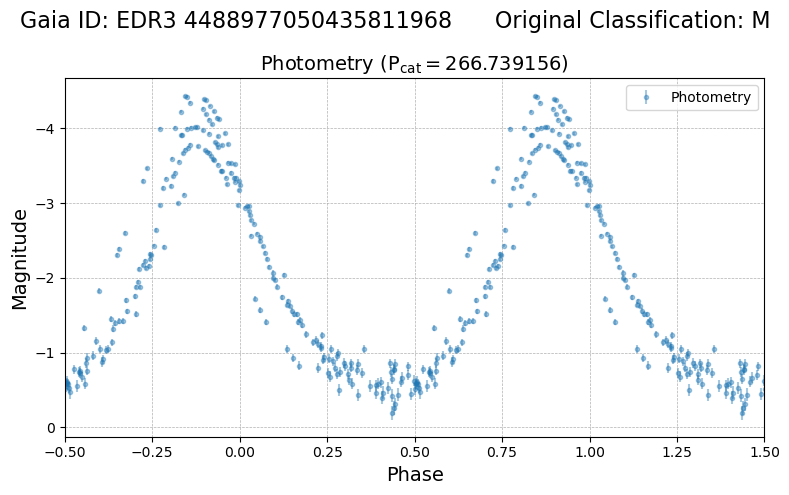

spec-57882-HD175009N095053V01_sp02-182.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



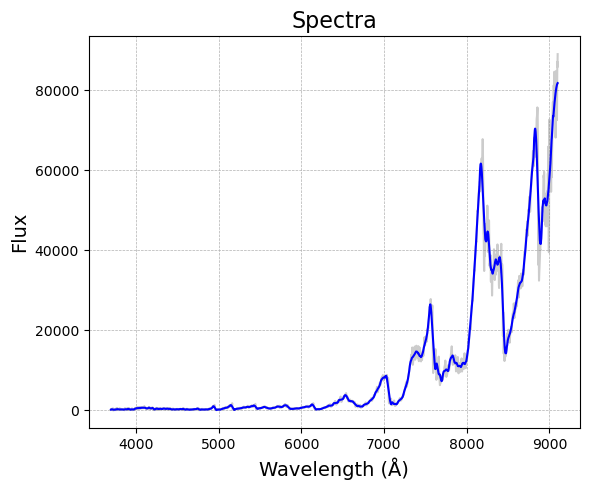

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
170405  24e1cf24-bca1-5b7b-9991-d553e81c3cf6    289137   

                        asassn_name   other_names   raj2000   dej2000  \
170405  ASASSN-VJ044627.27+373310.5  NSVS 6817724  71.61361  37.55291   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
170405  2.457675e+06  1.993054e+17  J044627.29+373310.5     1064714.0   

                 edr3_source_id galex_id         tic_id  
170405  EDR3 199305419047951872      NaN  TIC 156526361   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
170405       2.12  145.612347            0.34       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
170405      16.26        14.506555           0.027457          16.85722   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
170

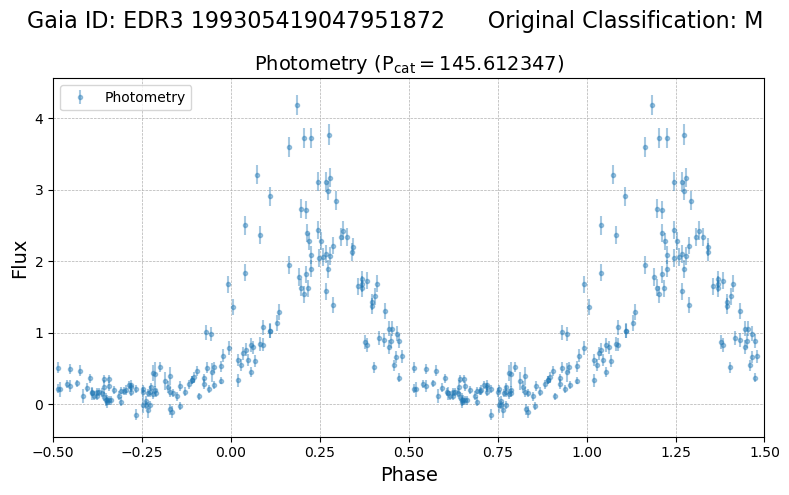

spec-56570-GAC069N36V1_sp13-134.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



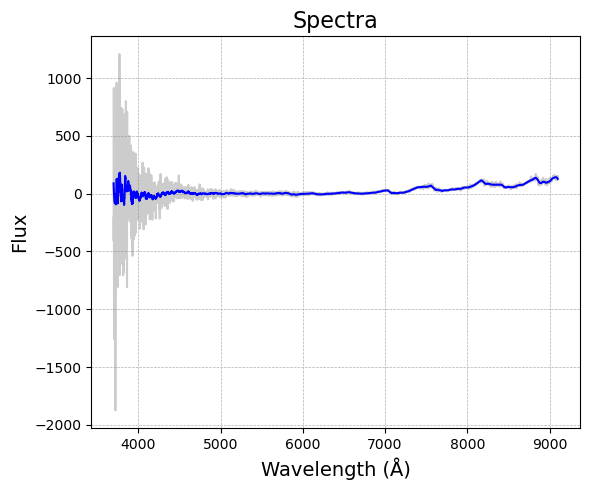

spec-57427-GAC069N36B1_sp13-135.fits.gz


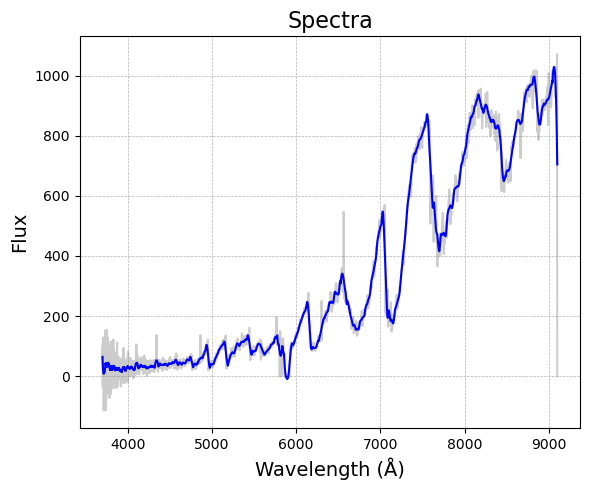

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
258930  8ae43dea-8244-5d04-bde0-167124720cc4    132097   

                        asassn_name other_names   raj2000   dej2000  \
258930  ASASSN-VJ051713.40+123219.2   V0674 Ori  79.30583  12.53867   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
258930  2.457283e+06  3.388440e+18  J051713.44+123218.8    24970070.0   

                  edr3_source_id galex_id         tic_id  
258930  EDR3 3388440372879637888      NaN  TIC 411895909   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
258930       2.84  496.227148             0.6       0.71 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
258930      15.42        12.161454           0.061393         17.318584   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2589

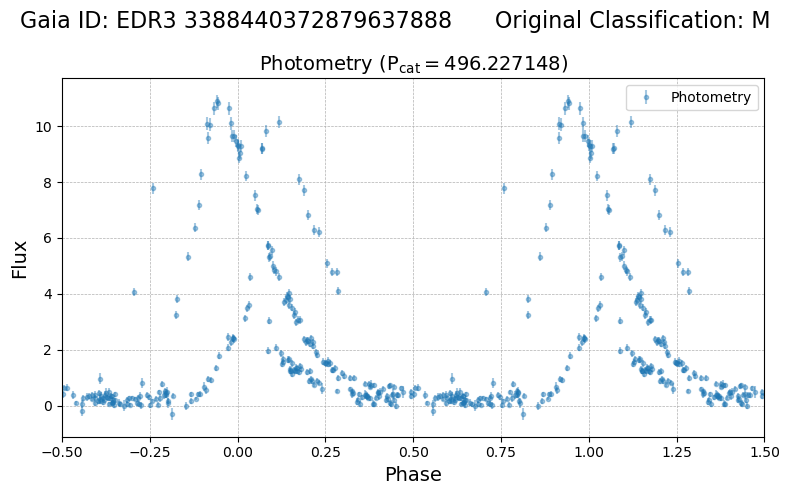

spec-57445-GAC081N11B1_sp14-128.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



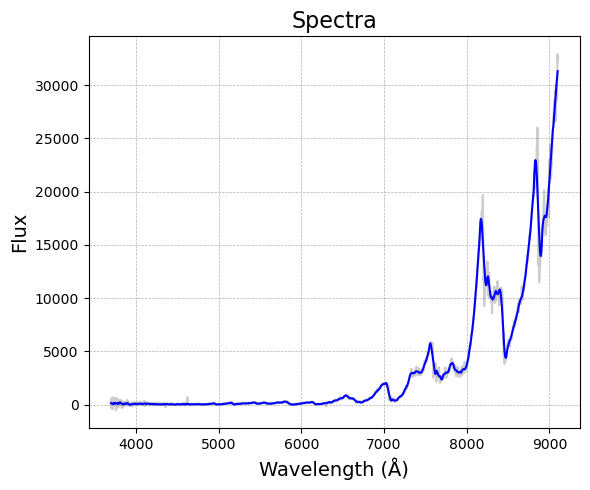

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288744  6a181689-d9ad-59fc-83b0-2918a81d5f2a    279482   

                        asassn_name           other_names  raj2000   dej2000  \
288744  ASASSN-VJ033800.72+340112.3  NSVS J0338007+340115   54.503  34.02007   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288744  2.457227e+06  2.208544e+17  J033800.71+340112.6     1348711.0   

                 edr3_source_id galex_id         tic_id  
288744  EDR3 220854403842674560      NaN  TIC 101095141   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288744       3.61  328.514235            0.08       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288744       16.5        13.503034           0.044564           16.8718   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

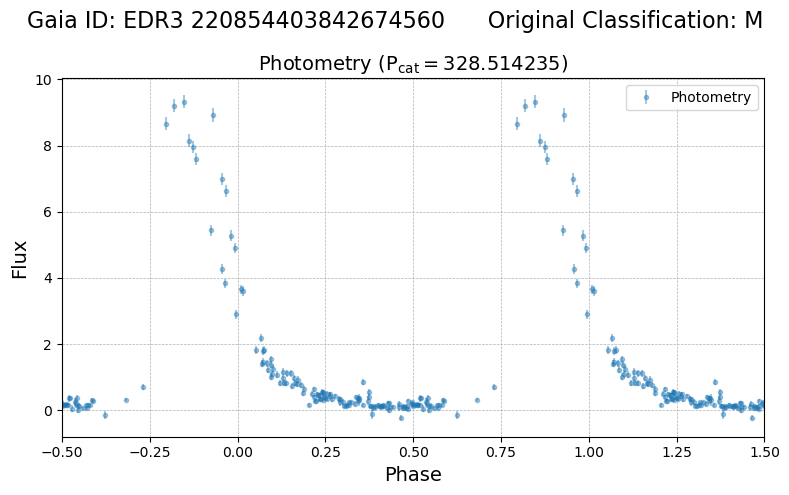

spec-56633-GAC053N32M1_sp11-119.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



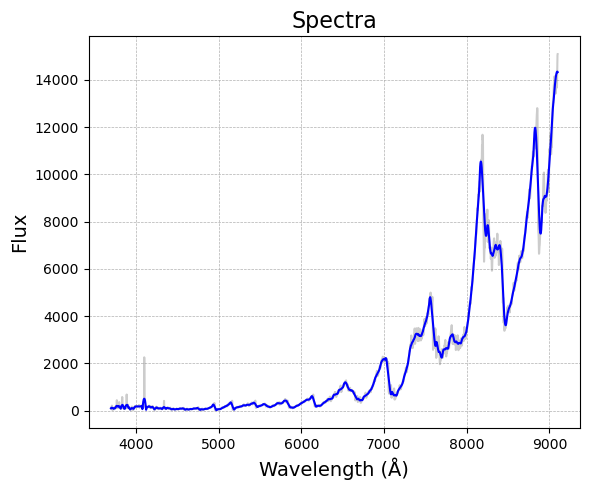

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
208379  d1e96ef3-b268-5217-98ca-d1eae86a0ac2    243925   

                        asassn_name           other_names   raj2000   dej2000  \
208379  ASASSN-VJ053505.18+222510.4  NSVS J0535051+222509  83.77157  22.41956   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
208379  2.458068e+06  3.403859e+18  J053505.16+222510.1           NaN   

                  edr3_source_id galex_id         tic_id  
208379  EDR3 3403858549559988608      NaN  TIC 437843049   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
208379       2.36  247.257127            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
208379      14.92        13.643888           0.039908         16.620224   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

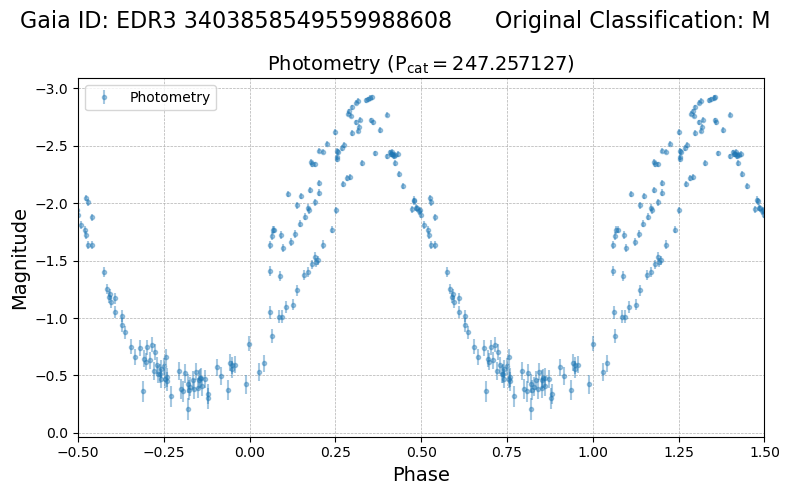

spec-56647-GAC085N22V1_sp10-235.fits.gz


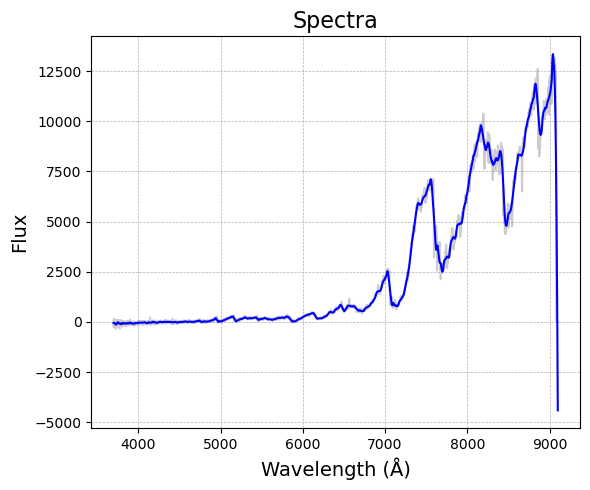

spec-56647-GAC085N22V3_sp10-235.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



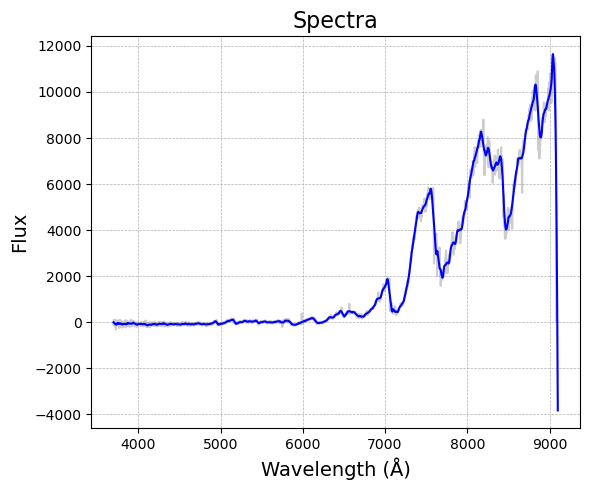

spec-56680-GAC085N22B1_sp10-247.fits.gz


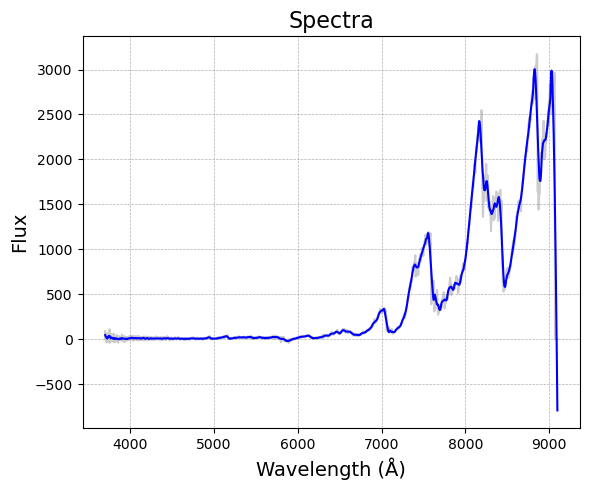

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289749  3028a40a-23ed-59d8-bad8-d473820aea1c    214106   

                        asassn_name other_names    raj2000   dej2000  \
289749  ASASSN-VJ220423.86+514407.7      HP Lac  331.09943  51.73547   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289749  2.457271e+06  1.980354e+18  J220423.79+514407.9    12851697.0   

                  edr3_source_id galex_id         tic_id  
289749  EDR3 1980353830443304064      NaN  TIC 325660978   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289749       2.97  303.888578            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289749       14.9        12.438211            0.02038          16.34869   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

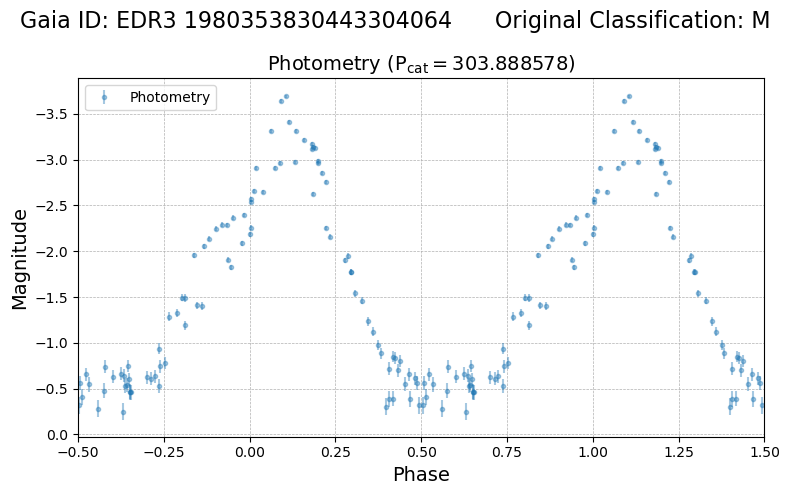

spec-57675-HD220327N493953B01_sp11-103.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



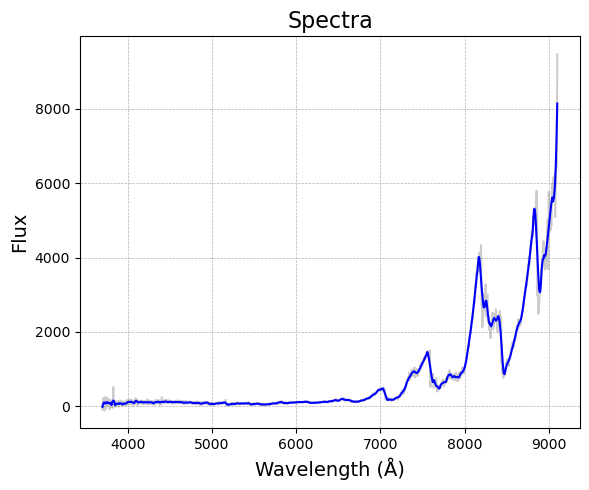

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288665  0122e8cd-bc29-56be-a3d5-2924ba544e98     73519   

                        asassn_name other_names    raj2000  dej2000  \
288665  ASASSN-VJ183253.72+430103.7      OP Lyr  278.22384  43.0177   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288665  2.456742e+06  2.111787e+18  J183253.80+430103.5    14525448.0   

                  edr3_source_id galex_id         tic_id  
288665  EDR3 2111786770352249600      NaN  TIC 122886736   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288665        4.9  294.236725            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288665      15.01        12.615452           0.025834         16.283245   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2886

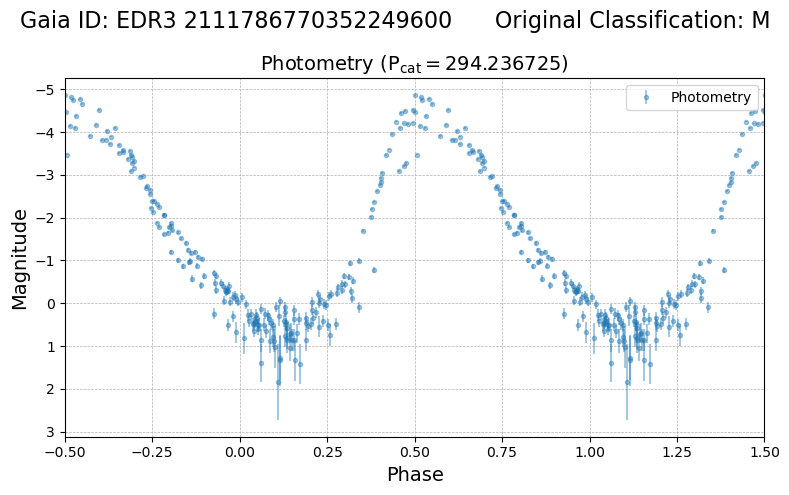

spec-57516-HD184435N434959B01_sp10-077.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



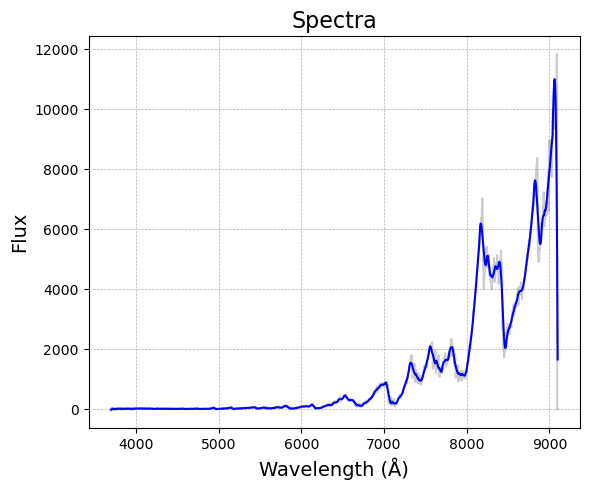

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289214  2e3a13f3-5078-5852-acbc-e07f95e07365     59667   

                        asassn_name other_names    raj2000   dej2000  \
289214  ASASSN-VJ191953.56+401521.7      ER Lyr  289.97315  40.25604   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289214  2.457192e+06  2.101162e+18  J191953.66+401521.5    14414790.0   

                  edr3_source_id galex_id         tic_id  
289214  EDR3 2101161914620268160      NaN  TIC 122138980   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289214       4.04  197.379938            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289214      12.97        11.112129           0.039198         14.374984   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

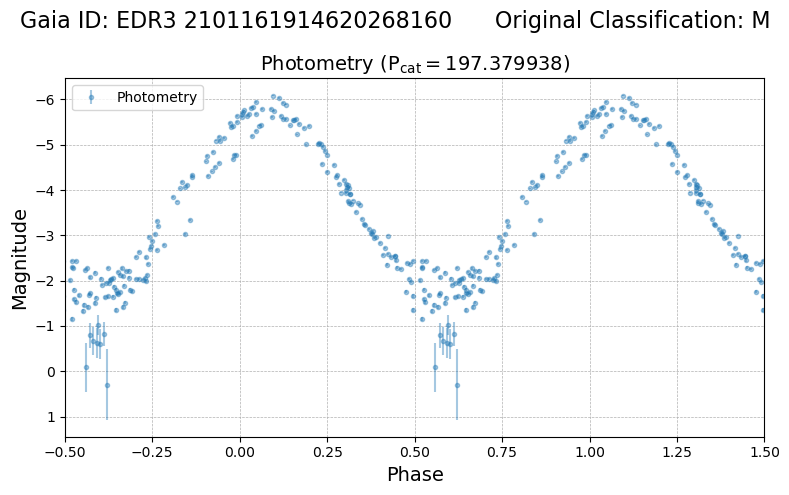

spec-56094-kepler05B56094_2_sp15-080.fits.gz


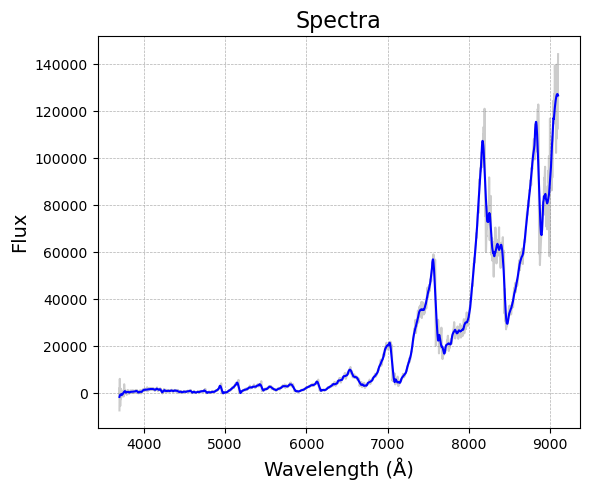

spec-56432-KP192102N424113V01_sp01-212.fits.gz


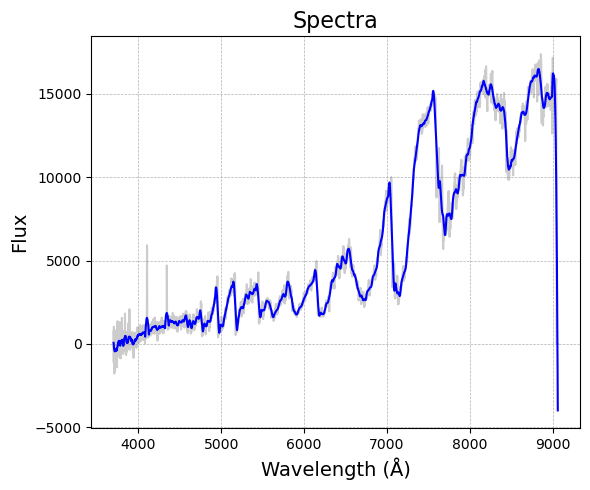

spec-57308-KP192409N391242V01_sp15-080.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



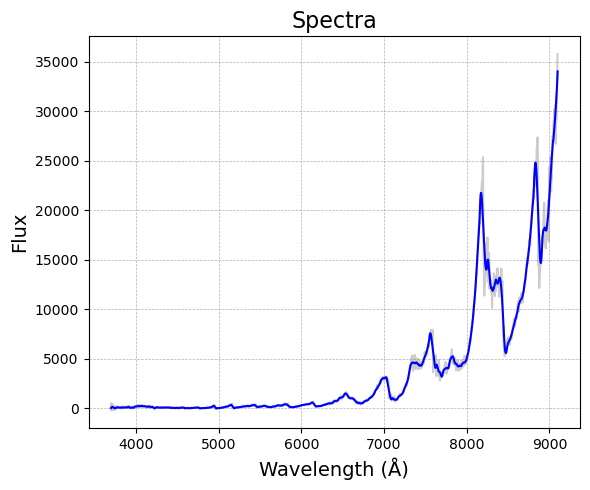

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289486  07910e9f-950b-59db-a23b-f29c53d92574     87045   

                        asassn_name other_names   raj2000   dej2000  \
289486  ASASSN-VJ035304.27+253240.5      SX Tau  58.26779  25.54458   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289486  2.457424e+06  6.729231e+16  J035304.29+253240.6           NaN   

                edr3_source_id galex_id         tic_id  
289486  EDR3 67292314941931520      NaN  TIC 427736226   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
289486       3.47   225.0            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289486      14.24        11.802689           0.016069         15.610958   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
289486          

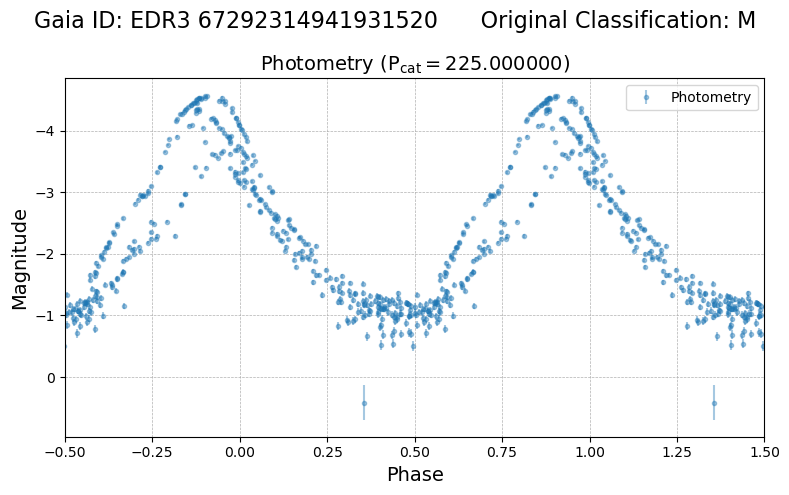

spec-58844-TD035052N235741K01_sp11-052.fits.gz


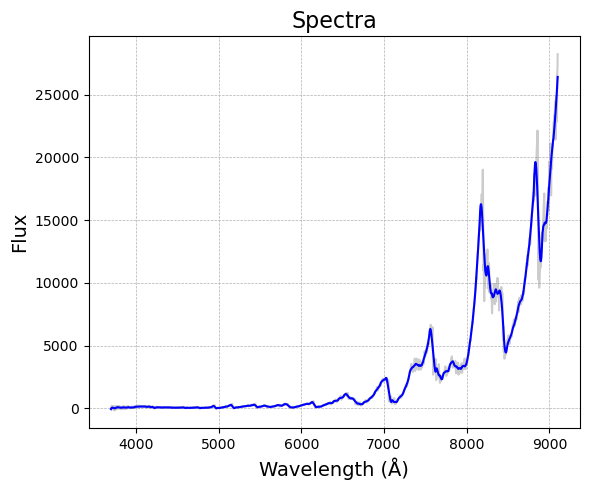

spec-58845-TD035052N235741K01_sp11-052.fits.gz


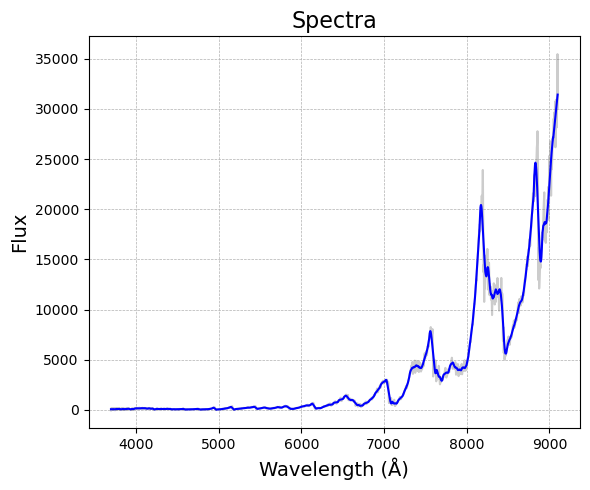

spec-58874-TD035052N235741K01_sp11-052.fits.gz


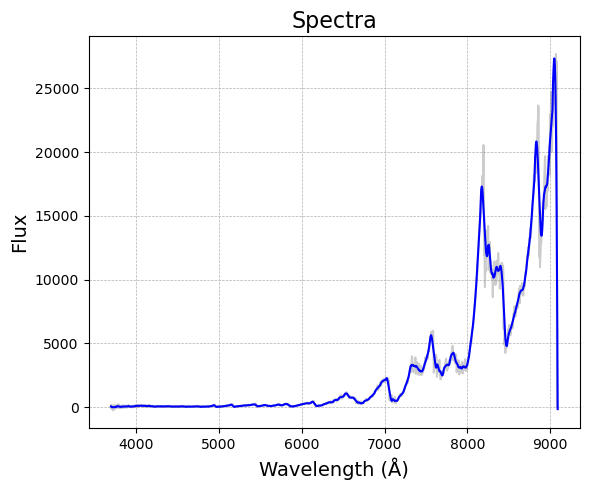

spec-58903-TD035052N235741K01_sp11-052.fits.gz


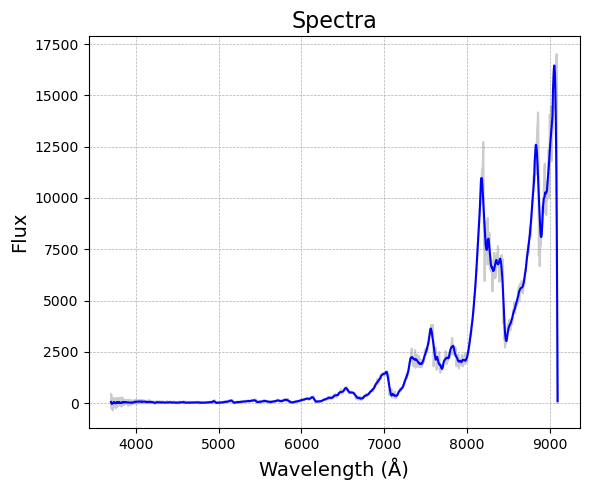

spec-59256-TD035052N235741K01_sp11-052.fits.gz


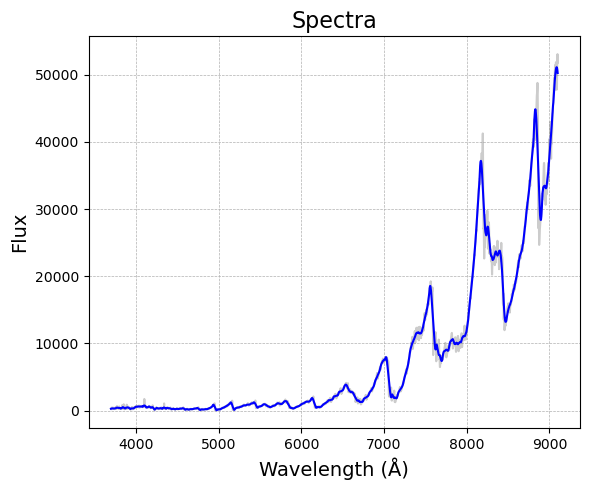

spec-58785-TD035052N235741K01_sp11-052.fits.gz


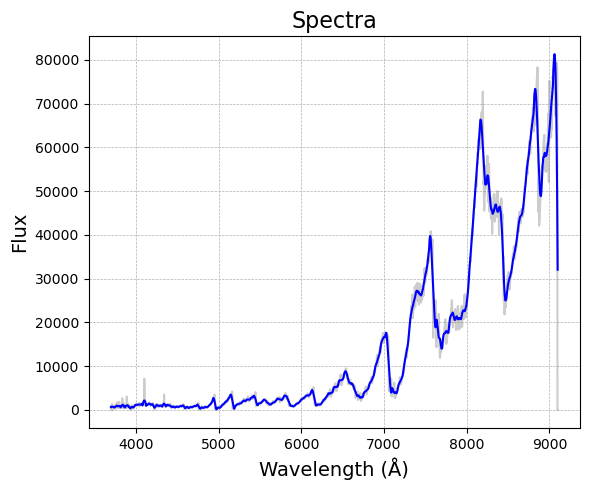

spec-58788-TD035052N235741K01_sp11-052.fits.gz


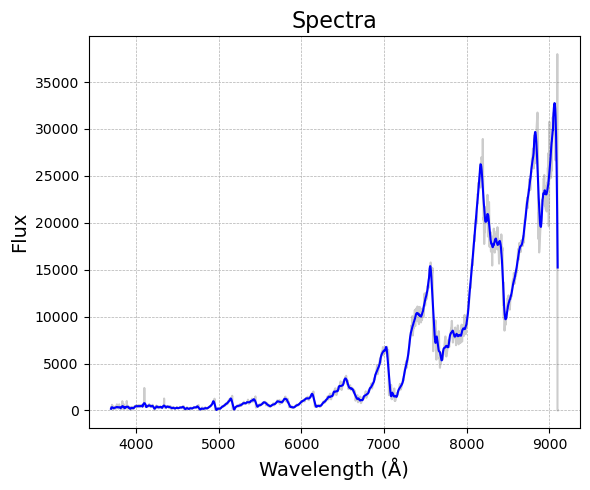

spec-58812-TD035052N235741K01_sp11-052.fits.gz


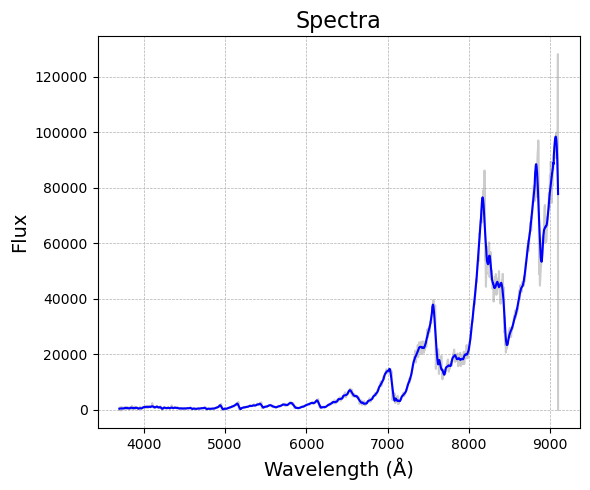

spec-58868-TD035052N235741K01_sp11-052.fits.gz


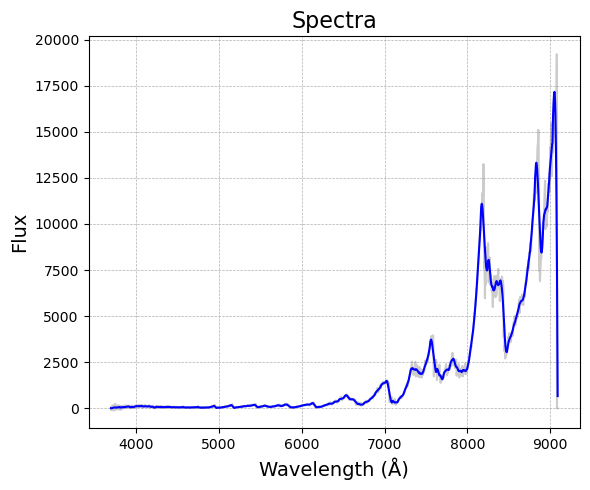

spec-59139-TD035052N235741K01_sp11-052.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



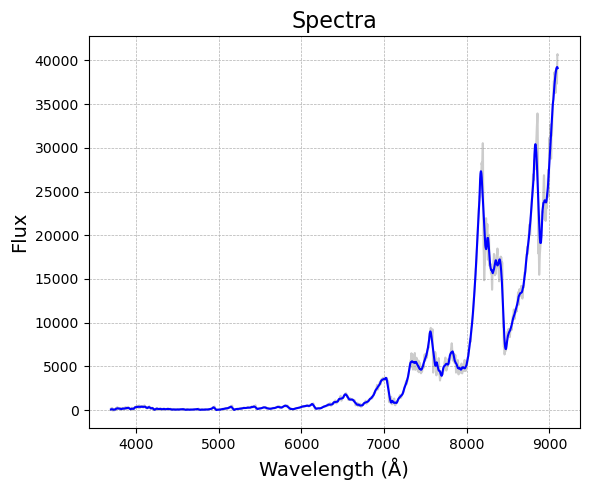

spec-59165-TD035052N235741K01_sp11-052.fits.gz


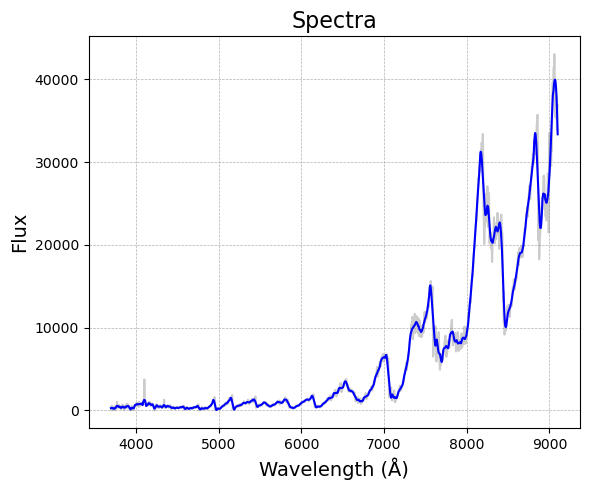

spec-59232-TD035052N235741K01_sp11-052.fits.gz


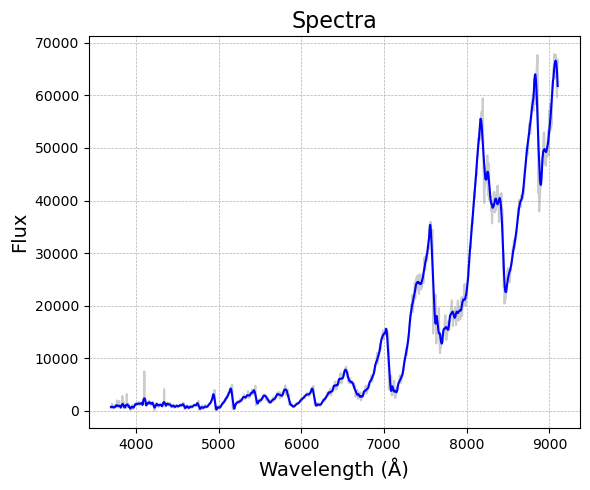

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
254395  45a5f736-db48-50c1-ae61-6d805a5dffac    104372   

                        asassn_name           other_names   raj2000   dej2000  \
254395  ASASSN-VJ083737.37+395804.1  NSVS J0837373+395804  129.4057  39.96781   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
254395  2.457406e+06  9.115490e+17  J083737.22+395803.7     6289358.0   

                 edr3_source_id galex_id         tic_id  
254395  EDR3 911548951072183296      NaN  TIC 188389866   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
254395       3.22   224.0            0.18       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
254395      13.63        12.538729           0.034233         14.772565   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_

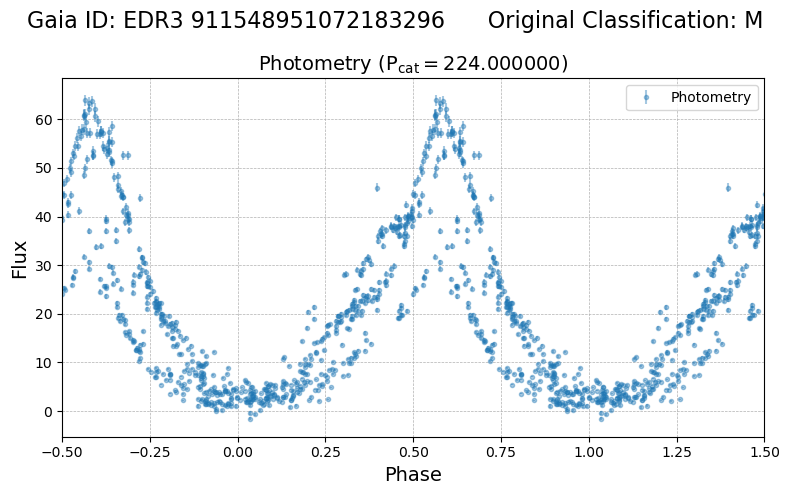

spec-56618-GAC131N42V1_sp02-204.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



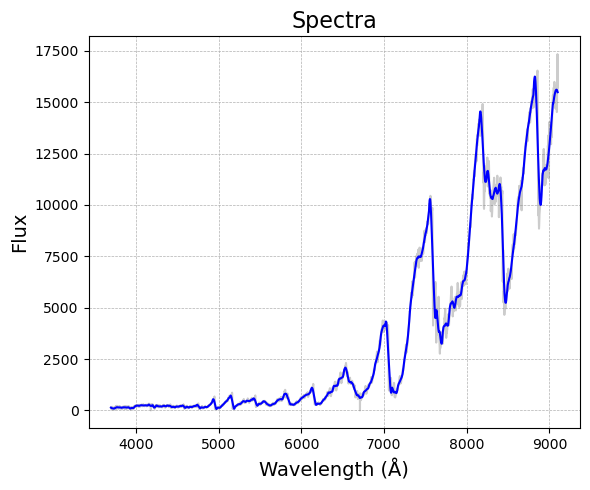

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290079  06e74dd9-fa1e-5503-912e-60002869e37a    362717   

                        asassn_name other_names   raj2000   dej2000  \
290079  ASASSN-VJ023123.13+565257.4      DT Per  37.84638  56.88262   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290079  2.457009e+06  4.579661e+17  J023123.13+565257.2     3771963.0   

                 edr3_source_id galex_id         tic_id  
290079  EDR3 457966079245121152      NaN  TIC 444138096   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290079       3.09  229.778174            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290079       14.4        12.170509           0.029468         15.845212   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290079

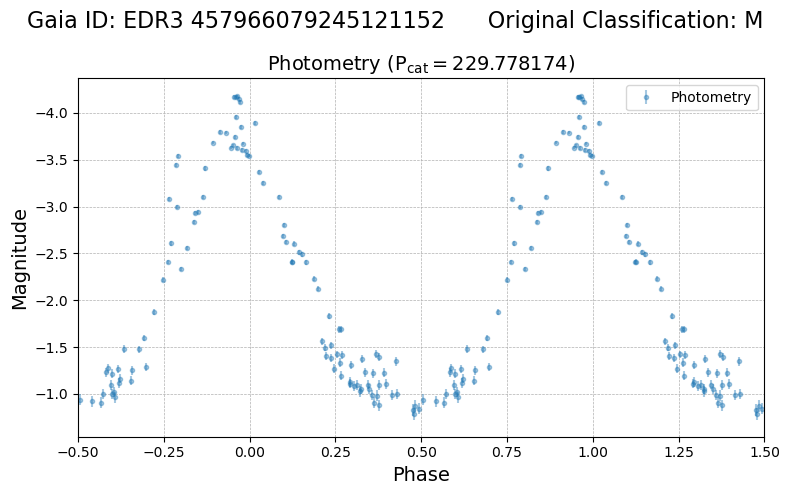

spec-56668-HD023050N553254B01_sp15-030.fits.gz


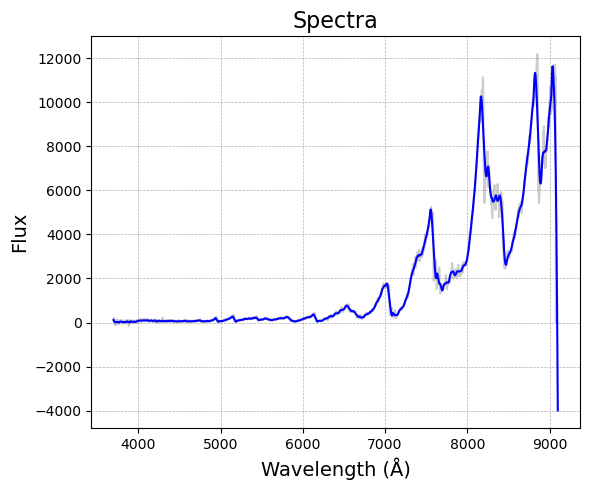

spec-57778-HD023050N553254B02_sp15-030.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



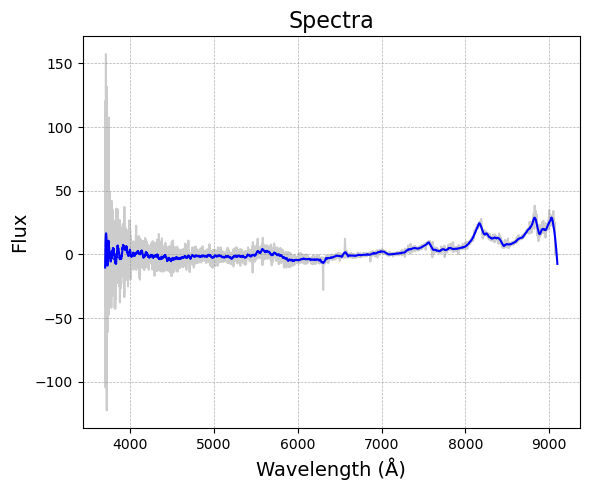

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290181  2bf99171-0c9d-52b2-b514-510540de2201     71098   

                        asassn_name other_names    raj2000   dej2000  \
290181  ASASSN-VJ185217.01+420948.5   V0352 Lyr  283.07089  42.16347   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290181  2.457982e+06  2.104573e+18  J185217.04+420948.5    14467059.0   

                  edr3_source_id galex_id         tic_id  
290181  EDR3 2104573252520522624      NaN  TIC 164412505   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290181        3.3  329.877917            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290181      15.33        12.144345           0.020035         15.832601   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
29

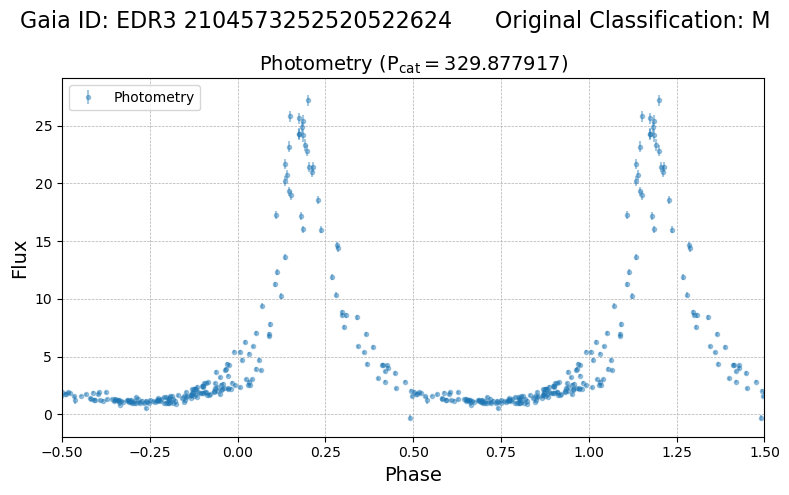

spec-56573-KP185031N425443V01_sp05-125.fits.gz


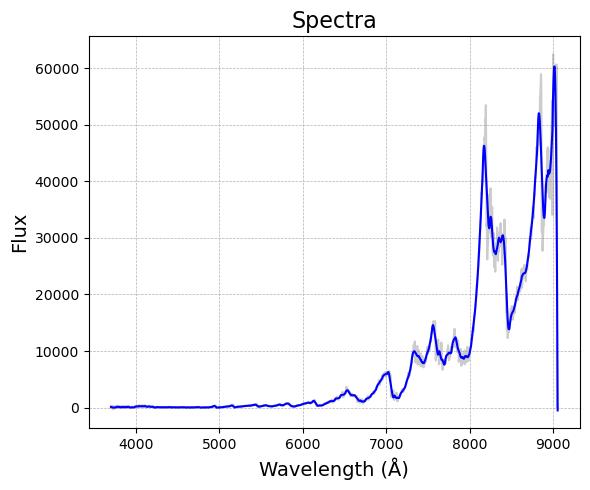

spec-57912-KP185031N425443V03_sp05-125.fits.gz


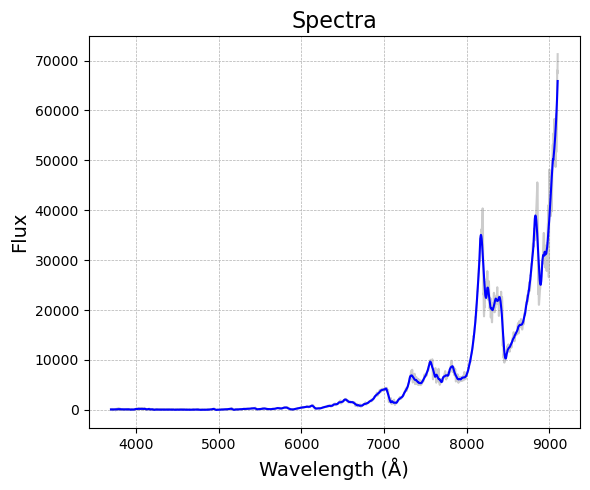

spec-57300-KP185031N425443V02_sp05-125.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



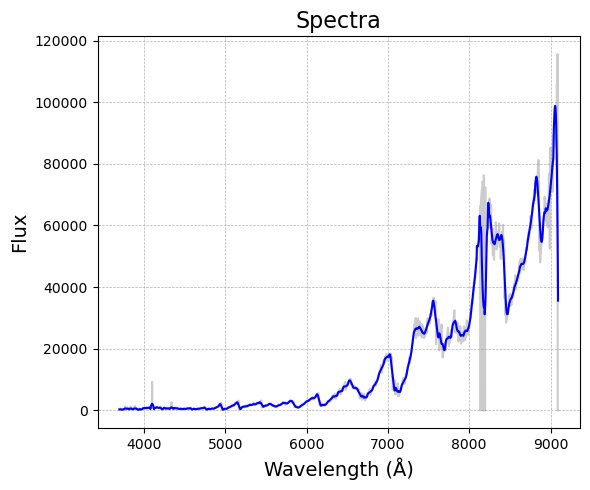

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288737  025d2ec5-98ef-5ec1-8455-8a5169c96059    192588   

                        asassn_name other_names    raj2000   dej2000  \
288737  ASASSN-VJ193349.85+385000.4      HQ Cyg  293.45769  38.83344   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288737  2.457908e+06  2.052300e+18  J193349.76+385000.1    13883121.0   

                  edr3_source_id galex_id         tic_id  
288737  EDR3 2052300339439640320      NaN  TIC 138212905   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288737       4.37  296.046484            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288737      15.33         13.19128           0.024667         16.959793   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

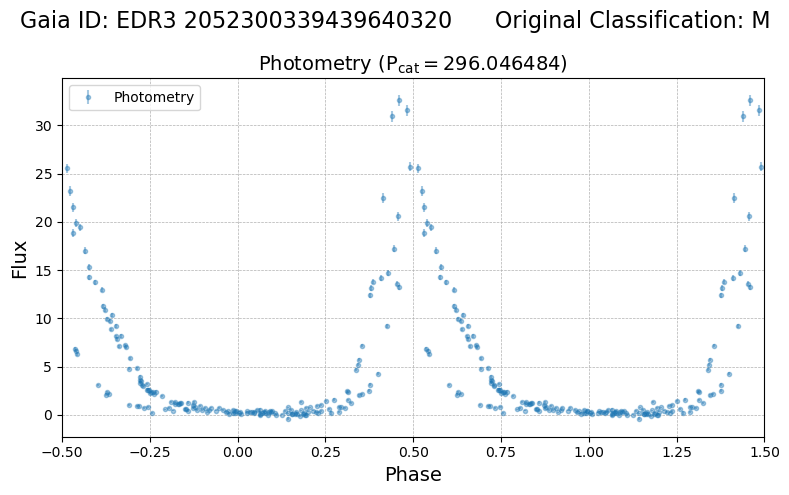

spec-57918-KP192409N391242V05_sp06-100.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



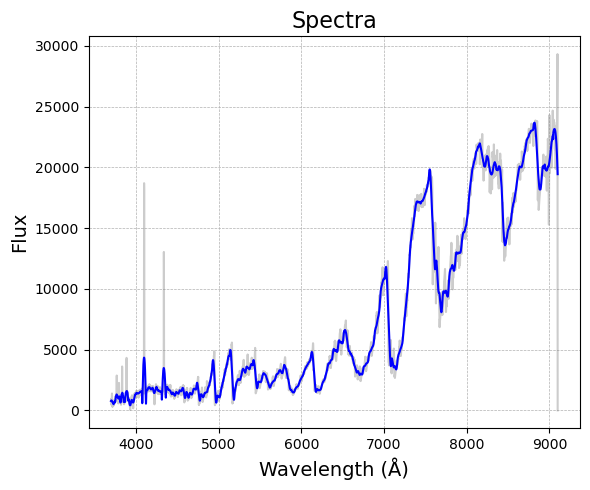

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
164883  d030084d-b06b-5b86-b54b-e640b4e43c92    104483   

                        asassn_name           other_names    raj2000  \
164883  ASASSN-VJ084041.40+423633.3  NSVS J0840412+423633  130.17248   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
164883  42.60926  2.458065e+06  9.136201e+17  J084041.24+423633.2   

        apass_dr9_id           edr3_source_id                galex_id  \
164883     6295589.0  EDR3 913620117446154112  GALEX J084041.0+423632   

              tic_id  
164883  TIC 20119018   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
164883       2.25  137.124281            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
164883      13.91        12.902031            0.02084         14.069894   

        e_pho

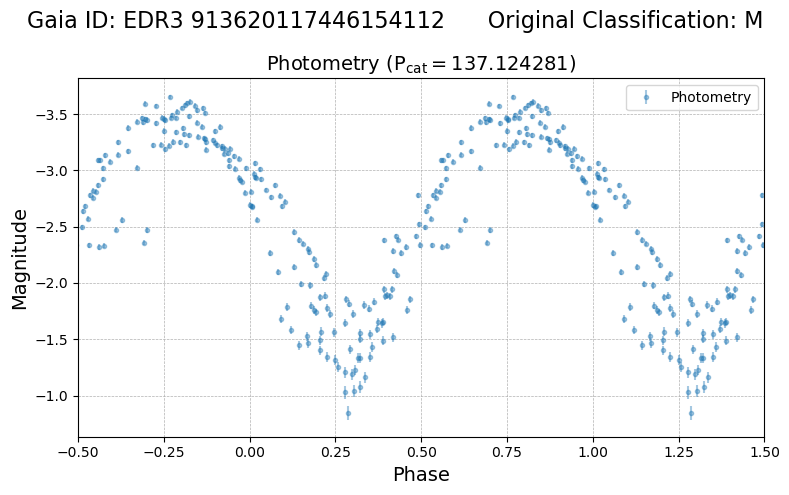

spec-57328-HD084415N420602V01_sp03-145.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



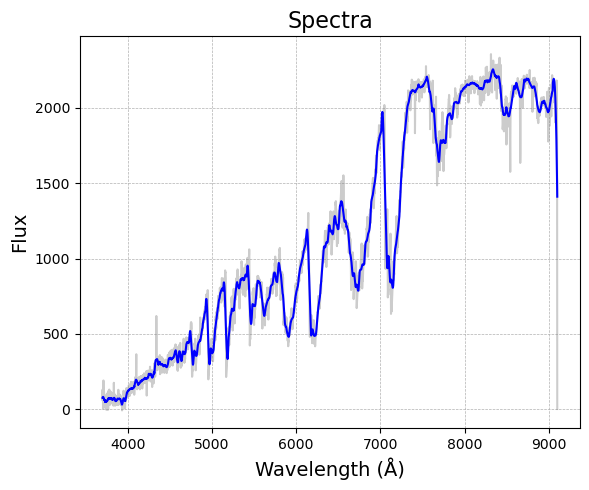

spec-57468-HD084415N420602V02_sp03-145.fits.gz


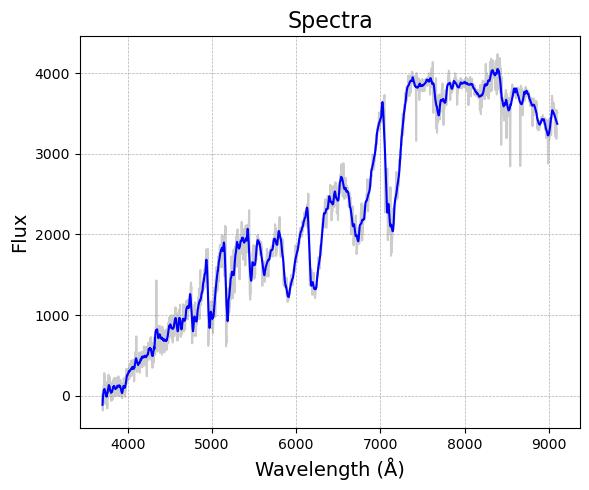

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289361  9d67a2de-208c-52d0-bbfd-23beba698293    104423   

                        asassn_name other_names    raj2000   dej2000  \
289361  ASASSN-VJ073142.44+473322.5      DN Lyn  112.92683  47.55626   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289361  2.457504e+06  9.755601e+17  J073142.40+473323.5     6795104.0   

                 edr3_source_id galex_id         tic_id  
289361  EDR3 975560147220560768      NaN  TIC 307775514   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289361       4.52  319.360476            0.07       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289361      13.91         10.98383           0.038101         15.008729   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2893

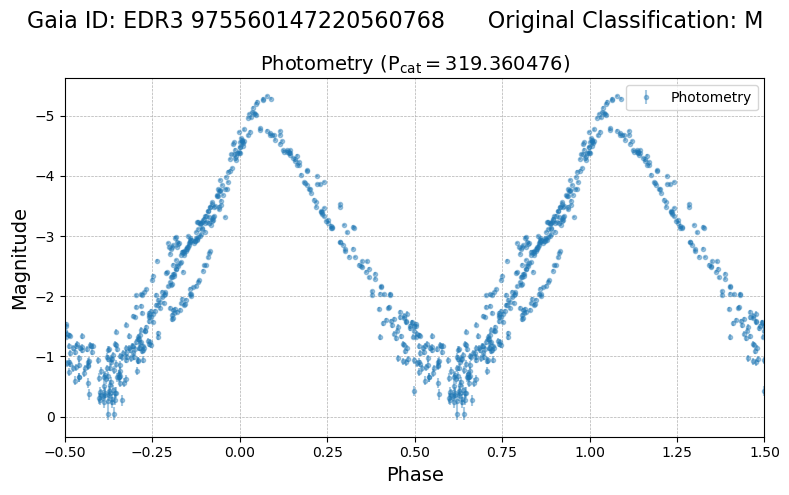

spec-57110-HD074504N482340V01_sp10-179.fits.gz


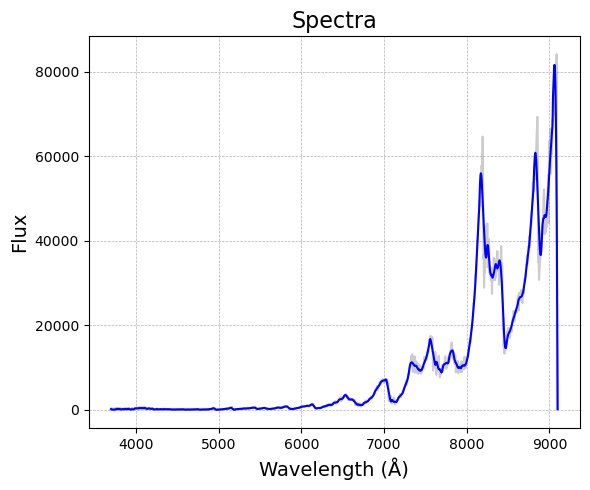

spec-57438-HD074504N482340V02_sp10-179.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



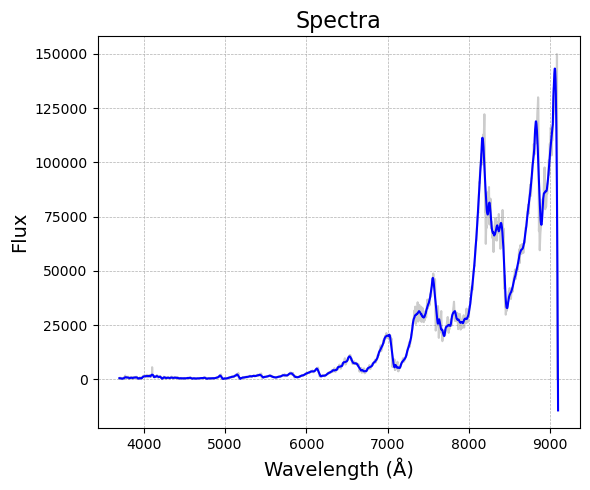

spec-58875-HD072517N493924V02_sp07-249.fits.gz


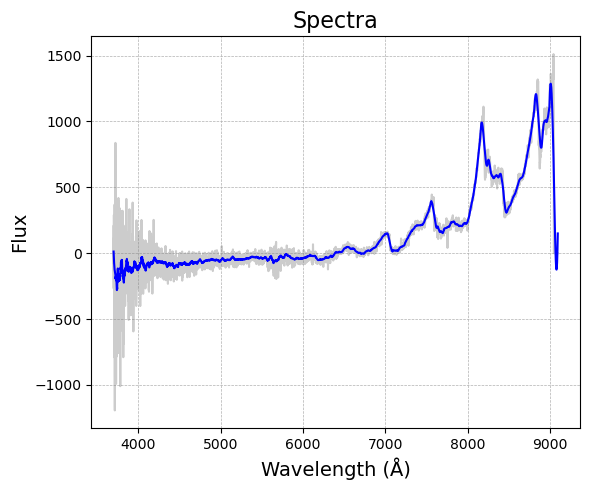

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289304  0131d964-83f3-56d7-bad2-29ef0e6aba06     70792   

                        asassn_name other_names    raj2000   dej2000  \
289304  ASASSN-VJ185758.03+430805.8   V0357 Lyr  284.49178  43.13494   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289304  2.457581e+06  2.104298e+18  J185758.05+430805.6    14464379.0   

                  edr3_source_id galex_id         tic_id  
289304  EDR3 2104297653060323584      NaN  TIC 164728418   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
289304       3.75  316.6828            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289304      14.15        11.637487           0.023695         15.380761   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
289304

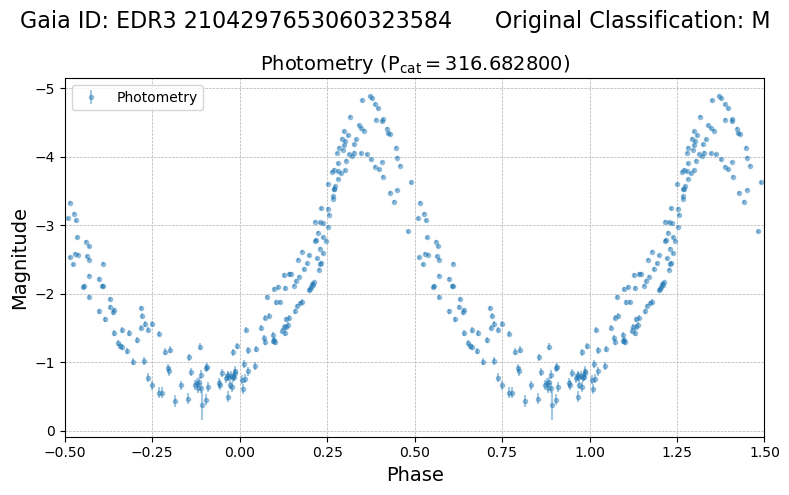

spec-56570-KP190808N440210V01_sp10-031.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



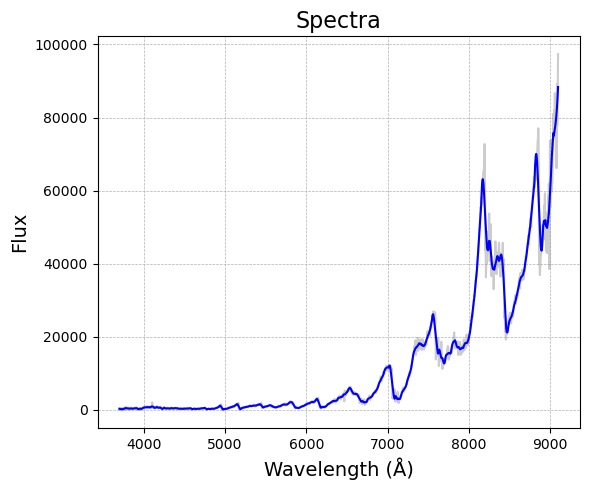

spec-56573-KP185031N425443V01_sp09-242.fits.gz


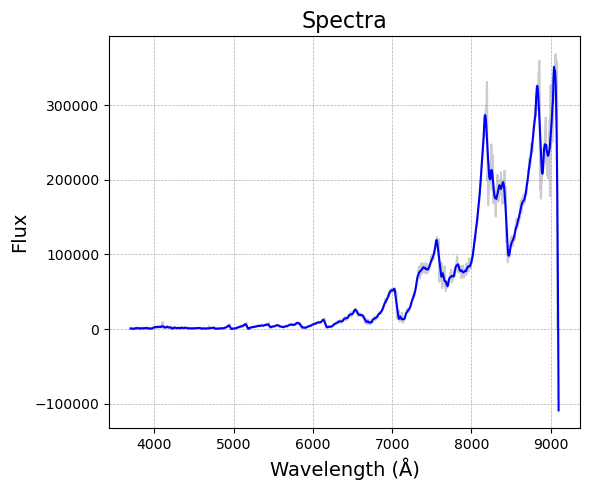

spec-57300-KP185031N425443V02_sp09-242.fits.gz


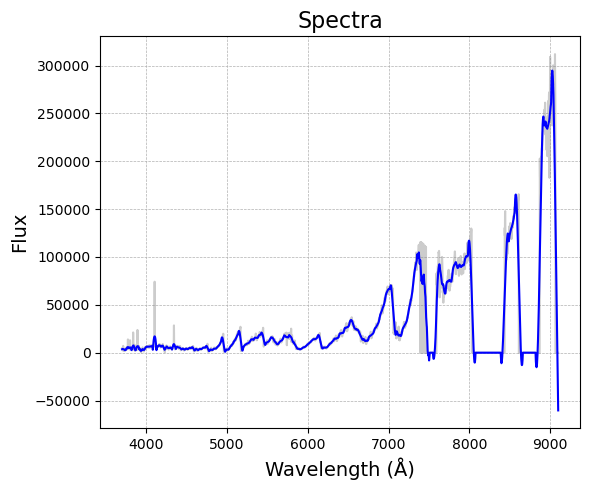

spec-57912-KP185031N425443V05_sp09-242.fits.gz


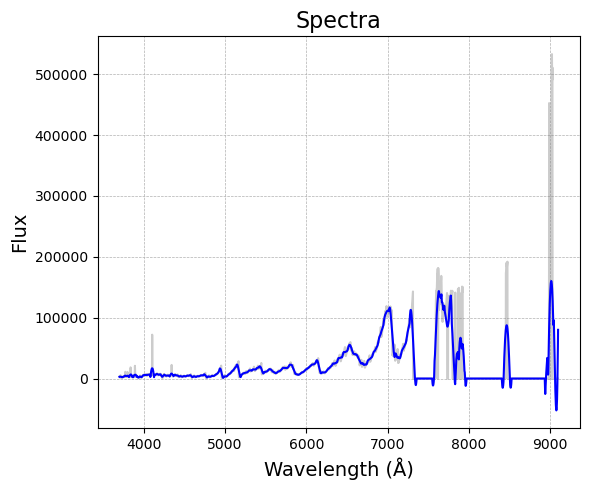

spec-57912-KP185031N425443V03_sp09-242.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



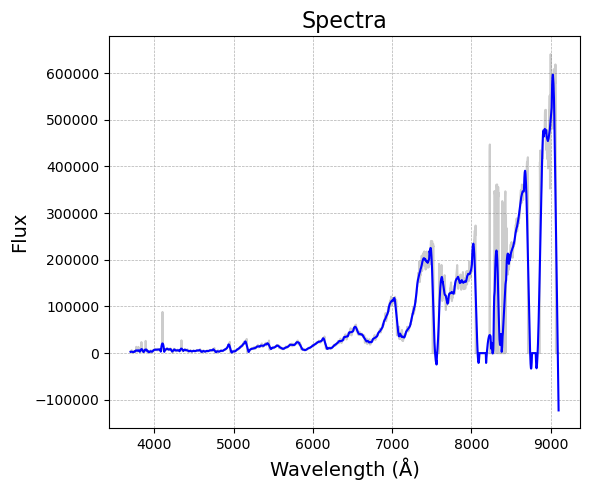

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289304  0131d964-83f3-56d7-bad2-29ef0e6aba06     70792   

                        asassn_name other_names    raj2000   dej2000  \
289304  ASASSN-VJ185758.03+430805.8   V0357 Lyr  284.49178  43.13494   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289304  2.457581e+06  2.104298e+18  J185758.05+430805.6    14464379.0   

                  edr3_source_id galex_id         tic_id  
289304  EDR3 2104297653060323584      NaN  TIC 164728418   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
289304       3.75  316.6828            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289304      14.15        11.637487           0.023695         15.380761   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
289304

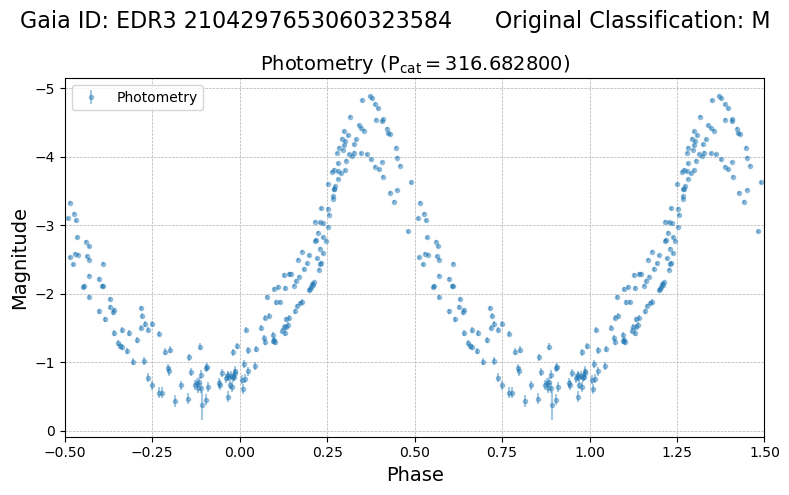

spec-56570-KP190808N440210V01_sp10-031.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



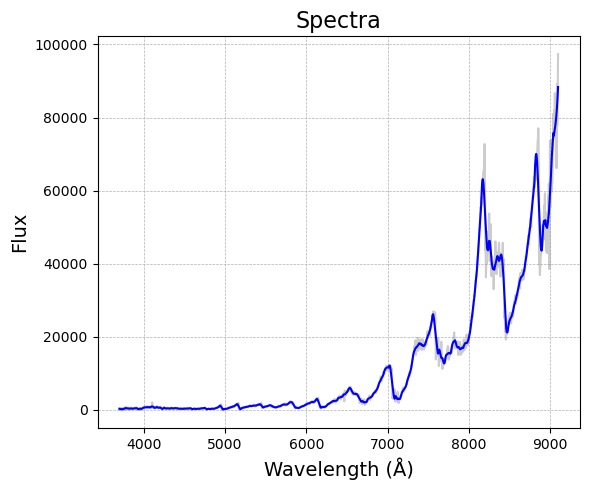

spec-56573-KP185031N425443V01_sp09-242.fits.gz


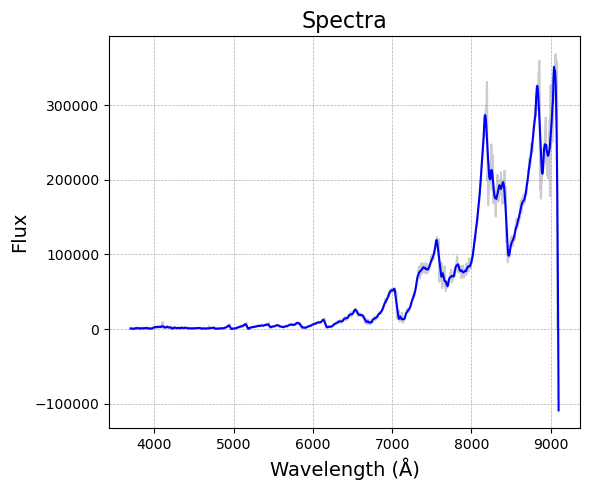

spec-57300-KP185031N425443V02_sp09-242.fits.gz


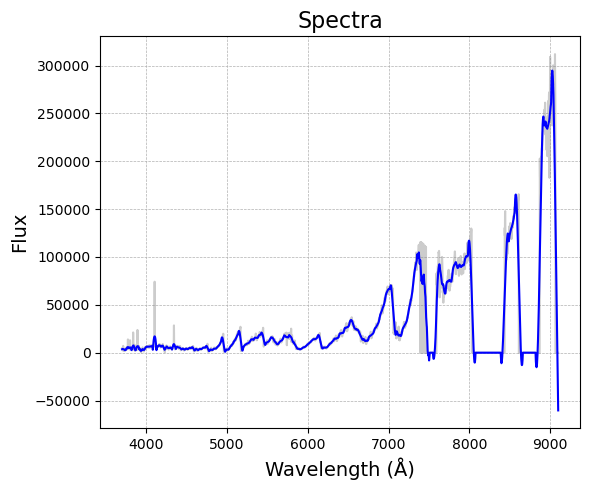

spec-57912-KP185031N425443V05_sp09-242.fits.gz


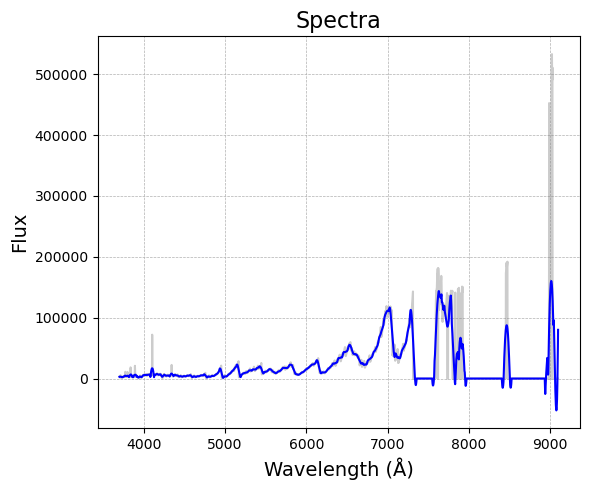

spec-57912-KP185031N425443V03_sp09-242.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



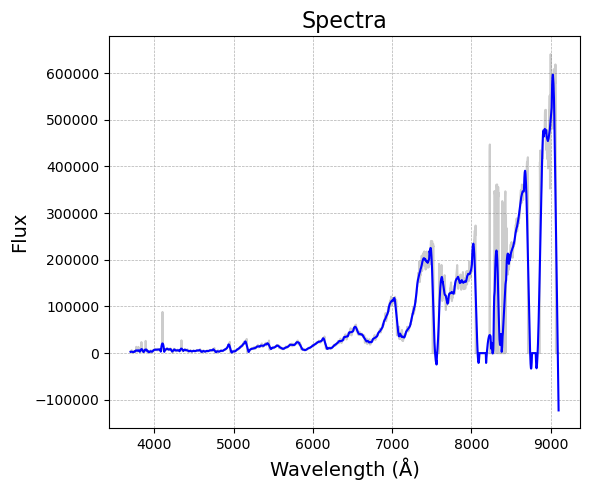

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288467  873cb6e7-e317-5891-b649-5069040305a8    270286   

                        asassn_name other_names   raj2000   dej2000  \
288467  ASASSN-VJ043002.42+425637.9      OP Per  67.51008  42.94386   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288467  2.458414e+06  2.524929e+17  J043002.41+425637.9     1641844.0   

                 edr3_source_id galex_id        tic_id  
288467  EDR3 252492919655121536      NaN  TIC 28338759   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
288467       3.22  263.55883            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288467      15.26        12.855626           0.030236         16.219429   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
288467    

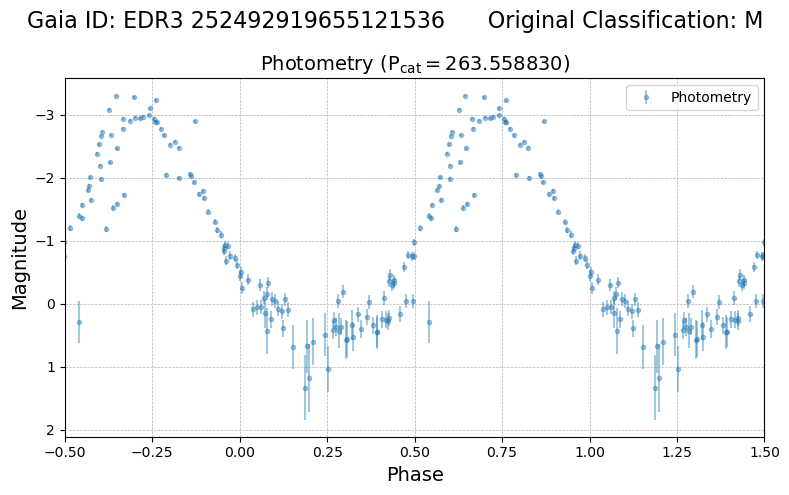

spec-56993-HD041808N420828V01_sp13-191.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



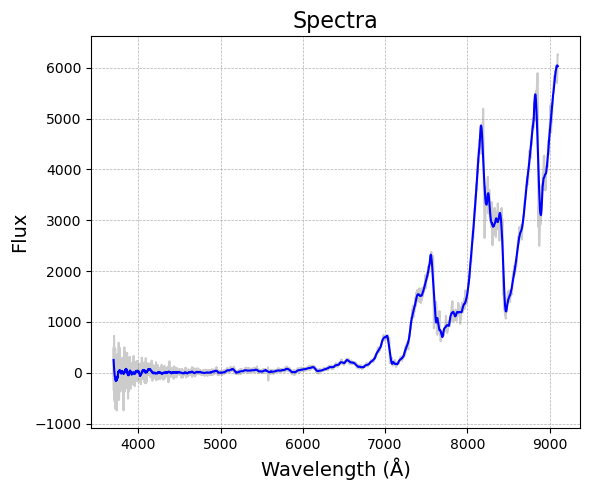

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288996  879e131d-a5b6-589f-ada1-0774ce32a341    277765   

                        asassn_name other_names    raj2000   dej2000  \
288996  ASASSN-VJ213321.43+380246.4   V1615 Cyg  323.33929  38.04621   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288996  2.457983e+06  1.952280e+18  J213321.45+380245.6    12012930.0   

                  edr3_source_id galex_id         tic_id  
288996  EDR3 1952279725162056192      NaN  TIC 468494283   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288996       2.68  303.936587            0.49       0.77 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288996      13.51        12.749068           0.023021         15.976887   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

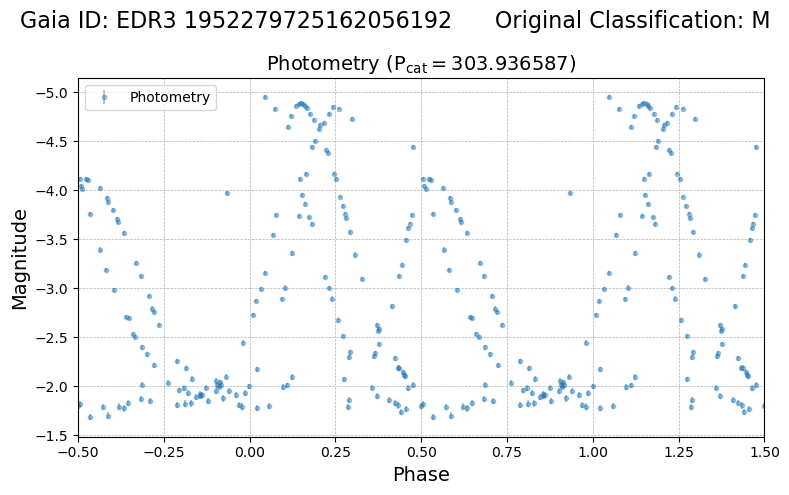

spec-57691-HD214203N365252V01_sp14-148.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



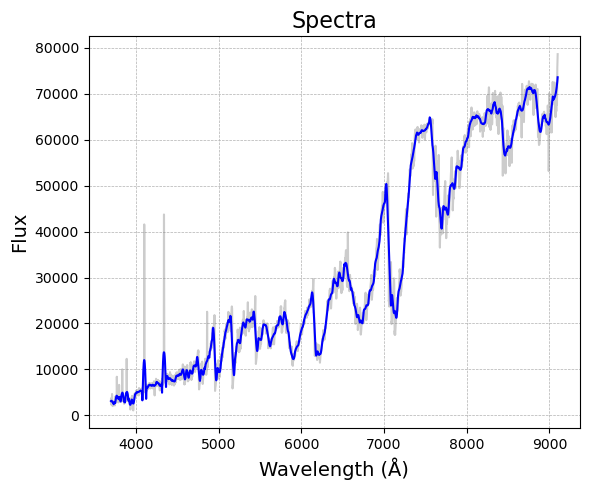

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
254402  04d46e82-d5ae-5a70-99a0-7647639f6890    112925   

                        asassn_name other_names    raj2000   dej2000  \
254402  ASASSN-VJ125859.78+151121.8      RX Com  194.74909  15.18939   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
254402  2.456788e+06  3.931222e+18  J125859.73+151121.6    27586110.0   

                  edr3_source_id galex_id        tic_id  
254402  EDR3 3931221984512388608      NaN  TIC 88122356   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
254402       3.89  208.414654            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
254402      13.77        13.445825           0.038231          16.06375   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2544

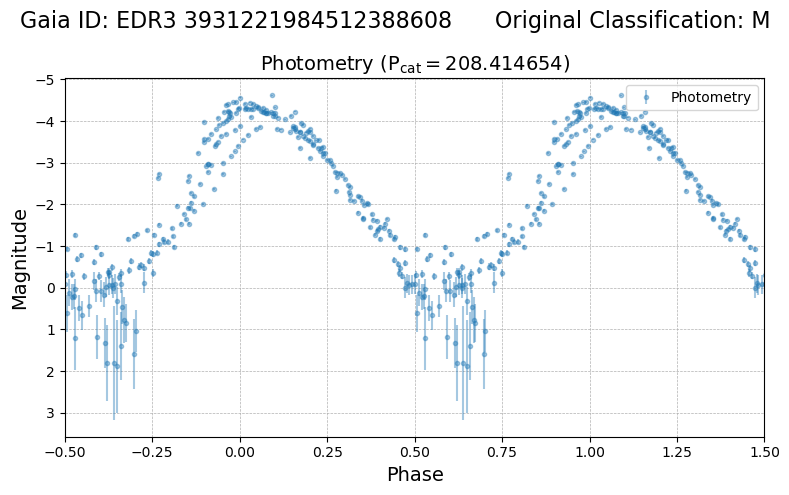

spec-56295-HD125855N172433B01_sp01-201.fits.gz


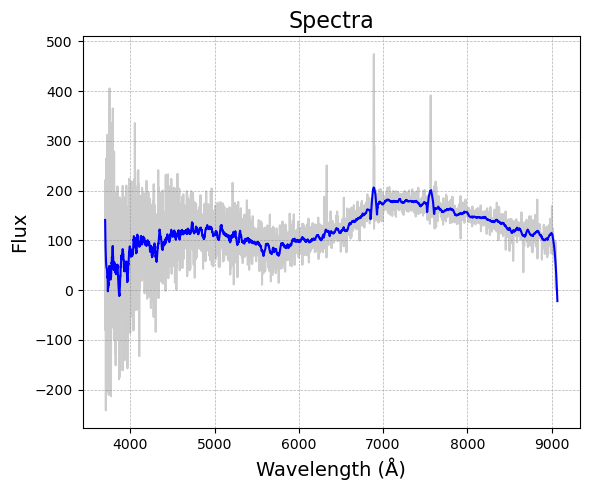

spec-57792-HD125855N172433V02_sp01-224.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



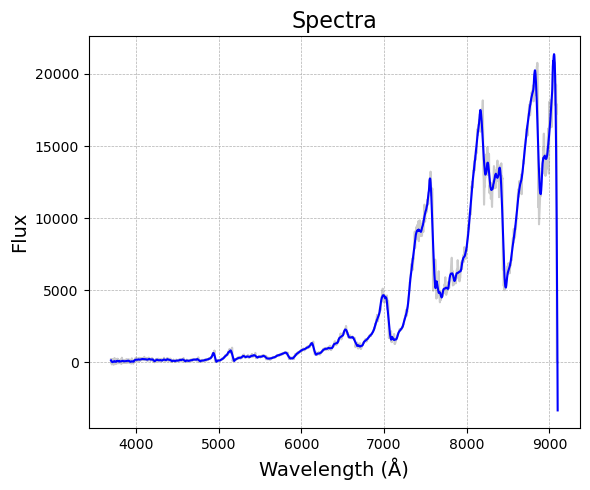

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
168874  7bbd0733-e5e8-55fa-a00d-7c51b9eb8e59     66150   

                        asassn_name           other_names    raj2000  \
168874  ASASSN-VJ211424.18+162824.3  NSVS J2114242+162824  318.60074   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
168874  16.47342  2.456758e+06  1.784836e+18  J211424.27+162825.1   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
168874     9819923.0  EDR3 1784835546038294656      NaN  TIC 230192072   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
168874       2.43  344.797268            0.14       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
168874      14.74        11.583988           0.019294         15.386584   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

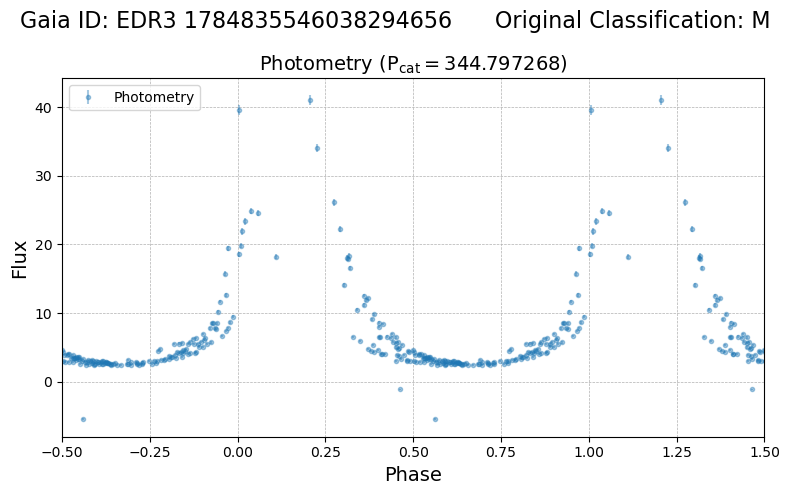

spec-58423-NT212020N164841M01_sp03-086.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



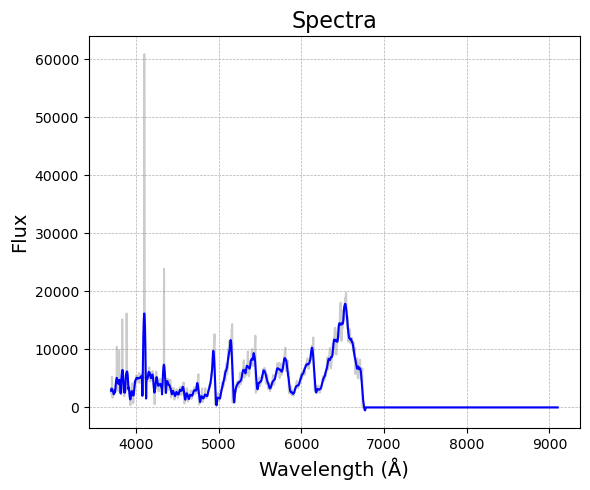

spec-59111-HD211542N164339V01_sp04-185.fits.gz


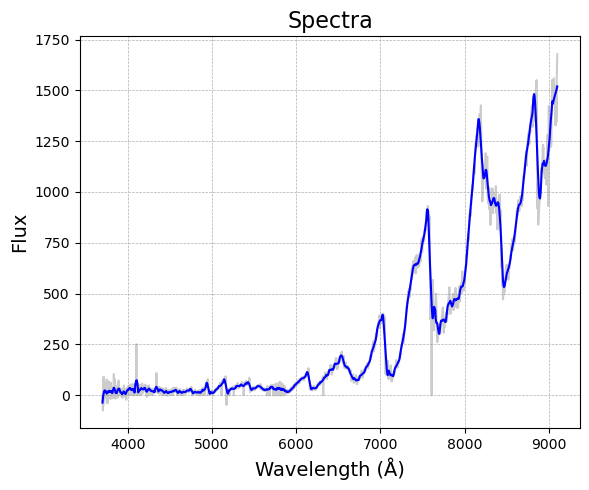

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
258315  b037a892-8639-5ec6-a2e4-a082ba449648    138705   

                        asassn_name other_names    raj2000   dej2000  \
258315  ASASSN-VJ081330.68+134805.1      SU Cnc  123.37784  13.80141   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
258315  2.457018e+06  6.507077e+17  J081330.63+134805.0     5335585.0   

                 edr3_source_id                galex_id        tic_id  
258315  EDR3 650707718808259968  GALEX J081330.5+134805  TIC 27636459   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
258315        4.1  188.750367            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
258315       13.2        11.790731           0.019322         14.557761   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

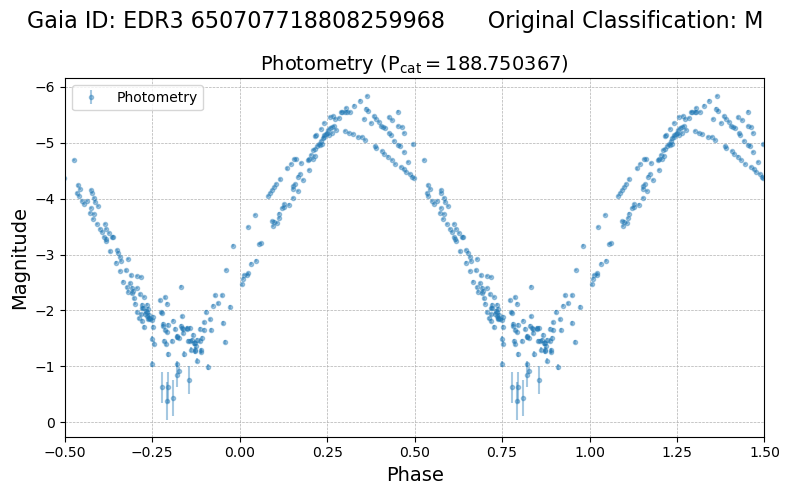

spec-57461-KP082157N144605V01_sp10-177.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



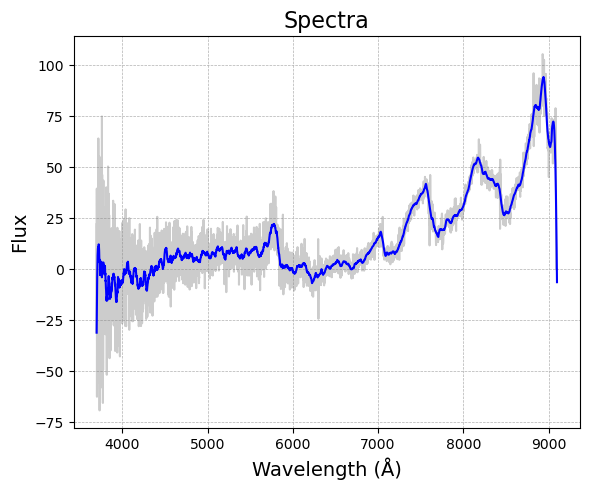

In [118]:
for name in eb_out_spec_names:
    plot_photometry_flux(name)

# Photo plots

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
159521  69f23d80-c4da-56e5-b87a-0bd16c6f3ab6    229485   

                        asassn_name          other_names    raj2000   dej2000  \
159521  ASASSN-VJ181218.94-264157.0  MACHO 167.24041.505  273.07892 -26.69917   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
159521  2.457960e+06  4.064540e+18  J181218.93-264156.9           NaN   

                  edr3_source_id galex_id         tic_id  
159521  EDR3 4064540410931578752      NaN  TIC 264880813   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
159521       0.06  253.476647            0.89       0.56 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
159521      13.75        14.339252           0.023634         18.508852   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

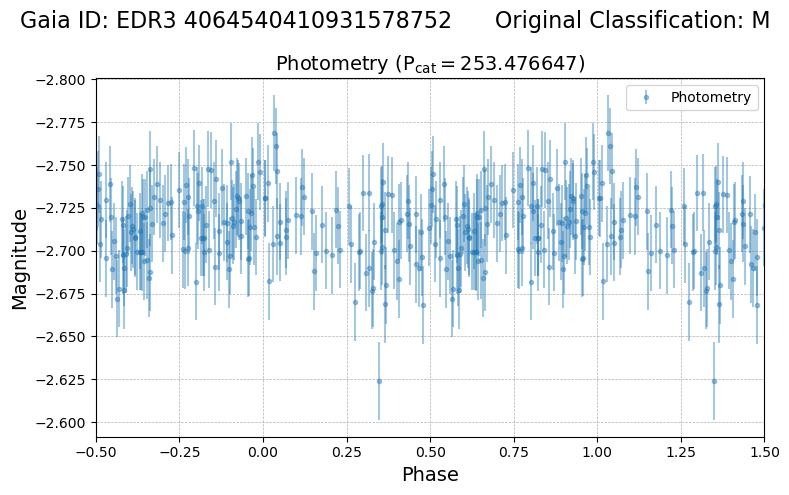

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426835  9a476f23-40a4-5f2d-a636-346dc04d28a7    187958   

                        asassn_name other_names    raj2000   dej2000  \
426835  ASASSN-VJ224250.35-211045.9      SZ Aqr  340.70978 -21.17941   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426835  2.457958e+06  2.400487e+18  J224250.33-211044.7    16446695.0   

                  edr3_source_id galex_id         tic_id  
426835  EDR3 2400487325161025024      NaN  TIC 444152253   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426835       2.05  106.182361            0.35       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426835        9.5         8.614436           0.014291          9.851378   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

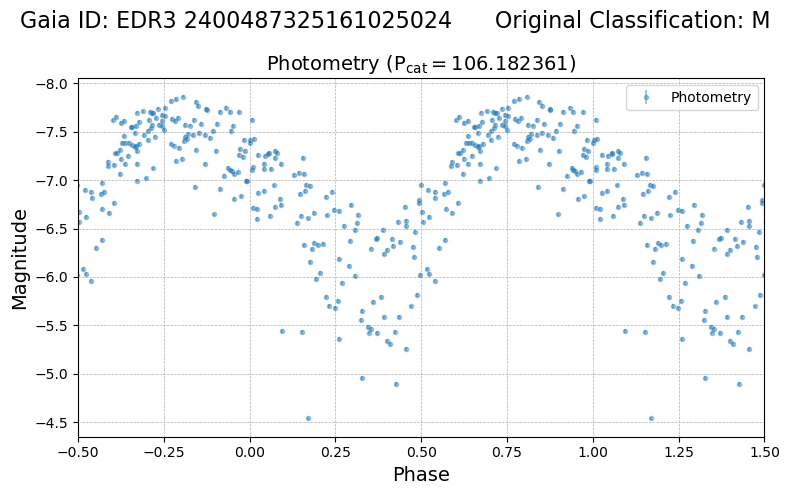

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
5268  f77e0d19-dd4c-5ac8-87c7-80c5c99c2fad    515280   

                      asassn_name other_names    raj2000   dej2000  \
5268  ASASSN-VJ181539.33-260503.7         NaN  273.91393 -26.08434   

        epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
5268  2457839.782  4.064678e+18  J181539.29-260504.0           NaN   

                edr3_source_id galex_id         tic_id  
5268  EDR3 4064678399501525248      NaN  TIC 404980635   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
5268        0.3   150.6            0.39       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
5268      13.88        12.554671           0.017211         15.720866   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5268             0.08873         10.97

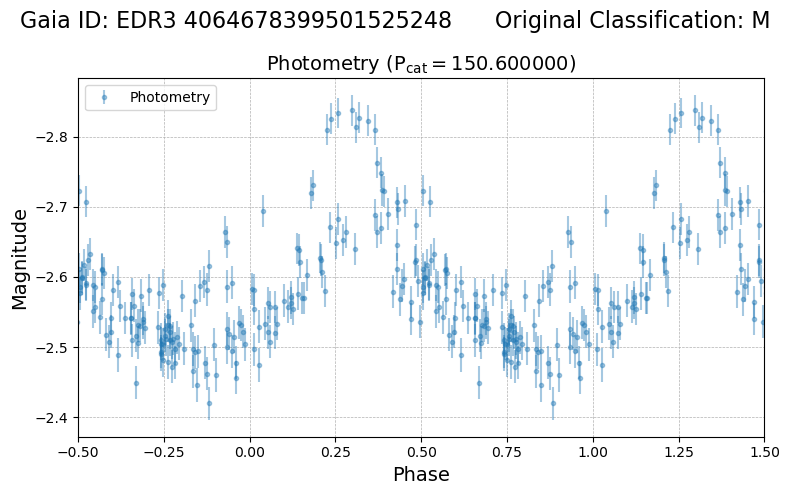

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
676265  f77573fd-5f18-5a47-851d-d76f3892806c    180068   

                        asassn_name other_names    raj2000  dej2000  \
676265  ASASSN-VJ152123.94-202318.6       S Lib  230.34973 -20.3885   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
676265  2.457866e+06  6.253131e+18  J152123.97-202318.1    56538606.0   

                  edr3_source_id                galex_id         tic_id  
676265  EDR3 6253131293853747584  GALEX J152123.9-202318  TIC 428817119   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
676265       2.53  192.606534            0.15       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
676265       9.77         9.082104           0.007654         11.377162   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

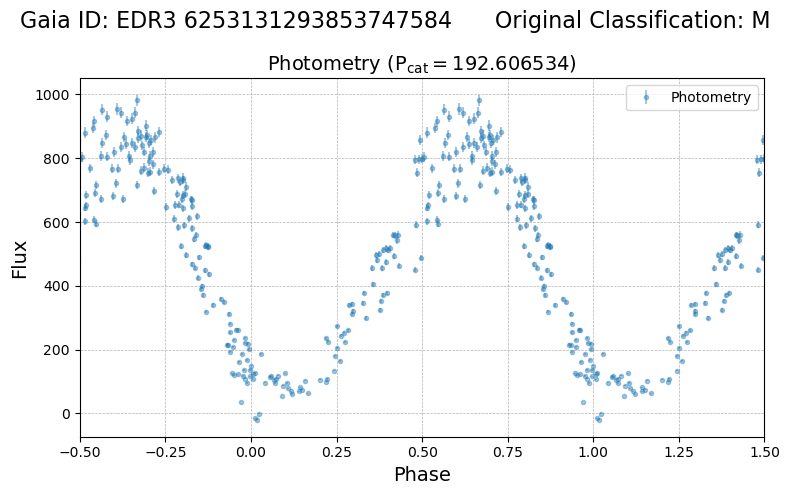

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
162859  ff3d3fde-cf25-5038-b196-f9bf05089502    225485   

                        asassn_name          other_names    raj2000   dej2000  \
162859  ASASSN-VJ181014.35-273625.2  MACHO 102.23117.494  272.55978 -27.60699   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
162859  2.457799e+06  4.050976e+18  J181014.34-273625.2           NaN   

                  edr3_source_id galex_id         tic_id  
162859  EDR3 4050975568428479744      NaN  TIC 249198955   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
162859       0.19  373.497105            0.82       0.56 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
162859      13.69        14.479864           0.066508         17.488247   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

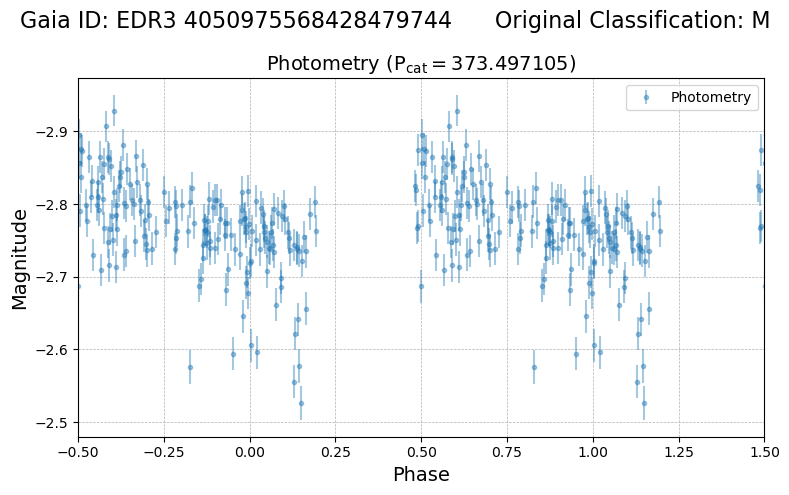

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427417  b67bde77-c288-5466-a8aa-88fd63bf7229     71490   

                        asassn_name other_names    raj2000   dej2000  \
427417  ASASSN-VJ184107.10-375010.8       U CrA  280.27957 -37.83632   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427417  2.457475e+06  6.729977e+18  J184107.03-375010.8    59620103.0   

                  edr3_source_id galex_id         tic_id  
427417  EDR3 6729976503150158336      NaN  TIC 316339410   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427417       2.65  146.538668            0.19        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427417       9.83         8.777882           0.030367         10.728712   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
427

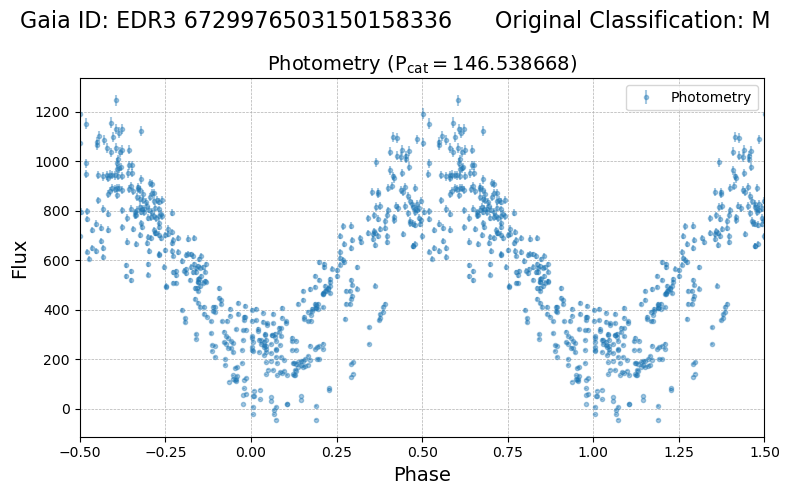

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
441745  4f1e6d23-6a00-5a60-a7ad-7a16916a8e48  AP53585883   

                        asassn_name other_names    raj2000   dej2000  \
441745  ASASSN-VJ162930.14-273855.2         NaN  247.37559 -27.64868   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
441745  2.457458e+06  6.044379e+18  J162930.06-273855.2    53585883.0   

                  edr3_source_id galex_id         tic_id  
441745  EDR3 6044379360537533440      NaN  TIC 175936425   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
441745       7.19  694.163245            0.23       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
441745      15.16         14.92938           0.002785         16.036818   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  

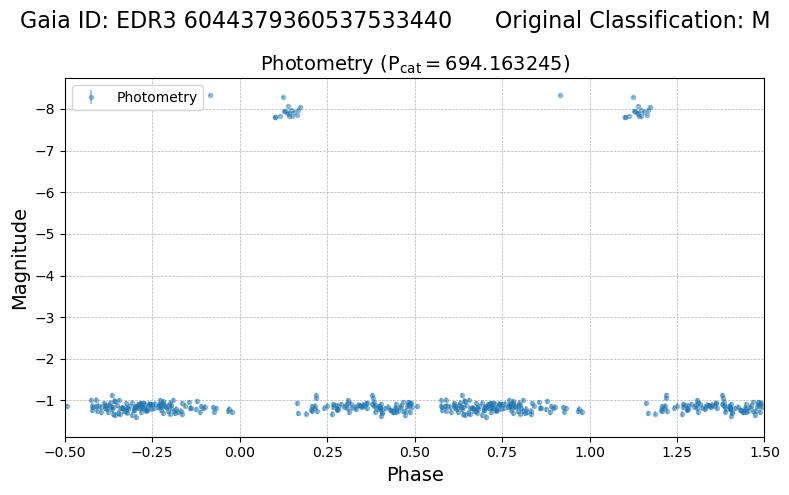

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427864  cb7635b7-5080-53ac-8854-5b3247911f6f    118745   

                        asassn_name other_names    raj2000   dej2000  \
427864  ASASSN-VJ222540.91-373410.0       T Gru  336.42047 -37.56945   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427864  2.458009e+06  6.594935e+18  J222540.92-373409.3    58256850.0   

                  edr3_source_id                galex_id         tic_id  
427864  EDR3 6594935103485951744  GALEX J222540.9-373409  TIC 278828827   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427864       2.67  136.174155             0.2        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427864       9.97         8.306191            0.00659          9.230468   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

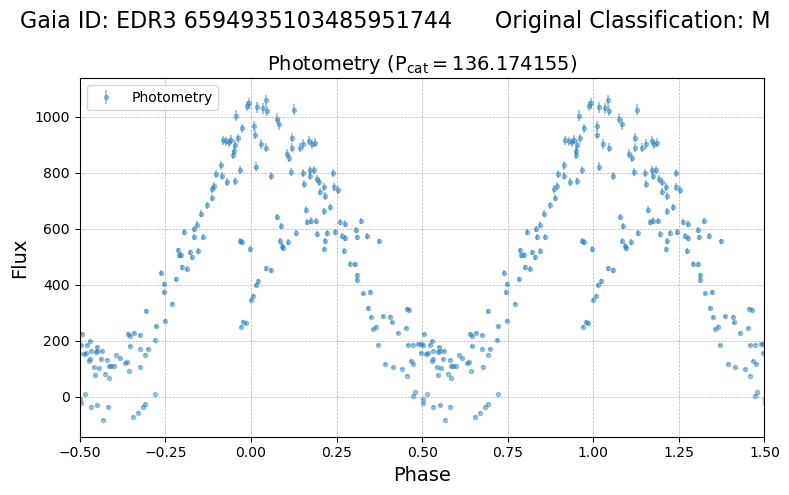

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
254544  e1680811-0529-581e-a847-80fd91fe7212    388938   

                        asassn_name other_names    raj2000  dej2000  \
254544  ASASSN-VJ184453.09-060738.7      AB Sct  281.22122 -6.12742   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
254544  2.457870e+06  4.253224e+18  J184453.04-060738.5           NaN   

                  edr3_source_id galex_id         tic_id  
254544  EDR3 4253223997887730432      NaN  TIC 164604827   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
254544       3.67  219.271561            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
254544      13.91        11.862877           0.038015         15.603677   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
25454

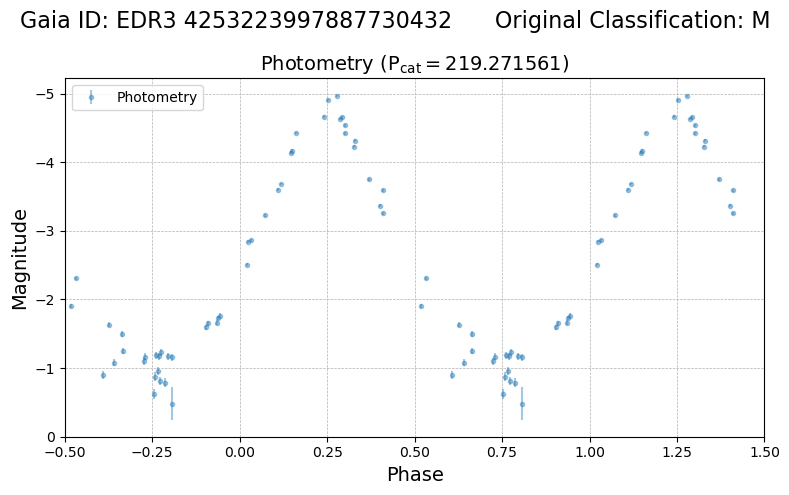

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
446550  1d6708a1-7697-50dd-9a31-2e85a4dda996  AP53586037   

                        asassn_name              other_names    raj2000  \
446550  ASASSN-VJ162928.12-272915.6  Gaia6044390355654168320  247.36716   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
446550 -27.48767  2.457458e+06  6.044390e+18  J162928.11-272915.9   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
446550    53586037.0  EDR3 6044390355654168320      NaN  TIC 175936041   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
446550       5.63  694.005945            0.28       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
446550      14.38        13.115072           0.004047         14.941299   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

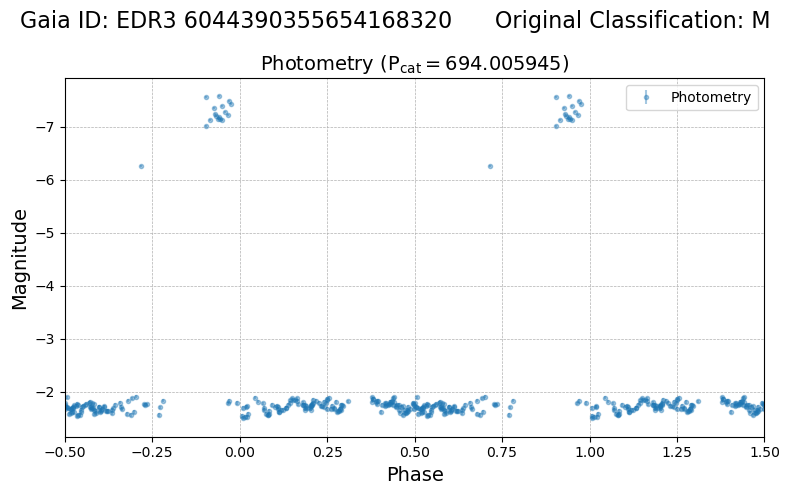

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427662  78d403b9-ccff-5801-b04a-c59469a83acd    296436   

                        asassn_name                other_names    raj2000  \
427662  ASASSN-VJ180359.70-280748.0  OGLEII DIA BUL-SC35 V1373  270.99874   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
427662   -28.13  2.457607e+06  4.062885e+18  J180359.83-280747.7   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
427662           NaN  EDR3 4062885439635665280      NaN  TIC 406562041   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427662       2.06  305.884548            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427662      16.06        14.022126           0.048532         17.482105   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

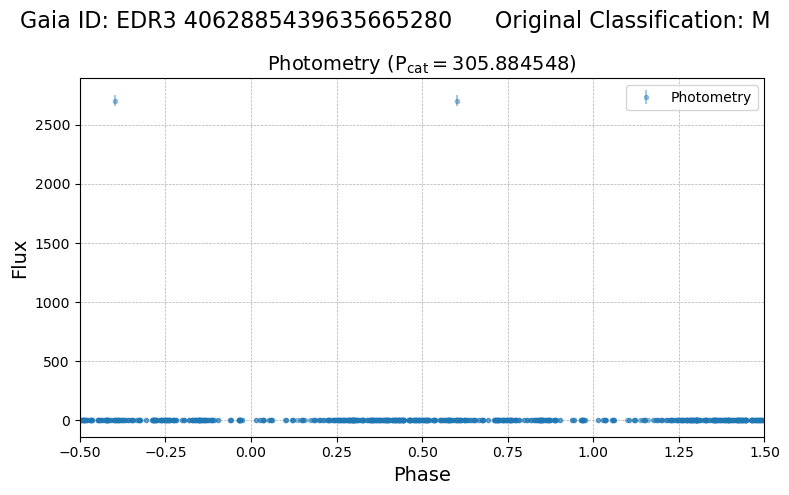

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288354  842f6c22-32bf-5674-9ad0-d9d36fc3bfd7     73795   

                        asassn_name other_names    raj2000   dej2000  \
288354  ASASSN-VJ084439.93-710740.7      AD Vol  131.16639 -71.12797   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288354  2.457758e+06  5.220795e+18  J084439.77-710740.6    38222601.0   

                  edr3_source_id galex_id         tic_id  
288354  EDR3 5220794573793445120      NaN  TIC 301927957   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288354       3.04  272.305289            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288354      14.46        13.183435           0.035303         15.928969   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

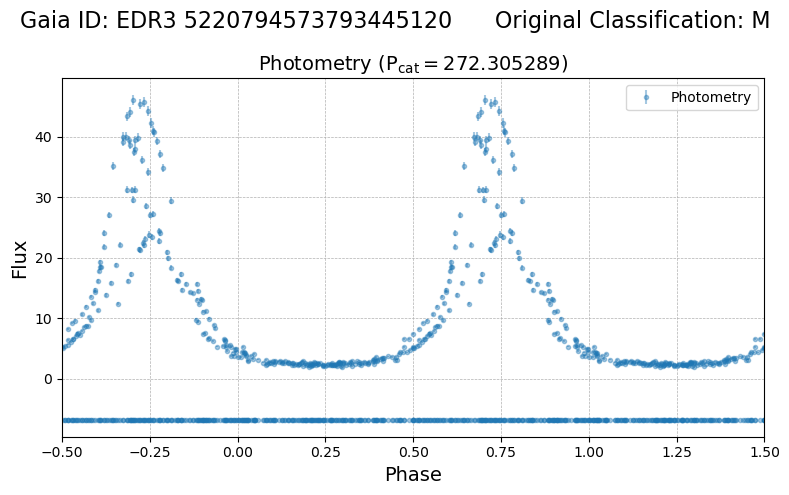

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426239  eabd7855-b01a-51ec-beaa-3dd753ab1dde     83604   

                        asassn_name other_names    raj2000   dej2000  \
426239  ASASSN-VJ195245.97+562050.4   V0392 Cyg  298.19153  56.34734   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426239  2.456598e+06  2.234200e+18  J195246.03+562050.0    15829671.0   

                  edr3_source_id galex_id         tic_id  
426239  EDR3 2234199690542273408      NaN  TIC 364968470   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
426239       1.86  96.46705             0.5       0.75 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426239      10.92         9.403685           0.026252         11.686132   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
426239

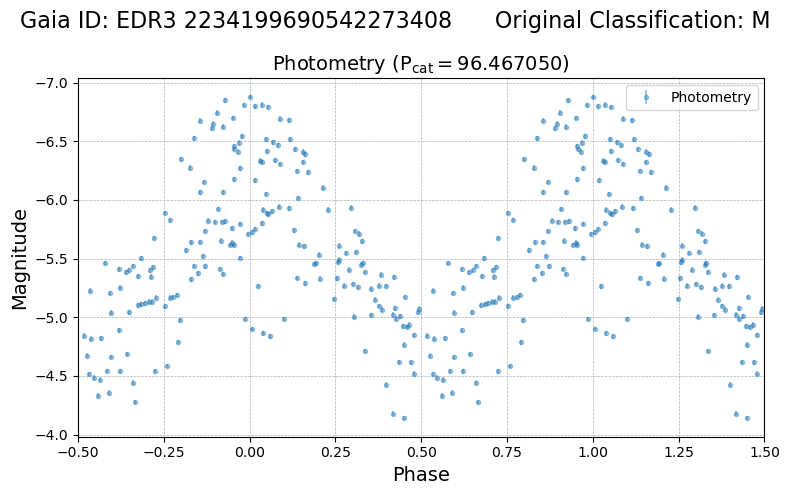

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
282528  85239ac8-d8df-58a9-bc1a-f73e486cff05    391150   

                        asassn_name other_names    raj2000  dej2000  \
282528  ASASSN-VJ185648.67-055700.2      BF Sct  284.20279 -5.95005   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
282528  2.457210e+06  4.253884e+18  J185648.62-055700.0           NaN   

                  edr3_source_id galex_id        tic_id  
282528  EDR3 4253884009673934080      NaN  TIC 35434822   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
282528       3.03  253.400093            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
282528      14.07        12.933081           0.029337         16.756926   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
282528

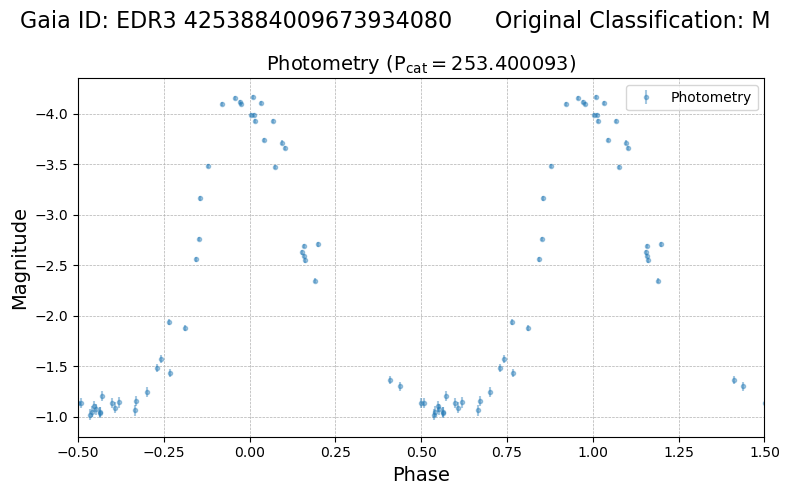

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
239045  1ab30ead-9e70-52bb-a30a-b020373e186d    388726   

                        asassn_name other_names    raj2000  dej2000  \
239045  ASASSN-VJ184402.31-063844.3   V0482 Sct  281.00962 -6.64564   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
239045  2.458021e+06  4.253168e+18  J184402.23-063844.3    31642523.0   

                  edr3_source_id galex_id         tic_id  
239045  EDR3 4253167544829765888      NaN  TIC 163732595   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
239045       2.47  388.967975            0.08       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
239045      13.54        11.801669           0.021399         16.072008   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2390

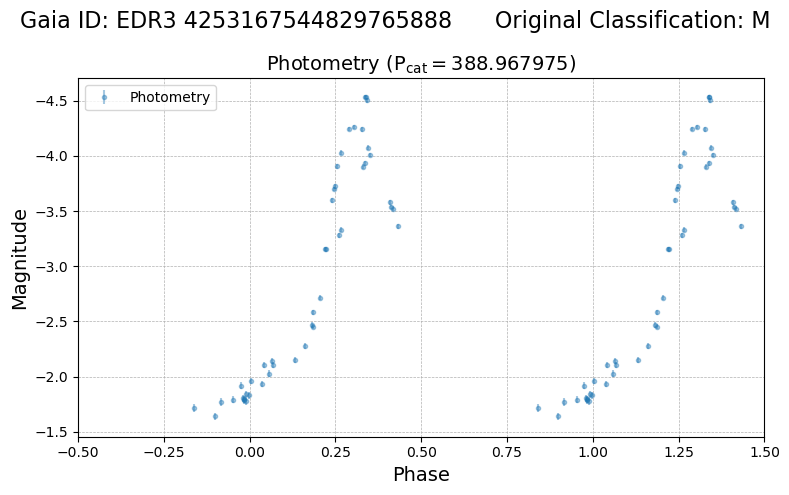

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236803  e3e28443-8354-50d1-b625-82bfb75b6016    391571   

                        asassn_name other_names    raj2000  dej2000  \
236803  ASASSN-VJ185648.12-064156.4      DX Sct  284.20049   -6.699   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236803  2.457974e+06  4.253680e+18  J185648.18-064155.1           NaN   

                  edr3_source_id galex_id        tic_id  
236803  EDR3 4253679504884151552      NaN  TIC 35442113   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
236803        2.6  295.659629            0.04       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236803       14.6        12.394084            0.02939         16.169676   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
236803

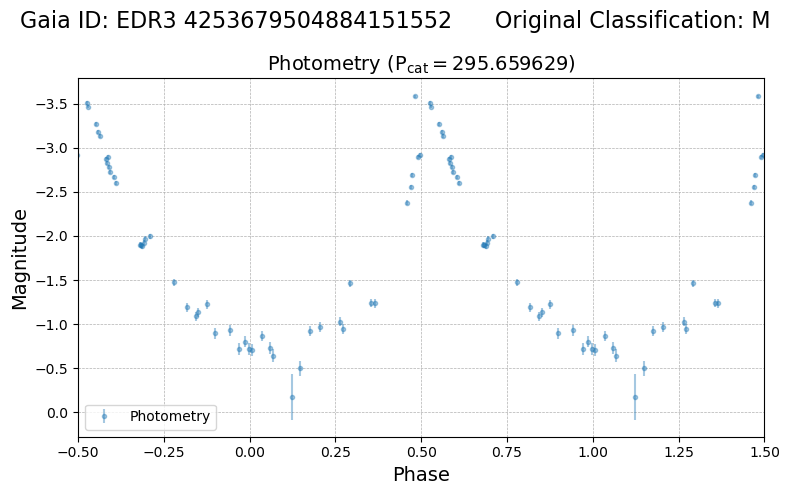

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428413  8bfe2a2f-d6af-5f63-8d4b-44bc140d73bf    391194   

                        asassn_name other_names    raj2000  dej2000  \
428413  ASASSN-VJ185549.87-055613.5   NSV 11545  283.95778 -5.93707   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428413  2.457984e+06  4.253980e+18  J185549.81-055613.2           NaN   

                  edr3_source_id galex_id        tic_id  
428413  EDR3 4253979534134963712      NaN  TIC 34703153   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428413       2.09  218.216695            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428413      15.11        13.579091           0.062609         15.993764   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
428413

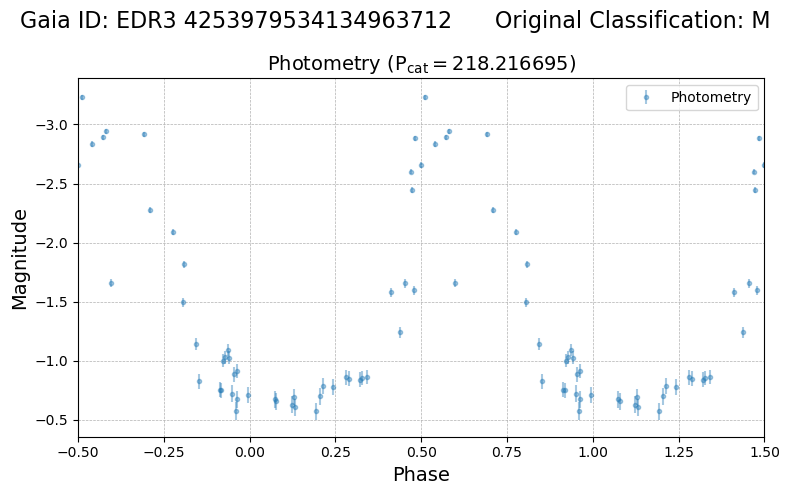

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
568727  6f11ac5e-31e3-5dc5-ad2a-050b71fe827c    175239   

                        asassn_name other_names   raj2000   dej2000  \
568727  ASASSN-VJ053220.76-103721.4      FP Ori  83.08649 -10.62262   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
568727  2.456972e+06  3.013475e+18  J053220.71-103721.7    19611817.0   

                  edr3_source_id galex_id         tic_id  
568727  EDR3 3013475125051800064      NaN  TIC 199782459   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
568727       2.14  144.999446            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
568727      11.04        10.420975           0.023129         11.922138   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5687

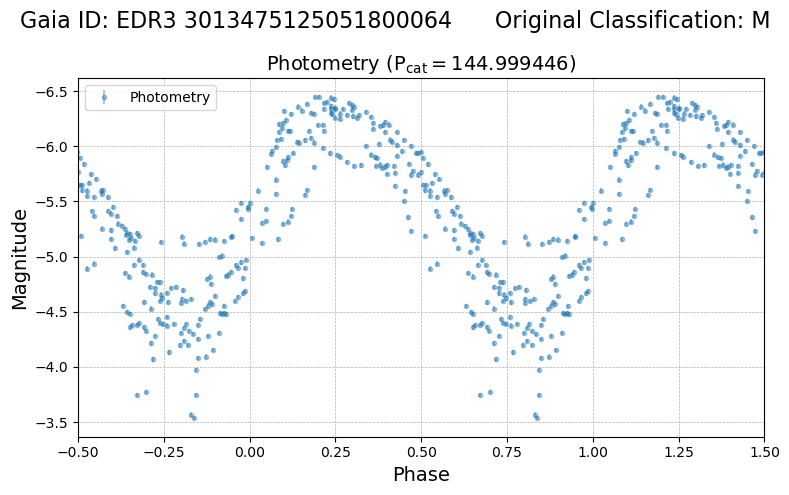

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
94845  306e8a5f-3e5e-5661-b0a3-dbfc8babb8ff    120906   

                       asassn_name other_names   raj2000   dej2000  \
94845  ASASSN-VJ061213.23+501340.0       X Aur  93.05514  50.22778   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
94845  2.458055e+06  9.716688e+17  J061213.39+501340.6     6765720.0   

                edr3_source_id galex_id         tic_id  
94845  EDR3 971668838130849664      NaN  TIC 241209012   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude      period  lksl_statistic  rfr_score
94845       3.55  165.835786            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
94845      10.46         9.195858           0.059102         12.107069   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
94845            0.

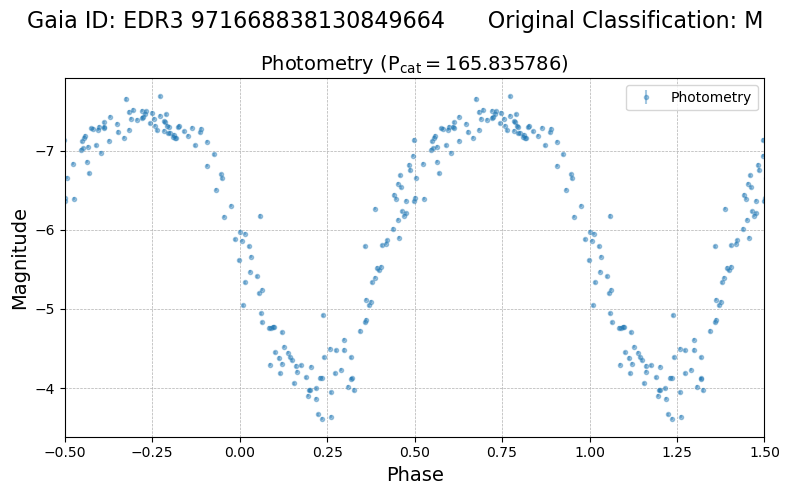

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
158078  2e5e33fe-eb00-51cc-ac55-61dced6de282    383863   

                        asassn_name    other_names   raj2000  dej2000  \
158078  ASASSN-VJ185027.82-051848.3  NSVS 13955380  282.6159 -5.31342   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
158078  2.457961e+06  4.254883e+18  J185027.75-051848.6           NaN   

                  edr3_source_id galex_id         tic_id  
158078  EDR3 4254882508049120896      NaN  TIC 183163093   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
158078       2.08  278.740102             0.1       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
158078      15.74        13.279238           0.035691         16.952364   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \


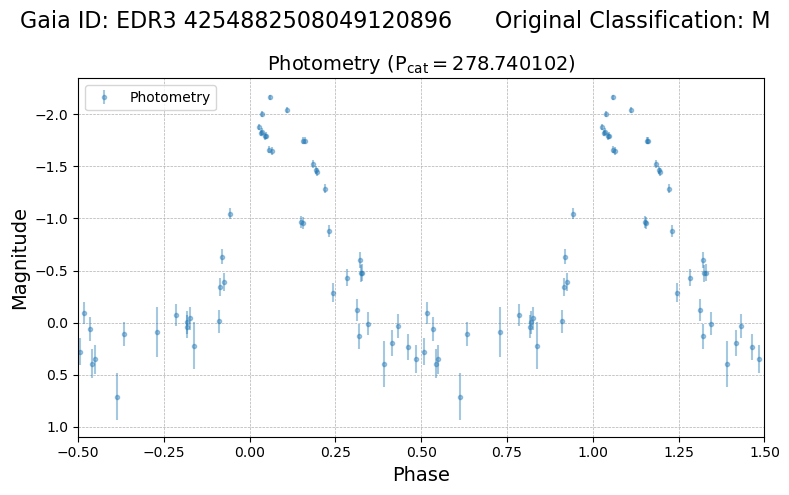

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
424633  0c48c017-f89e-50c3-9117-99298125c06b  AP53653266   

                        asassn_name other_names    raj2000   dej2000  \
424633  ASASSN-VJ162112.39-253127.9         NaN  245.30162 -25.52442   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
424633  2.457426e+06  6.048611e+18  J162112.43-253126.0    53653266.0   

                  edr3_source_id galex_id         tic_id  
424633  EDR3 6048611380792138240      NaN  TIC 322928306   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
424633       6.17  760.628425            0.28       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
424633      14.99        15.282268           0.002777          16.26364   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  

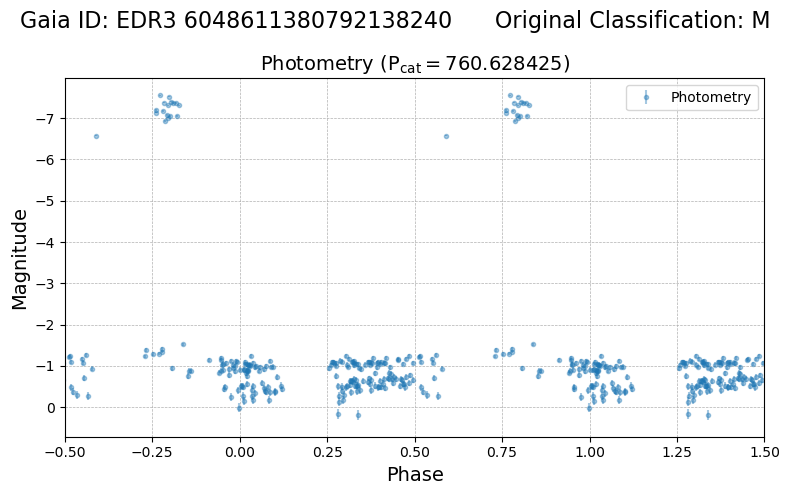

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426616  fd29151b-3afa-520f-a042-58ab36733868     65868   

                        asassn_name other_names    raj2000   dej2000  \
426616  ASASSN-VJ163302.23-673519.2      KM TrA  248.25931 -67.58867   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426616  2.457466e+06  5.809522e+18  J163302.19-673519.0    47833131.0   

                  edr3_source_id galex_id         tic_id  
426616  EDR3 5809522439899529344      NaN  TIC 363142328   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426616       1.83  126.931749            0.55       0.71 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426616      11.33        10.878348           0.014787         12.269298   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

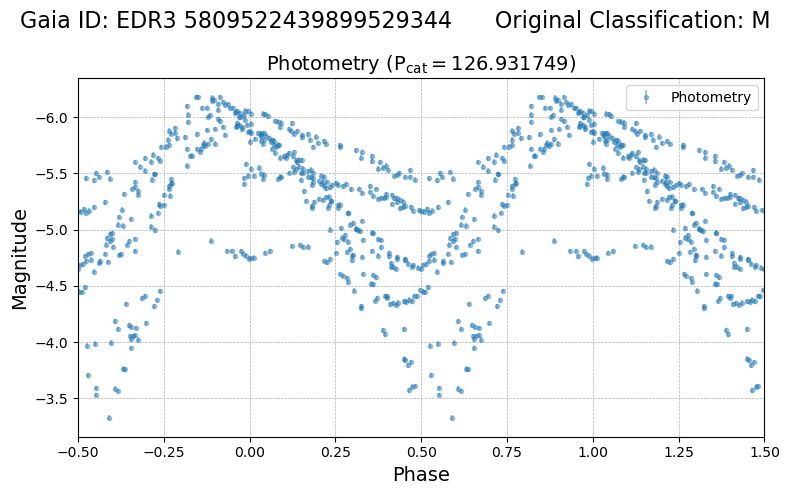

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427969  b9a9f5a5-bf46-57d3-a199-ff1ba37818b3     84376   

                        asassn_name other_names    raj2000   dej2000  \
427969  ASASSN-VJ111611.74-301051.3      BD Hya  169.04891 -30.18093   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427969  2.457830e+06  3.482765e+18  J111611.78-301051.3    26054849.0   

                  edr3_source_id                galex_id        tic_id  
427969  EDR3 3482765310763451392  GALEX J111611.8-301051  TIC 23556166   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
427969       3.04  118.45906            0.24       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427969      10.66         9.893835           0.025699         11.551869   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

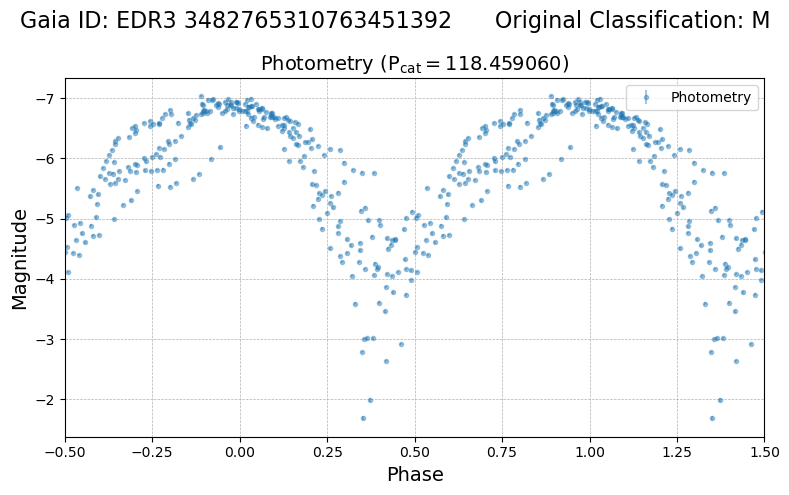

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427260  339161d0-81b7-5bde-812c-2378f365decb    100769   

                        asassn_name other_names    raj2000   dej2000  \
427260  ASASSN-VJ232114.21+785732.6      RY Cep  350.30921  78.95905   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427260  2.457548e+06  2.282844e+18  J232114.55+785732.5    16122811.0   

                  edr3_source_id galex_id         tic_id  
427260  EDR3 2282843704159097728      NaN  TIC 428988626   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427260       3.28  149.827543             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427260       10.8         9.975496           0.027196         12.031353   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

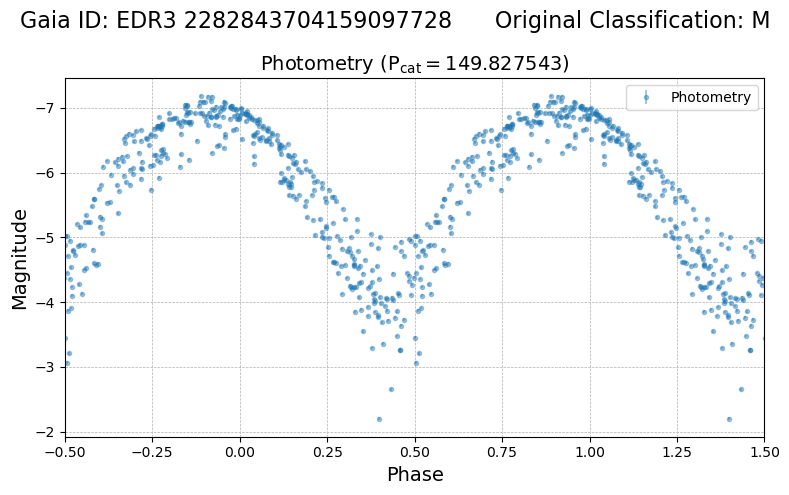

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
447398  1dfb2558-91dd-5e65-8dc9-64337ba13ea1  AP60168838   

                        asassn_name              other_names    raj2000  \
447398  ASASSN-VJ191533.19-251754.2  Gaia6770082800376472448  288.88829   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
447398 -25.29838  2.457458e+06  6.770083e+18  J191533.20-251754.2   

        apass_dr9_id            edr3_source_id galex_id       tic_id  
447398    60168838.0  EDR3 6770082800376472448      NaN  TIC 2291270   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
447398       7.67  757.269186            0.28       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
447398       16.0        13.783845           0.046489         17.687824   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

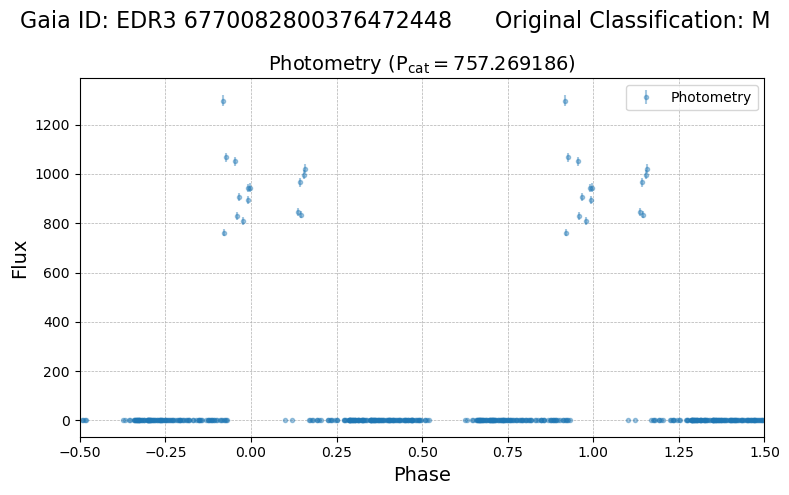

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
119780  b288ad7c-3778-5693-a3ea-80c809d8df8c    106122   

                        asassn_name other_names  raj2000   dej2000  \
119780  ASASSN-VJ002912.16-375430.5       T Scl  7.30065 -37.90847   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
119780  2.458024e+06  4.997786e+18  J002912.14-375430.9    37466771.0   

                  edr3_source_id                galex_id         tic_id  
119780  EDR3 4997785578130586240  GALEX J002912.1-375431  TIC 115942898   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
119780       3.42  197.763929            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
119780      10.41         9.095931            0.03379         12.504541   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

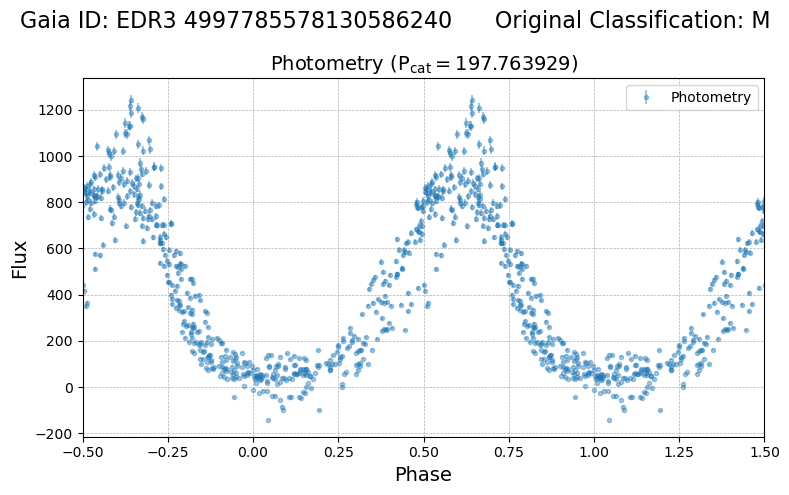

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
261139  13700aa8-a934-54db-b048-3e27d9638c93    391275   

                        asassn_name           other_names    raj2000  dej2000  \
261139  ASASSN-VJ185651.03-043613.3  NSVS J1856512-043604  284.21261  -4.6037   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
261139  2.457662e+06  4.255348e+18  J185650.96-043613.5           NaN   

                  edr3_source_id galex_id        tic_id  
261139  EDR3 4255347773240372992      NaN  TIC 58303298   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
261139       2.35  329.936568            0.09       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
261139      15.55        13.399094           0.031374         17.158514   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

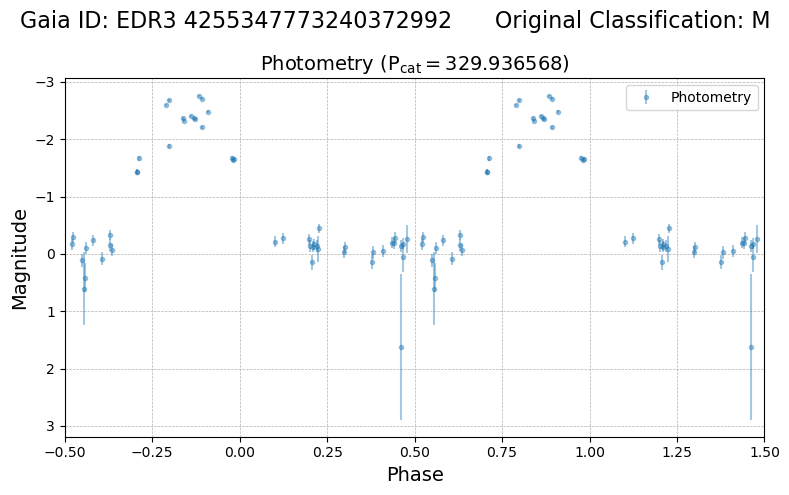

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428236  41cb21d3-35f2-5878-b1ce-79a71db9618f     99914   

                        asassn_name other_names    raj2000  dej2000  \
428236  ASASSN-VJ163255.65+065129.7      SS Her  248.23188  6.85826   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428236  2.457241e+06  4.439156e+18  J163255.54+065129.7    34154335.0   

                  edr3_source_id                galex_id         tic_id  
428236  EDR3 4439156224372091648  GALEX J163255.6+065127  TIC 291163046   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428236       3.33  108.005108            0.23       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428236      10.66         9.165827            0.02556         10.967602   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

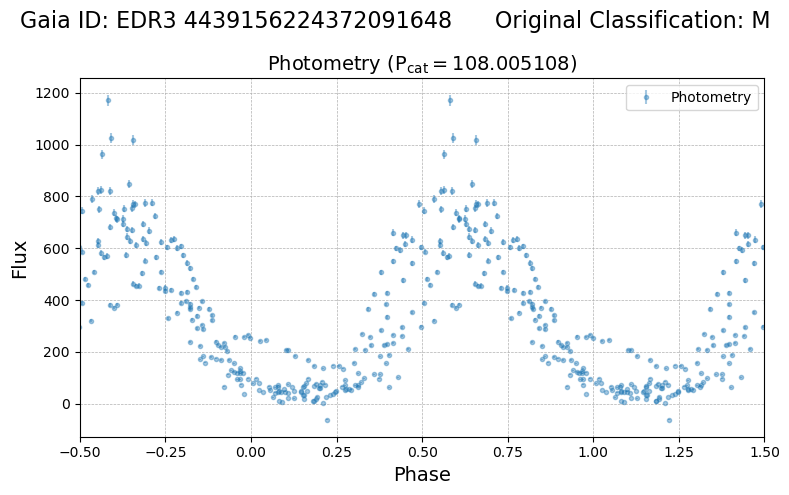

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427447  b2e6aeb7-32c8-514c-b4b1-01ec047ab6c1    194754   

                        asassn_name other_names    raj2000   dej2000  \
427447  ASASSN-VJ193131.25+344217.5      DD Cyg  292.88021  34.70487   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427447  2.457938e+06  2.046782e+18  J193131.39+344217.6           NaN   

                  edr3_source_id galex_id        tic_id  
427447  EDR3 2046781508322306176      NaN  TIC 22249526   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427447        2.5  146.699863             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427447      10.84        10.104266           0.020235         11.907889   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4274

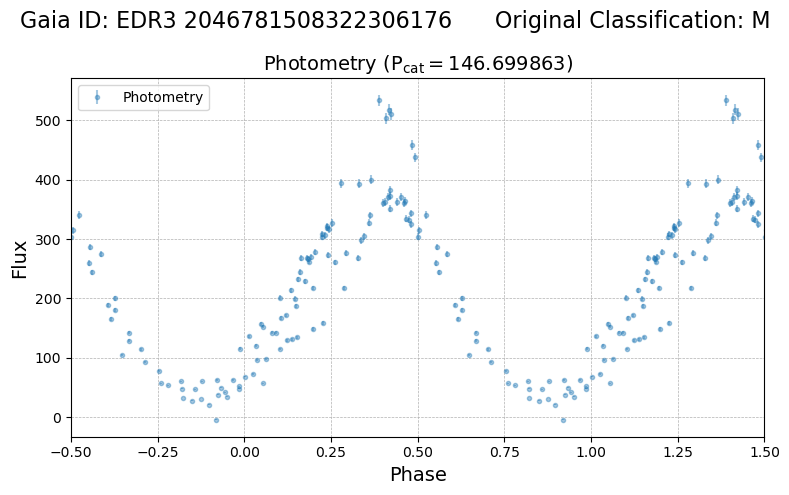

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287151  da6a5f9f-b9d5-58ec-a439-1fcd67292887    261651   

                        asassn_name other_names   raj2000  dej2000  \
287151  ASASSN-VJ031926.08-010356.5       X Cet  49.85866  -1.0657   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287151  2.458074e+06  3.262687e+18  J031926.07-010356.2    23469058.0   

                  edr3_source_id                galex_id         tic_id  
287151  EDR3 3262686651029849216  GALEX J031926.0-010354  TIC 279070339   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
287151       3.52  180.92928            0.26       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287151      11.05         9.215746           0.037042         11.974611   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

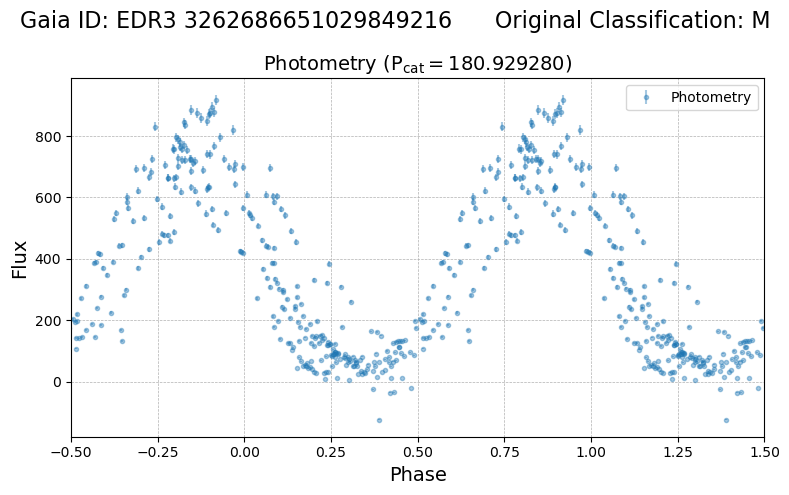

spec-56231-EG032049S030630V_sp11-007.fits.gz


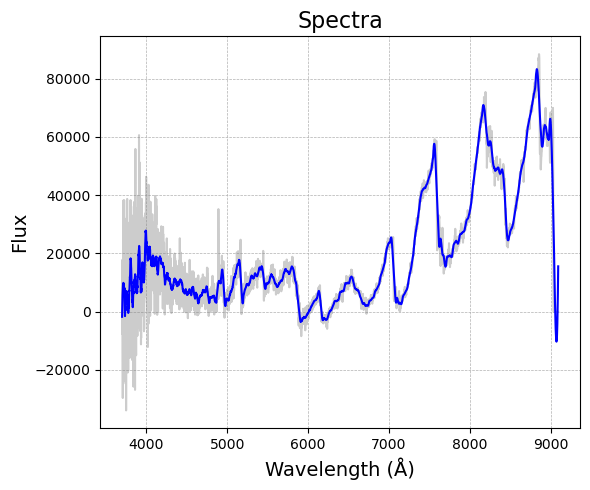

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427943  51f03add-361a-5aaa-9a0e-4c69817ef589    191841   

                        asassn_name other_names   raj2000   dej2000  \
427943  ASASSN-VJ092658.51-733236.3      UU Car  141.7438 -73.54341   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427943  2.457703e+06  5.217819e+18  J092658.41-733236.5    38181712.0   

                  edr3_source_id galex_id         tic_id  
427943  EDR3 5217818500758426880      NaN  TIC 452551562   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427943       4.01  200.400543            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427943      10.31         9.420103            0.04378         12.555837   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4279

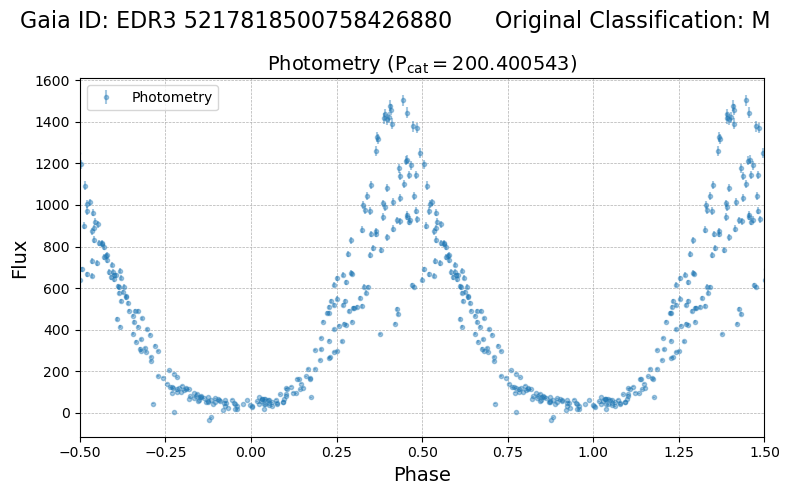

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427369  627290f7-914b-5abd-8a63-d00bde5dacbb    202069   

                        asassn_name other_names   raj2000   dej2000  \
427369  ASASSN-VJ200916.78-571953.7      BR Pav  302.3199 -57.33157   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427369  2.457238e+06  6.447669e+18  J200916.83-571954.4    57712676.0   

                  edr3_source_id galex_id         tic_id  
427369  EDR3 6447668715086198016      NaN  TIC 367024309   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427369        3.0  249.830829            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427369      10.93         9.157163           0.023352         12.480925   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4273

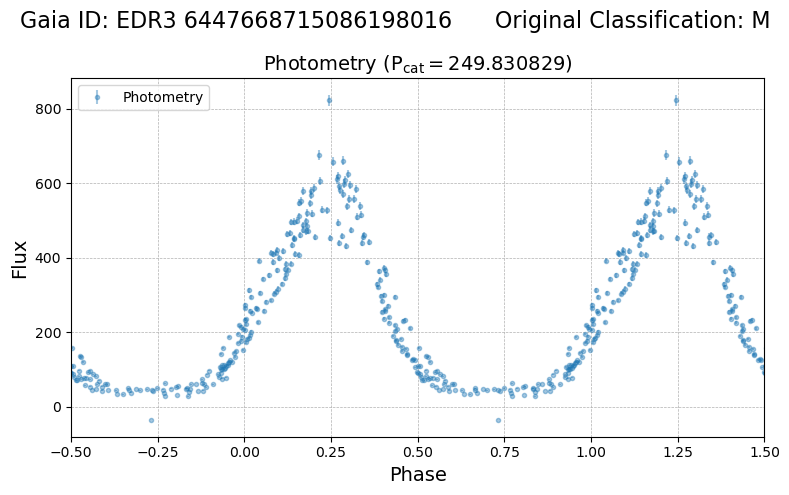

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
202748  89bac85d-68c4-5ec2-b773-a1eb8c7aefeb     63441   

                        asassn_name other_names    raj2000   dej2000  \
202748  ASASSN-VJ162313.17+440828.4      AY Her  245.80486  44.14123   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
202748  2.457604e+06  1.382519e+18  J162313.17+440828.2     8403538.0   

                  edr3_source_id galex_id         tic_id  
202748  EDR3 1382518881315698432      NaN  TIC 193554866   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
202748       2.38  130.999141            0.25       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
202748      11.72        11.331485           0.023682         12.876404   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
20

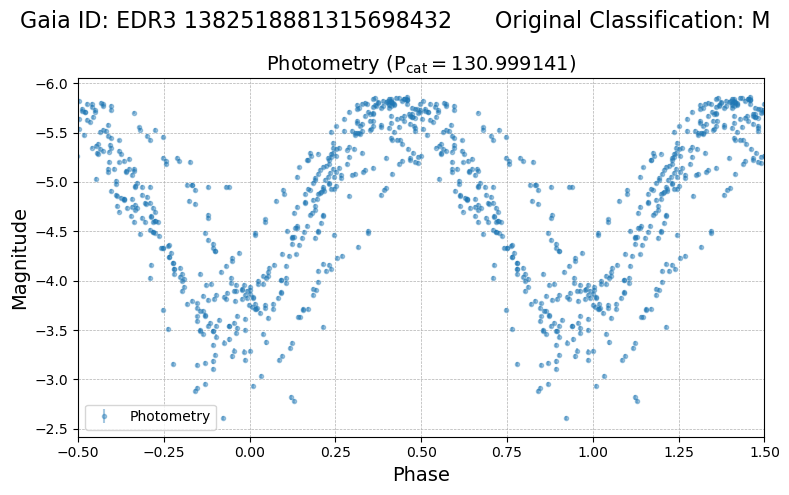

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
624073  19e6fe23-7ced-47e3-b644-7095955dd75d  20840992   

                        asassn_name                     other_names  \
624073  ASASSN-VJ074800.82-023540.6  V0870 Mon                        

          raj2000  dej2000     epoch_hjd       gdr2_id           allwise_id  \
624073  117.00342 -2.59461  2.457649e+06  3.081801e+18  J074800.79-023540.1   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
624073    20840992.0  EDR3 3081800633028790400      NaN  TIC 68421212   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
624073       4.45  291.670706             0.3       0.76 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
624073      12.56         9.829725            0.04297         14.325352   

        e_phot_bp_mean_mag  phot_rp_mean_mag

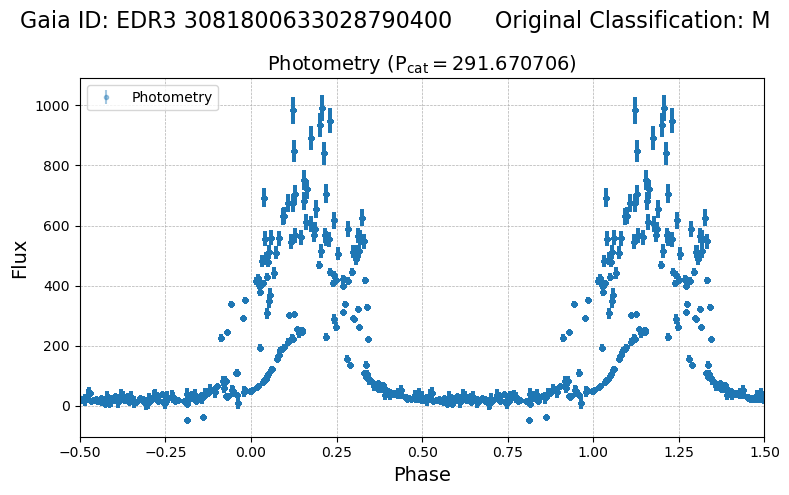

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
260667  70f64491-5e11-59be-9c7f-f87eab98332a    122995   

                        asassn_name other_names    raj2000   dej2000  \
260667  ASASSN-VJ082807.98+382022.8      RX Lyn  127.03323  38.33966   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
260667  2.457018e+06  9.111583e+17  J082808.03+382022.9     6288082.0   

                 edr3_source_id                galex_id        tic_id  
260667  EDR3 911158315206840704  GALEX J082808.1+382024  TIC 88642757   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
260667       2.48   145.3            0.46       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
260667      11.22        10.627837           0.025184         12.386459   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

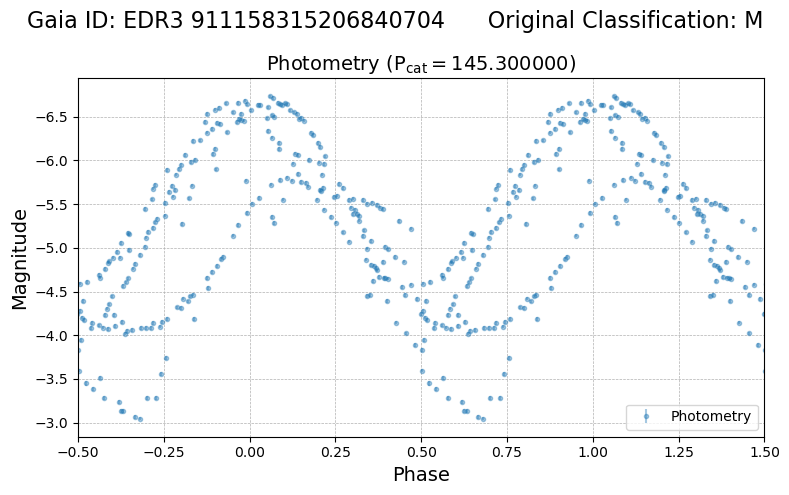

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
666180  2769387e-16ff-5f56-981a-97ac4e3961d4    132702   

                        asassn_name other_names   raj2000  dej2000  \
666180  ASASSN-VJ045900.59+080749.5       R Ori  74.75245  8.13043   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
666180  2.457246e+06  3.288734e+18  J045900.56+080749.8    23576076.0   

                  edr3_source_id                galex_id         tic_id  
666180  EDR3 3288734390731232000  GALEX J045900.5+080749  TIC 450022383   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
666180       3.46  381.843943            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
666180       10.8        10.447359           0.007828         12.744626   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

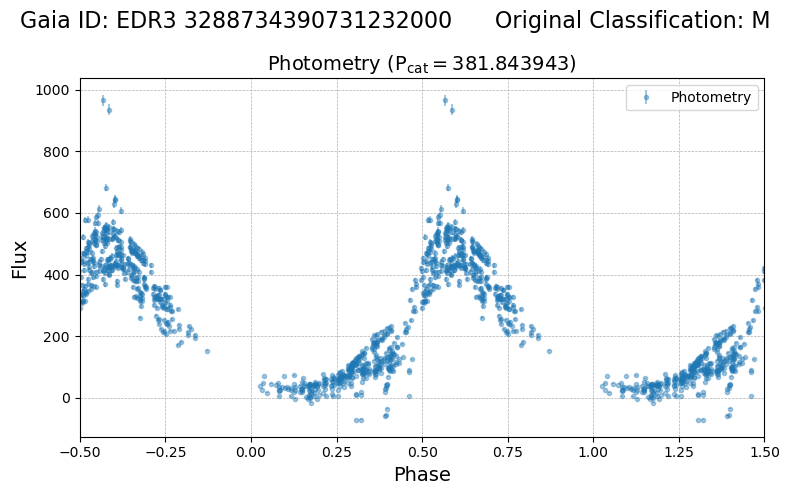

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
415942  729775dc-3aa5-5670-b9d6-90847fef7831    175244   

                        asassn_name other_names   raj2000   dej2000  \
415942  ASASSN-VJ052427.85-103923.5   V1641 Ori  81.11606 -10.65653   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
415942  2.457317e+06  3.013257e+18  J052427.85-103923.3           NaN   

                  edr3_source_id galex_id        tic_id  
415942  EDR3 3013256871994421632      NaN  TIC 24696683   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
415942       2.34  395.227561            0.29       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
415942      10.88         9.331677           0.013394         11.243522   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
415942

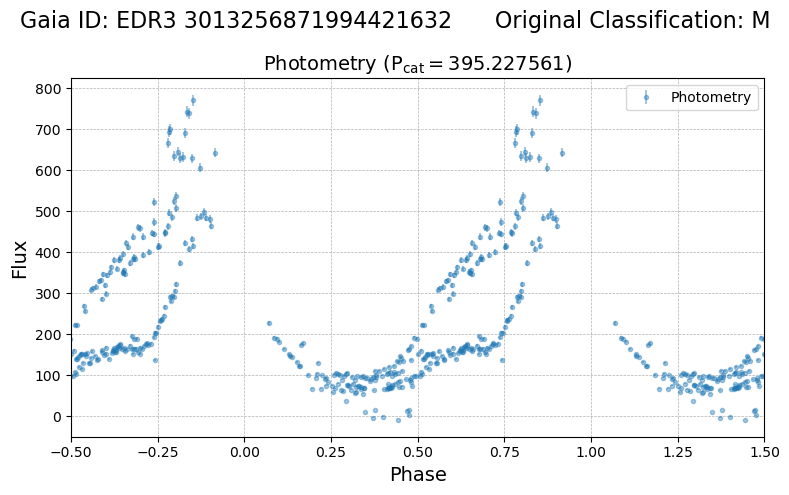

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286146  33f8986e-cab8-57c7-878a-2911926f2534    237849   

                        asassn_name other_names    raj2000  dej2000  \
286146  ASASSN-VJ153651.21-100448.7      TZ Lib  234.21336 -10.0802   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286146  2.457794e+06  6.317145e+18  J153651.27-100448.5    56951586.0   

                  edr3_source_id galex_id        tic_id  
286146  EDR3 6317145414874796928      NaN  TIC 32311176   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
286146       3.22   183.6            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286146      11.32         9.613367           0.038973          11.20841   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
286146        

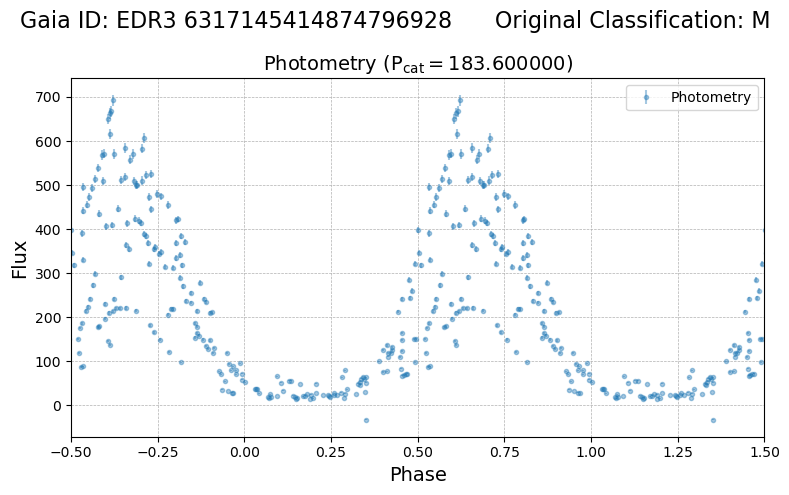

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
171560  a0e0b5bf-ce0d-5522-94d4-f5c69fdf89a2    422517   

                        asassn_name other_names    raj2000   dej2000  \
171560  ASASSN-VJ191743.80-172845.0      AL Sgr  289.43249 -17.47916   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
171560  2.456758e+06  4.084723e+18  J191743.76-172844.7    28500686.0   

                  edr3_source_id galex_id         tic_id  
171560  EDR3 4084723119251544064      NaN  TIC 130693593   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
171560       2.37  92.047048            0.72       0.63 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
171560      11.48        10.510731            0.02251         13.020157   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
17156

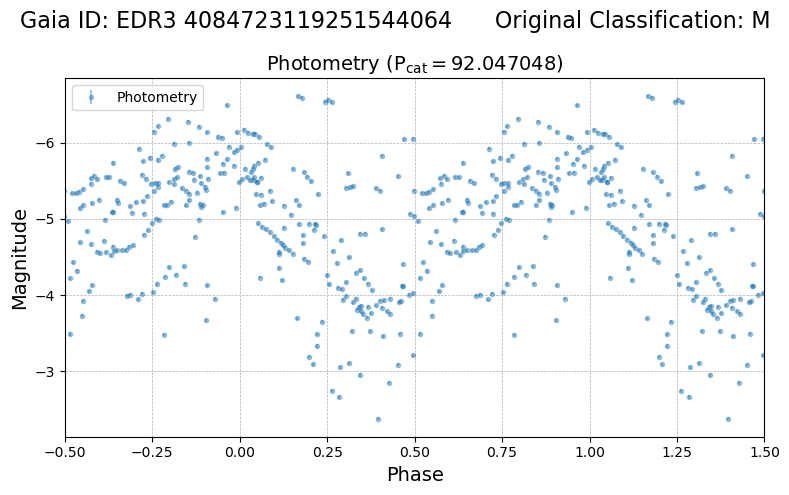

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427648  631dd986-60c2-5035-a008-85ed061ec7b2     73030   

                        asassn_name other_names    raj2000  dej2000  \
427648  ASASSN-VJ160717.60+095552.3       U Ser  241.82334  9.93119   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427648  2.456885e+06  4.456333e+18  J160717.69+095552.5    34277554.0   

                  edr3_source_id galex_id         tic_id  
427648  EDR3 4456333447855950976      NaN  TIC 266059505   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427648       3.62  236.145543            0.24       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427648      10.19           9.3484           0.054079         12.993317   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4276

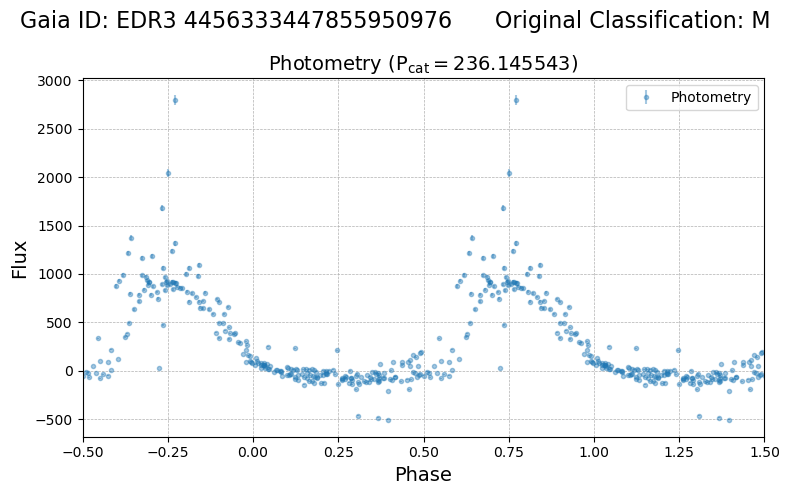

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
240191  e637ae14-45ec-5446-8317-ac4092b1a8e7     53533   

                        asassn_name other_names    raj2000   dej2000  \
240191  ASASSN-VJ173705.97+181304.6      FR Her  264.27488  18.21794   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
240191  2.456865e+06  4.550653e+18  J173705.95+181304.7    35576571.0   

                  edr3_source_id galex_id         tic_id  
240191  EDR3 4550653403578480640      NaN  TIC 311423949   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
240191       2.79  136.054665            0.22       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
240191      11.47        10.723048           0.023801         12.451501   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
240

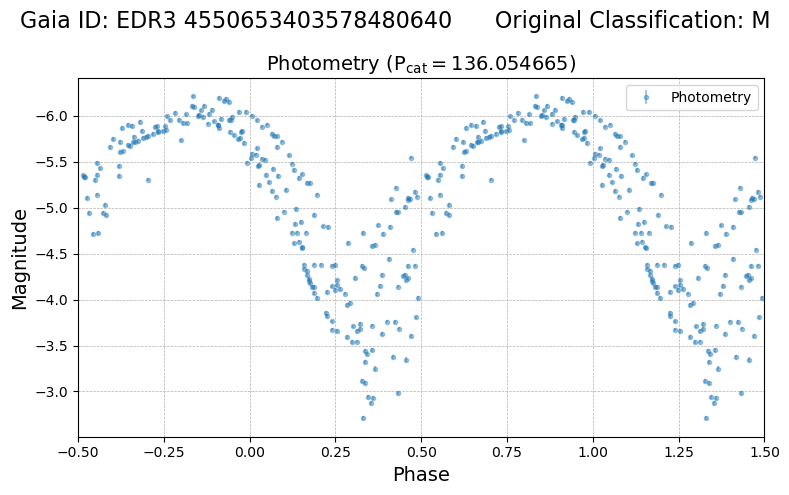

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428605  be74060f-32aa-5571-9440-f4a4a9d91941    133477   

                        asassn_name other_names   raj2000   dej2000  \
428605  ASASSN-VJ021408.05+473945.0      KL And  33.53356  47.66251   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428605  2.457236e+06  3.547628e+17  J021408.04+473944.8     2438467.0   

                 edr3_source_id galex_id         tic_id  
428605  EDR3 354762791118252288      NaN  TIC 292726869   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428605       2.31  280.750276            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428605      11.56        10.446475           0.023175         12.294901   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
428605

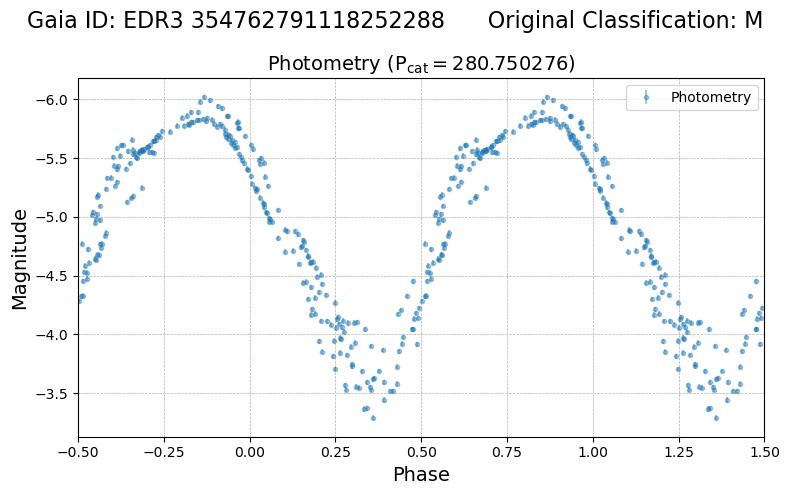

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
663363  ae797ffd-215d-5562-a36d-0e07433bd7b1    125084   

                        asassn_name other_names    raj2000   dej2000  \
663363  ASASSN-VJ200011.10-695254.3      BQ Pav  300.04627 -69.88176   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
663363  2.456795e+06  6.423408e+18  J200010.97-695254.7    57493921.0   

                  edr3_source_id                galex_id         tic_id  
663363  EDR3 6423407784861791872  GALEX J200011.0-695255  TIC 352313878   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
663363       2.79  111.106799            0.23       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
663363      11.26        11.070549           0.022269           13.1176   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

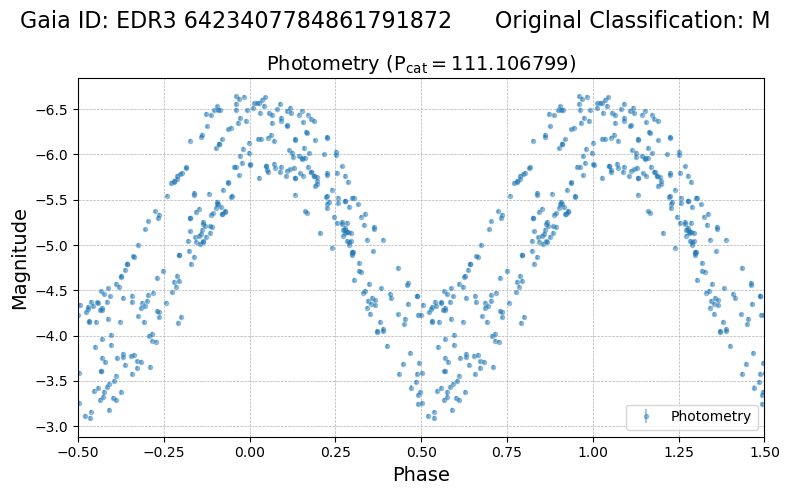

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
24594  dadd886b-e33c-5101-bcfe-649c60e15ee3    473145   

                       asassn_name other_names    raj2000   dej2000  \
24594  ASASSN-VJ170733.28-505841.2         NaN  256.88872 -50.97823   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
24594  2.457873e+06  5.926006e+18  J170733.26-505841.2           NaN   

                 edr3_source_id galex_id         tic_id  
24594  EDR3 5926005526416230784      NaN  TIC 213018702   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
24594       5.02   226.0            0.76        0.6 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
24594      15.08        14.083698           0.033943         17.419071   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
24594            0.2017

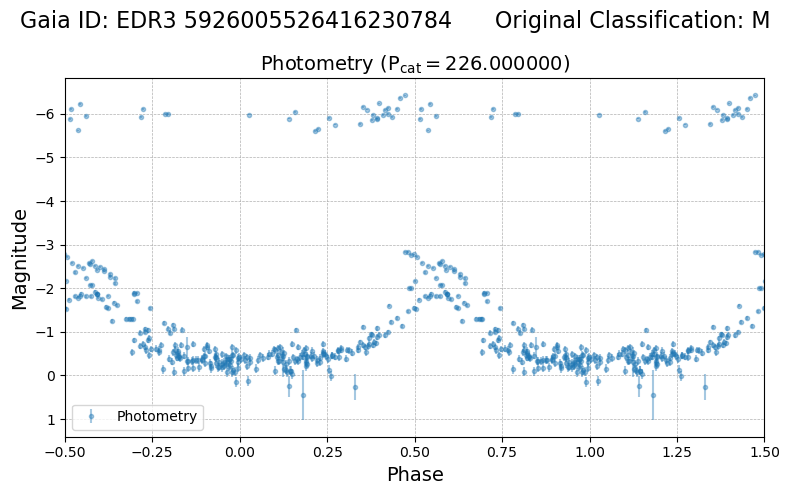

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427107  cee53963-64aa-51d4-abdd-5e2078db84b4    169429   

                        asassn_name other_names   raj2000   dej2000  \
427107  ASASSN-VJ032110.47-171356.8      CQ Eri  50.29361 -17.23245   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427107  2.457615e+06  5.106132e+18  J032110.43-171356.8    37721930.0   

                  edr3_source_id galex_id        tic_id  
427107  EDR3 5106132209846273152      NaN  TIC 55893843   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427107       2.19  166.311308            0.24       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427107      11.74         11.01827            0.02746          12.62528   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
427107

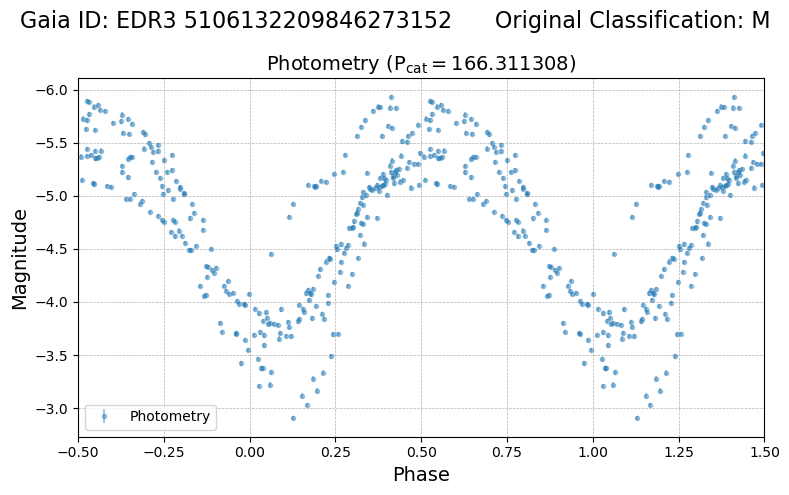

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
435578  7f53b09a-54dd-54ec-9b8a-02ed8c067cb0    225561   

                        asassn_name          other_names   raj2000   dej2000  \
435578  ASASSN-VJ181053.50-252143.2  MACHO 180.23411.311  272.7229 -25.36201   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
435578  2.457523e+06  4.065002e+18  J181053.49-252143.0           NaN   

                  edr3_source_id galex_id         tic_id  
435578  EDR3 4065002244409877632      NaN  TIC 249366042   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
435578       0.39  347.925582             0.7       0.65 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
435578      14.99         14.40259           0.060004         18.058868   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

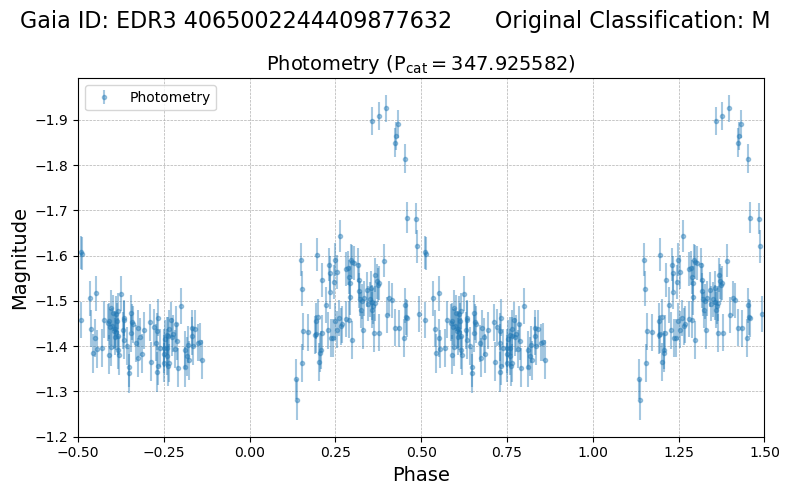

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
439455  8aff9209-5cc7-5ef7-9296-732101c7bc4f    393980   

                        asassn_name other_names    raj2000   dej2000  \
439455  ASASSN-VJ182117.96-302543.1   V1599 Sgr  275.32485 -30.42863   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
439455  2.457872e+06  4.046448e+18  J182118.06-302543.0           NaN   

                  edr3_source_id galex_id        tic_id  
439455  EDR3 4046447642133154304      NaN  TIC 64750337   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
439455       2.13  137.201782            0.34       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
439455      11.23        10.671438           0.032024         12.435416   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4394

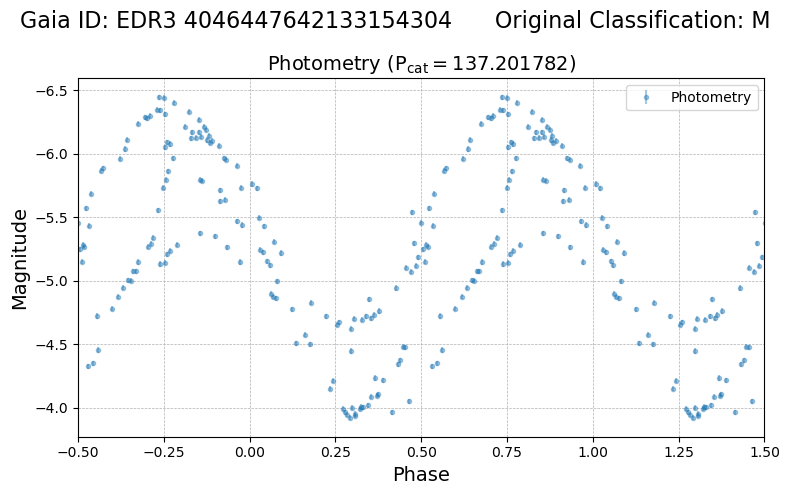

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427737  0a108f3d-e62a-5162-bfaf-919fab23805d    133510   

                        asassn_name other_names   raj2000   dej2000  \
427737  ASASSN-VJ043953.41+790750.9      WY Cam  69.97253  79.13081   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427737  2.457992e+06  5.562556e+17  J043953.63+790750.5     4870092.0   

                 edr3_source_id                galex_id         tic_id  
427737  EDR3 556255645595614208  GALEX J043953.5+790751  TIC 371710208   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427737       3.26  414.877493            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427737      10.88        10.392091           0.031757         12.688693   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

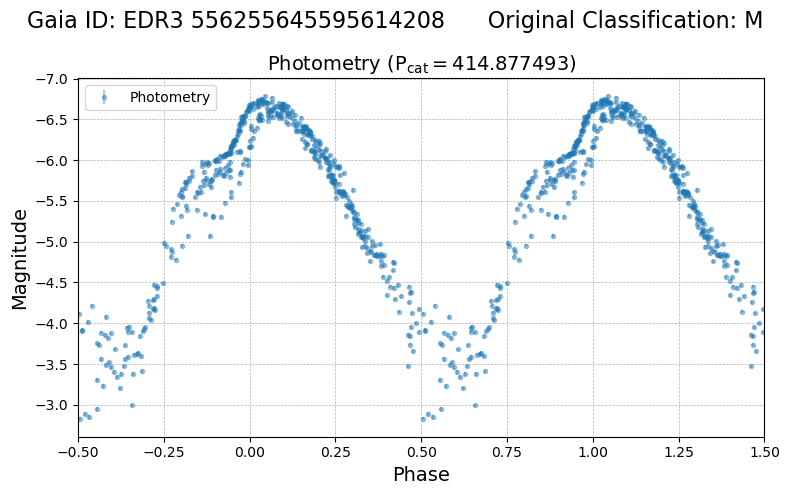

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
187919  1c3ff932-4256-5dff-beb5-e884d4af6450    109230   

                        asassn_name other_names    raj2000   dej2000  \
187919  ASASSN-VJ143832.05-294327.3      FU Hya  219.63353 -29.72425   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
187919  2.457236e+06  6.221734e+18  J143831.98-294327.9    56242012.0   

                  edr3_source_id galex_id          tic_id  
187919  EDR3 6221733953345510656      NaN  TIC 1056443017   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
187919        2.7   194.5            0.24       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
187919      11.19         9.309059           0.021384         10.830924   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
187919  

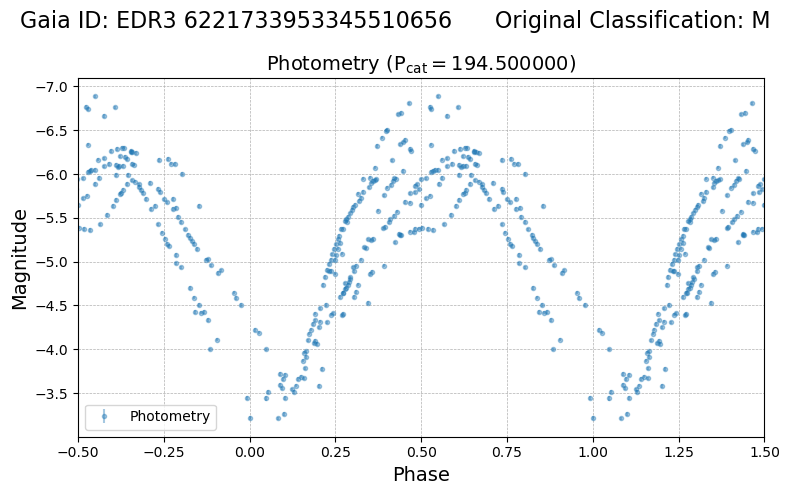

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
390502  9795a182-ca21-502a-8043-896e655e67f4    441583   

                        asassn_name              other_names    raj2000  \
390502  ASASSN-VJ183946.65-225259.7  2MASS J18394654-2252592  279.94438   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
390502 -22.88325  2.457840e+06  4.079164e+18  J183946.55-225259.2   

        apass_dr9_id            edr3_source_id galex_id       tic_id  
390502           NaN  EDR3 4079164091600683648      NaN  TIC 2052525   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
390502        0.9  239.07827            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
390502       15.3        13.930828           0.056531         17.089207   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

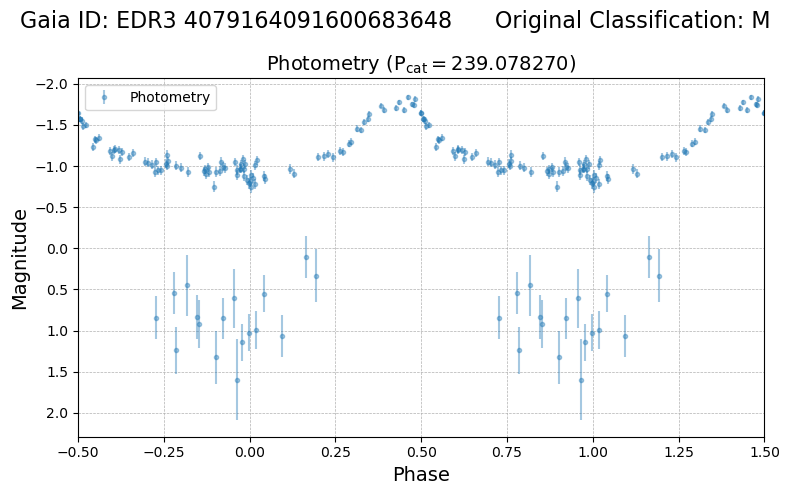

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287920  ef1b8d99-eb79-59c5-9b82-a20c45ca2f6c    125081   

                        asassn_name other_names    raj2000   dej2000  \
287920  ASASSN-VJ073400.50+114407.0       T CMi  113.50209  11.73529   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287920  2.458024e+06  3.162383e+18  J073400.46+114406.8    22814470.0   

                  edr3_source_id                galex_id         tic_id  
287920  EDR3 3162383393551518976  GALEX J073400.4+114407  TIC 234412393   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
287920       3.51  332.354678            0.12       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287920      11.29         9.945287           0.068278          12.52744   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

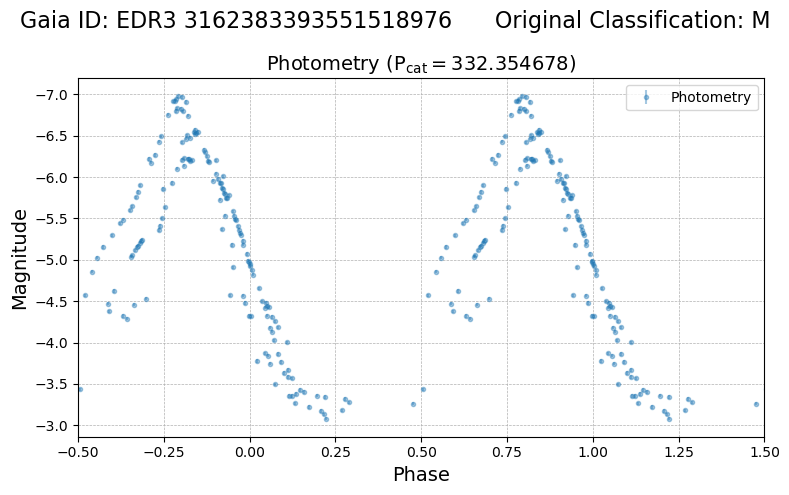

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
5994  9c7139b8-bbff-53f3-ab82-b7c66ddd3bf9    479599   

                      asassn_name other_names    raj2000   dej2000  \
5994  ASASSN-VJ123153.14-583649.3         NaN  187.97113 -58.61373   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
5994  2.457780e+06  6.059290e+18  J123153.12-583649.3           NaN   

                edr3_source_id galex_id         tic_id  
5994  EDR3 6059289902140480768      NaN  TIC 272583446   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
5994       1.92   180.0            0.83       0.61 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
5994      16.07         14.29724           0.038885         17.368807   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5994            0.136996         12.

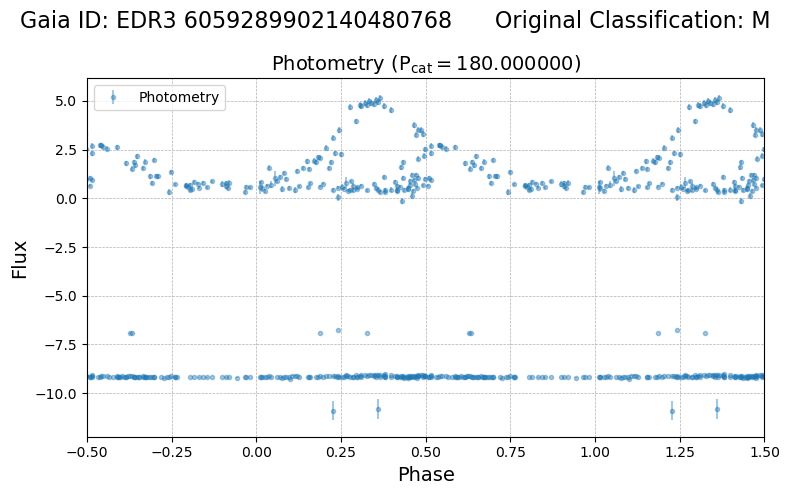

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428113  7e3b34a5-f51c-5f56-9c45-6d4c1ffa739a    200656   

                        asassn_name other_names   raj2000   dej2000  \
428113  ASASSN-VJ045202.33+173216.3       V Tau  73.00971  17.53785   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428113  2.458349e+06  3.406492e+18  J045202.33+173216.6    25193129.0   

                  edr3_source_id galex_id         tic_id  
428113  EDR3 3406491811187562368      NaN  TIC 436664403   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428113        4.3  172.695846            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428113      10.99         9.549517           0.043246         12.969833   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4281

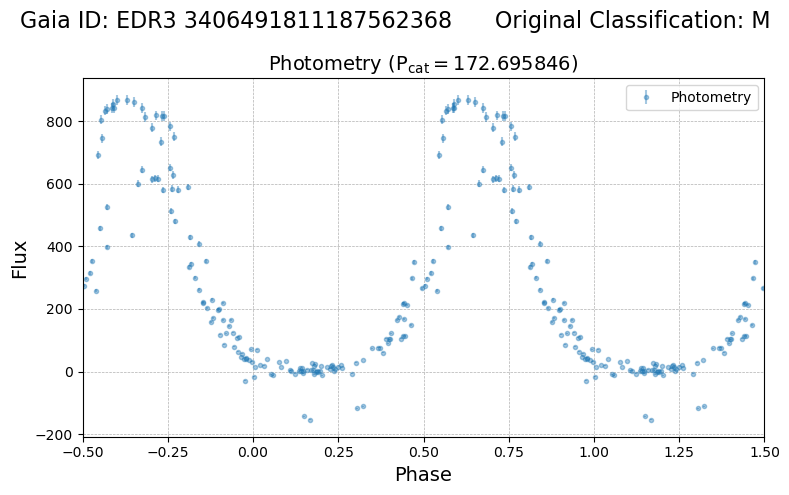

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288888  ef1f83d3-26d5-51cf-a08c-d25aa69cd2ea     69621   

                        asassn_name other_names  raj2000  dej2000  \
288888  ASASSN-VJ212305.76+005015.6      RW Aqr  320.774  0.83768   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288888  2.457363e+06  2.691017e+18  J212305.80+005016.0    17423414.0   

                  edr3_source_id galex_id         tic_id  
288888  EDR3 2691016672752074368      NaN  TIC 269923337   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288888       3.83  143.534163            0.41        0.8 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288888      11.46        10.610966           0.021456         13.219096   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
288888  

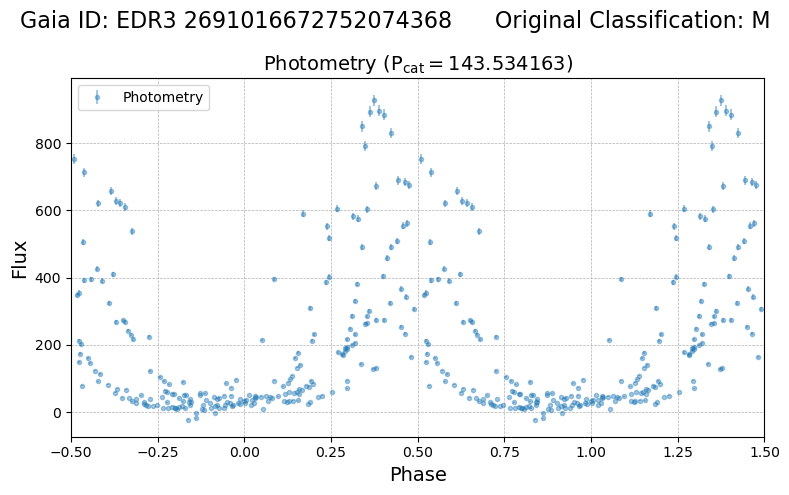

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290568  6325bf38-b1fb-50c3-a62f-bf5c6a82626c    431441   

                        asassn_name other_names    raj2000   dej2000  \
290568  ASASSN-VJ152021.65-373515.5      FM Lup  230.09019 -37.58764   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290568  2.458386e+06  6.007531e+18  J152021.68-373515.6    52898556.0   

                  edr3_source_id galex_id         tic_id  
290568  EDR3 6007531186834374528      NaN  TIC 148314255   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
290568       3.14   162.0            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290568      11.26        10.702331           0.041057         12.955995   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290568    

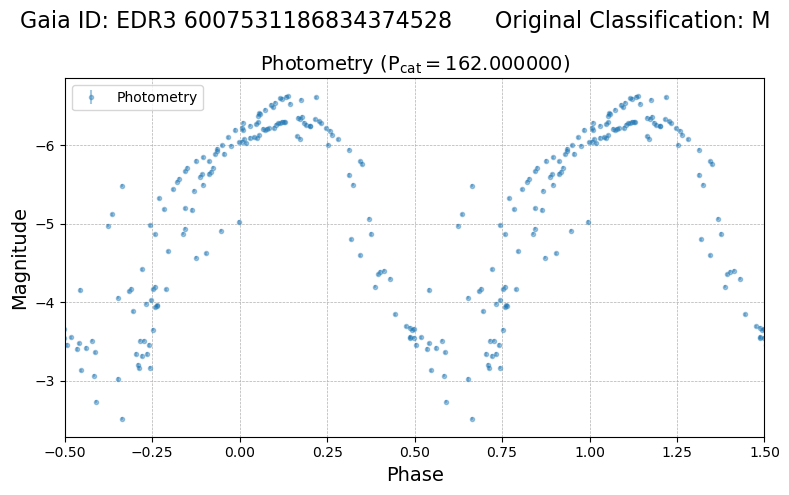

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
275711  342c7d14-2b56-59d2-b6bb-031c8de00197     94025   

                        asassn_name other_names    raj2000   dej2000  \
275711  ASASSN-VJ201753.64+594733.4      CN Cyg  304.47351  59.79262   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
275711  2.457699e+06  2.236663e+18  J201753.65+594733.9    15859547.0   

                  edr3_source_id galex_id         tic_id  
275711  EDR3 2236663288082418688      NaN  TIC 233889359   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
275711       4.11  204.068931             0.3       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
275711       11.0         9.209701           0.029223         11.004966   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
27

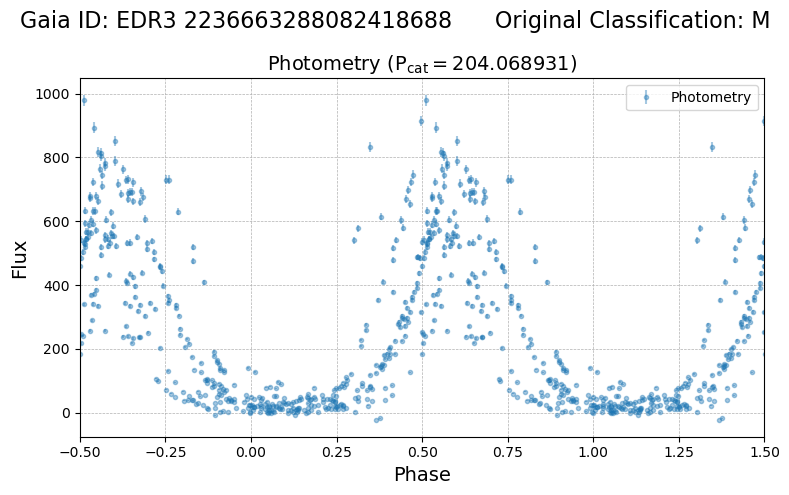

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
101207  70c978df-9031-55ec-8d68-bb2c957d2f04    196317   

                        asassn_name other_names    raj2000   dej2000  \
101207  ASASSN-VJ162248.78-125614.6   V0758 Sco  245.70327 -12.93738   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
101207  2.457499e+06  4.329906e+18  J162248.78-125614.5    33066383.0   

                  edr3_source_id galex_id         tic_id  
101207  EDR3 4329906137696706304      NaN  TIC 413544423   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
101207        2.1  81.550607            0.32       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
101207      12.73        11.727133           0.018838         13.102757   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1012

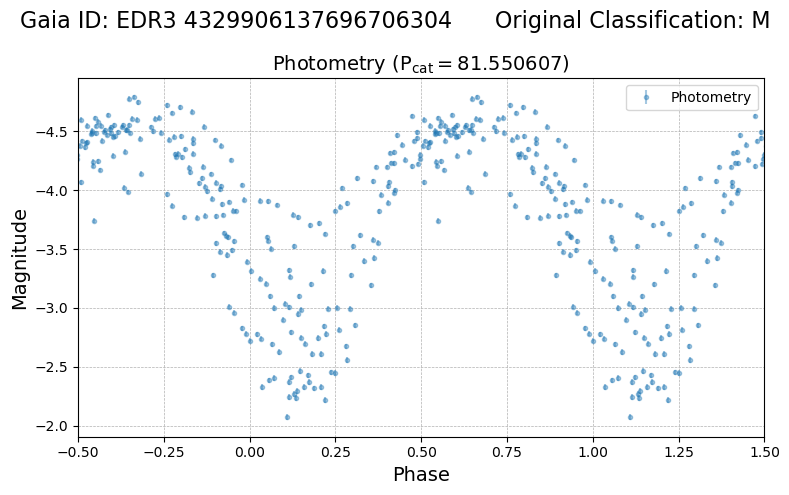

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426482  e75b7b6e-35c0-5099-a252-13093106d010    430113   

                        asassn_name other_names    raj2000   dej2000  \
426482  ASASSN-VJ075403.04-192017.6      ES Pup  118.51267 -19.33821   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426482  2.457071e+06  5.714324e+18  J075403.10-192017.6    46492592.0   

                  edr3_source_id galex_id         tic_id  
426482  EDR3 5714323630785245824      NaN  TIC 142368368   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426482       1.91  138.550539            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426482      11.65        10.088227           0.022976         12.239009   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

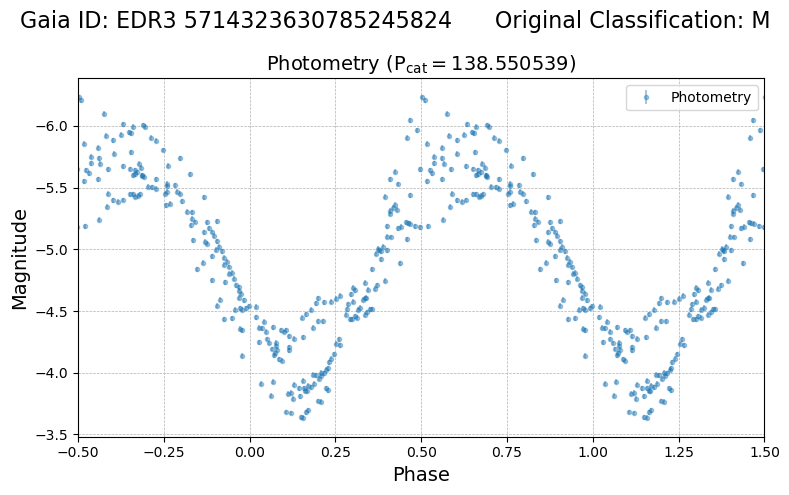

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
433843  dd0d3031-138b-523c-954e-476c05e4a447    285131   

                        asassn_name other_names   raj2000   dej2000  \
433843  ASASSN-VJ011628.34+562344.1      VZ Cas  19.11809  56.39559   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
433843  2.457704e+06  4.132333e+17  J011628.30+562343.3     3107487.0   

                 edr3_source_id galex_id         tic_id  
433843  EDR3 413233273303802624      NaN  TIC 332051739   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
433843       3.72  168.636394            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
433843       11.1        10.400428           0.013879         13.302029   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
433843 

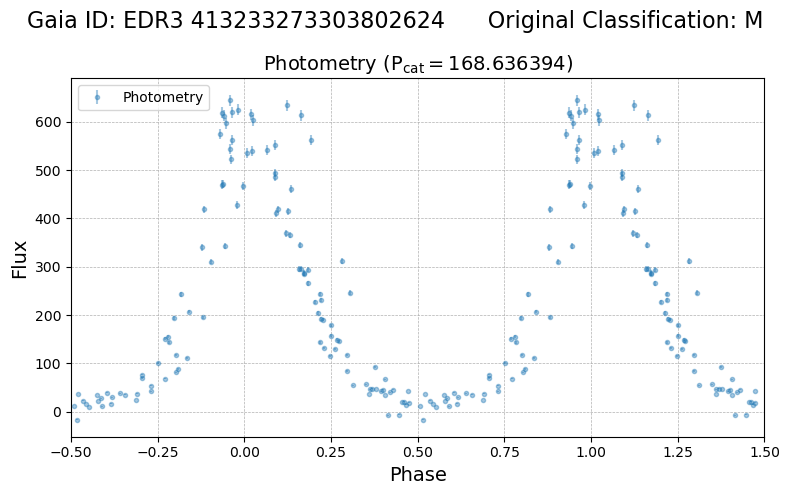

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427950  6a1e145b-8ffc-5801-9cdc-e025dd7c48bb     94069   

                        asassn_name other_names   raj2000   dej2000  \
427950  ASASSN-VJ021607.23+250323.4       R Ari  34.03014  25.05649   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427950  2.458064e+06  1.058742e+17  J021607.15+250323.5      356753.0   

                 edr3_source_id                galex_id         tic_id  
427950  EDR3 105874212317368320  GALEX J021607.1+250323  TIC 118299026   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427950       5.25  188.303603            0.51       0.76 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427950      10.65          8.51993           0.043543         11.330706   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

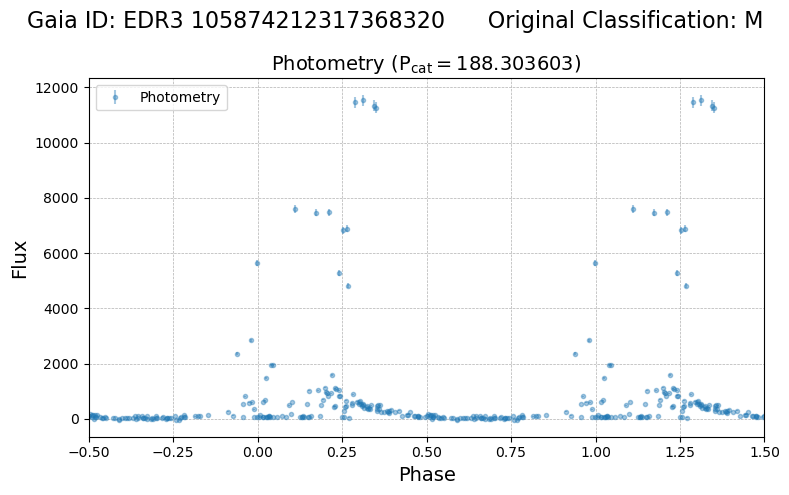

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288033  fad12413-d3f0-52d3-bfb3-916e6fd74a47    145375   

                        asassn_name other_names    raj2000   dej2000  \
288033  ASASSN-VJ230411.55+151812.1      RW Peg  346.04813  15.30337   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288033  2.456973e+06  2.816548e+18  J230411.47+151811.7    17917530.0   

                  edr3_source_id galex_id         tic_id  
288033  EDR3 2816548263188042496      NaN  TIC 217777445   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288033       4.21  207.077622             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288033      11.19         9.891105           0.049322          12.95765   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

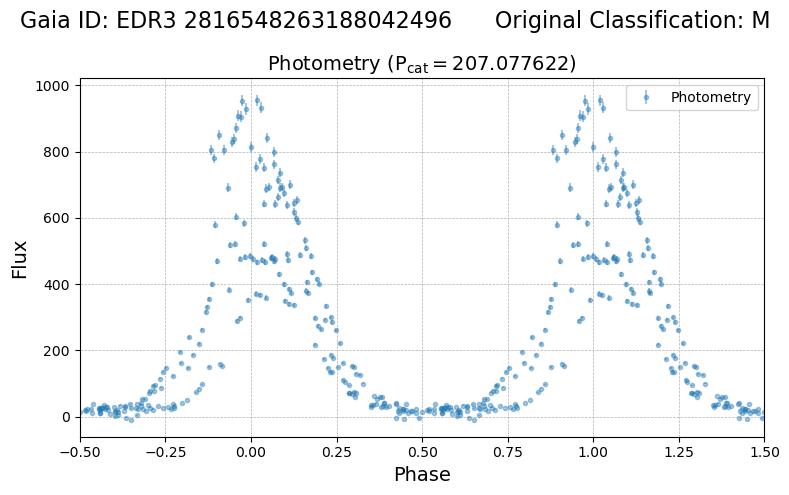

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
161898  c5f45fba-88d7-5592-8d7f-7a05489bdf47    219989   

                        asassn_name other_names    raj2000   dej2000  \
161898  ASASSN-VJ181114.10-280740.2   NSV 10319  272.80873 -28.12784   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
161898  2.457799e+06  4.050876e+18  J181114.17-280740.8           NaN   

                  edr3_source_id galex_id         tic_id  
161898  EDR3 4050875684624903936      NaN  TIC 249489906   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
161898       0.41  309.151533            0.77       0.58 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
161898      15.45         13.67624           0.040425         17.484879   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
16

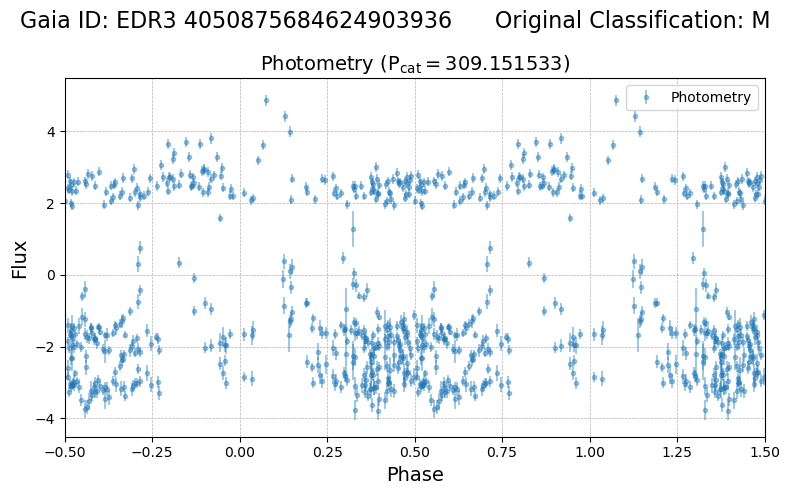

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
175080  05708b53-b95d-55b1-8c04-bba3e279a5be     94031   

                        asassn_name other_names   raj2000   dej2000  \
175080  ASASSN-VJ220410.20+350718.3      RT Peg  331.0425  35.12176   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
175080  2.457184e+06  1.948516e+18  J220410.03+350718.6    11917456.0   

                  edr3_source_id galex_id         tic_id  
175080  EDR3 1948516131216386176      NaN  TIC 162173841   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
175080       2.25  215.577019            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
175080      11.34        11.227891           0.018375         14.775971   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1750

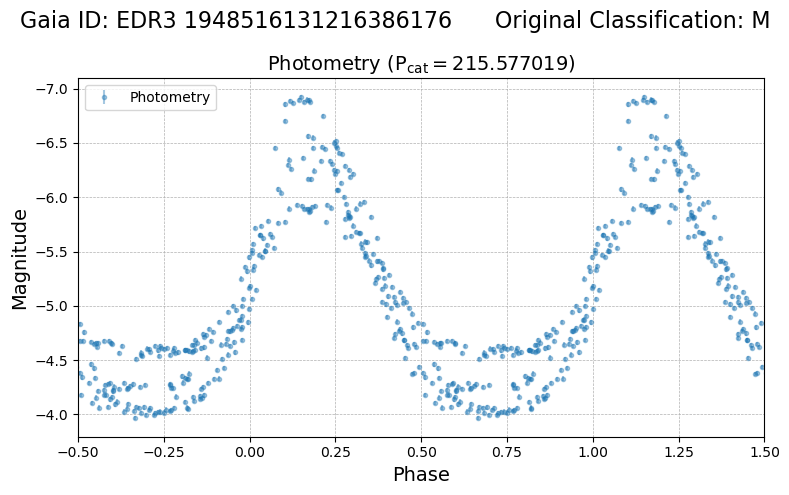

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426896  c8c8c2c9-7ccb-51f5-8b7b-dbc2557265aa    108166   

                        asassn_name other_names    raj2000  dej2000  \
426896  ASASSN-VJ123843.03+183241.6      DO Com  189.67928  18.5449   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426896  2.457391e+06  3.947992e+18  J123843.05+183241.6    27617931.0   

                  edr3_source_id                galex_id         tic_id  
426896  EDR3 3947992246959480064  GALEX J123843.0+183240  TIC 462540992   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426896       2.12  131.425576            0.25       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426896      12.52        12.241328           0.032935         13.394029   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

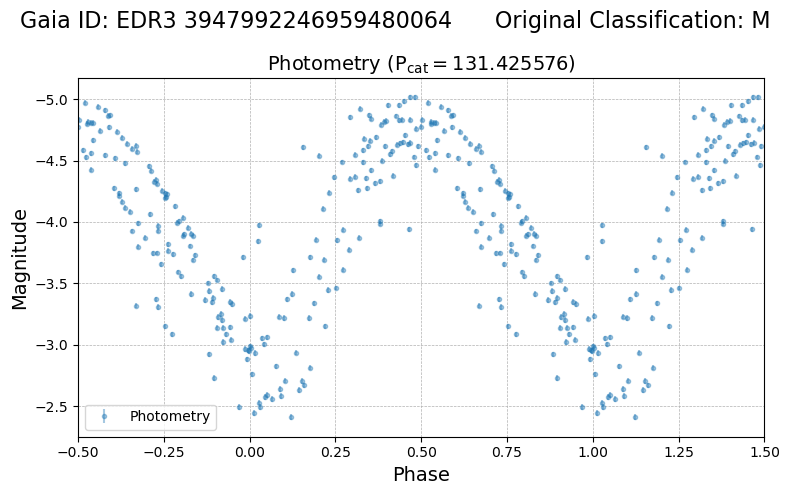

spec-59200-HD124029N161645V01_sp11-150.fits.gz


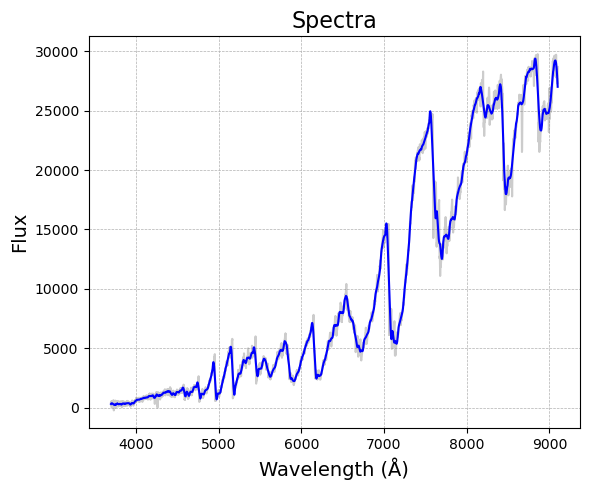

spec-59345-HD124029N161645V02_sp11-150.fits.gz


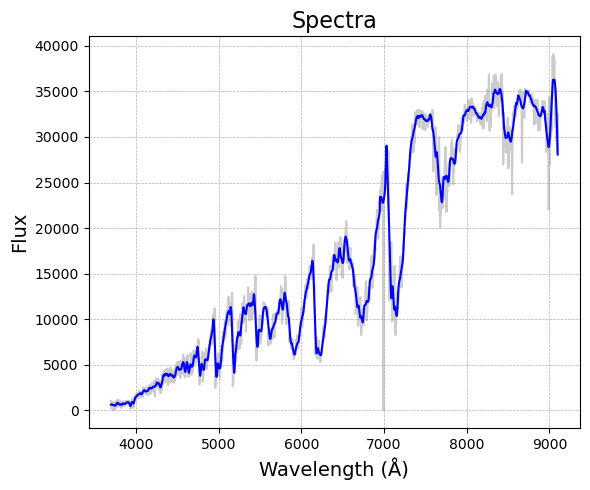

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287023  3d890b74-2d5c-5b1e-ab8f-317bba6d6ed4     84864   

                        asassn_name other_names    raj2000   dej2000  \
287023  ASASSN-VJ180534.65+655721.1       W Dra  271.39437  65.95587   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287023  2.458323e+06  2.161655e+18  J180534.65+655721.9    14952849.0   

                  edr3_source_id galex_id         tic_id  
287023  EDR3 2161655188947776000      NaN  TIC 219111368   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
287023       3.74   278.6            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287023      11.55        10.565665           0.027511         14.154228   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
287023    

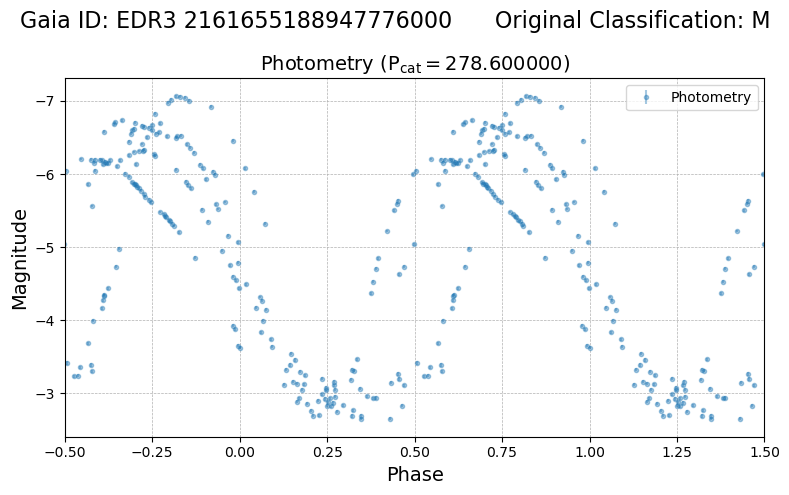

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289255  def080f8-b493-5e18-a431-743a76a74266    432426   

                        asassn_name other_names    raj2000   dej2000  \
289255  ASASSN-VJ150626.35-184357.3      RT Lib  226.60978 -18.73258   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289255  2.458306e+06  6.257109e+18  J150626.24-184356.3    56569595.0   

                  edr3_source_id galex_id         tic_id  
289255  EDR3 6257109159420504704      NaN  TIC 220308247   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289255       4.69  278.194334            0.52       0.75 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289255      11.54        10.021315           0.054579         13.607639   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

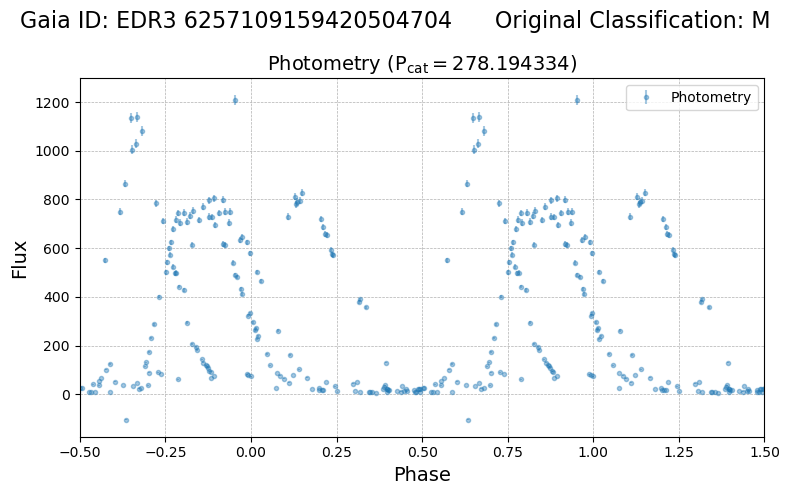

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426639  c65af609-5c3d-5ce6-b027-42254fd70770    270120   

                        asassn_name other_names    raj2000   dej2000  \
426639  ASASSN-VJ105340.86-531127.8      RU Vel  163.42025 -53.19105   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426639  2.457784e+06  5.359577e+18  J105340.83-531127.9    41281549.0   

                  edr3_source_id galex_id         tic_id  
426639  EDR3 5359577474082457728      NaN  TIC 120373821   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426639       2.35  123.352217            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426639      11.03        10.325564           0.032608         13.268526   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

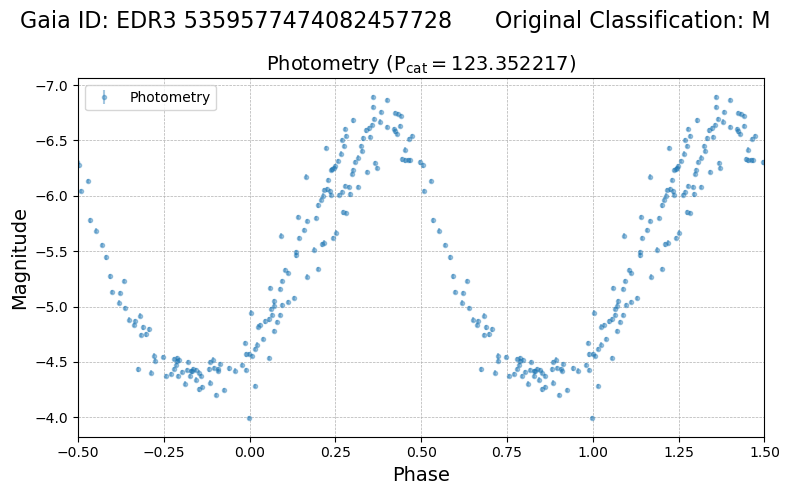

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
280948  6e7d5373-7543-59c6-a4b1-35f9095a7596    177030   

                        asassn_name other_names   raj2000  dej2000  \
280948  ASASSN-VJ211058.01-040140.1      RS Aqr  317.7417  -4.0278   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
280948  2.457867e+06  6.912573e+18  J211058.11-040140.2    61131594.0   

                  edr3_source_id                galex_id         tic_id  
280948  EDR3 6912573361232418944  GALEX J211058.2-040139  TIC 248488297   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
280948       2.99  218.812843            0.12       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
280948      11.74         9.579282           0.029403         12.180882   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

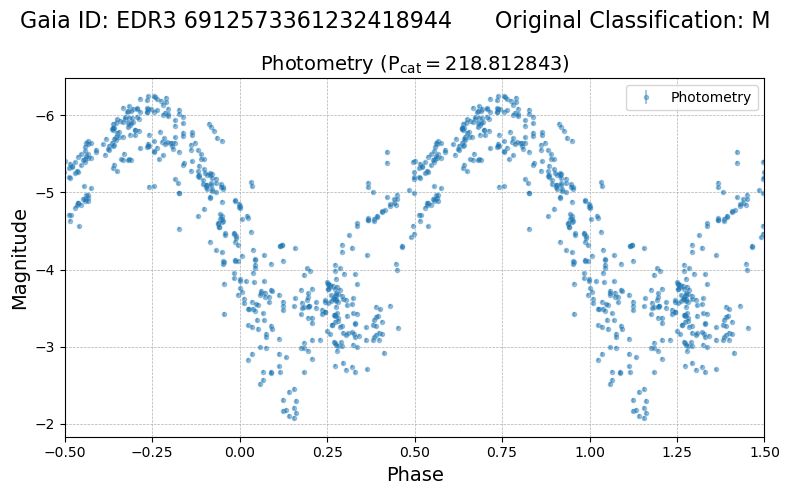

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290113  17e2fc50-0561-58a4-a2f4-f9eee0ec2aa0     94021   

                        asassn_name other_names   raj2000   dej2000  \
290113  ASASSN-VJ161524.60+374744.3       W CrB  243.8525  37.79564   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290113  2.457832e+06  1.378709e+18  J161524.55+374744.0     8392588.0   

                  edr3_source_id                galex_id        tic_id  
290113  EDR3 1378708970446470912  GALEX J161524.4+374743  TIC 39825354   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290113       4.04  248.156111            0.31       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290113      11.07         9.442534           0.036998         13.243455   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

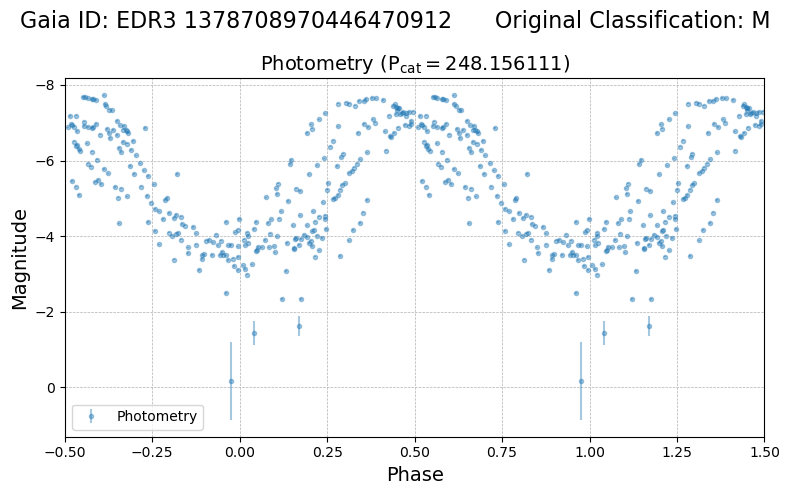

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426584  82f444f4-b712-5c4a-8261-94d9bb612d4d    426650   

                        asassn_name           other_names    raj2000  dej2000  \
426584  ASASSN-VJ151432.52-093932.8  NSVS J1514325-093933  228.63552  -9.6591   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426584  2.457154e+06  6.319449e+18  J151432.46-093932.7    56965132.0   

                  edr3_source_id galex_id        tic_id  
426584  EDR3 6319449063533192448      NaN  TIC 79287493   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426584       2.24  128.273398            0.12       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426584      12.18        11.703524           0.029895         12.928488   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

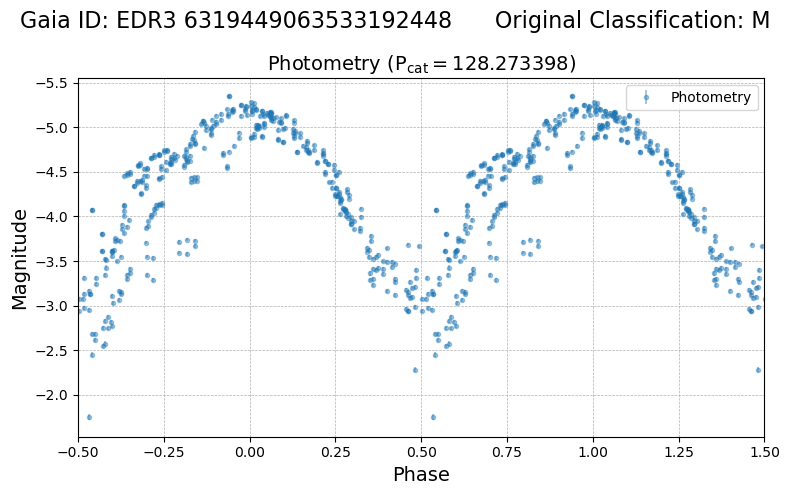

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
674227  6420f05c-3d3b-5be9-ad2a-467fc777c547    237832   

                        asassn_name other_names    raj2000   dej2000  \
674227  ASASSN-VJ190348.88-265901.8      QY Sgr  285.95368 -26.98382   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
674227  2.457189e+06  6.763550e+18  J190348.76-265901.5    60075568.0   

                  edr3_source_id galex_id         tic_id  
674227  EDR3 6763549575305981696      NaN  TIC 108906826   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
674227       3.14  190.59503            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
674227      11.26         9.488909           0.024147         11.712879   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
6742

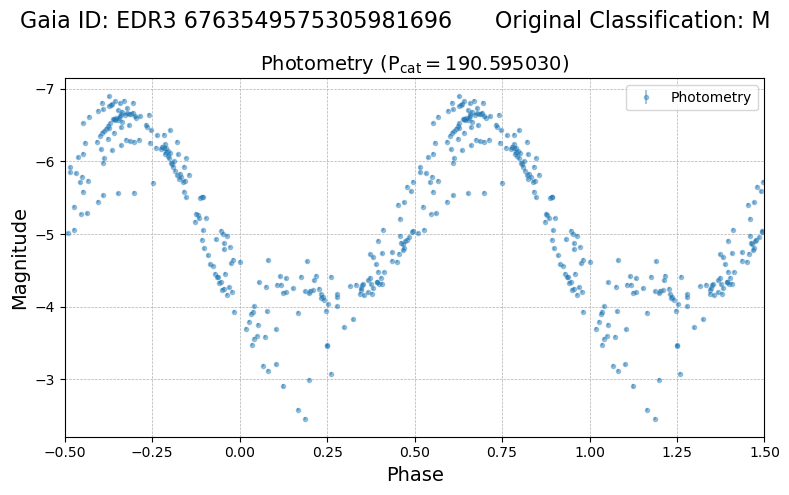

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428185  862ef5e0-9a92-5ab8-bc71-4f6d6921c99e    184966   

                        asassn_name other_names    raj2000   dej2000  \
428185  ASASSN-VJ192209.74-435814.5   V1159 Sgr  290.54057 -43.97069   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428185  2.457477e+06  6.664689e+18  J192209.60-435814.4    58786158.0   

                  edr3_source_id galex_id        tic_id  
428185  EDR3 6664688597894274432      NaN  TIC 62088849   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
428185       2.36  196.12618            0.18       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428185      11.73         9.978148           0.016512          12.90351   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
428185

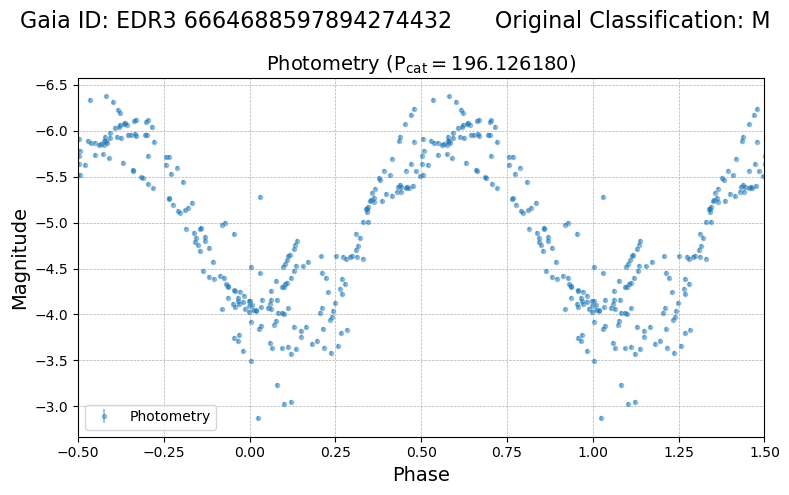

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
39733  0752ab9d-033b-575e-96ab-df98dfc2b4f2     82372   

                       asassn_name other_names    raj2000   dej2000  \
39733  ASASSN-VJ175944.75+192854.3      RY Her  269.93646  19.48174   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
39733  2.456924e+06  4.551638e+18  J175944.79+192854.1    35586267.0   

                 edr3_source_id galex_id         tic_id  
39733  EDR3 4551638222401929728      NaN  TIC 311527278   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude      period  lksl_statistic  rfr_score
39733       4.01  220.729797            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
39733      11.17         8.076925           0.004975          9.741175   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
39733          

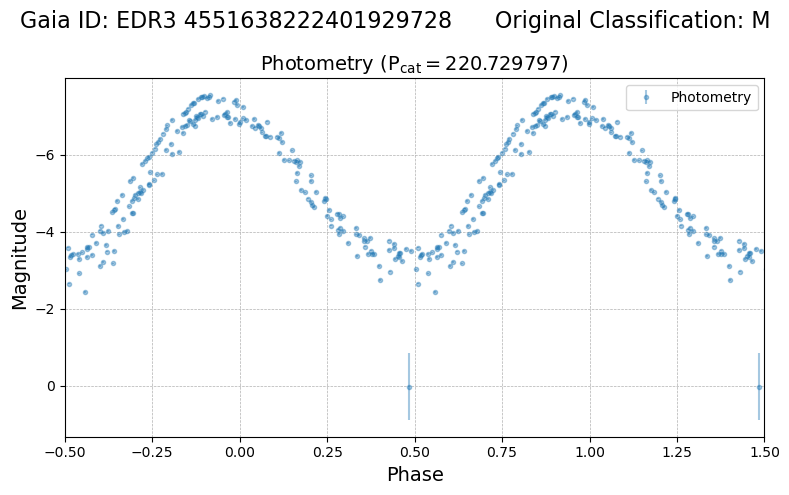

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
289317  6fe93cee-a6cd-54a3-ade6-9864edf2c93c    178504   

                        asassn_name other_names    raj2000  dej2000  \
289317  ASASSN-VJ201511.08-060903.8       Z Aql  303.79616 -6.15106   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
289317  2.457853e+06  4.217193e+18  J201511.04-060903.8    31153920.0   

                  edr3_source_id                galex_id        tic_id  
289317  EDR3 4217193345308864768  GALEX J201511.0-060904  TIC 71467710   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
289317       3.97  132.661918            0.54       0.73 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
289317      11.72        10.246683           0.039181         12.839695   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

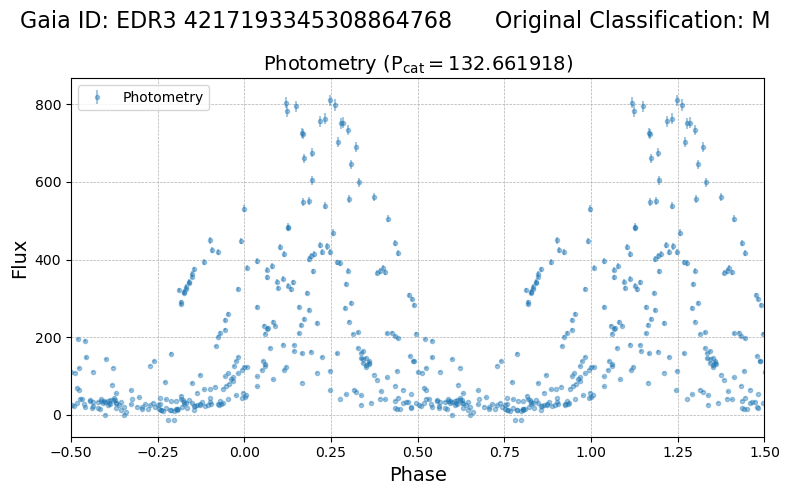

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287506  ca3a515f-7267-550c-83da-6512a9ed3fc4     97371   

                        asassn_name other_names    raj2000   dej2000  \
287506  ASASSN-VJ235904.83-532402.3       Z Phe  359.77014 -53.40064   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287506  2.457397e+06  6.521358e+18  J235904.94-532402.6    58026346.0   

                  edr3_source_id galex_id         tic_id  
287506  EDR3 6521358087460345856      NaN  TIC 201234772   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
287506       4.58  268.149202            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287506      13.21        11.065259           0.016451          15.06486   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

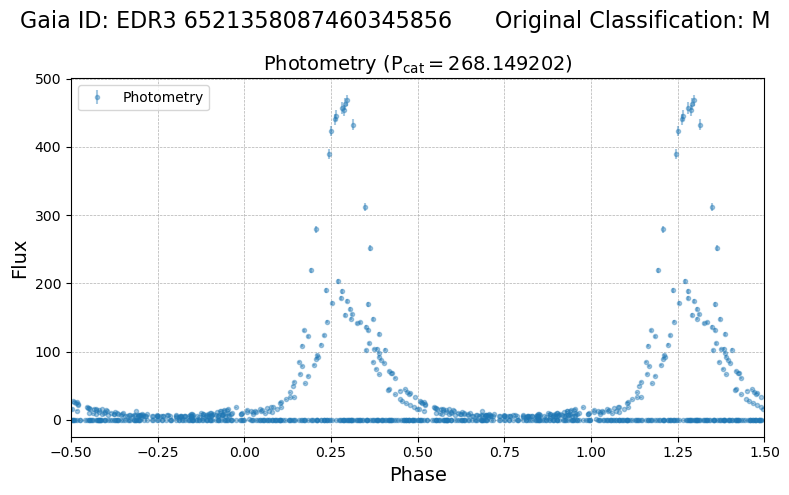

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
664170  13065c75-3a9c-5df9-a672-f3cefd331c03     61554   

                        asassn_name other_names   raj2000   dej2000  \
664170  ASASSN-VJ064340.70-314656.9       V CMa  100.9196 -31.78247   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
664170  2.457478e+06  5.584006e+18  J064340.70-314656.3    44225462.0   

                  edr3_source_id galex_id        tic_id  
664170  EDR3 5584005801803852928      NaN  TIC 52547027   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
664170        3.2  252.177198            0.25       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
664170      11.55        10.400584           0.026846         12.398857   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
664170

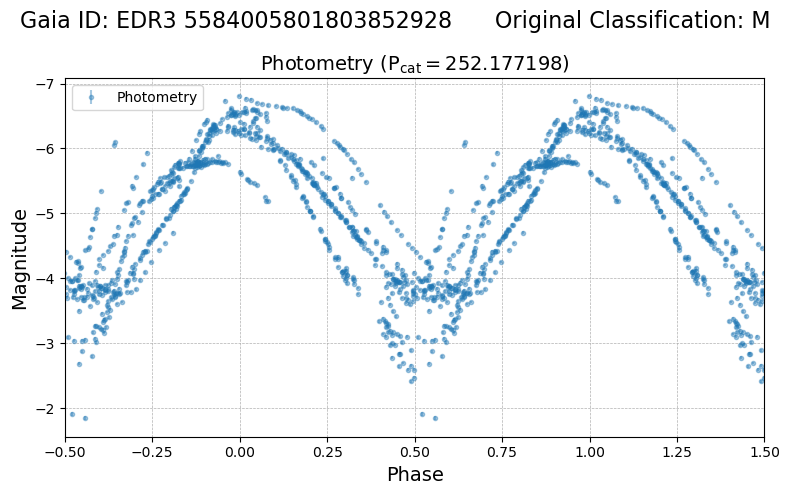

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427171  912fa6e0-c474-5062-a4d4-204e57e8be24     66841   

                        asassn_name other_names    raj2000   dej2000  \
427171  ASASSN-VJ180906.27+310116.0       T Her  272.27612  31.02112   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427171  2.457420e+06  4.591149e+18  J180906.22+310116.3    35867035.0   

                  edr3_source_id                galex_id         tic_id  
427171  EDR3 4591149275824008960  GALEX J180906.2+310117  TIC 180717508   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427171       4.18  162.169117            0.56       0.72 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427171      10.79         8.744049           0.031912         12.020889   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

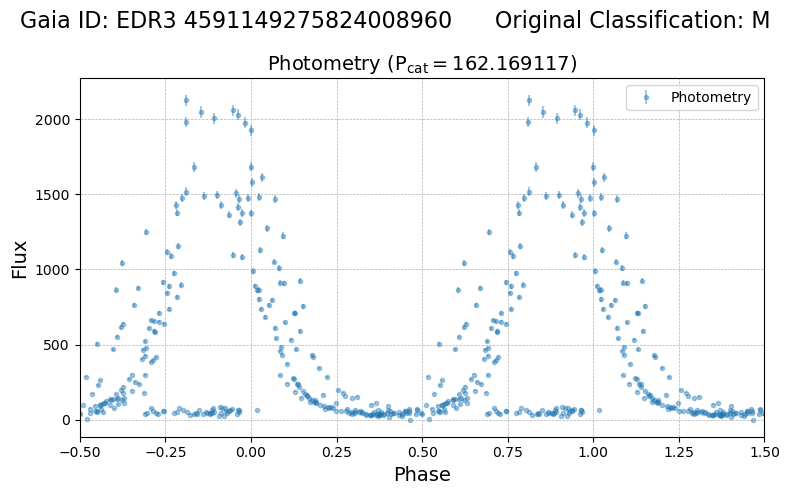

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
676085  4c846550-4753-547e-8389-c24aac168b2c    197589   

                        asassn_name other_names    raj2000  dej2000  \
676085  ASASSN-VJ091646.27-043512.6      UZ Hya  139.19278 -4.58683   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
676085  2.457859e+06  5.758844e+18  J091646.21-043512.7    47112393.0   

                  edr3_source_id                galex_id         tic_id  
676085  EDR3 5758844261038916608  GALEX J091646.0-043510  TIC 170885527   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
676085       4.11  267.993833            0.27       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
676085      11.74          9.42299           0.027899         12.469059   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

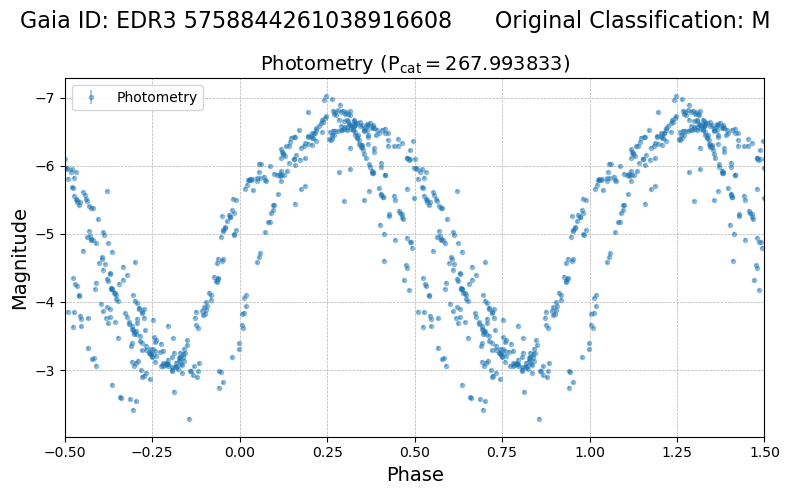

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
502022  f429017c-994d-54f4-965f-f954868f174e     57604   

                        asassn_name          other_names   raj2000  dej2000  \
502022  ASASSN-VJ211756.98+010422.3  ASAS J211757+0104.4  319.4874  1.07286   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
502022  2.457984e+06  2.691259e+18  J211756.96+010422.2    17424639.0   

                  edr3_source_id galex_id         tic_id  
502022  EDR3 2691258775764034048      NaN  TIC 376362762   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
502022       2.29  136.036507            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
502022      12.58        11.902554           0.004218         13.408255   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

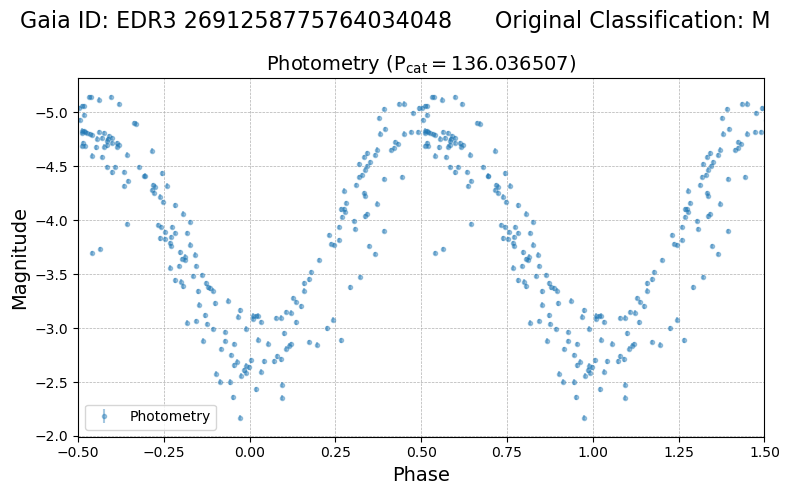

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
660267  e8eb59c4-ae97-5fcd-a7aa-30ddeea091ee    216662   

                        asassn_name         other_names  raj2000   dej2000  \
660267  ASASSN-VJ181714.40-252932.0  MACHO 159.26139.50   274.31 -25.49223   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
660267  2.457485e+06  4.065090e+18  J181714.40-252932.1           NaN   

                  edr3_source_id galex_id         tic_id  
660267  EDR3 4065090308390432384      NaN  TIC 379708695   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
660267       0.57  233.435691            0.21       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
660267      14.52        14.054084           0.048743          17.24926   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

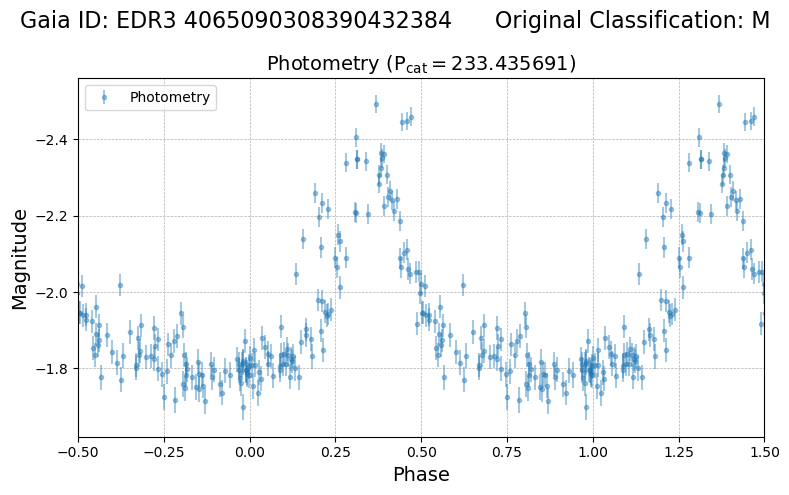

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287207  420a7c8a-a6f1-5015-a25d-b9e0203be6a9    102879   

                        asassn_name other_names    raj2000  dej2000  \
287207  ASASSN-VJ144705.87+391900.8      RR Boo  221.77446  39.3169   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287207  2.456856e+06  1.488516e+18  J144705.79+391901.4     8647105.0   

                  edr3_source_id                galex_id        tic_id  
287207  EDR3 1488516337718912768  GALEX J144705.8+391901  TIC 68146100   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
287207       4.37  202.043762            0.38       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287207      11.42        10.403189           0.033161         13.479944   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

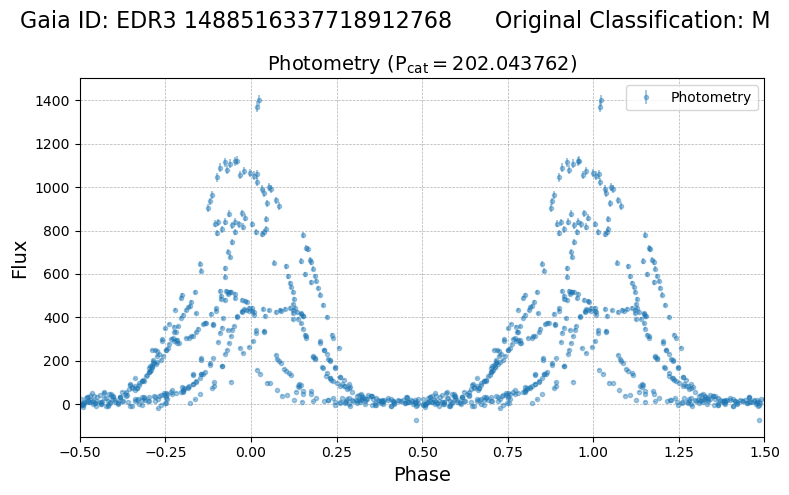

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290199  3e8e5fd8-231b-5625-8a54-39021a463fb7    246601   

                        asassn_name other_names    raj2000  dej2000  \
290199  ASASSN-VJ200827.28-091405.8      SS Cap  302.11366 -9.23495   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290199  2.456817e+06  4.191610e+18  J200827.25-091406.3    30600807.0   

                  edr3_source_id                galex_id        tic_id  
290199  EDR3 4191609977476032384  GALEX J200827.2-091404  TIC 71251861   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290199       3.47  256.240205            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290199      11.82         9.535977           0.031208         13.206943   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

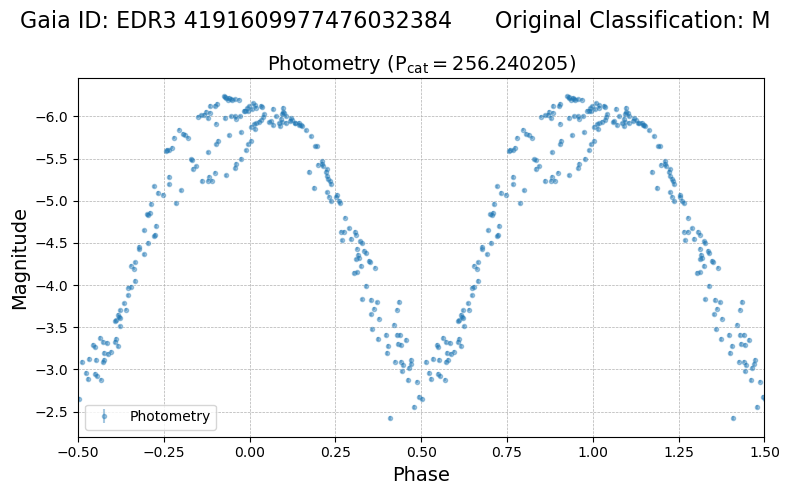

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287838  d30b64a1-35bc-5971-9012-5b6c31bc623b    393920   

                        asassn_name other_names    raj2000   dej2000  \
287838  ASASSN-VJ090504.54-250520.3       S Pyx  136.26892 -25.08896   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287838  2.458213e+06  5.651003e+18  J090504.62-250519.6    45732058.0   

                  edr3_source_id                galex_id        tic_id  
287838  EDR3 5651003198514505472  GALEX J090504.5-250521  TIC 37869989   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
287838       3.25  220.117641            0.26       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287838      10.48         9.524873           0.040613         12.812933   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

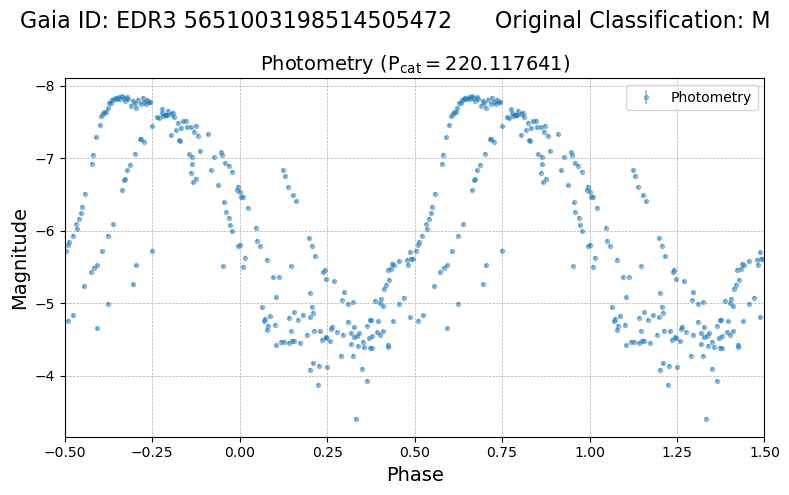

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
231131  e1bb0242-2248-5c20-8f37-061012d3a4bf    145425   

                        asassn_name other_names    raj2000   dej2000  \
231131  ASASSN-VJ155629.31-854730.3      BZ Oct  239.12213 -85.79176   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
231131  2.457445e+06  5.765730e+18  J155629.10-854730.6    47170284.0   

                  edr3_source_id galex_id         tic_id  
231131  EDR3 5765730437941908608      NaN  TIC 290470045   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
231131       2.56  281.195197            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
231131      11.31         10.50312           0.024819         12.259929   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
23

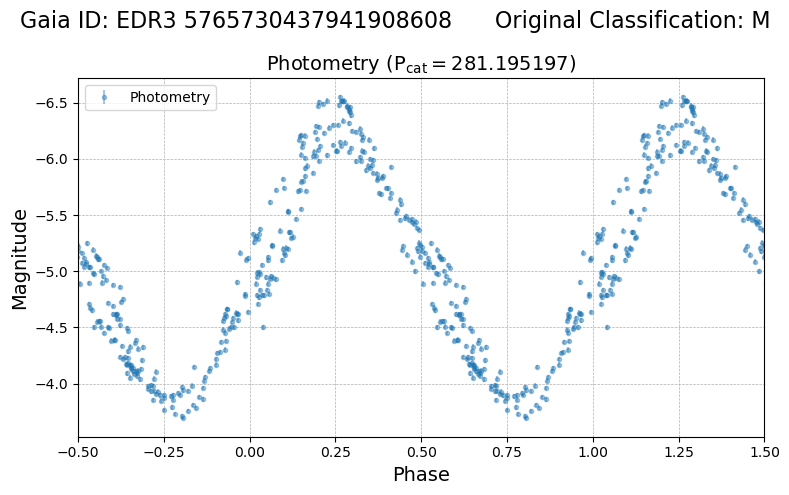

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
184196  1250ec6c-8b84-5141-be51-aea7fd82ae7e    356874   

                        asassn_name other_names   raj2000   dej2000  \
184196  ASASSN-VJ005429.24+482126.2   V0340 Cas  13.62183  48.35727   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
184196  2.457402e+06  4.023372e+17  J005429.21+482126.2     2953450.0   

                 edr3_source_id galex_id         tic_id  
184196  EDR3 402337181784039168      NaN  TIC 306955169   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
184196        2.9  409.139046            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
184196      11.24         9.353427           0.027448         11.624603   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
184196

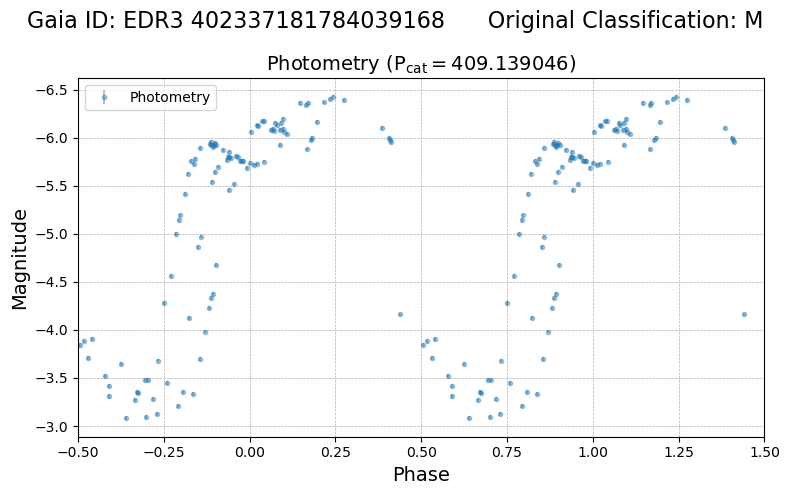

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288398  b317416f-af41-5cd8-8a16-dec19e1278e4    167298   

                        asassn_name other_names    raj2000   dej2000  \
288398  ASASSN-VJ221954.35-142406.6      SS Aqr  334.97647 -14.40182   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288398  2.458026e+06  2.599520e+18  J221954.42-142407.1    16990059.0   

                  edr3_source_id                galex_id         tic_id  
288398  EDR3 2599519575695427840  GALEX J221954.3-142408  TIC 188500948   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288398       3.81  206.610414            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288398      11.62        10.007084           0.037814         12.884038   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

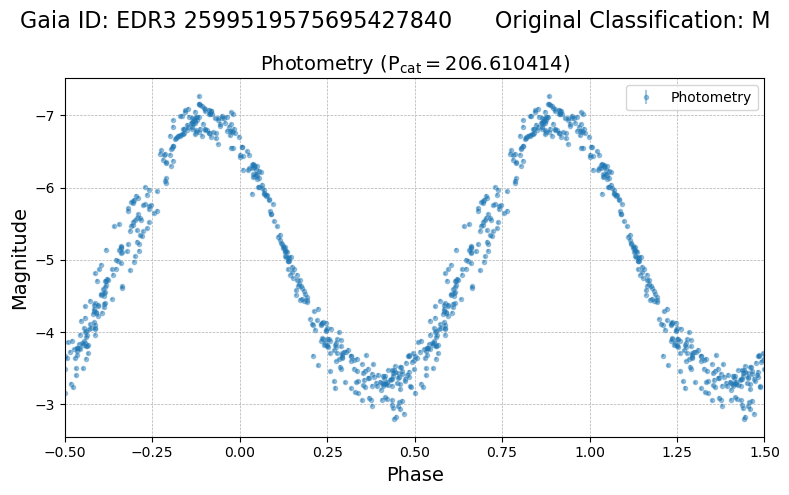

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290316  00f58009-bfb7-532d-9249-e6d369ffa5a0    125040   

                        asassn_name other_names    raj2000   dej2000  \
290316  ASASSN-VJ150146.16-301441.0      BE Cen  225.44232 -30.24472   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290316  2.457406e+06  6.211944e+18  J150146.23-301440.9    56138679.0   

                  edr3_source_id galex_id        tic_id  
290316  EDR3 6211943828796129664      NaN  TIC 75611776   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290316       3.77  219.156845            0.42       0.79 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290316      11.43         9.365989           0.040101         12.646884   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2903

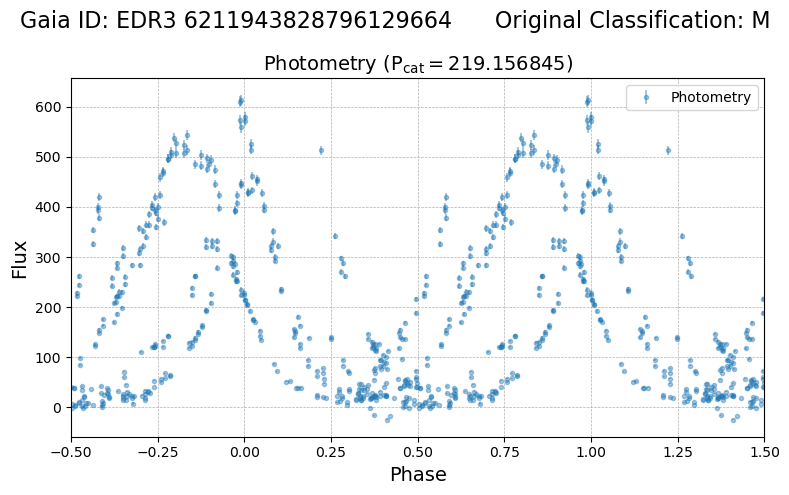

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288345  c5886ead-929b-5b29-ad57-6eda44e409f1    160084   

                        asassn_name          other_names  raj2000   dej2000  \
288345  ASASSN-VJ002516.00-720355.0  ASAS J002516-7203.9  6.31665 -72.06529   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288345  2.457386e+06  4.689628e+18  J002516.00-720354.6    36428364.0   

                  edr3_source_id galex_id         tic_id  
288345  EDR3 4689627962477470848      NaN  TIC 267190217   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288345        2.9  194.451172            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288345      11.65        11.451906            0.03369         14.322213   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

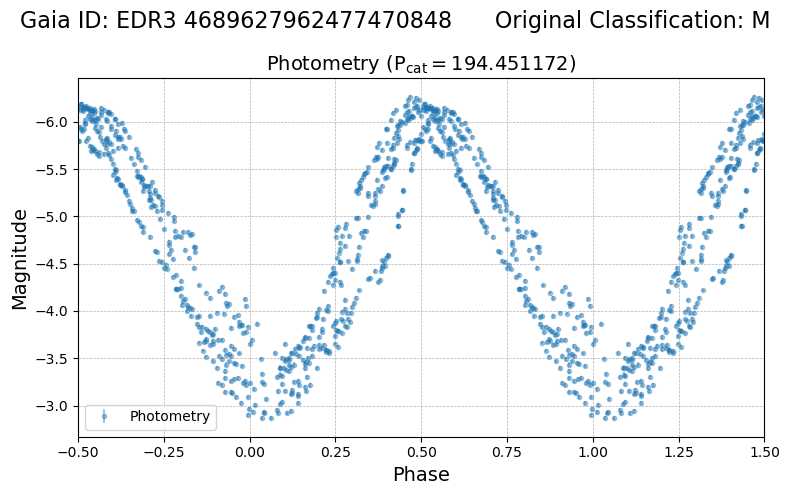

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290840  c242c32a-8ec4-5c28-90d9-dfff83823b00     69679   

                        asassn_name other_names    raj2000   dej2000  \
290840  ASASSN-VJ210857.52+160119.3      TZ Peg  317.23965  16.02203   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290840  2.457202e+06  1.760745e+18  J210857.43+160119.0     9612435.0   

                  edr3_source_id                galex_id         tic_id  
290840  EDR3 1760745383713366656  GALEX J210857.4+160120  TIC 125937334   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290840        3.8  217.624824            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290840      11.33         9.962555            0.03354         13.478642   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

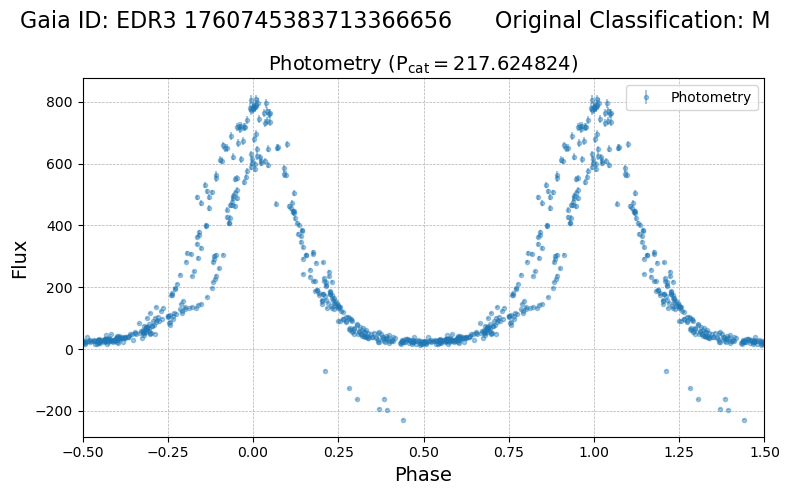

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
174066  6c793dc2-5b9f-5deb-b875-01ba84779e61    187121   

                        asassn_name other_names    raj2000   dej2000  \
174066  ASASSN-VJ225551.69-404016.6      AE Gru  343.96536 -40.67128   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
174066  2.457157e+06  6.546134e+18  J225551.72-404016.8    58089836.0   

                  edr3_source_id galex_id         tic_id  
174066  EDR3 6546133589124700288      NaN  TIC 152819855   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
174066       2.32  203.879362            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
174066      11.48         11.08654           0.025758         12.563139   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
17

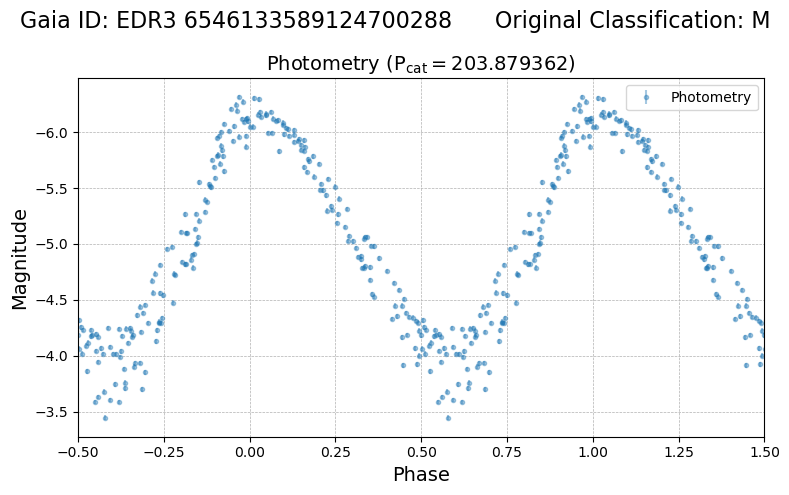

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
586977  f40f610d-188a-5bd3-bea4-69617f84e1f5     90365   

                        asassn_name other_names  raj2000   dej2000  \
586977  ASASSN-VJ005946.51+275644.2       W Psc  14.9438  27.94562   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
586977  2.457736e+06  3.078830e+17  J005946.45+275644.4     2085103.0   

                 edr3_source_id                galex_id        tic_id  
586977  EDR3 307883012627596288  GALEX J005946.4+275645  TIC 15532090   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
586977       3.96  186.658009            0.07       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
586977      12.45        11.061173           0.016127         13.674365   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

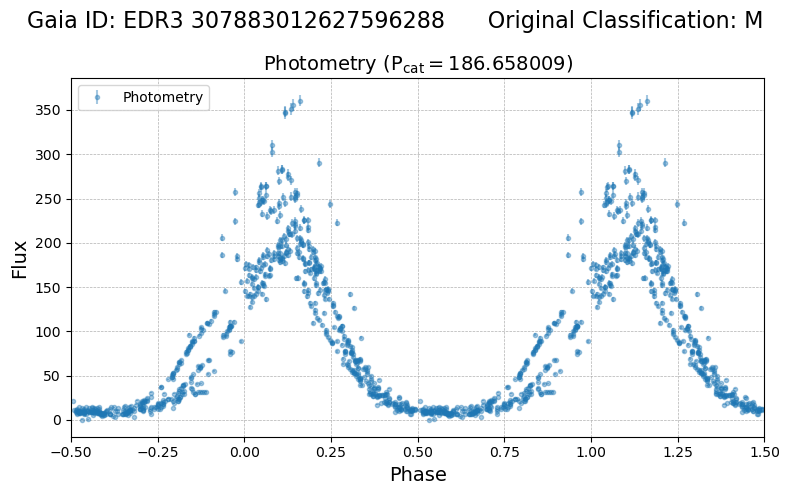

spec-57327-EG005558N271233V01_sp09-038.fits.gz


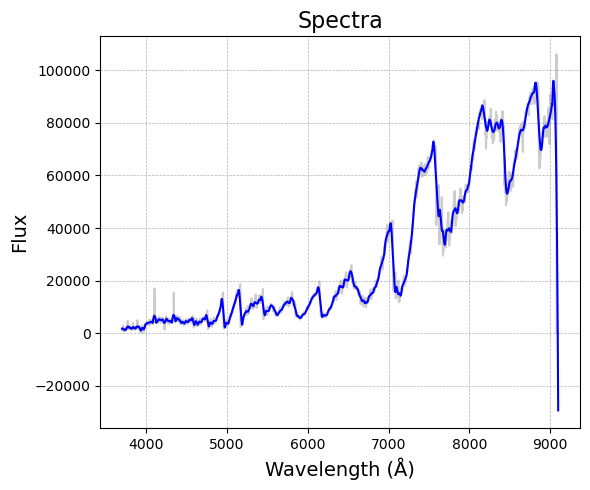

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
215796  d6d9739b-c99b-5dce-b8cc-74886736305c    388964   

                        asassn_name          other_names    raj2000  dej2000  \
215796  ASASSN-VJ083652.88-464344.0  GDS_J0836528-464344  129.22033 -46.7289   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
215796  2.458370e+06  5.521628e+18  J083652.87-464343.8    43395316.0   

                  edr3_source_id galex_id         tic_id  
215796  EDR3 5521628445592238720      NaN  TIC 461584691   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
215796       2.81  108.524214            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
215796      11.68        10.382008            0.03089         12.762548   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

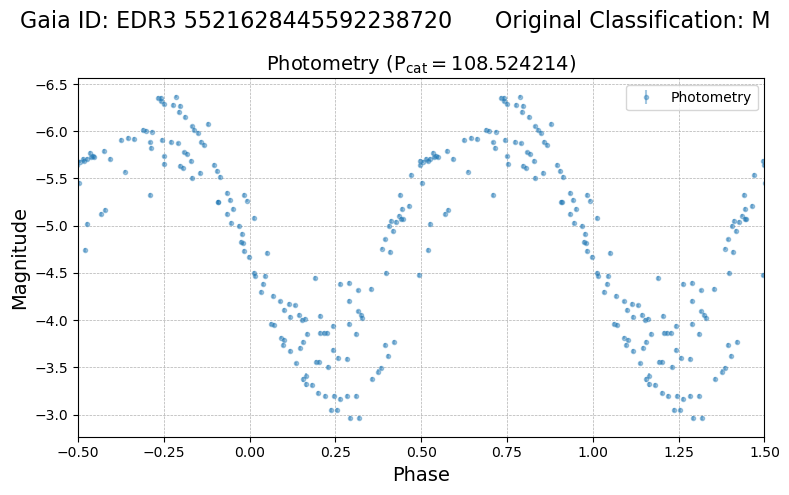

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288258  426cb1b5-b5fc-54b0-be29-3a24b2ba577a     94027   

                        asassn_name other_names    raj2000   dej2000  \
288258  ASASSN-VJ212059.85+142700.5       X Peg  320.24936  14.45013   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288258  2.457906e+06  1.759403e+18  J212059.85+142700.3     9596396.0   

                  edr3_source_id galex_id        tic_id  
288258  EDR3 1759403150596397056      NaN  TIC 60495335   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
288258       4.19   201.2            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288258      11.33         9.471216           0.031503         12.895675   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
288258      

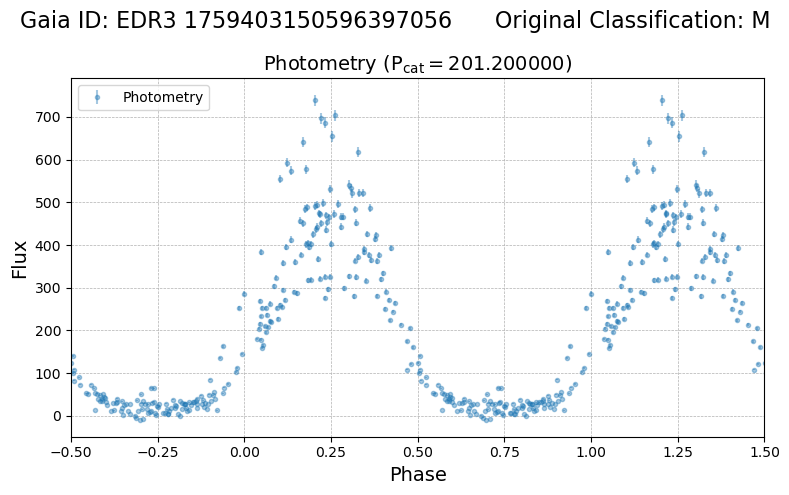

spec-56560-HD212706N160726V01_sp02-133.fits.gz


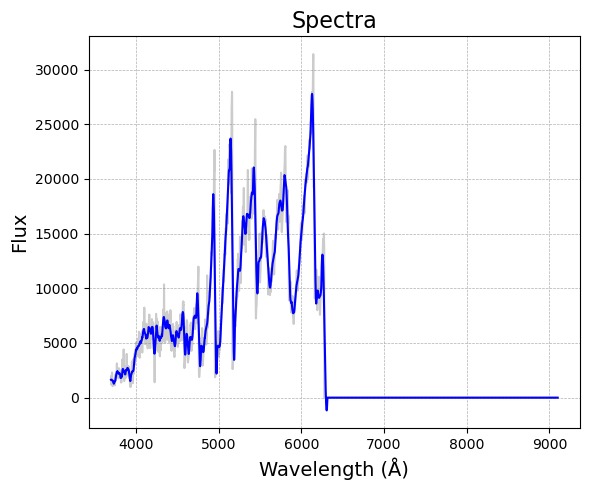

spec-58423-NT212020N164841M01_sp01-206.fits.gz


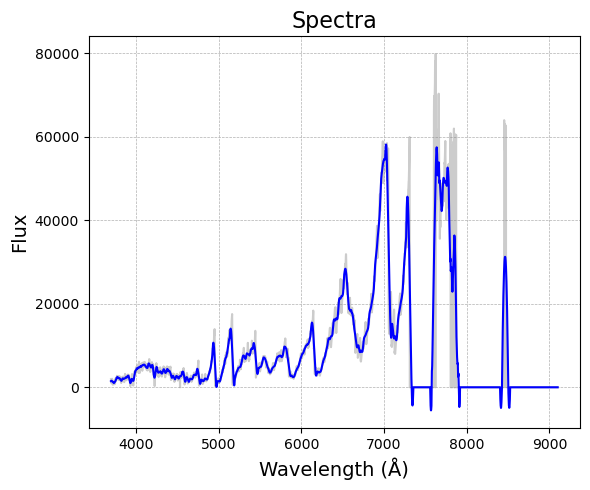

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
252621  09f32628-23ea-564f-a7e3-7aa8fe05b21e     99911   

                        asassn_name other_names    raj2000  dej2000  \
252621  ASASSN-VJ173252.59+092524.6      RU Oph  263.21911   9.4235   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
252621  2.457990e+06  4.490868e+18  J173252.61+092525.2    34822305.0   

                  edr3_source_id galex_id         tic_id  
252621  EDR3 4490867768056017152      NaN  TIC 302786496   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
252621       3.64   203.0            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
252621      11.35         9.784387           0.033238         13.259306   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
252621       

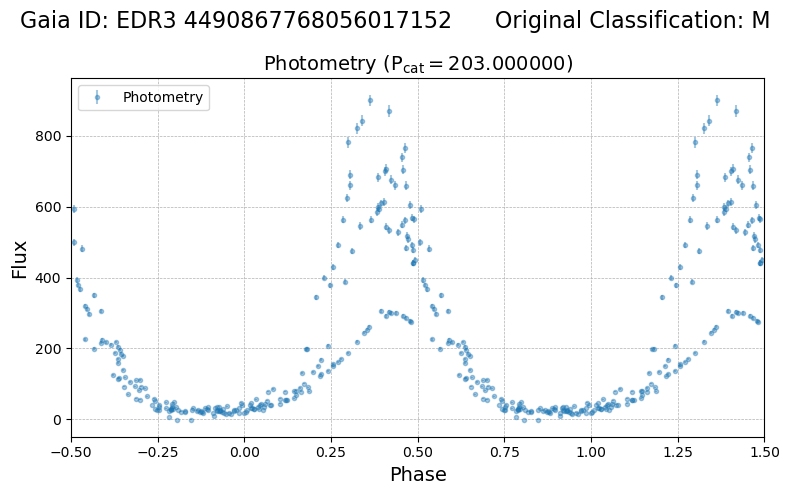

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
252241  72317443-5d73-54a6-95ba-5fd8a3ce8a65    178476   

                        asassn_name other_names    raj2000  dej2000  \
252241  ASASSN-VJ211501.33-025345.0      RR Aqr  318.75554 -2.89582   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
252241  2.457631e+06  2.685367e+18  J211501.32-025345.0    17356021.0   

                  edr3_source_id                galex_id         tic_id  
252241  EDR3 2685366626095005440  GALEX J211501.4-025343  TIC 248555523   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
252241       4.02  184.383789            0.12       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
252241       11.5        10.689408           0.020074         13.557248   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

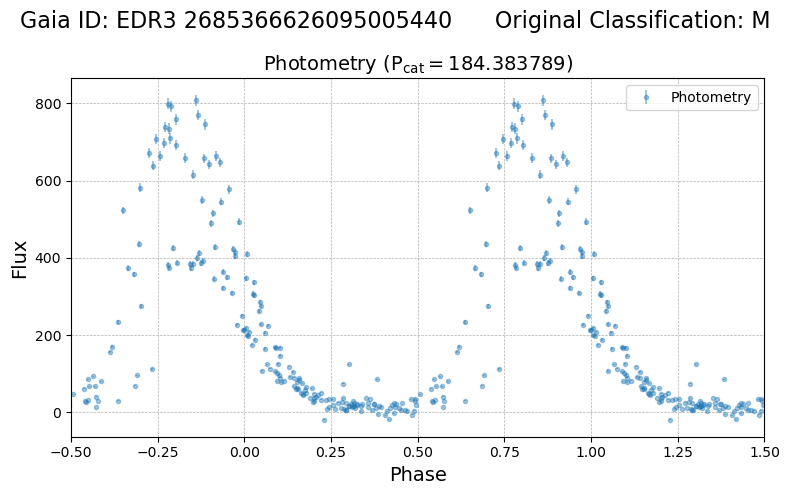

spec-56214-EG211942S025242B02_sp03-087.fits.gz


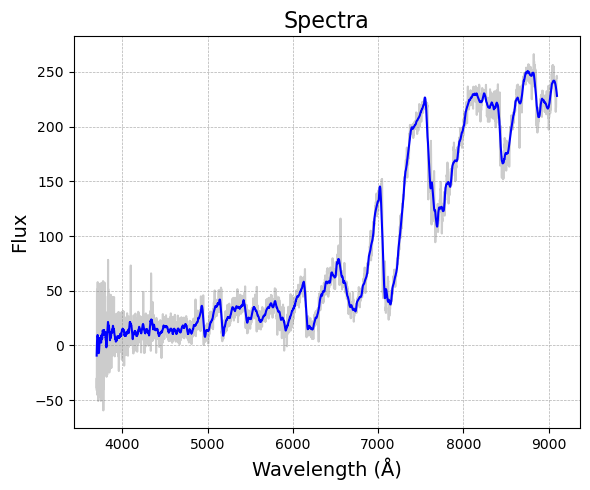

spec-56214-EG211942S025242M02_sp03-087.fits.gz


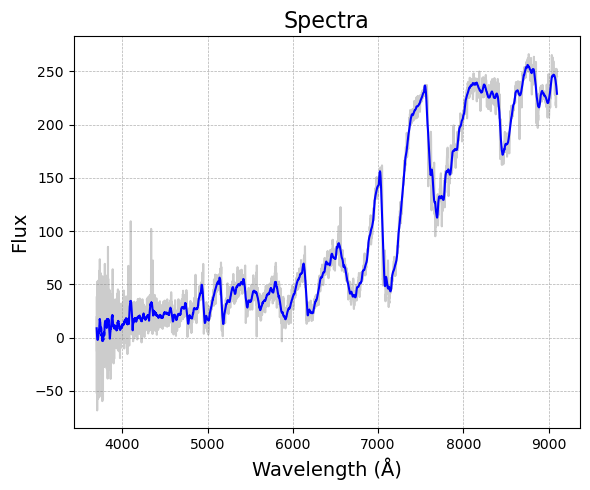

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428140  5a25072f-ead6-5bce-9716-8e3c15298e7b    134384   

                        asassn_name other_names    raj2000  dej2000  \
428140  ASASSN-VJ113449.35+231403.5      AO Leo  173.70562  23.2343   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428140  2.457129e+06  3.980934e+18  J113449.43+231403.2    27671443.0   

                  edr3_source_id galex_id         tic_id  
428140  EDR3 3980934444257231232      NaN  TIC 156940852   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428140       2.23  153.769904            0.28       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428140      12.27        11.678225           0.026123          12.85113   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4281

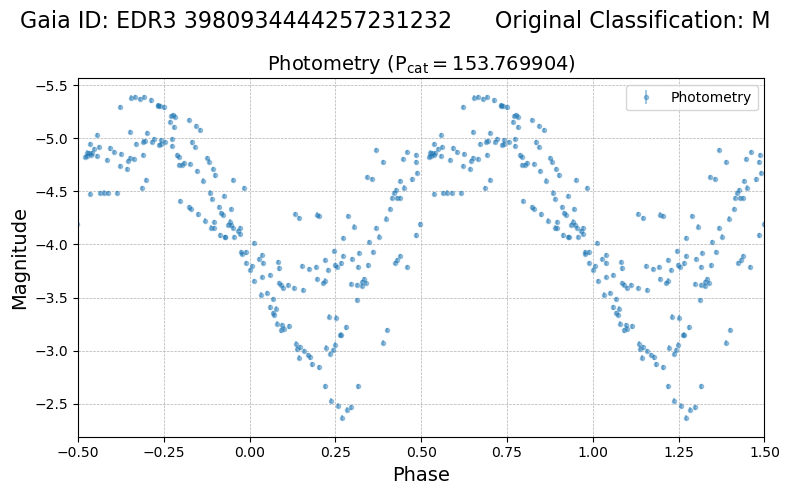

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428298  54c208a3-6e53-5d91-8b58-dec9a8a6f984    116694   

                        asassn_name other_names    raj2000   dej2000  \
428298  ASASSN-VJ224039.68-681417.0      CV Ind  340.16534 -68.23806   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428298  2.457117e+06  6.385753e+18  J224039.75-681416.8    57296269.0   

                  edr3_source_id                galex_id         tic_id  
428298  EDR3 6385753050661908992  GALEX J224039.7-681417  TIC 410151633   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428298       2.19  126.847713            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428298      12.27        11.837232           0.023032          13.10597   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

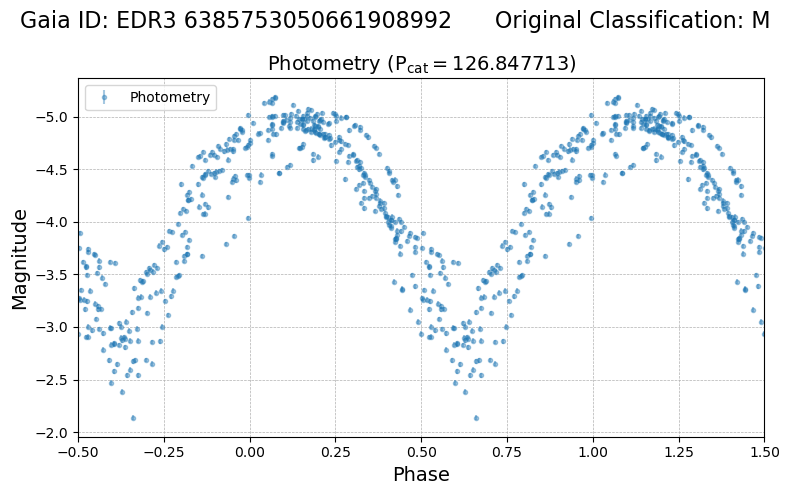

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286960  317abacc-9a1e-58b3-8799-0098fe900faa    210341   

                        asassn_name other_names    raj2000   dej2000  \
286960  ASASSN-VJ065652.09+111432.7       Y Mon  104.21703  11.24241   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286960  2.457358e+06  3.159152e+18  J065652.14+111432.6    22749504.0   

                  edr3_source_id galex_id         tic_id  
286960  EDR3 3159151825799052544      NaN  TIC 235484512   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
286960       3.64  229.868061            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286960      11.24         9.166266           0.039055         12.536219   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

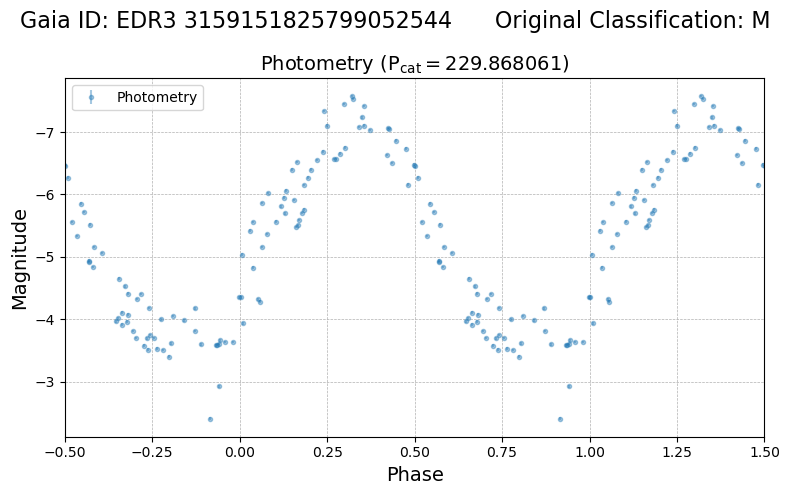

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
288521  005b067b-c2ef-5932-a2f0-e6ee145c72b8    265280   

                        asassn_name other_names    raj2000   dej2000  \
288521  ASASSN-VJ112027.89-615236.0      RS Cen  170.11621 -61.87667   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
288521  2.458226e+06  5.336957e+18  J112027.86-615237.0    40504343.0   

                  edr3_source_id galex_id         tic_id  
288521  EDR3 5336957255733657216      NaN  TIC 468095478   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
288521       3.98  178.833973            0.41       0.79 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
288521      10.78         9.106057           0.031141         12.423387   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
28

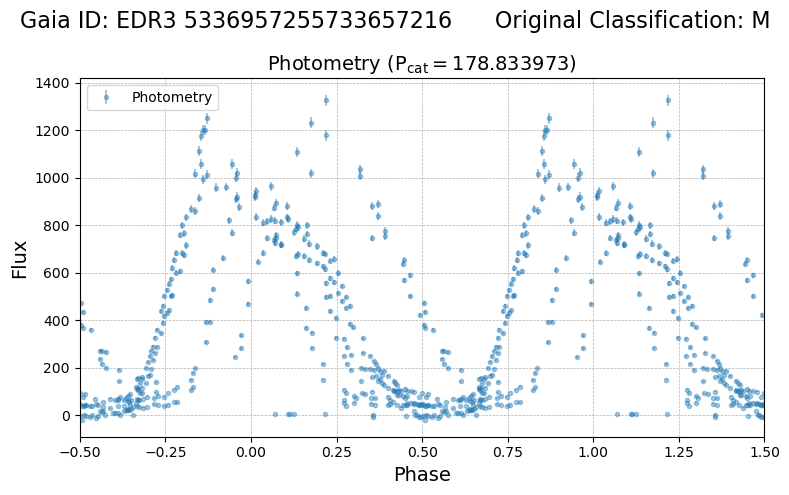

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290460  a2ae49ef-2b05-5166-88f4-a2ed0f15fffd    391472   

                        asassn_name other_names    raj2000  dej2000  \
290460  ASASSN-VJ185445.67-060022.0      OV Sct  283.69028 -6.00612   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290460  2.457078e+06  4.253975e+18  J185445.57-060021.8    31665886.0   

                  edr3_source_id galex_id        tic_id  
290460  EDR3 4253975136087656192      NaN  TIC 33963909   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
290460       3.45  234.455539            0.04       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290460      15.22        12.855954           0.038418         16.428186   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290460

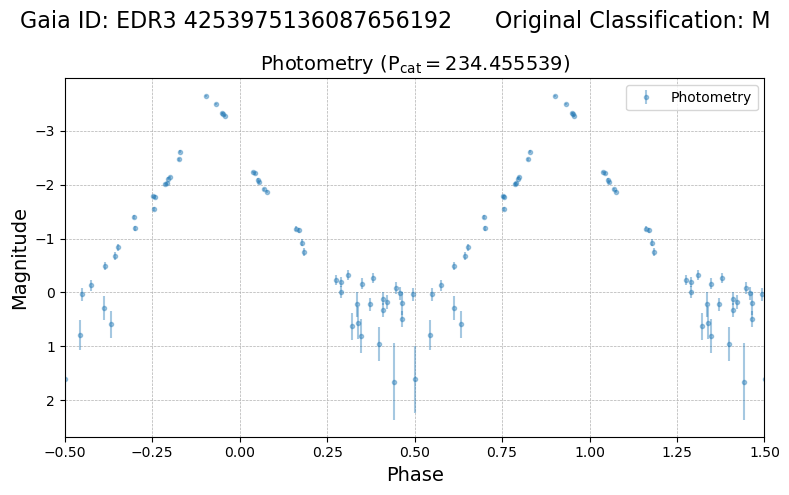

In [119]:
for name in eb_out_names:
    plot_photometry_flux(name)

# Only meta outliers

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
604729  f33f10d0-1e66-5915-a3d0-94ca2a65b050  J144220.44-651158.1   

                        asassn_name other_names    raj2000   dej2000  \
604729  ASASSN-VJ144220.44-651158.1         NaN  220.58518 -65.19948   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
604729  2.457792e+06  5.849779e+18  J144220.44-651158.1           NaN   

                  edr3_source_id galex_id         tic_id  
604729  EDR3 5849779443291114752      NaN  TIC 402547165   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
604729       4.23  455.387179            0.36       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
604729      11.35        12.640289           0.002758          13.60611   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

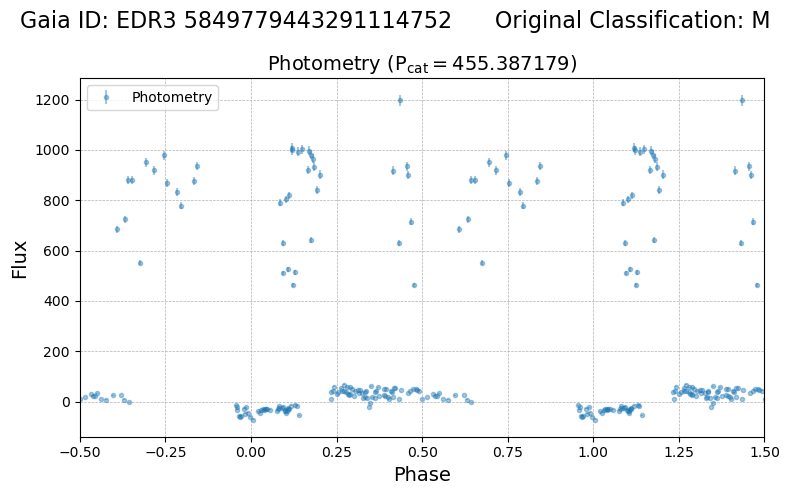

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427397  af6dc949-71df-58ab-b992-4c676aae855f    315172   

                        asassn_name          other_names    raj2000  dej2000  \
427397  ASASSN-VJ180247.23-302255.2  OGLE-BLG-LPV-189791  270.69679  -30.382   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427397  2.457607e+06  4.050152e+18  J180247.29-302256.1           NaN   

                  edr3_source_id galex_id         tic_id  
427397  EDR3 4050152098544123904      NaN  TIC 266105911   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
427397       2.37  180.12633            0.22        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427397      15.62        14.907952           0.002855         16.723253   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

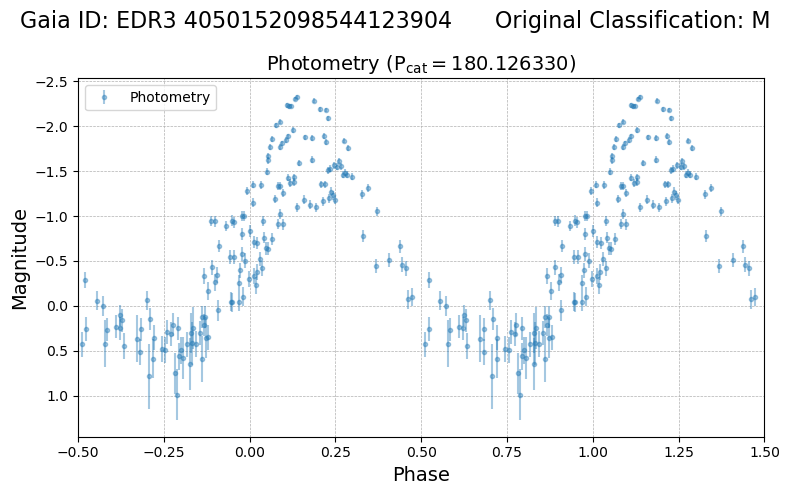

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
370696  ffcd2fa3-5d9c-5d86-949a-cdb16becff1d  AP48616954   

                        asassn_name other_names    raj2000   dej2000  \
370696  ASASSN-VJ123134.50-714629.4         NaN  187.89375 -71.77484   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
370696  2.457852e+06  5.842935e+18  J123134.63-714628.2    48616954.0   

                  edr3_source_id galex_id         tic_id  
370696  EDR3 5842934777202254592      NaN  TIC 326043702   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
370696       3.04  197.014958            0.43       0.76 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
370696      15.66        15.062543           0.002775         16.146338   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  

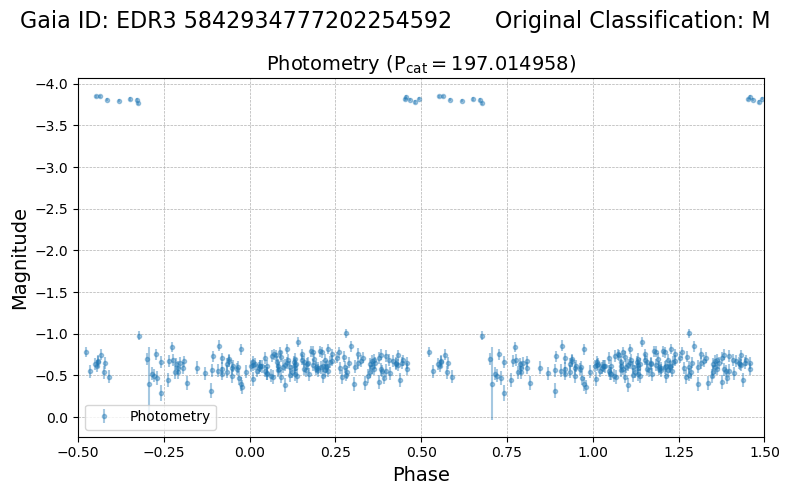

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
447458  cb200a92-ef5c-5049-aad6-16f21a7836ce  AP53653281   

                        asassn_name other_names    raj2000   dej2000  \
447458  ASASSN-VJ162112.67-252547.6         NaN  245.30279 -25.42989   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
447458  2.457432e+06  6.048613e+18  J162112.70-252548.1    53653281.0   

                  edr3_source_id galex_id         tic_id  
447458  EDR3 6048613030059616128      NaN  TIC 322928112   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
447458       4.76  694.163245            0.28       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
447458      14.98        14.609267           0.002766         15.521087   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  

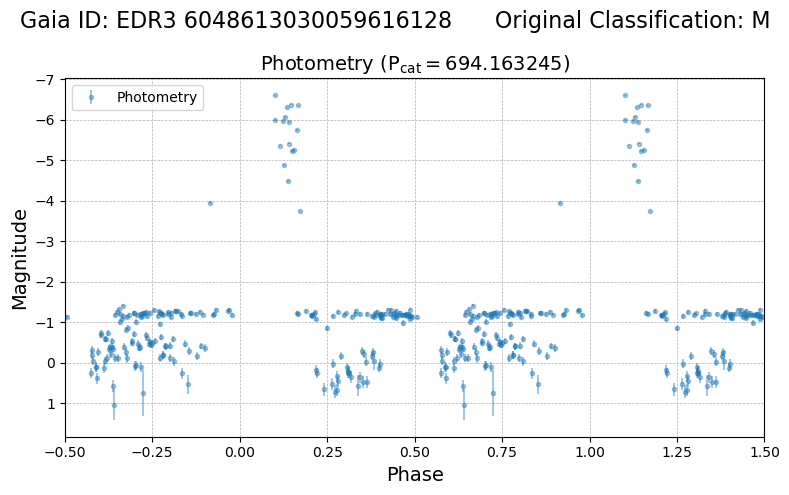

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
424648  809d253c-5899-5395-91f3-4889924f885b  AP53140906   

                        asassn_name other_names    raj2000   dej2000  \
424648  ASASSN-VJ162116.74-341923.4         NaN  245.31975 -34.32316   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
424648  2.457878e+06  6.023177e+18  J162116.77-341923.5    53140906.0   

                  edr3_source_id galex_id         tic_id  
424648  EDR3 6023176721910847360      NaN  TIC 210642563   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
424648       2.13  263.181942            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
424648      13.79        13.660692            0.00277         14.819996   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \

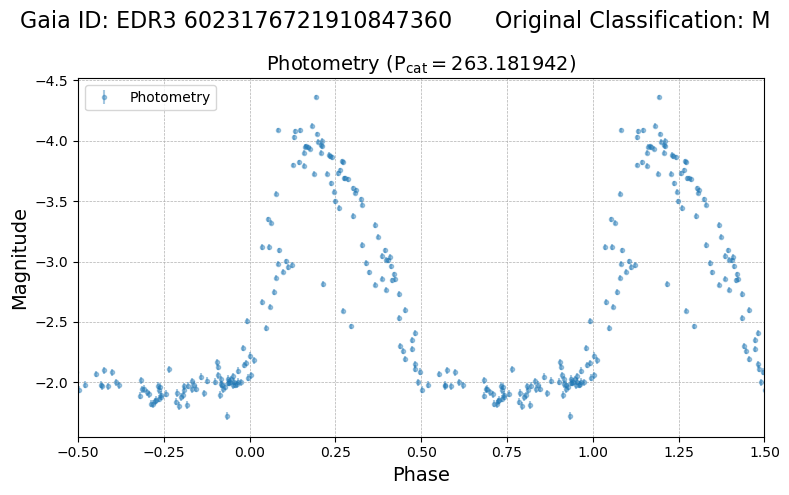

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
291790  d12cba39-7119-5781-9d31-05874c5b9b5c     68637   

                        asassn_name other_names    raj2000   dej2000  \
291790  ASASSN-VJ180442.56+232237.0      FX Her  271.17732  23.37694   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
291790  2.457040e+06  4.577539e+18  J180442.61+232236.8    35741295.0   

                  edr3_source_id galex_id         tic_id  
291790  EDR3 4577538558825200896      NaN  TIC 135363355   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
291790       4.11  359.040617            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
291790       14.3        10.315885           0.028794         14.421289   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
291

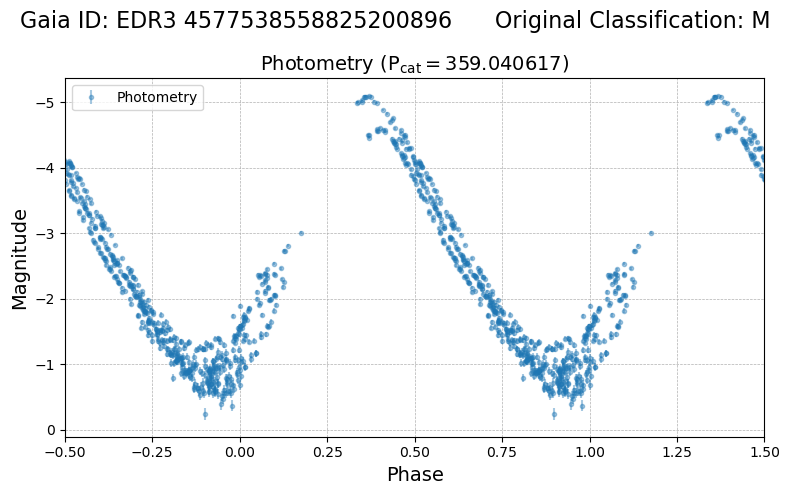

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
186535  79812878-9035-5167-b924-76cf4c5693b4    237836   

                        asassn_name other_names   raj2000   dej2000  \
186535  ASASSN-VJ054656.47+175430.8      EI Tau  86.73531  17.90855   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
186535  2.457448e+06  3.398260e+18  J054656.54+175431.0    25086517.0   

                  edr3_source_id galex_id         tic_id  
186535  EDR3 3398260111230028160      NaN  TIC 247642734   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
186535       2.41  343.229788            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
186535      12.19         8.927369           0.002855          11.16481   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1865

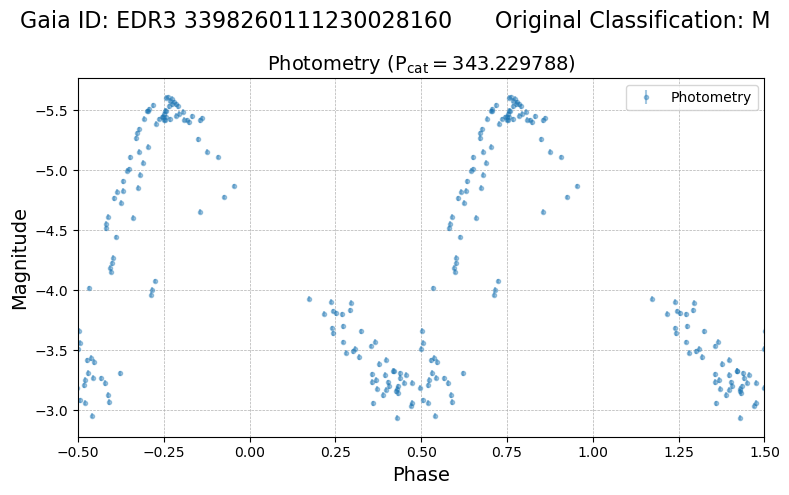

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428256  8116b5a7-8e7e-565d-8dae-afb99478943f    398670   

                        asassn_name other_names    raj2000   dej2000  \
428256  ASASSN-VJ150051.63-422936.5      AO Cen  225.21512 -42.49348   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428256  2458310.684  5.908642e+18  J150051.65-422936.8    50637755.0   

                  edr3_source_id galex_id         tic_id  
428256  EDR3 5908642313626263296      NaN  TIC 334426769   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428256       3.98  192.053048             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428256      10.95         8.585993           0.009922         10.159012   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag   bp_rp  \
428256

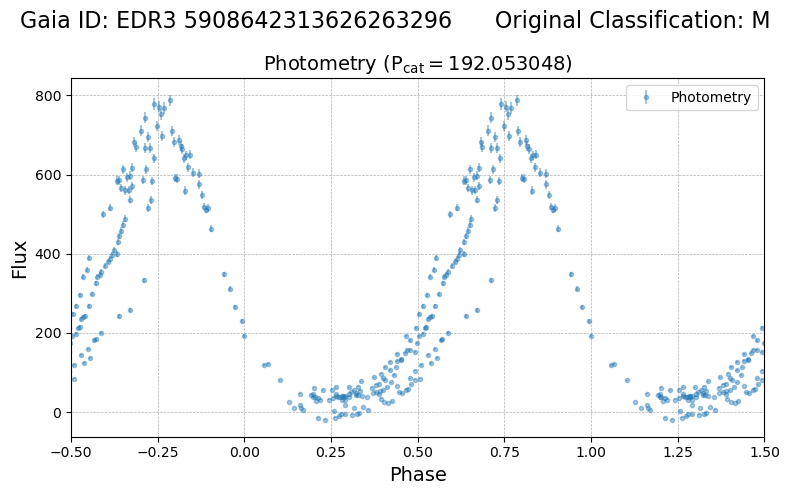

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
604704  58f5fb17-f66a-56eb-8ecb-76e466c5c253  J053751.40-660558.7   

                        asassn_name other_names   raj2000   dej2000  \
604704  ASASSN-VJ053751.40-660558.7         NaN  84.46416 -66.09964   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
604704  2.457700e+06  4.659924e+18  J053751.38-660558.7           NaN   

                  edr3_source_id galex_id         tic_id  
604704  EDR3 4659923625096599936      NaN  TIC 277317573   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
604704       2.33  274.023906            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
604704      16.55        14.446159           0.004248         15.542915   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

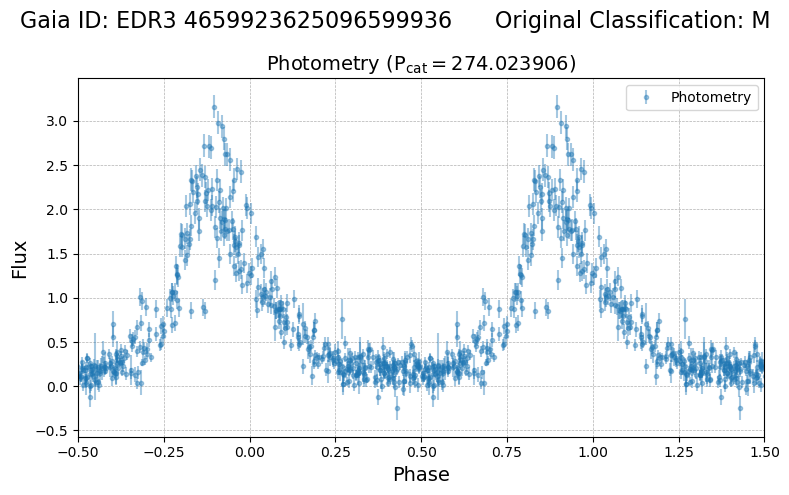

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
612555  d2661ee4-2ecb-5d24-8fde-167a02ac57eb  J052422.18-660637.3   

                        asassn_name              other_names   raj2000  \
612555  ASASSN-VJ052422.18-660637.3  Gaia4660530418068755712  81.09242   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
612555 -66.11035  2.456878e+06  4.660530e+18  J052422.16-660637.2   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
612555           NaN  EDR3 4660530418068755712      NaN  TIC 373596936   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
612555       2.93  468.917049            0.26       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
612555      15.82        13.478193           0.007351          14.75902   

        e_phot_bp_mean_mag  phot_r

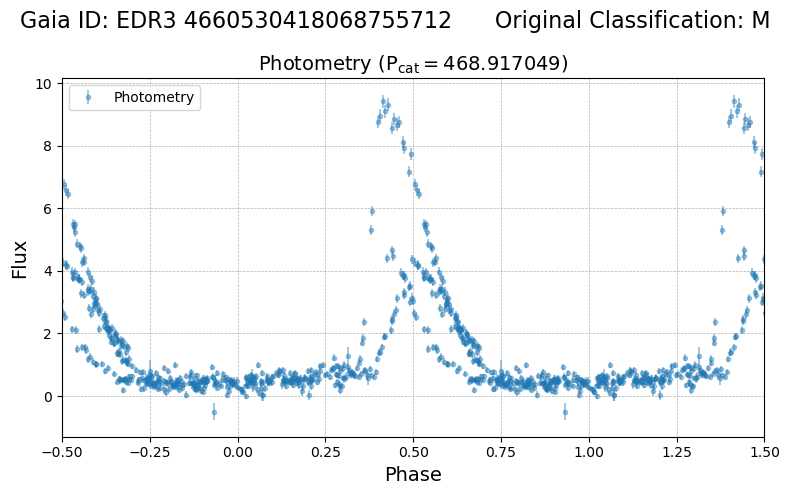

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
267049  2740609a-cd30-56ba-86da-2156f8aecd96    285046   

                        asassn_name other_names   raj2000   dej2000  \
267049  ASASSN-VJ025956.30+423714.7      IV Per  44.98457  42.62074   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
267049  2.457600e+06  4.324277e+17  J025956.26+423714.7     3480835.0   

                 edr3_source_id galex_id         tic_id  
267049  EDR3 432427722659296256      NaN  TIC 192252686   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
267049       3.37  284.978304            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
267049      12.49         9.435619           0.009172         11.260265   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
267049

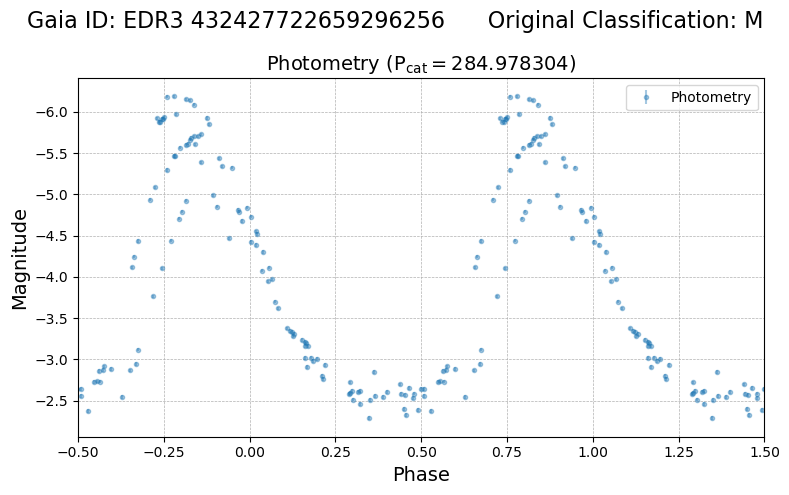

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426987  8e75ba65-3a84-5b88-94ac-a0f3dd5d58fa    423621   

                        asassn_name          other_names    raj2000   dej2000  \
426987  ASASSN-VJ155430.08-562150.9  GDS_J1554308-562150  238.62533 -56.36415   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426987  2.457836e+06  5.836085e+18  J155430.12-562150.9           NaN   

                  edr3_source_id galex_id        tic_id  
426987  EDR3 5836085060403821696      NaN  TIC 86160856   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426987       1.94  679.165211             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426987      15.31        14.905128           0.004617         18.366964   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

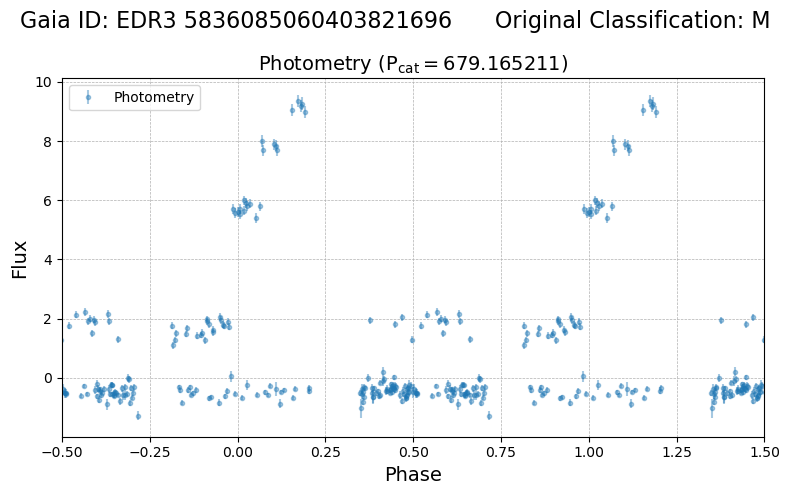

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
585149  17f9e8a3-f450-5972-ba5b-523c1b8f8c74  J051655.88-664650.0   

                        asassn_name         other_names   raj2000   dej2000  \
585149  ASASSN-VJ051655.88-664650.0  OGLE-LMC-ECL-31227  79.23282 -66.78055   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
585149  2.458153e+06  4.658965e+18  J051655.88-664650.0           NaN   

                  edr3_source_id galex_id         tic_id  
585149  EDR3 4658965125837895680      NaN  TIC 179037433   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
585149       2.36  313.629826            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
585149      16.12         14.29475           0.004815         15.481012   

        e_phot_bp_mean_mag  phot_rp_mean_mag

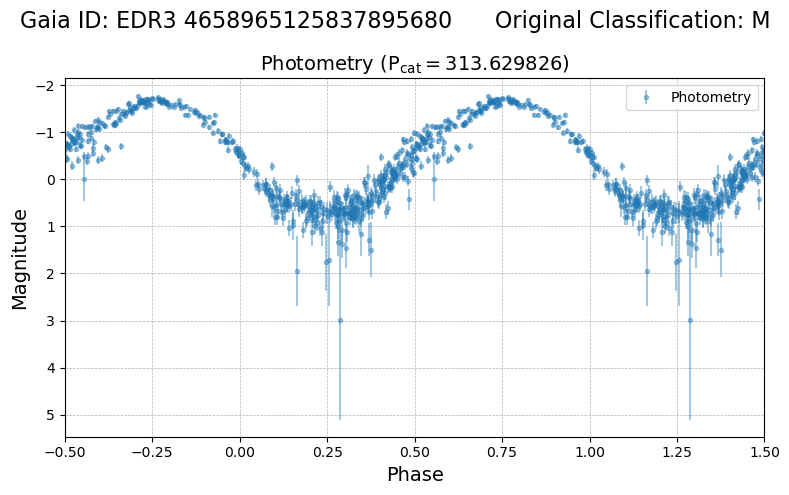

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
100379  d45d8a44-baaf-508e-a728-402b83c4aa92    180519   

                        asassn_name other_names    raj2000   dej2000  \
100379  ASASSN-VJ200602.29+214959.1      HW Vul  301.50954  21.83308   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
100379  2.457836e+06  1.829901e+18  J200602.30+214959.2    10505492.0   

                  edr3_source_id galex_id         tic_id  
100379  EDR3 1829900713754398976      NaN  TIC 393241338   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
100379       1.87  76.503905             0.5       0.75 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
100379      13.46        11.879663           0.005952         13.124277   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1003

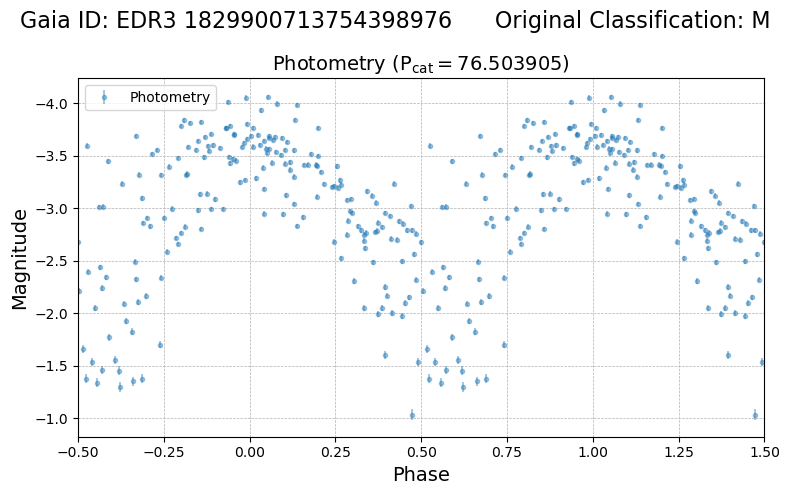

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427025  af2bcf32-ebe0-51f4-8d96-a60e86543646    473008   

                        asassn_name other_names    raj2000   dej2000  \
427025  ASASSN-VJ170623.31-495542.8         NaN  256.59733 -49.92863   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427025  2.457476e+06  5.926165e+18  J170623.30-495542.8           NaN   

                  edr3_source_id galex_id         tic_id  
427025  EDR3 5926165191784194560      NaN  TIC 212768481   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427025       1.86  457.051334            0.95       0.49 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427025      14.39        12.635833           0.007562         14.535152   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

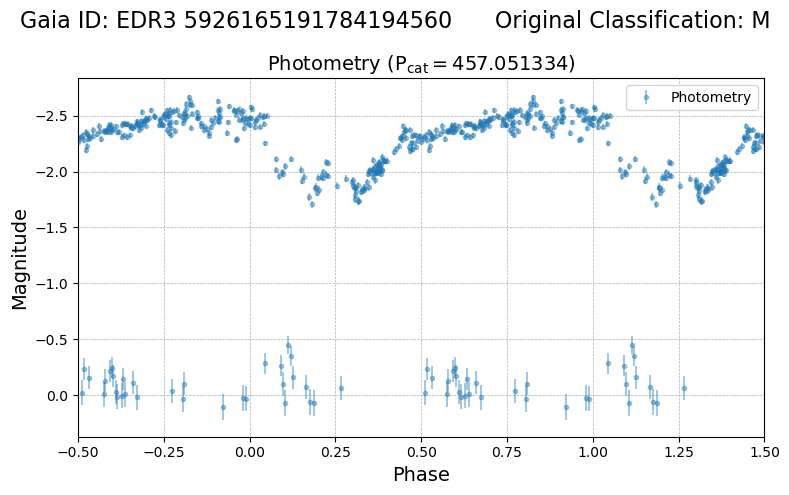

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
612519  41917758-6be9-554b-8fdb-560f33caf040  J052917.70-670234.6   

                        asassn_name              other_names   raj2000  \
612519  ASASSN-VJ052917.70-670234.5  Gaia4660210082249007744  82.32374   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
612519 -67.04293  2.457609e+06  4.660210e+18  J052917.68-670234.5   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
612519           NaN  EDR3 4660210082249007744      NaN  TIC 287400440   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
612519       2.45  727.184581            0.08       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
612519      16.13        12.891753           0.003297         14.441731   

        e_phot_bp_mean_mag  phot_r

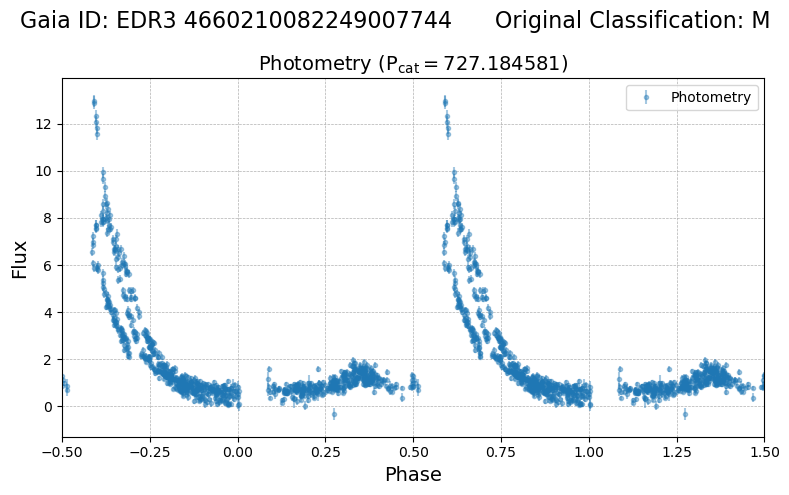

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426604  649efb72-5756-54af-8ae1-7c16716204d1    139890   

                        asassn_name          other_names   raj2000   dej2000  \
426604  ASASSN-VJ052616.05-660659.2  ASAS J052616-6607.0  81.56689 -66.11645   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426604  2.457459e+06  4.660533e+18  J052616.07-660658.9    36286697.0   

                  edr3_source_id galex_id         tic_id  
426604  EDR3 4660533235570697344      NaN  TIC 373846914   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
426604        3.4  519.75802            0.26       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426604      13.96         12.52413           0.003097         14.072431   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

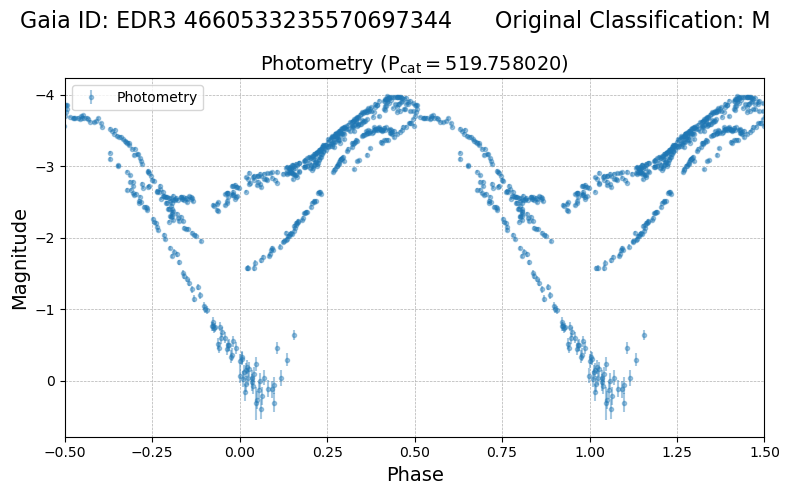

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426765  6bdab899-0c34-5909-a637-f5a88fe7e0d9    146185   

                        asassn_name           other_names   raj2000   dej2000  \
426765  ASASSN-VJ062925.86-661504.4  SSS_J062925.6-661503  97.35775 -66.25122   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426765  2.456980e+06  5.283676e+18  J062925.83-661504.2           NaN   

                  edr3_source_id galex_id         tic_id  
426765  EDR3 5283675987387336960      NaN  TIC 167245621   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426765       2.44  260.370603            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426765      16.01        14.809519           0.010531         16.184673   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

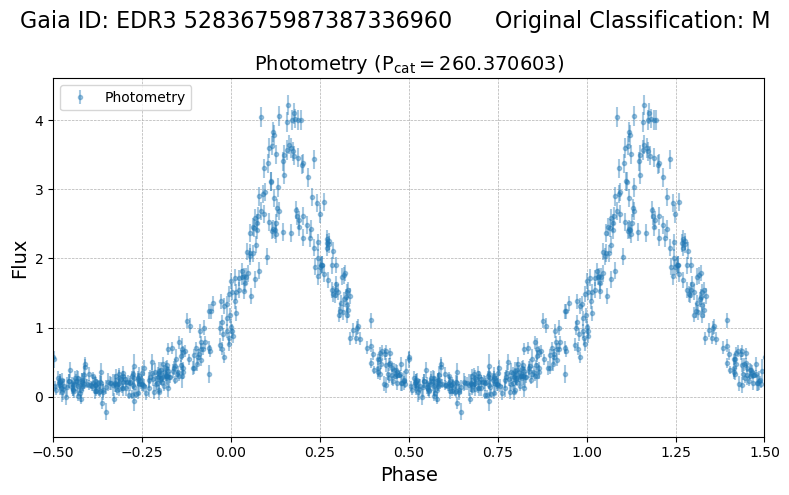

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
190290  13ddec11-9d0d-51ef-a7e4-15d022dc0db8     76096   

                        asassn_name other_names    raj2000   dej2000  \
190290  ASASSN-VJ182613.59-560219.3      RZ Tel  276.55661 -56.03869   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
190290  2.457072e+06  6.649175e+18  J182613.49-560219.3    58592538.0   

                  edr3_source_id galex_id         tic_id  
190290  EDR3 6649175111599466240      NaN  TIC 119384063   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
190290       2.92  176.600019            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
190290      11.84        10.415793           0.009495          11.52395   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
19

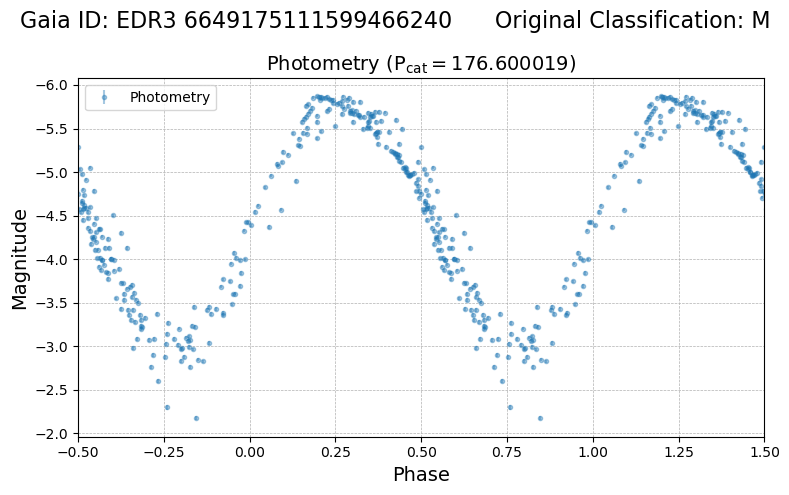

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428006  8d09077f-9c67-5ead-8d38-4308cb59dd16    265141   

                        asassn_name          other_names    raj2000   dej2000  \
428006  ASASSN-VJ111943.78-604848.2  GDS_J1119437-604848  169.93241 -60.81338   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428006  2.457594e+06  5.337492e+18  J111943.74-604848.1           NaN   

                  edr3_source_id galex_id         tic_id  
428006  EDR3 5337492099454874752      NaN  TIC 468018665   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428006       1.77  189.275943            0.98       0.53 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428006      16.91         15.50427           0.009933         20.234686   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

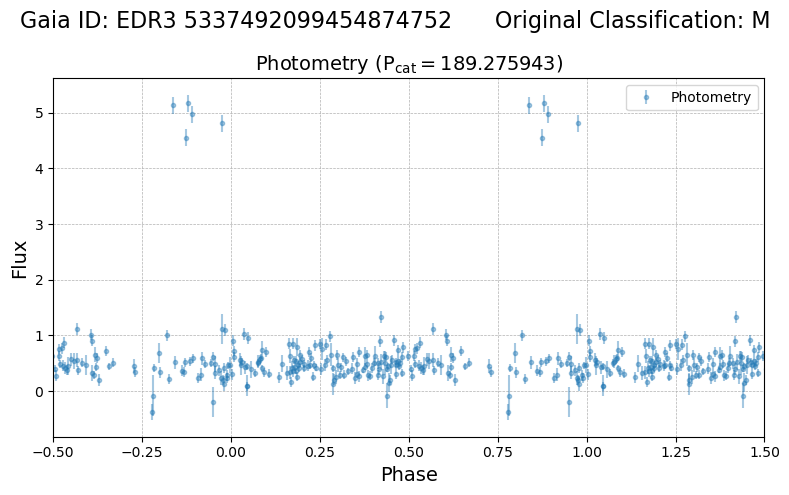

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427742  bc36b765-6bf6-5f2c-8c2d-a5368a7e2c1a    118085   

                        asassn_name           other_names    raj2000  \
427742  ASASSN-VJ085524.19-212236.5  SSS_J085524.2-212236  133.85078   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
427742 -21.37681  2.456944e+06  5.655874e+18  J085524.22-212236.7   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
427742    45785517.0  EDR3 5655873691427491456      NaN  TIC 410208887   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427742       1.98  150.015342            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427742      14.98        13.615685           0.008701         14.691809   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

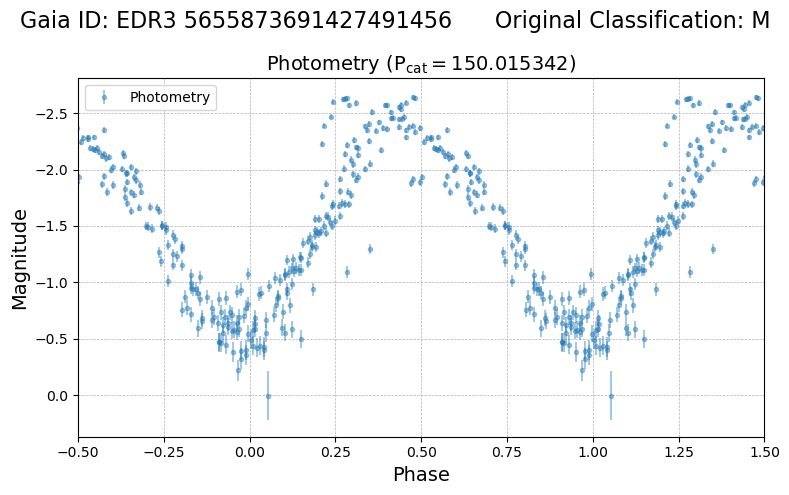

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
215551  57c9b02d-075e-5fed-8564-6c50aac48e0e    130157   

                        asassn_name           other_names   raj2000   dej2000  \
215551  ASASSN-VJ053756.99+444100.2  NSVS J0537571+444104  84.48747  44.68339   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
215551  2.456895e+06  1.973409e+17  J053756.99+444100.4     1043549.0   

                 edr3_source_id galex_id         tic_id  
215551  EDR3 197340866647843968      NaN  TIC 470578106   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
215551       3.61  349.888431            0.18        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
215551      14.46        12.577969           0.003138         15.491546   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

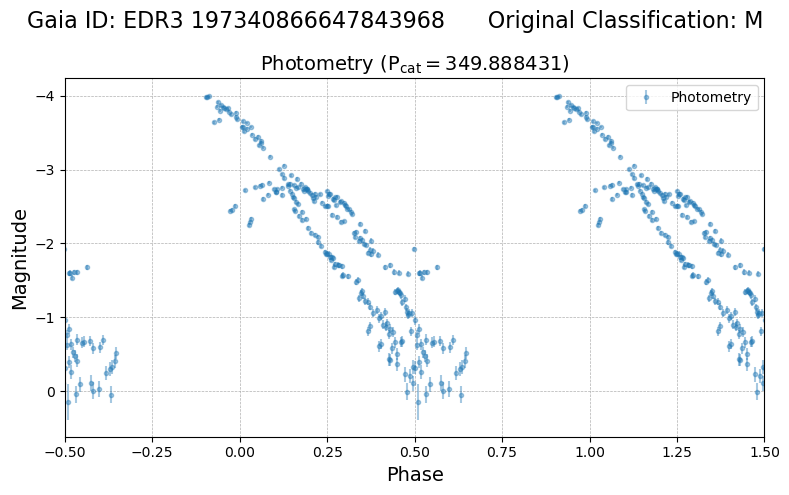

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236977  2701c79d-33ad-5085-8493-67a9095e73d3    286342   

                        asassn_name other_names    raj2000   dej2000  \
236977  ASASSN-VJ180805.98-375818.8      GM CrA  272.02493 -37.97189   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236977  2.457954e+06  4.036257e+18  J180805.80-375818.4           NaN   

                  edr3_source_id galex_id         tic_id  
236977  EDR3 4036256818515243008      NaN  TIC 330349466   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
236977       2.57  224.656201            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236977      13.73        19.915304           0.008471         20.525871   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag   bp_rp  \
2369

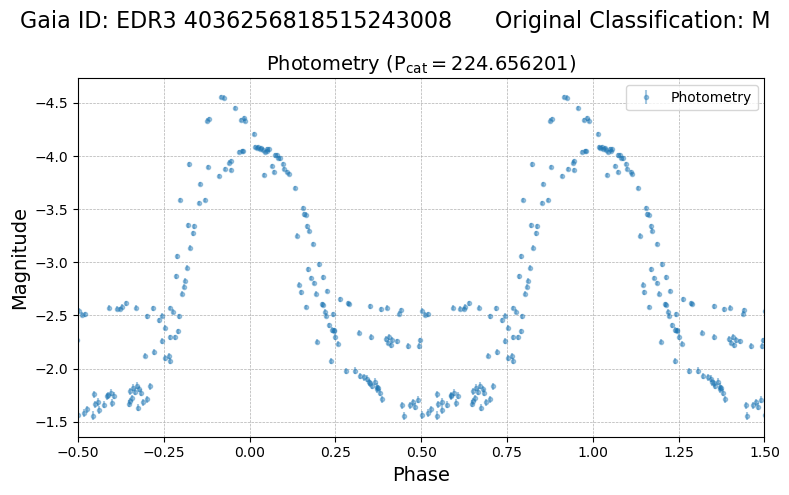

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
280219  ceaeae56-5e3e-535f-918b-005ba00d8707    399660   

                        asassn_name other_names    raj2000   dej2000  \
280219  ASASSN-VJ170029.01-261123.0      EP Oph  255.12086 -26.18972   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
280219  2.458203e+06  4.112093e+18  J170029.08-261123.3           NaN   

                  edr3_source_id galex_id        tic_id  
280219  EDR3 4112092918649542784      NaN  TIC 18947154   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
280219       3.23  188.439462            0.15       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
280219      14.01        19.477775           0.006769         18.390165   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2802

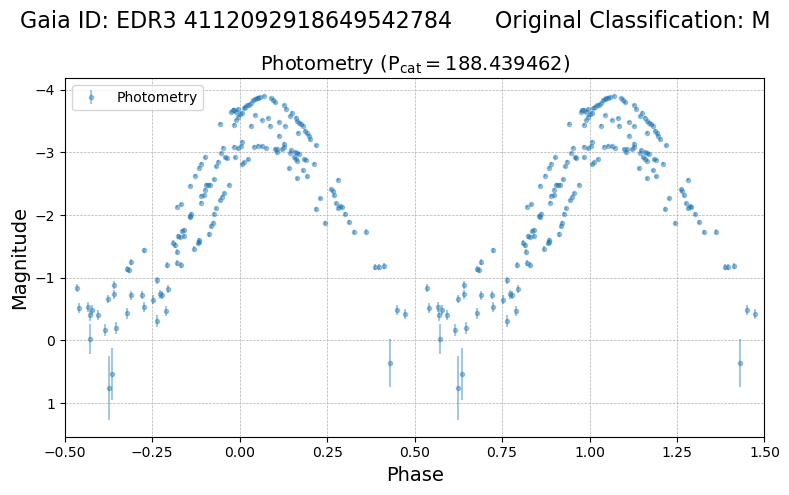

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426600  a1b37841-b71f-511d-bb77-963335b99829    333648   

                        asassn_name          other_names    raj2000   dej2000  \
426600  ASASSN-VJ180220.78-345354.4  OGLE-BLG-LPV-186532  270.58658 -34.89844   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426600  2.458175e+06  4.042029e+18  J180220.77-345354.5           NaN   

                  edr3_source_id galex_id         tic_id  
426600  EDR3 4042028876655165056      NaN  TIC 265651686   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426600       2.87  134.495486            0.07       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426600      15.13         14.91945           0.005811         18.570782   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

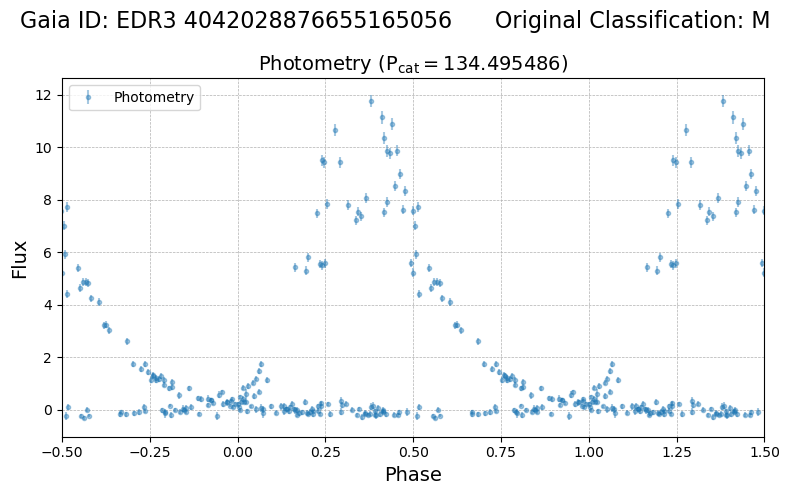

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id            source_id  \
612485  94302faa-e71c-581b-915e-cfd7c6af3b56  J051540.82-660458.0   

                        asassn_name              other_names   raj2000  \
612485  ASASSN-VJ051540.82-660458.0  Gaia4660486678135508224  78.92008   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
612485 -66.08277  2.456793e+06  4.660487e+18  J051540.82-660457.9   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
612485           NaN  EDR3 4660486678135508224      NaN  TIC 40975209   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
612485       3.08  551.614234            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
612485      15.95        13.461846           0.003918         15.377811   

        e_phot_bp_mean_mag  phot_rp_

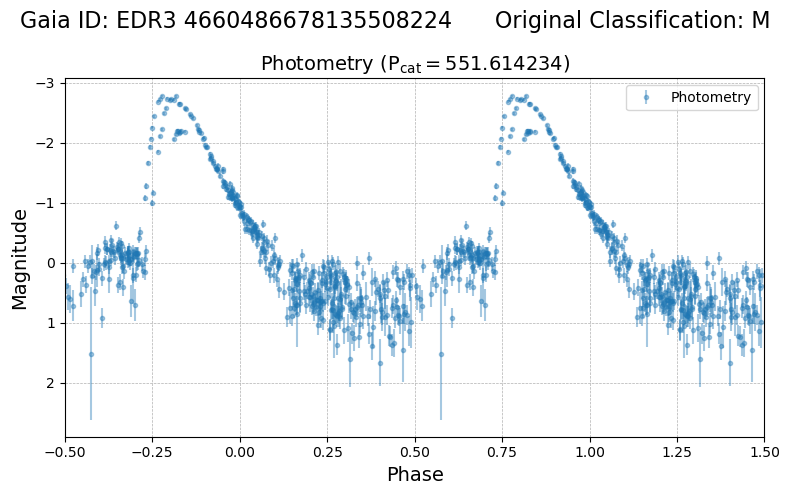

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426527  8b94467b-21b1-5758-9557-ea23347be850    365157   

                        asassn_name          other_names    raj2000   dej2000  \
426527  ASASSN-VJ124134.05-634849.8  GDS_J1241345-634849  190.39189 -63.81383   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426527  2.458162e+06  5.862865e+18  J124133.97-634849.9           NaN   

                  edr3_source_id galex_id         tic_id  
426527  EDR3 5862865246541910272      NaN  TIC 433639246   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426527       4.53  215.561107            0.24       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426527      17.37        14.809333           0.015438         19.361124   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

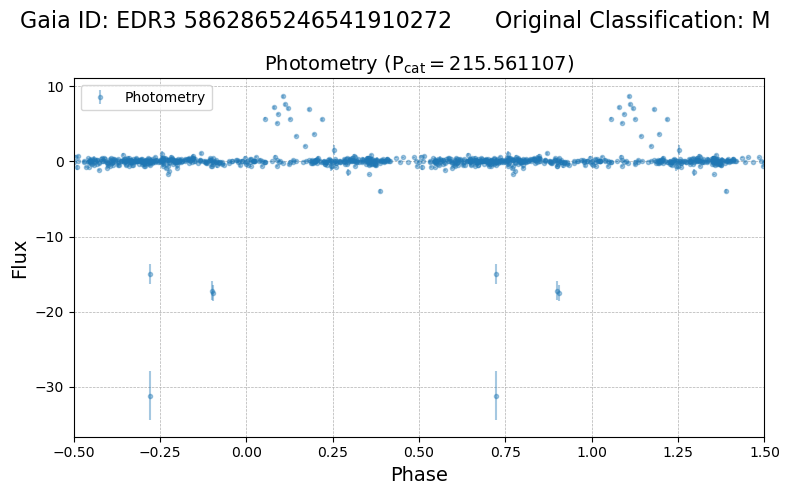

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290678  7597ecda-1974-57b1-950e-634aa49173bb    193285   

                        asassn_name other_names    raj2000   dej2000  \
290678  ASASSN-VJ134536.93-333345.6   V0665 Cen  206.40387 -33.56268   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290678  2.457024e+06  6.171135e+18  J134536.90-333345.5    55716652.0   

                  edr3_source_id galex_id        tic_id  
290678  EDR3 6171135424667134848      NaN  TIC 30067802   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
290678       3.76   203.0            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290678      12.85        10.188004           0.010177         11.732952   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290678      

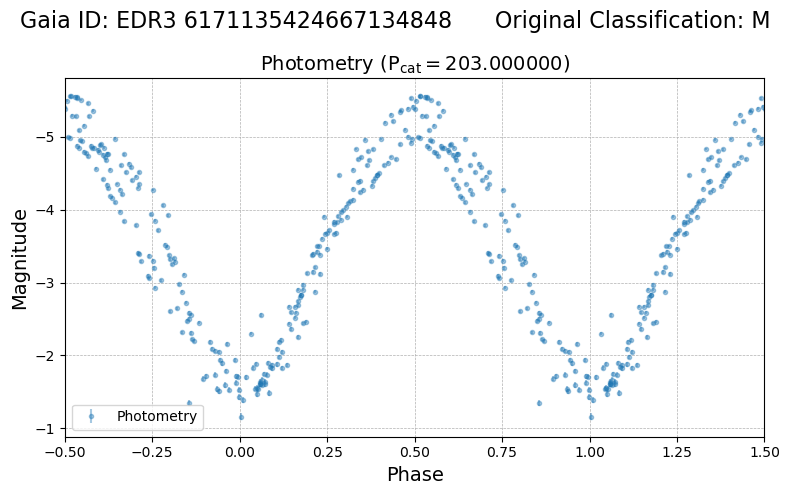

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
7555  b21cecfb-a2cb-5893-9530-74504bdf6433    492739   

                      asassn_name other_names    raj2000   dej2000  \
7555  ASASSN-VJ172822.08-194635.4         NaN  262.09248 -19.77654   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
7555  2.457437e+06  4.121662e+18  J172822.07-194635.2    29411746.0   

                edr3_source_id galex_id         tic_id  
7555  EDR3 4121662277526418432      NaN  TIC 104165276   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
7555       2.23   205.0            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
7555      14.46        18.411972           0.004494          19.15627   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
7555            0.042066         15.

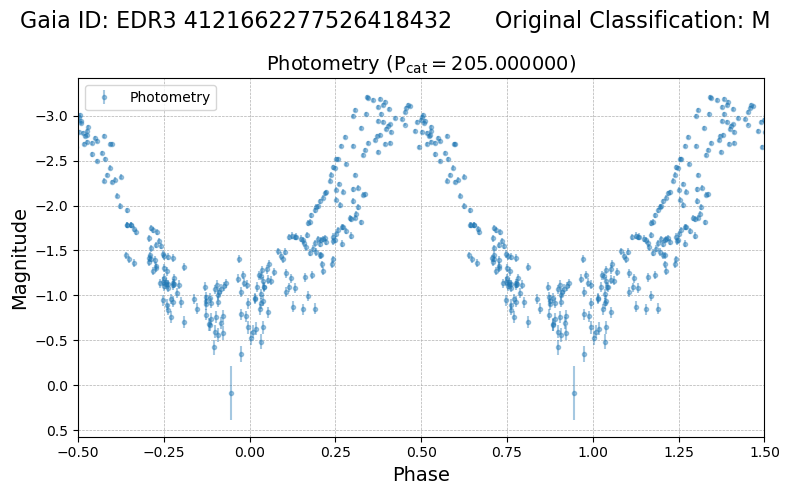

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427707  95c92e38-1fc2-52e3-9bb8-4b8b83489c1b    347224   

                        asassn_name           other_names   raj2000   dej2000  \
427707  ASASSN-VJ051843.73+603949.0  NSVS J0518437+603950  79.68219  60.66361   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427707  2.458026e+06  2.845313e+17  J051843.70+603948.7     1965007.0   

                 edr3_source_id galex_id        tic_id  
427707  EDR3 284531348454791808      NaN  TIC 82887084   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427707       2.26  257.120406            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427707      14.92        12.872709           0.008617         14.790663   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

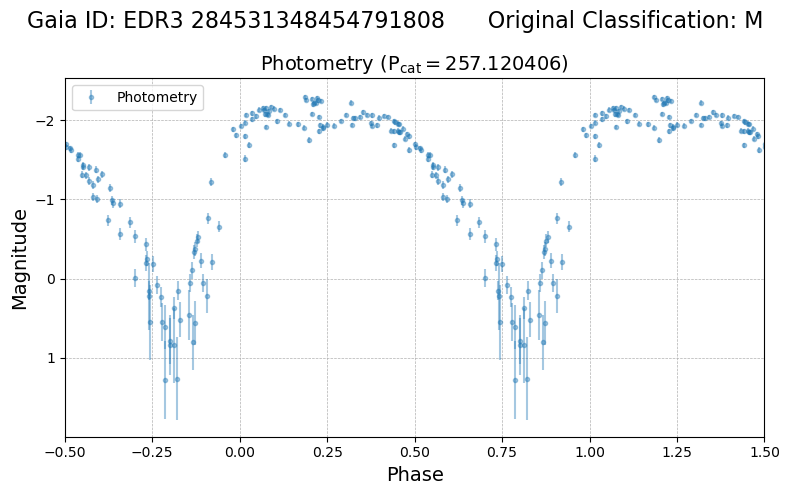

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
407668  1cd0ce39-fca1-5113-a869-f107ad87cf2b    459211   

                        asassn_name other_names  raj2000   dej2000  \
407668  ASASSN-VJ044152.88-653742.7         NaN  70.4705 -65.62847   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
407668  2.457045e+06  4.662825e+18  J044152.88-653742.5    36304815.0   

                  edr3_source_id galex_id        tic_id  
407668  EDR3 4662824789570396672      NaN  TIC 55399035   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
407668       2.31  180.66859            0.24       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
407668      16.26        15.540589           0.008697         17.277231   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
407668    

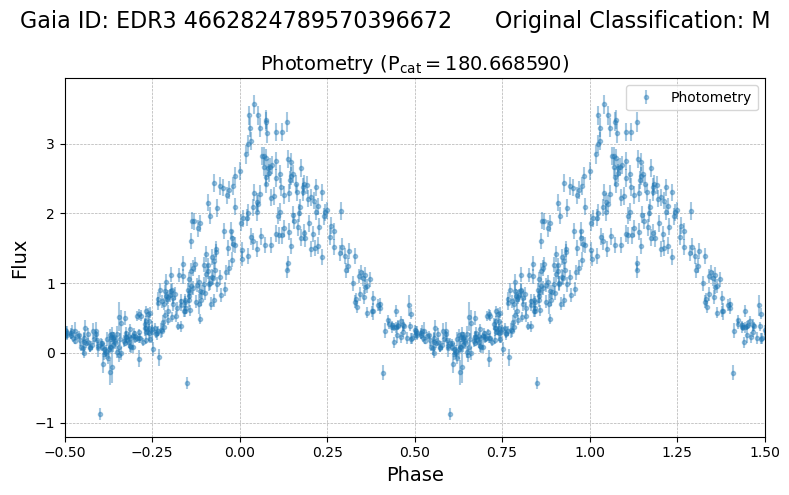

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
277115  4608930a-df21-598f-836a-68c580dfa977    184996   

                        asassn_name other_names    raj2000  dej2000  \
277115  ASASSN-VJ111245.34-071753.7       U Crt  168.18891 -7.29824   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
277115  2.457341e+06  3.784343e+18  J111245.30-071754.4    27119664.0   

                  edr3_source_id                galex_id         tic_id  
277115  EDR3 3784343448838114304  GALEX J111245.3-071754  TIC 143068286   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
277115       4.35  168.945245            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
277115      11.94         9.889627           0.023805         11.776426   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

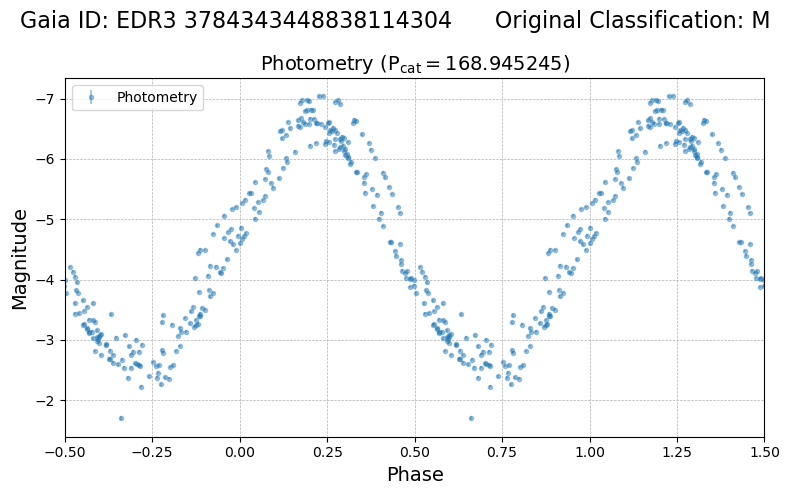

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
182825  92f03a85-1947-5974-b823-eb3549b41b4d    182432   

                        asassn_name               other_names    raj2000  \
182825  ASASSN-VJ095915.83-352936.0  SSS 110127:095916-352936  149.81594   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
182825 -35.49334  2.458071e+06  5.434547e+18  J095915.68-352936.0   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
182825    42411009.0  EDR3 5434546643620316800      NaN  TIC 48425157   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
182825       2.66  386.201598            0.24       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
182825      15.94         14.51543           0.007985         16.834074   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

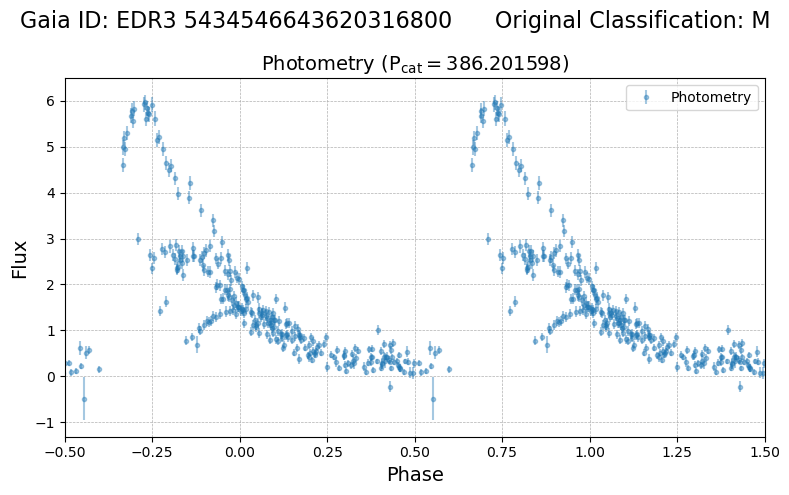

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
7798  425211e0-373f-5d39-a064-0cee021b973f    477813   

                      asassn_name other_names    raj2000  dej2000  \
7798  ASASSN-VJ182020.73-063601.7         NaN  275.08677 -6.60057   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
7798  2.458002e+06  4.160853e+18  J182020.73-063601.8    30187208.0   

                edr3_source_id galex_id        tic_id  
7798  EDR3 4160853201291188096      NaN  TIC 16969509   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
7798       2.32   149.0             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
7798      15.77        20.054674           0.012945         19.941067   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
7798            0.492575         17.1634

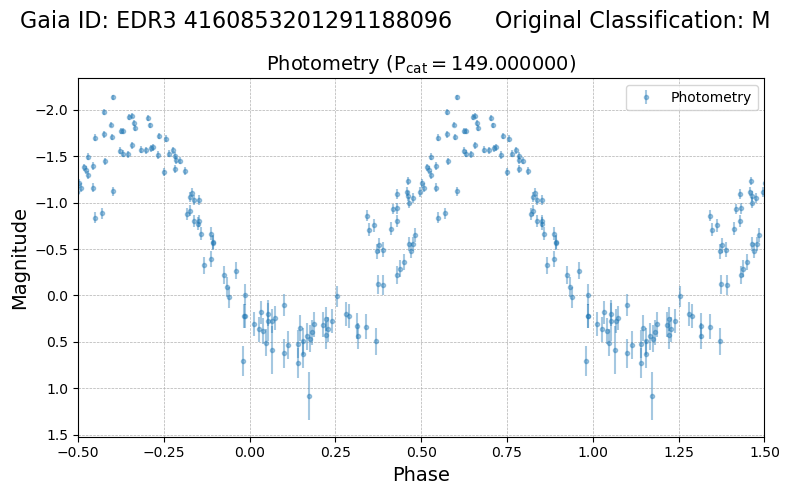

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
256672  0aadf188-ef17-55cd-9e1f-5f0dfb486edd    173362   

                        asassn_name other_names    raj2000   dej2000  \
256672  ASASSN-VJ093754.95-274349.9      RX Ant  144.47896 -27.73054   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
256672  2.457818e+06  5.657751e+18  J093754.93-274349.6    45802089.0   

                  edr3_source_id                galex_id         tic_id  
256672  EDR3 5657750768231800704  GALEX J093754.9-274349  TIC 189644819   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
256672       2.51  234.940668            0.24       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
256672      12.35         9.807338              0.008         11.684081   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

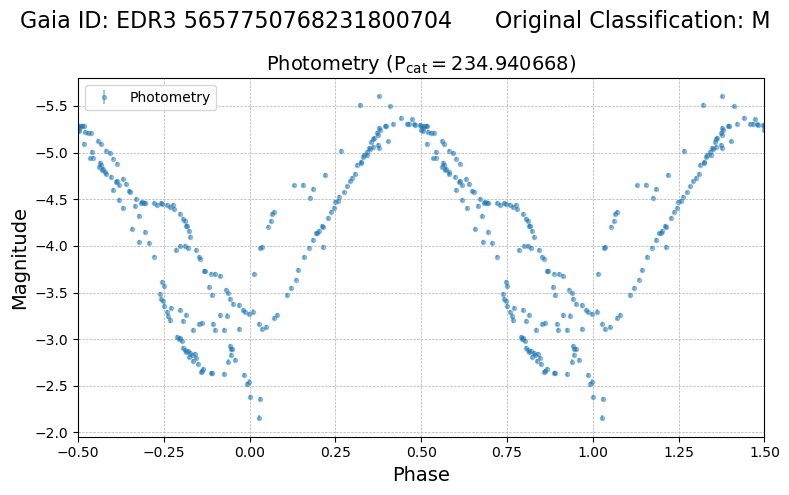

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427278  c5ec90ef-bf91-50b9-b5b8-5729f91ae224    335779   

                        asassn_name other_names    raj2000   dej2000  \
427278  ASASSN-VJ180535.84-344208.9   V0596 Sgr  271.39935 -34.70247   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427278  2.457663e+06  4.039138e+18  J180535.83-344209.1    27765568.0   

                  edr3_source_id galex_id         tic_id  
427278  EDR3 4039137809535460480      NaN  TIC 194790249   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427278       2.13  145.608931            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427278      14.44        12.711544           0.007386         14.632995   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

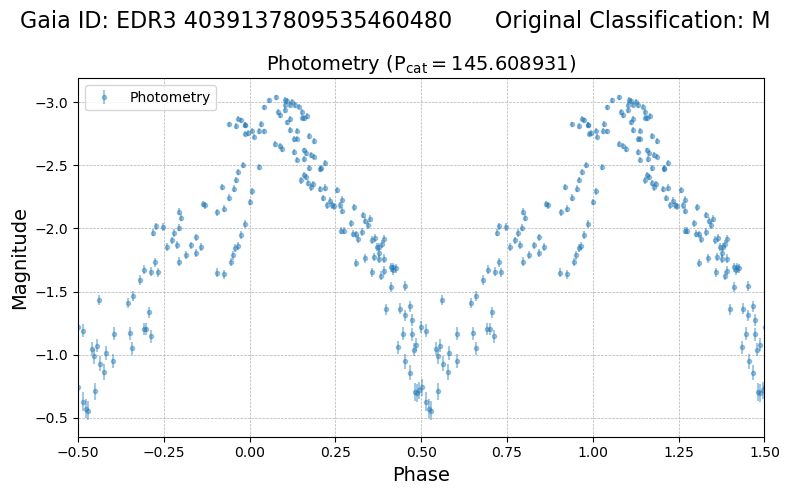

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
101031  91219e86-5b38-5ec2-932c-a4eaac6f9dfe    113049   

                        asassn_name          other_names    raj2000   dej2000  \
101031  ASASSN-VJ190019.92-673906.0  ASAS J190019-6739.1  285.08298 -67.65168   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
101031  2.458011e+06  6.433833e+18  J190019.81-673905.8    57574414.0   

                  edr3_source_id galex_id         tic_id  
101031  EDR3 6433832735641699328      NaN  TIC 382072481   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
101031       2.07  132.468363            0.29       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
101031      13.36        12.940004           0.018336         14.227504   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

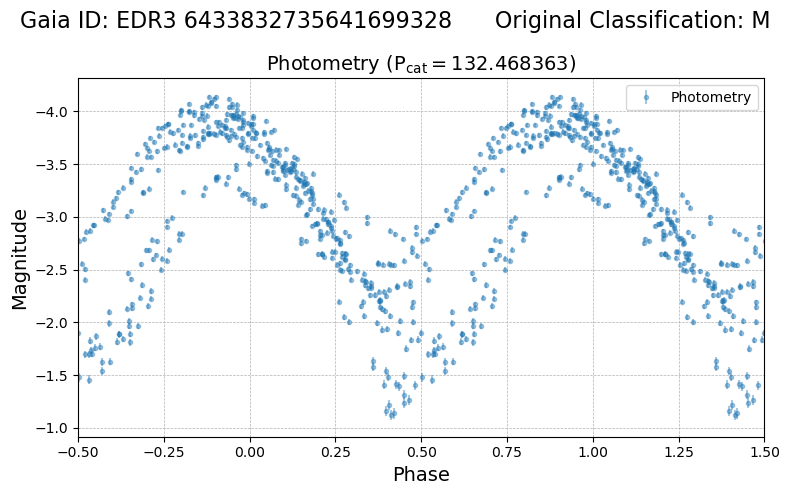

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290839  205ffbc1-2e5b-5421-a6ae-88cd70c1fdd1    403115   

                        asassn_name other_names    raj2000   dej2000  \
290839  ASASSN-VJ165832.55-331000.6   V1183 Sco  254.63564 -33.16683   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290839  2.457907e+06  6.026499e+18  J165832.78-330959.8    53218643.0   

                  edr3_source_id galex_id        tic_id  
290839  EDR3 6026498827665007616      NaN  TIC 36766923   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
290839       3.83  247.01154            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290839       13.8        19.064672           0.009045         18.651167   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290839

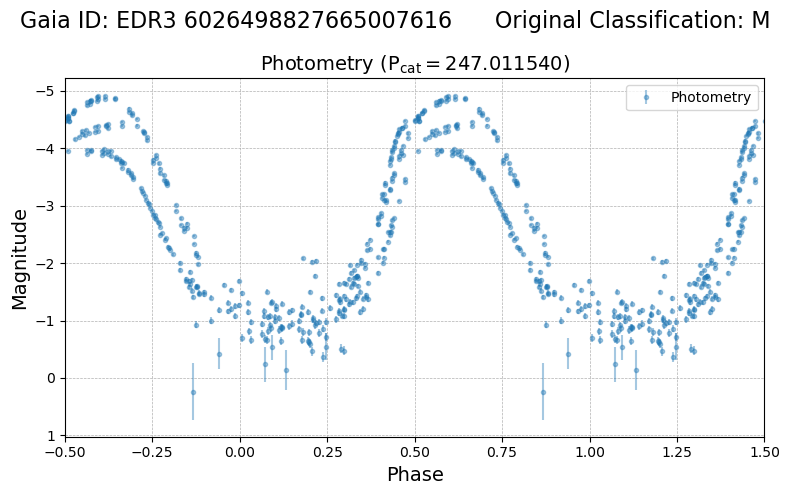

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428346  4715afcb-b980-579e-8c19-0bd3bf3680b2    228748   

                        asassn_name other_names    raj2000   dej2000  \
428346  ASASSN-VJ181801.43-263246.2   NSV 10500  274.50597 -26.54616   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428346  2.458192e+06  4.052599e+18  J181801.32-263245.3           NaN   

                  edr3_source_id galex_id         tic_id  
428346  EDR3 4052598722389690112      NaN  TIC 127486548   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
428346       1.55  255.321234            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428346      14.32        18.609662           0.012972         18.390549   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42

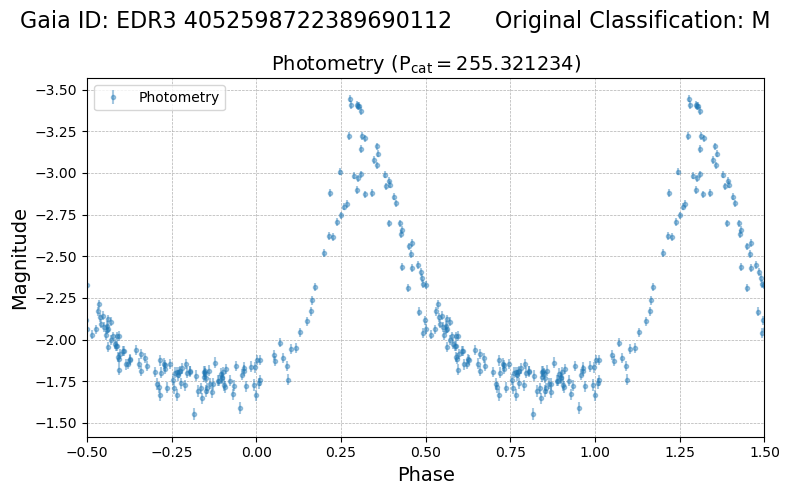

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
183413  6a036d57-f497-5aa7-8ab0-fbffa041def2    418842   

                        asassn_name other_names    raj2000   dej2000  \
183413  ASASSN-VJ154802.79-635755.6      QV TrA  237.01161 -63.96544   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
183413  2.458139e+06  5.826072e+18  J154802.77-635755.2           NaN   

                  edr3_source_id galex_id         tic_id  
183413  EDR3 5826072048424726784      NaN  TIC 424771632   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
183413       2.47  248.351357            0.21       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
183413      15.08        12.840572           0.004418         14.769527   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
183

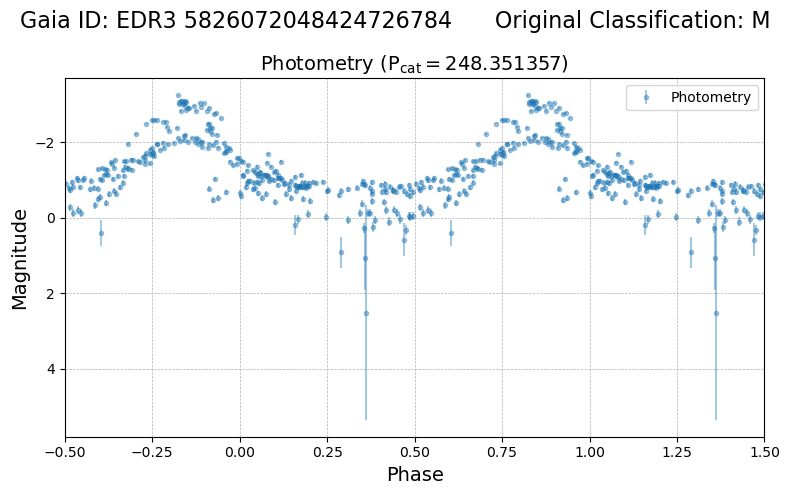

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
463910  8d7a9905-54f0-53e8-a697-0a3b55cc6ad0    117772   

                        asassn_name other_names    raj2000   dej2000  \
463910  ASASSN-VJ155647.05-304153.0      GR Lup  239.19603 -30.69806   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
463910  2.457632e+06  6.039807e+18  J155647.10-304152.5    53517490.0   

                  edr3_source_id galex_id         tic_id  
463910  EDR3 6039807140210314880      NaN  TIC 318336974   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
463910        3.2  105.119075            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
463910       13.2        11.285525            0.00889         12.684543   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
46

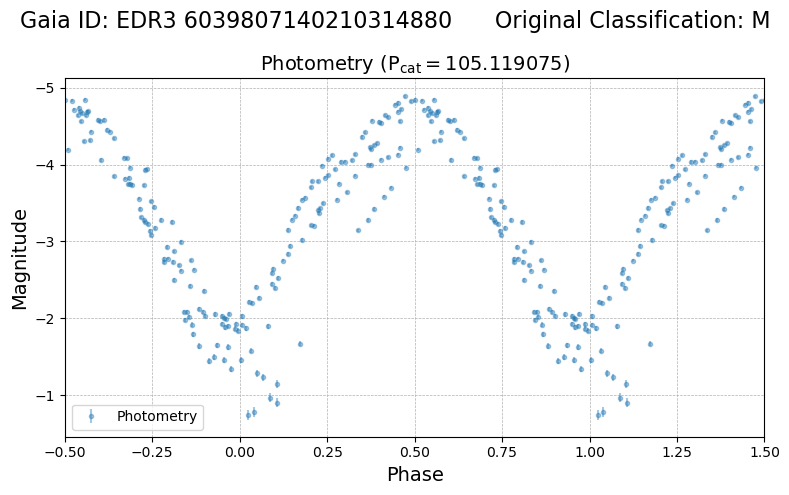

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428556  9f966a1f-38ab-5f48-8b18-16ba6226abe1    277517   

                        asassn_name          other_names    raj2000   dej2000  \
428556  ASASSN-VJ122217.82-544838.4  ASAS J122218-5448.6  185.57427 -54.81066   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428556  2.457868e+06  6.075988e+18  J122217.76-544838.2    54303437.0   

                  edr3_source_id galex_id        tic_id  
428556  EDR3 6075988292622899584      NaN  TIC 67874343   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
428556       1.52  121.68706            0.32       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428556      12.06        11.306612           0.015392         12.563672   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

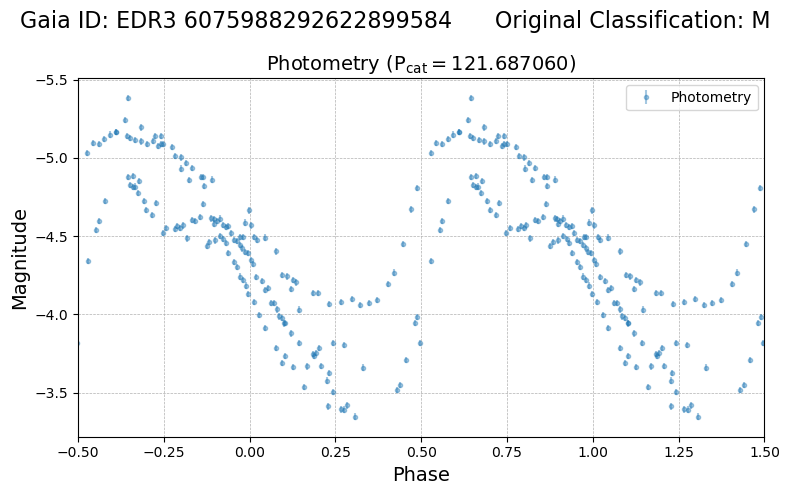

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
568792  4d20cab4-9271-5ab3-b3ff-4034eaa07fa8    196277   

                        asassn_name other_names    raj2000   dej2000  \
568792  ASASSN-VJ115816.83-253753.5      IR Hya  179.57014 -25.63152   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
568792  2.457775e+06  3.487873e+18  J115816.91-253753.7    26083305.0   

                  edr3_source_id galex_id         tic_id  
568792  EDR3 3487873435627437824      NaN  TIC 286166277   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
568792        3.6  189.578201            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
568792      12.49        11.262414           0.012024         13.495553   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
56

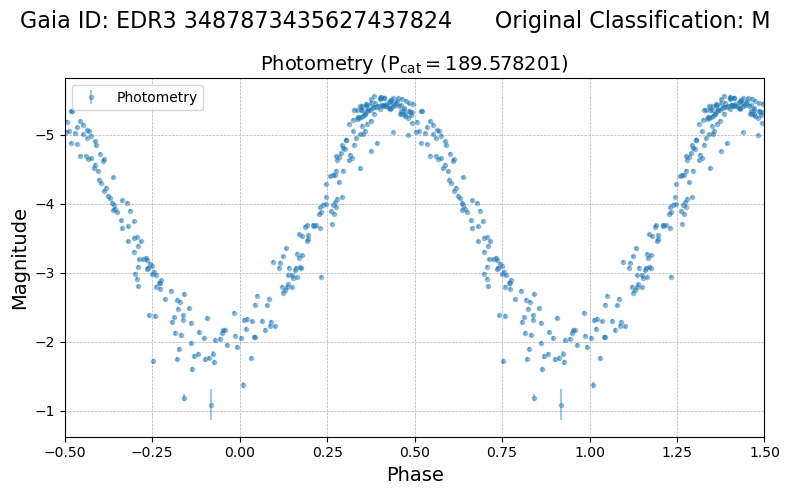

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
428030  f3ae71e3-f477-56cd-929f-2a8eb4b3d0e5    311733   

                        asassn_name other_names   raj2000   dej2000  \
428030  ASASSN-VJ012837.10+621637.5   V0390 Cas  22.15457  62.27707   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
428030  2.457768e+06  5.108622e+17  J012837.13+621637.8     4372699.0   

                 edr3_source_id galex_id         tic_id  
428030  EDR3 510862243629995904      NaN  TIC 422534270   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
428030       2.28  351.35466            0.03       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
428030      12.59        10.793159            0.01254         13.146298   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
428030  

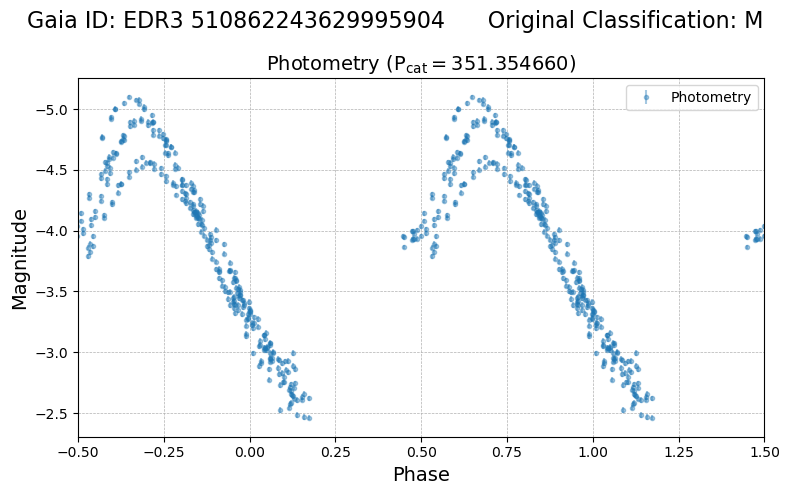

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
283993  119e3c3f-e1c7-5e5b-a689-14a86c164b40    400373   

                        asassn_name other_names    raj2000   dej2000  \
283993  ASASSN-VJ182956.88-285728.5   V1616 Sgr  277.48699 -28.95792   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
283993  2.457904e+06  4.048478e+18  J182956.73-285728.5           NaN   

                  edr3_source_id galex_id         tic_id  
283993  EDR3 4048477512275349888      NaN  TIC 324552663   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
283993       3.27  207.936644            0.19       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
283993       15.5        18.740539           0.004998         18.899775   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
283

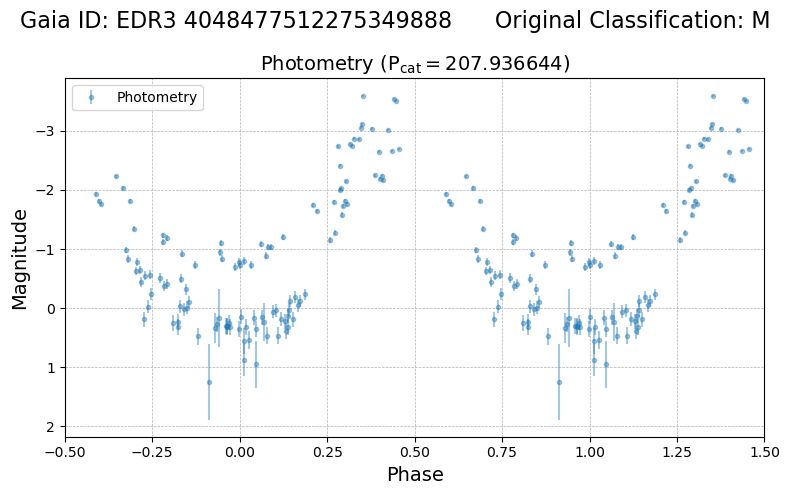

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
42796  777f81c7-bf78-5ebb-b1fb-491acae59380    463877   

                       asassn_name other_names   raj2000   dej2000  \
42796  ASASSN-VJ062340.63-171620.1         NaN  95.91934 -17.27224   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
42796  2.457429e+06  2.943642e+18  J062340.62-171620.2           NaN   

                 edr3_source_id galex_id        tic_id  
42796  EDR3 2943641976180148480      NaN  TIC 34727520   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
42796       2.92   512.0            0.39       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
42796      15.44        12.629984           0.010871         15.334607   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
42796            0.052938   

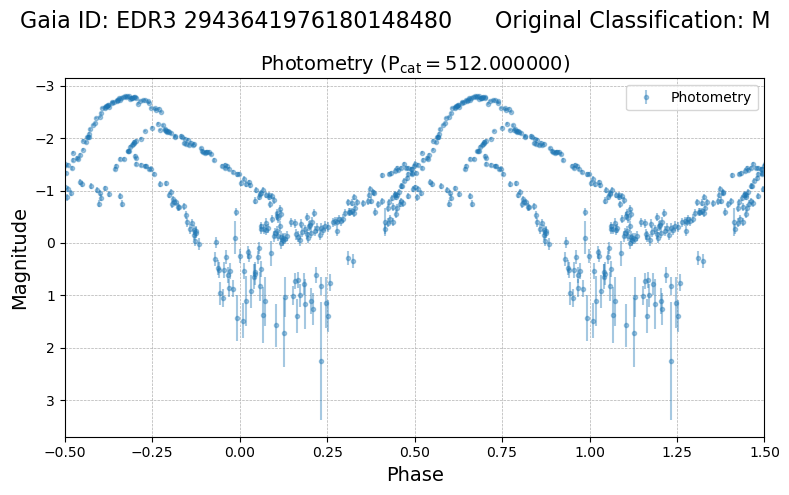

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
211461  2d4d0e80-eb23-52c5-97af-2a86b4898f0f    361558   

                        asassn_name other_names    raj2000  dej2000  \
211461  ASASSN-VJ083507.86-094400.9   NSV 17926  128.78274 -9.73357   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
211461  2.458013e+06  5.751830e+18  J083507.94-094400.6    47042884.0   

                  edr3_source_id galex_id        tic_id  
211461  EDR3 5751829926609287168      NaN  TIC 51327891   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
211461       2.64  279.064713            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
211461      12.69        11.709481           0.020418         13.231972   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
211461

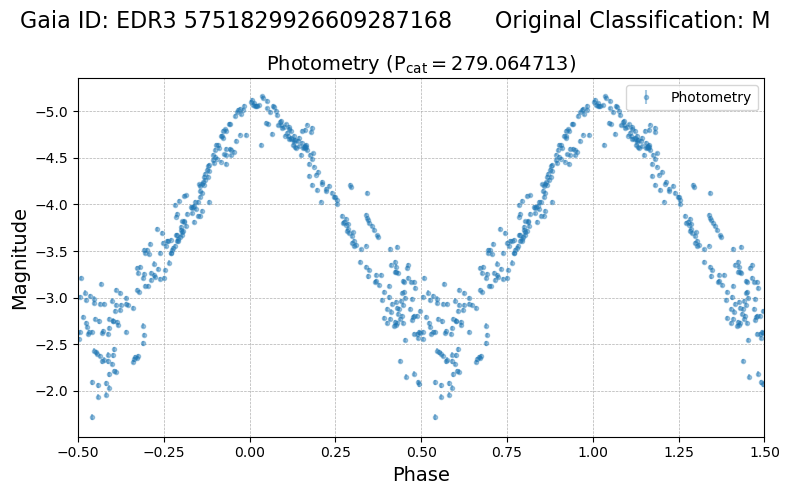

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
448691  8a815f10-c48c-5fd0-9ec3-ad81d4e40a52     60857   

                        asassn_name          other_names    raj2000   dej2000  \
448691  ASASSN-VJ073325.16-633605.6  ASAS J073325-6336.1  113.35484 -63.60155   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
448691  2.456907e+06  5.288572e+18  J073325.06-633605.7    39555093.0   

                  edr3_source_id galex_id         tic_id  
448691  EDR3 5288571906503118592      NaN  TIC 349788901   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
448691       2.74   141.2            0.31       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
448691      14.69        13.298575           0.009219         14.448854   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

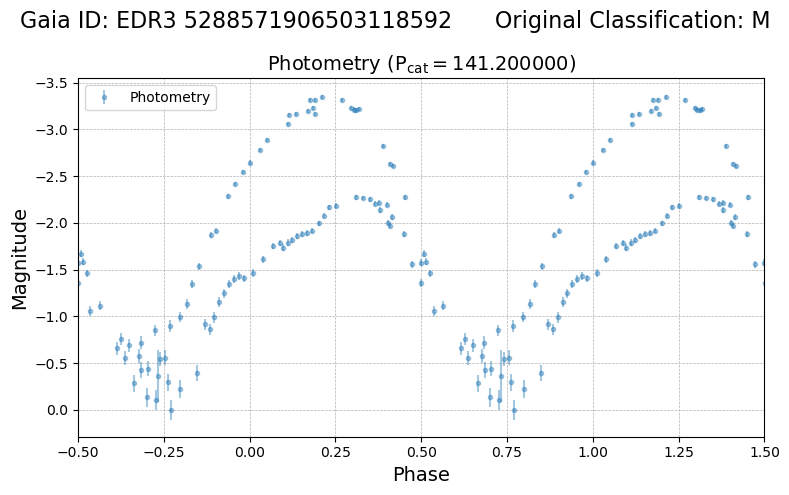

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
465551  d43b2669-c9af-533b-a467-0cd90b3291ac    175491   

                        asassn_name other_names    raj2000   dej2000  \
465551  ASASSN-VJ101800.23-325408.6      BE Ant  154.50095 -32.90239   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
465551  2.458227e+06  5.459111e+18  J101800.26-325408.3    42672943.0   

                  edr3_source_id galex_id        tic_id  
465551  EDR3 5459110901615135104      NaN  TIC 71298811   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
465551       2.17  203.37252             0.1       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
465551      12.41        11.486521           0.014396         12.779192   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
465551

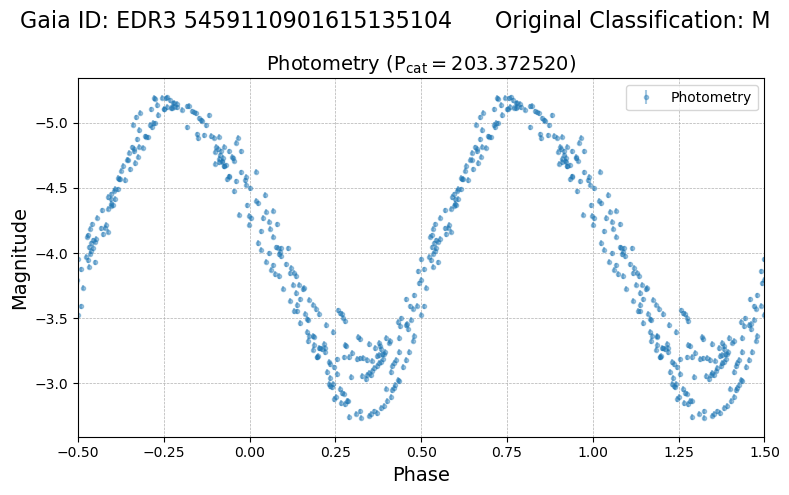

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427713  576876ba-b769-5ecb-8a7a-63ef56781096    423281   

                        asassn_name          other_names    raj2000   dej2000  \
427713  ASASSN-VJ160746.24-561419.4  GDS_J1607462-561419  241.94265 -56.23871   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427713  2.457844e+06  5.836258e+18  J160746.21-561419.4           NaN   

                  edr3_source_id galex_id         tic_id  
427713  EDR3 5836257786780887808      NaN  TIC 430463842   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427713       2.45  234.697295            0.76       0.64 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427713      15.97        13.517849           0.007024          16.59129   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

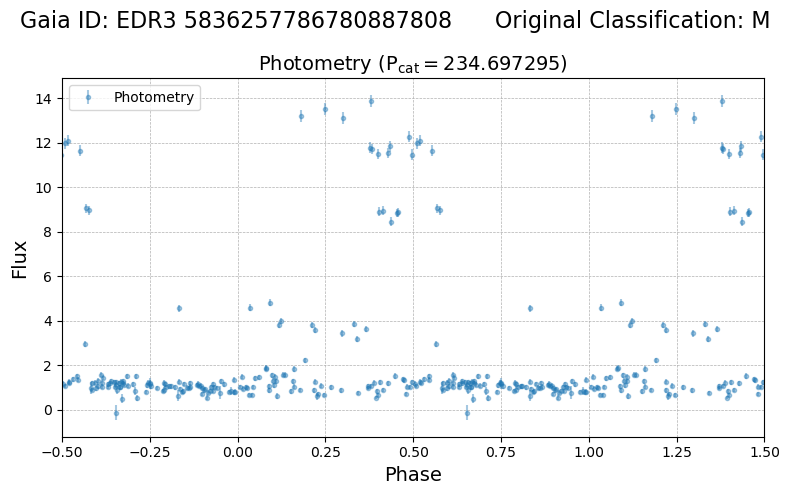

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
182597  aab08389-2507-5d9e-b6aa-a2f1d59c5203    122677   

                        asassn_name   other_names   raj2000   dej2000  \
182597  ASASSN-VJ053210.10+571532.1  NSVS 2259045  83.04207  57.25891   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
182597  2.457619e+06  2.694131e+17  J053210.08+571532.2     1821647.0   

                 edr3_source_id galex_id         tic_id  
182597  EDR3 269413097932542720      NaN  TIC 321436274   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
182597        2.3  237.330681            0.19       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
182597       15.5        13.136883            0.00813         15.051709   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
182

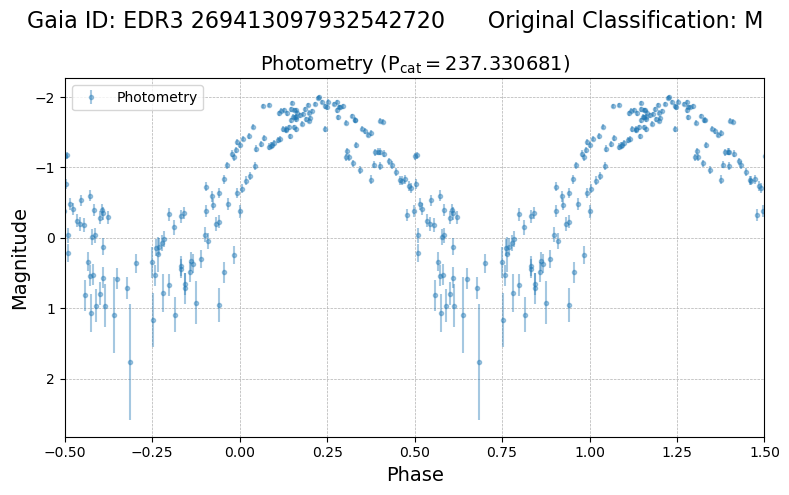

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426828  a2bb065b-0177-58b9-8cd5-81305078a7fb    386427   

                        asassn_name          other_names    raj2000   dej2000  \
426828  ASASSN-VJ084539.87-464636.2  GDS_J0845398-464636  131.41611 -46.77673   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426828  2.457453e+06  5.329769e+18  J084539.88-464636.4           NaN   

                  edr3_source_id galex_id         tic_id  
426828  EDR3 5329769095384014592      NaN  TIC 430658239   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426828       2.08  253.226979            0.62       0.73 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426828      16.84        14.043239            0.00695         17.983631   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

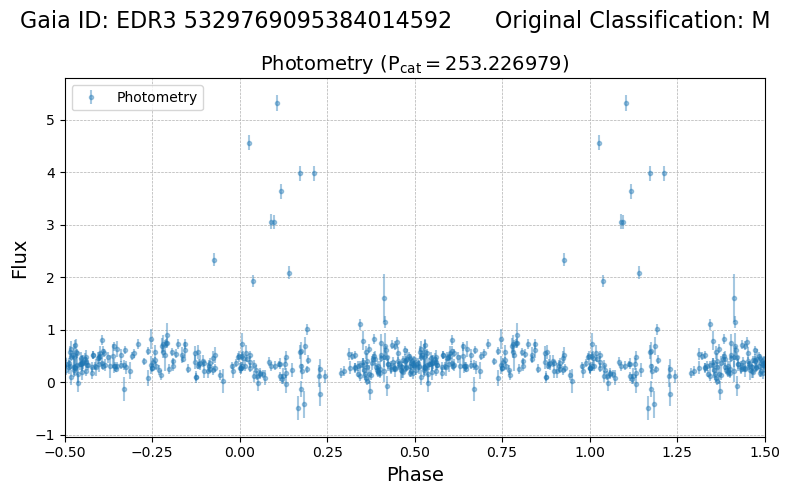

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
174038  aada2b25-3731-5291-894b-6dbb967e4caf    345109   

                        asassn_name other_names    raj2000  dej2000  \
174038  ASASSN-VJ161116.46-544633.6   V0506 Nor  242.81858  -54.776   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
174038  2.457627e+06  5.932527e+18  J161116.51-544633.9           NaN   

                  edr3_source_id galex_id         tic_id  
174038  EDR3 5932526729961235840      NaN  TIC 207157204   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
174038       2.24  187.462975            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
174038      12.15        10.985597           0.012033         13.480938   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
1740

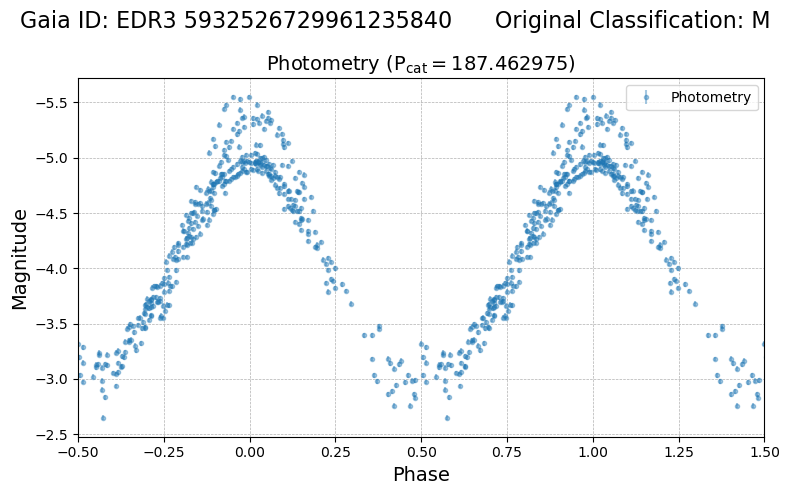

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426732  758580b2-fef3-58bf-9ceb-16e79f96ec09    166549   

                        asassn_name other_names    raj2000  dej2000  \
426732  ASASSN-VJ080630.14-042622.2   V0835 Mon  121.62558 -4.43951   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426732  2.457016e+06  3.067928e+18  J080630.12-042622.3    20639138.0   

                  edr3_source_id                galex_id        tic_id  
426732  EDR3 3067928026101727744  GALEX J080630.1-042623  TIC 88575161   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426732       2.15  235.885239            0.24       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426732      12.62        10.871325           0.011067         13.038066   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

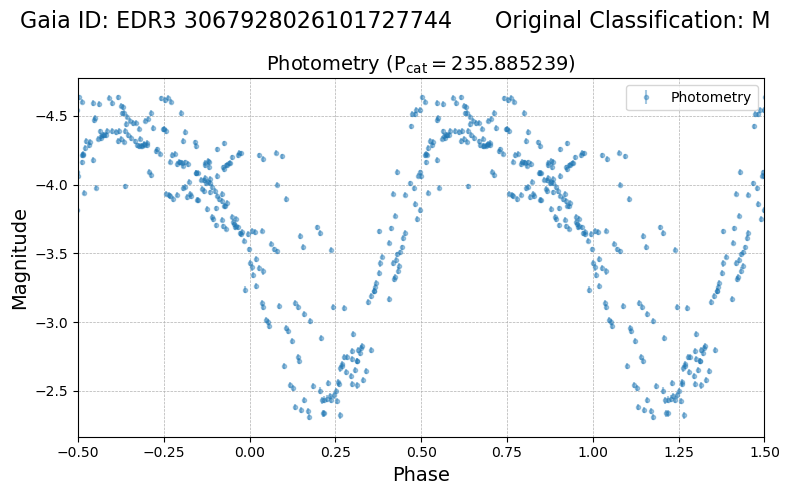

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
572973  31dfbd76-e1e9-5325-ac7a-8025ac829947    189000   

                        asassn_name other_names    raj2000   dej2000  \
572973  ASASSN-VJ225418.73-342326.4      ST PsA  343.57804 -34.39067   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
572973  2.456793e+06  6.602492e+18  J225418.71-342326.1    58278258.0   

                  edr3_source_id                galex_id         tic_id  
572973  EDR3 6602492046903597056  GALEX J225418.6-342325  TIC 206667547   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
572973       3.73  178.547503            0.03       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
572973      11.47        10.124813           0.030533         11.799941   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

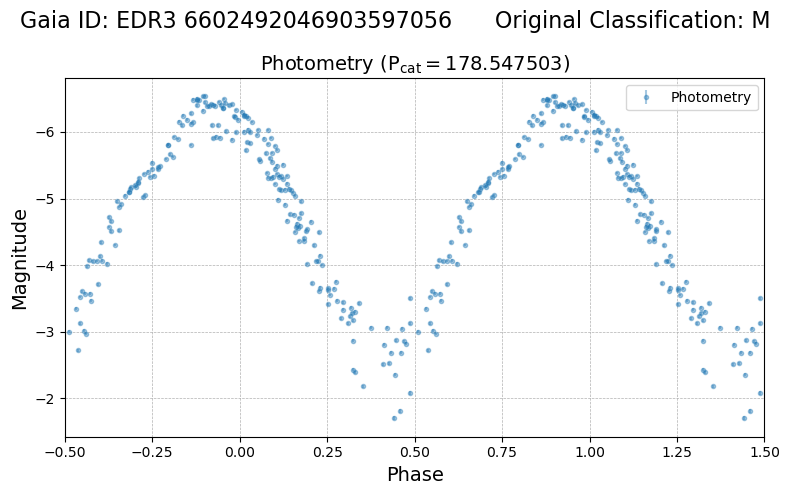

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
520194  818e4883-aa92-589b-9858-c8d940929bf6  AP11057844   

                        asassn_name other_names   raj2000   dej2000  \
520194  ASASSN-VJ204119.01+344452.7   V2428Cyg*  310.3292  34.74798   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
520194  2.457550e+06  1.870195e+18  J204119.01+344452.2    11057844.0   

                  edr3_source_id galex_id        tic_id  
520194  EDR3 1870194997404105856      NaN  TIC 99889477   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
520194       2.22  536.586115            0.42        0.8 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520194       13.9        12.569166           0.013525         14.186349   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
52

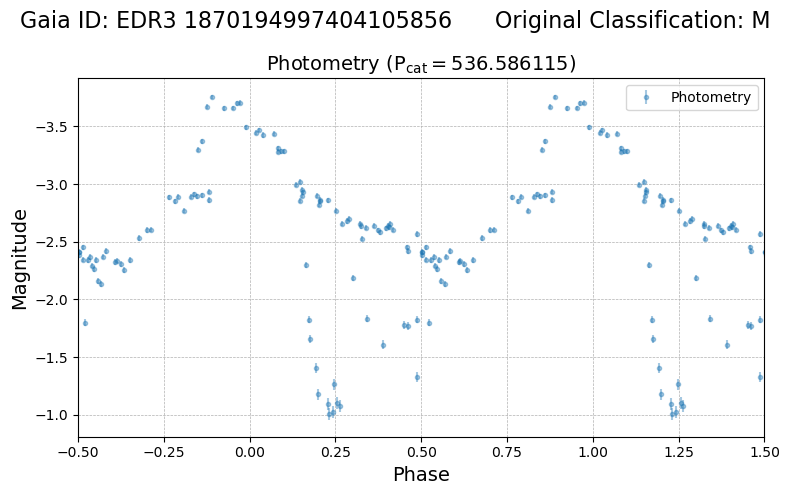

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
412496  188be556-d4fa-5a42-8d98-cb83e52cee19    193319   

                        asassn_name other_names    raj2000   dej2000  \
412496  ASASSN-VJ192314.10+242739.9   V0335 Vul  290.80873  24.46109   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
412496  2.457133e+06  2.022999e+18  J192314.13+242739.6    13636741.0   

                  edr3_source_id galex_id        tic_id  
412496  EDR3 2022999316661190272      NaN  TIC 90623003   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
412496        1.9  343.337477            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
412496      12.47        11.064461           0.010294         13.191868   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4124

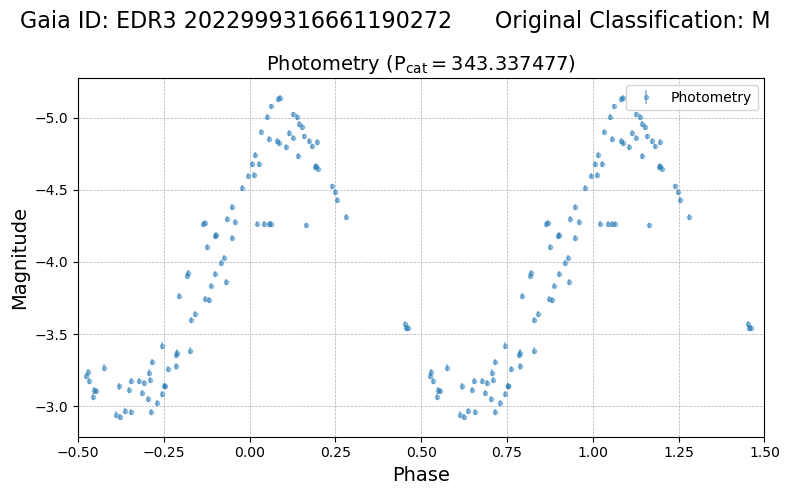

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426900  17efe9e1-3b20-5545-aff8-1c4907f90ad9    424020   

                        asassn_name other_names    raj2000   dej2000  \
426900  ASASSN-VJ172951.02-515345.5   V0984 Ara  262.46258 -51.89596   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426900  2.457646e+06  5.925112e+18  J172951.11-515345.5    51037767.0   

                  edr3_source_id galex_id         tic_id  
426900  EDR3 5925112310631316224      NaN  TIC 369019914   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude     period  lksl_statistic  rfr_score
426900       3.17  204.91785            0.88        0.5 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426900      12.09           9.9249           0.006518          12.41395   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4269

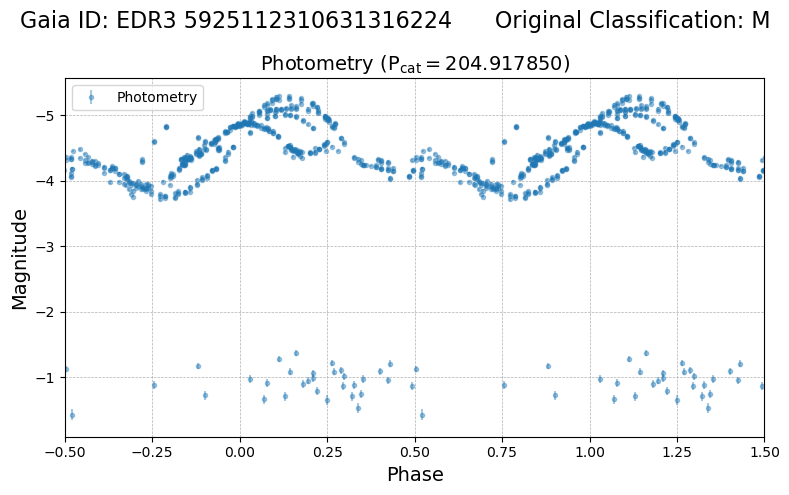

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
680079  8f57ef99-ee28-596a-a0c9-4f01fb857479    565450   

                        asassn_name other_names    raj2000  dej2000  \
680079  ASASSN-VJ174151.90-411625.3         NaN  265.46578 -41.2736   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
680079  2.458196e+06  5.957630e+18  J174151.90-411625.3           NaN   

                  edr3_source_id galex_id         tic_id  
680079  EDR3 5957630053469669376      NaN  TIC 409411366   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
680079       2.36   154.5            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
680079       15.9        14.414733            0.00838         16.220411   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
680079      

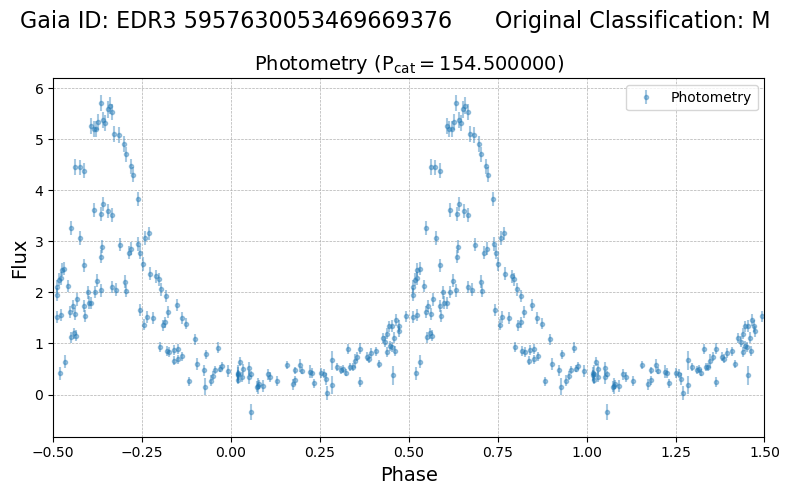

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427164  f526aeae-5085-59b5-be20-de88fdb5a506    194845   

                        asassn_name other_names    raj2000   dej2000  \
427164  ASASSN-VJ064634.62+183653.5      RT Gem  101.64424  18.61485   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427164  2.457389e+06  3.359581e+18  J064634.51+183653.6    24501604.0   

                  edr3_source_id galex_id        tic_id  
427164  EDR3 3359580735274740736      NaN  TIC 56964649   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427164       2.36  357.583859            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427164      11.85         9.509795           0.028481         11.405686   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4271

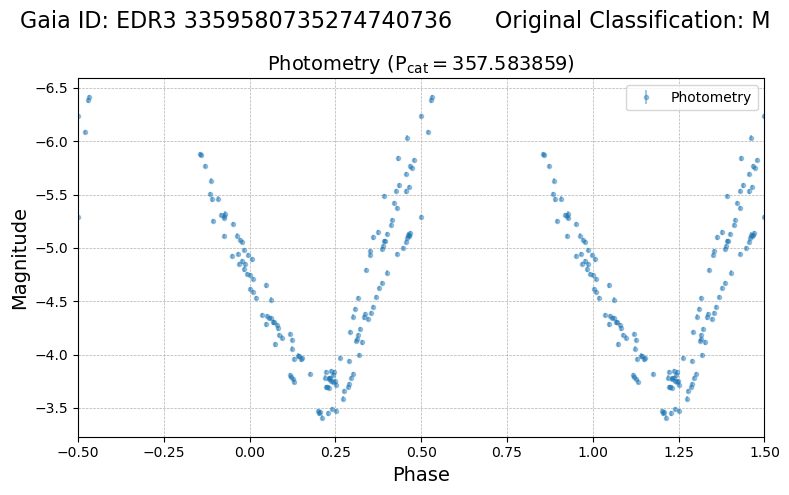

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
11120  9e2e1c64-e4e5-522c-adf1-577409a1ce6c    459170   

                       asassn_name other_names   raj2000  dej2000  \
11120  ASASSN-VJ044524.50-655441.6         NaN  71.35219 -65.9115   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
11120  2.456858e+06  4.662627e+18  J044524.48-655441.5           NaN   

                 edr3_source_id galex_id         tic_id  
11120  EDR3 4662626636967827584      NaN  TIC 294754711   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
11120       2.17   142.0            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
11120      16.35        14.520408           0.016692         15.745924   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
11120            0.061298  

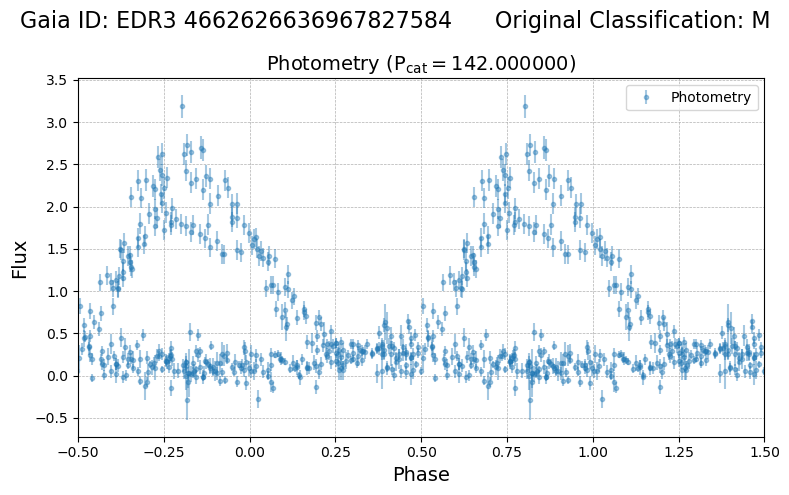

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
425960  56ae375c-f831-535d-906c-522c3aeec111    490338   

                        asassn_name other_names    raj2000   dej2000  \
425960  ASASSN-VJ171746.75-505544.7         NaN  259.44458 -50.92901   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
425960  2.457846e+06  5.926187e+18  J171746.74-505544.7    51073227.0   

                  edr3_source_id galex_id         tic_id  
425960  EDR3 5926187461215223168      NaN  TIC 261450290   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
425960        2.6  170.965024            0.96       0.46 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
425960      14.37        12.820376           0.007126         14.614219   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
425

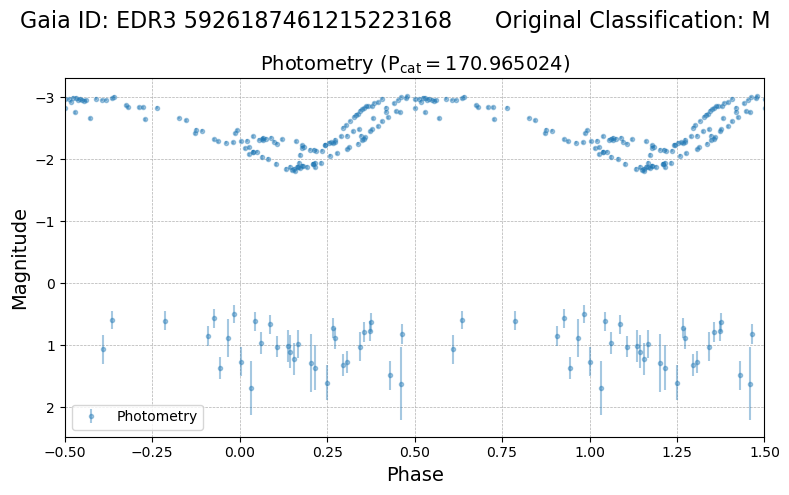

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
5767  6ea37363-62b6-5f62-abaa-a71ada79fd68    483936   

                      asassn_name other_names    raj2000   dej2000  \
5767  ASASSN-VJ165802.00-262442.6         NaN  254.50797 -26.41178   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
5767  2.457652e+06  6.033669e+18  J165801.99-262442.6    53392647.0   

                edr3_source_id galex_id        tic_id  
5767  EDR3 6033669292695022720      NaN  TIC 17716796   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
5767       2.03   132.0            0.48       0.77 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
5767      13.58        12.556345            0.01448         13.745161   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5767            0.069777         11.38

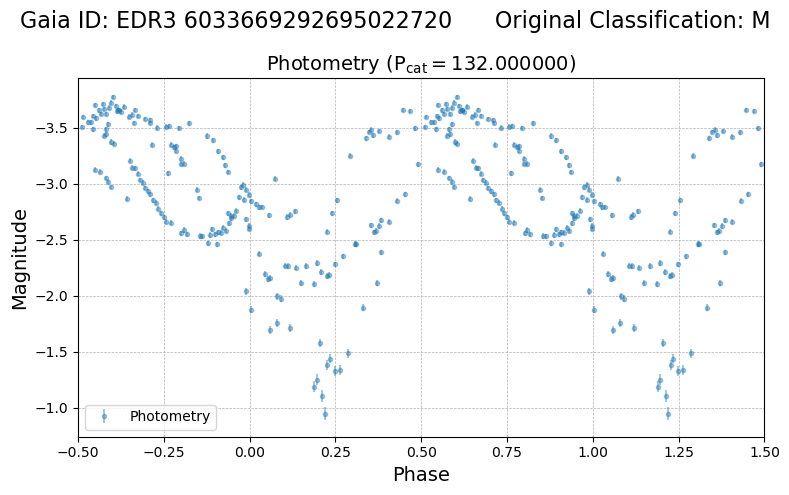

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
3233  15cfd984-e7dd-5ab6-914c-d7f0ed4c056c    473404   

                      asassn_name other_names    raj2000  dej2000  \
3233  ASASSN-VJ170838.05-501221.9         NaN  257.15868 -50.2062   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
3233  2.457604e+06  5.926143e+18  J170838.04-501221.8    51072504.0   

                edr3_source_id galex_id         tic_id  
3233  EDR3 5926143338987617280      NaN  TIC 213121028   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
3233       2.31  230.95            0.99       0.47 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
3233      14.81        12.416416           0.008481         14.948725   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
3233             0.05698         10.99

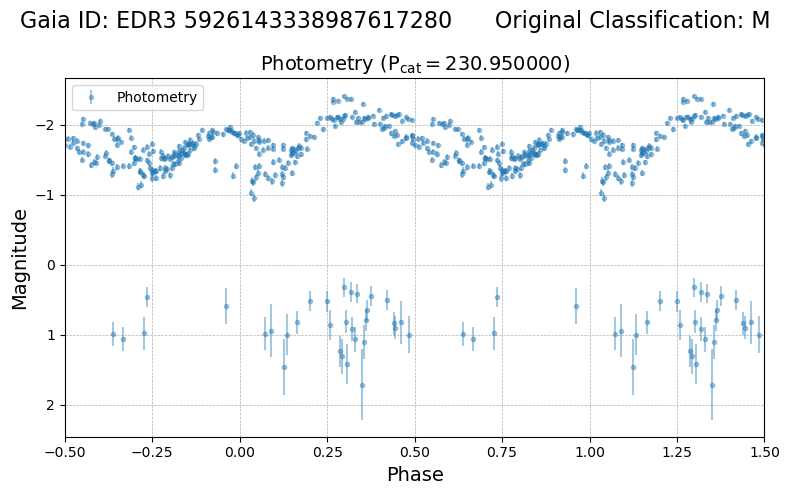

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
433427  e32679e1-5ad0-56d2-b763-d0101f32e32d    492746   

                        asassn_name other_names    raj2000   dej2000  \
433427  ASASSN-VJ173335.19-203738.1         NaN  263.39702 -20.62731   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
433427  2.457974e+06  4.118360e+18  J173335.17-203738.2    29328439.0   

                  edr3_source_id galex_id         tic_id  
433427  EDR3 4118359653941863040      NaN  TIC 231643102   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
433427       2.57   250.0            0.18       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
433427      14.93        19.745602           0.012318           16.6363   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  bp_rp  \
433427       

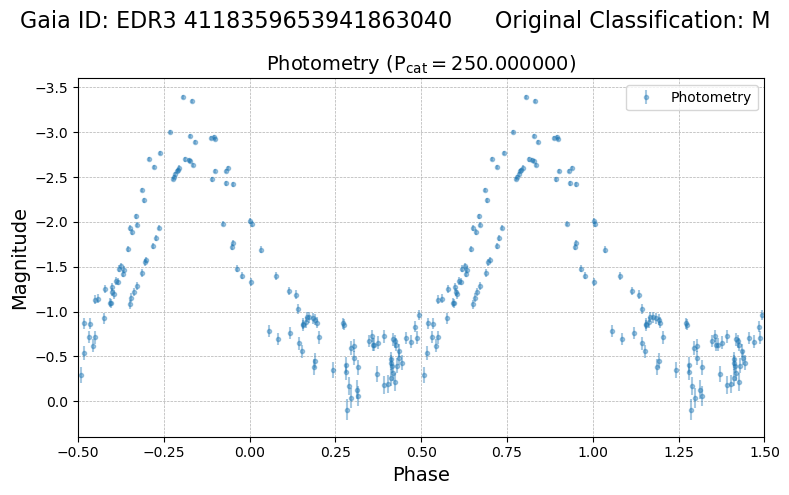

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
426930  3089f5a7-0da5-52e9-a062-e5f5feeebf35    102146   

                        asassn_name          other_names    raj2000   dej2000  \
426930  ASASSN-VJ184554.24-290141.2  ASAS J184554-2901.7  281.47602 -29.02812   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
426930  2.458195e+06  4.071369e+18  J184554.34-290141.1    28228882.0   

                  edr3_source_id galex_id         tic_id  
426930  EDR3 4071369477504114688      NaN  TIC 465962514   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
426930       2.11  129.536075             0.6       0.69 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
426930      12.35        11.832701           0.022118         12.882387   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

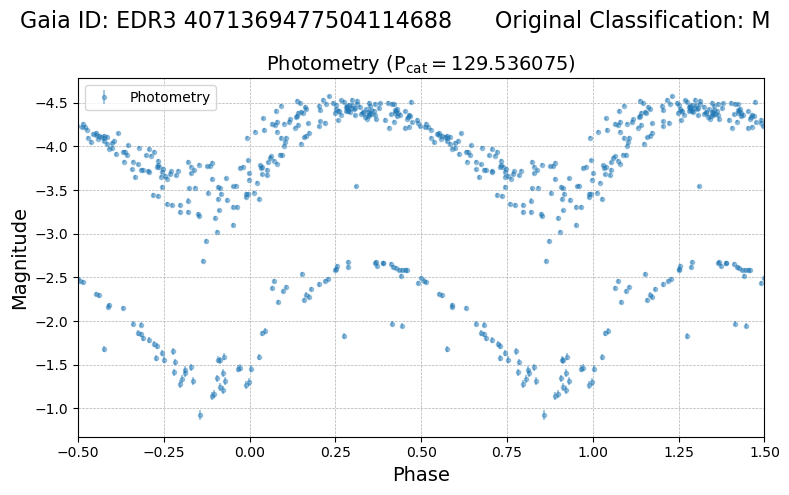

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
576756  e10caf2d-a3a2-5aa0-9204-ceb8435b0755    442577   

                        asassn_name other_names    raj2000   dej2000  \
576756  ASASSN-VJ171455.17-201819.3   V1681 Oph  258.72989 -20.30537   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
576756  2.457582e+06  4.116178e+18  J171455.06-201819.6    29269317.0   

                  edr3_source_id galex_id        tic_id  
576756  EDR3 4116177668716747264      NaN  TIC 78315859   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
576756       2.95  197.360252             0.4       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
576756       14.6        13.954049           0.007258           17.4056   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5767

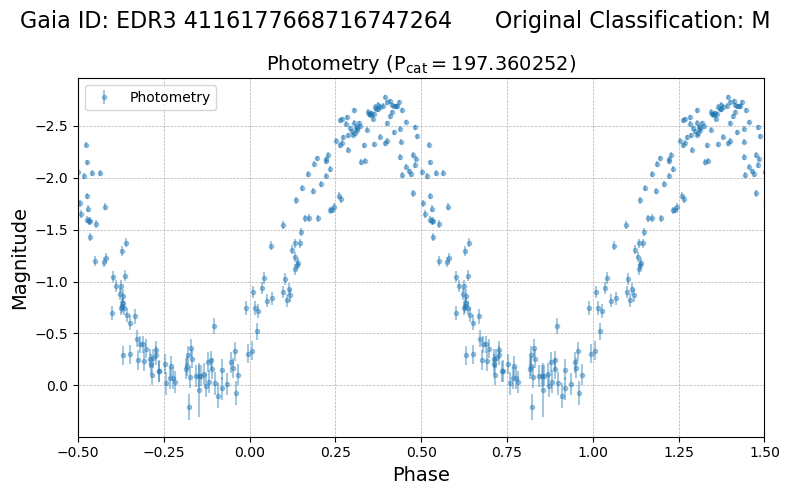

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
425710  77362d06-c870-5bd1-848b-f44da4a5c0dd    491930   

                        asassn_name other_names    raj2000   dej2000  \
425710  ASASSN-VJ174631.69-210156.4         NaN  266.63217 -21.03233   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
425710  2.458309e+06  4.118839e+18  J174631.65-210156.5    29340669.0   

                  edr3_source_id galex_id         tic_id  
425710  EDR3 4118839006630318976      NaN  TIC 240208505   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
425710       2.24  140.151702            0.32       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
425710       16.5        13.761245           0.010362         16.227058   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  bp_rp  \
42571

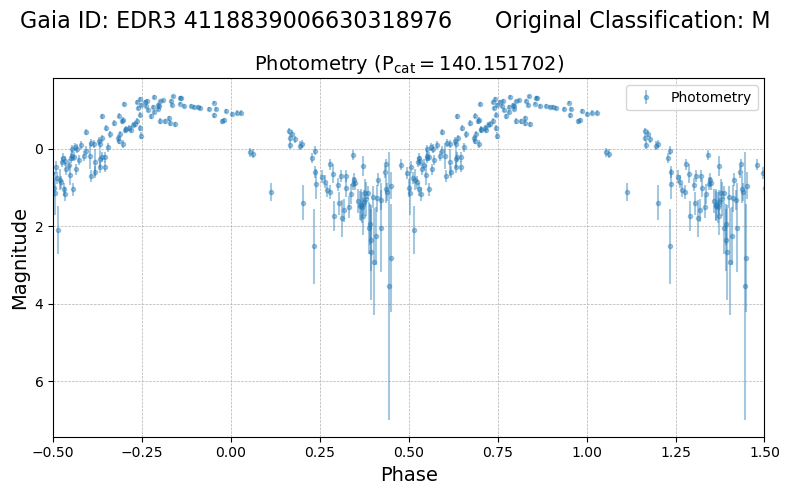

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
553098  2959dac9-1398-58bc-9721-1245e20d895d  AP2026782   

                        asassn_name             other_names   raj2000  \
553098  ASASSN-VJ013148.28+264020.0  ATLASJ022.9511+26.6722  22.95117   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
553098  26.67222  2.458122e+06  2.954585e+17  J013148.27+264019.9   

        apass_dr9_id           edr3_source_id galex_id        tic_id  
553098     2026782.0  EDR3 295458466809028096      NaN  TIC 18225587   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
553098       2.87  143.521295            0.21        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553098      14.12        12.639263           0.014268         13.923989   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

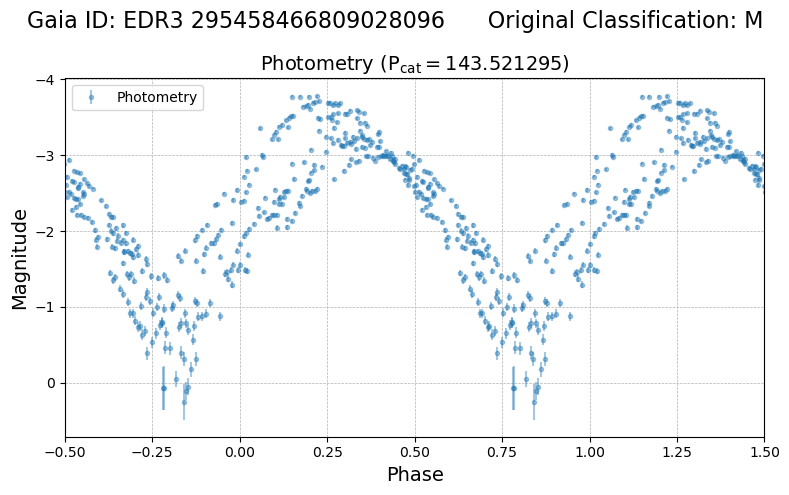

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
8809  2f64a040-85f2-547e-9f41-d83d6e44b74c    508063   

                      asassn_name other_names   raj2000   dej2000  \
8809  ASASSN-VJ174147.80-350753.1         NaN  265.4488 -35.13148   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
8809  2.458312e+06  4.041351e+18  J174147.80-350753.1           NaN   

                edr3_source_id galex_id         tic_id  
8809  EDR3 4041351023360704896      NaN  TIC 193226295   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
8809       2.27   207.0            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
8809      15.44         13.11243           0.006867         15.568699   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
8809            0.065366         11.72

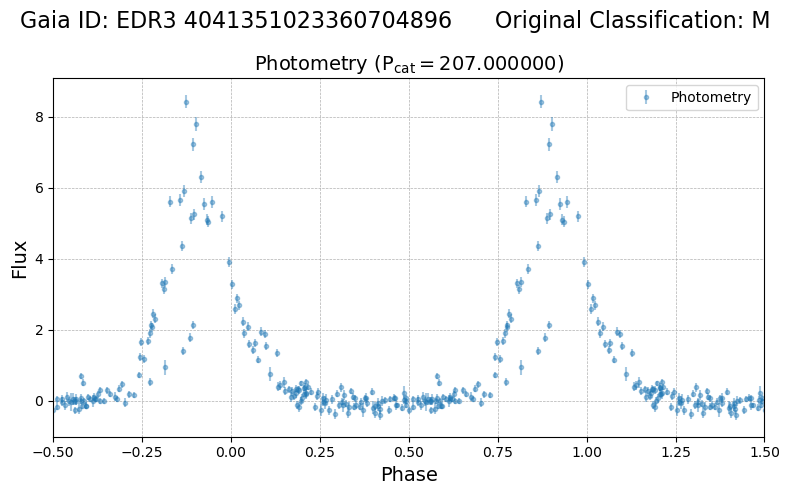

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
447092  31ca2efe-24f5-5e9d-b85b-09df1540a994    285732   

                        asassn_name other_names    raj2000   dej2000  \
447092  ASASSN-VJ181633.30-394933.3   V0386 CrA  274.13877 -39.82592   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
447092  2.457940e+06  6.727273e+18  J181633.22-394933.1    59555248.0   

                  edr3_source_id galex_id        tic_id  
447092  EDR3 6727273383864385664      NaN  TIC 57213150   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
447092       1.91  108.642326             0.7        0.6 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
447092       13.5        12.094524           0.012373         13.697689   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4470

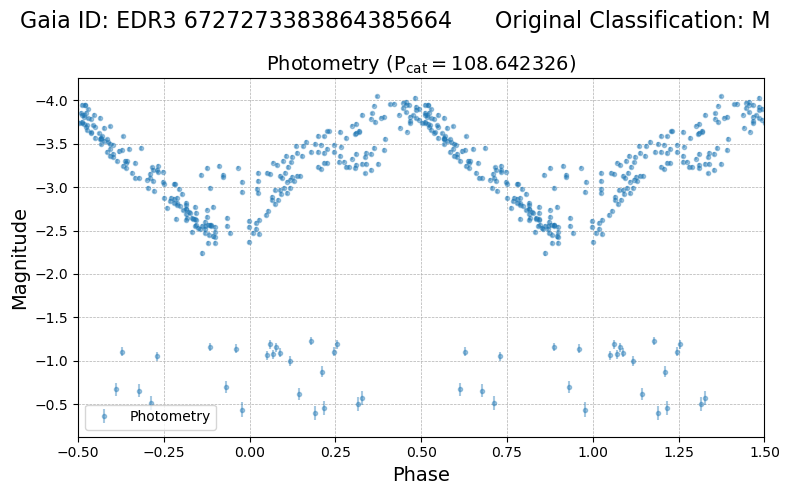

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
7010  5640e862-5f02-5b5d-b551-3bd657845e98    478152   

                      asassn_name other_names    raj2000   dej2000  \
7010  ASASSN-VJ180652.28-335804.1         NaN  271.71782 -33.96773   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
7010  2.457883e+06  4.039552e+18  J180652.28-335804.1           NaN   

                edr3_source_id galex_id        tic_id  
7010  EDR3 4039551947463003392      NaN  TIC 55024041   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude  period  lksl_statistic  rfr_score
7010       2.16   140.0            0.47       0.77 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
7010      14.24        13.385968           0.008725         15.344011   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
7010            0.038007         12.05

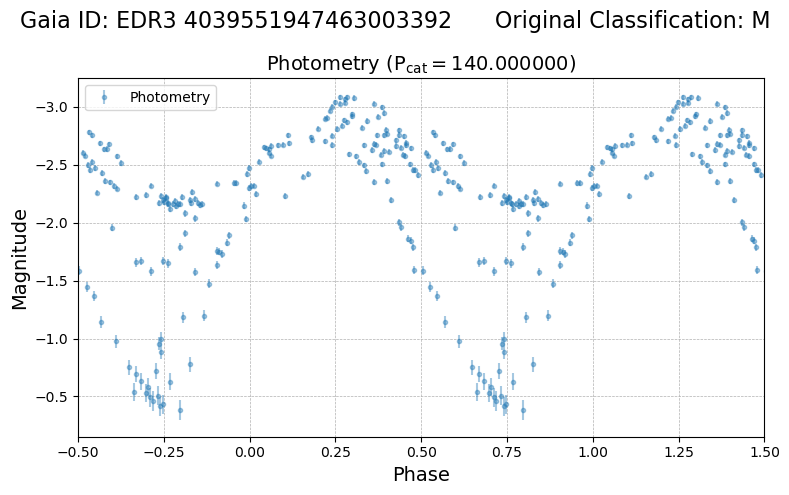

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
233886  ec32d576-5acd-5ba2-9059-efaf5055c062    201219   

                        asassn_name other_names    raj2000  dej2000  \
233886  ASASSN-VJ183821.00-323555.0   V1634 Sgr  279.58751 -32.5986   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
233886  2.456972e+06  6.736606e+18  J183821.31-323553.4    59756309.0   

                  edr3_source_id galex_id         tic_id  
233886  EDR3 6736606077252608000      NaN  TIC 338213146   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
233886       2.83  261.496935            0.18       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
233886      13.14        18.775141           0.014513         19.221455   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
2338

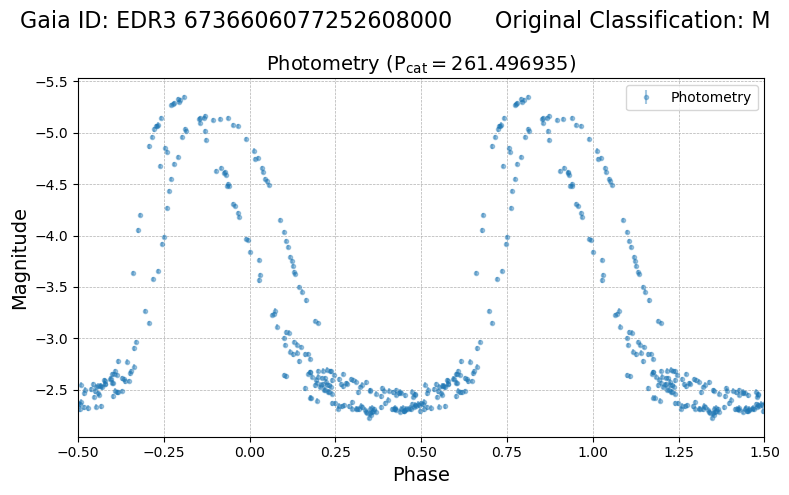

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
35722  b6375dac-0569-596a-b8b5-d886745cdb4b    485882   

                       asassn_name other_names    raj2000   dej2000  \
35722  ASASSN-VJ165544.26-305841.7         NaN  253.93442 -30.97809   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
35722  2.457873e+06  6.027767e+18  J165544.26-305841.6           NaN   

                 edr3_source_id galex_id        tic_id  
35722  EDR3 6027766525811802112      NaN  TIC 34917006   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
35722       2.65   185.0            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
35722      15.56        12.945692           0.014064         14.433374   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
35722            0.030822

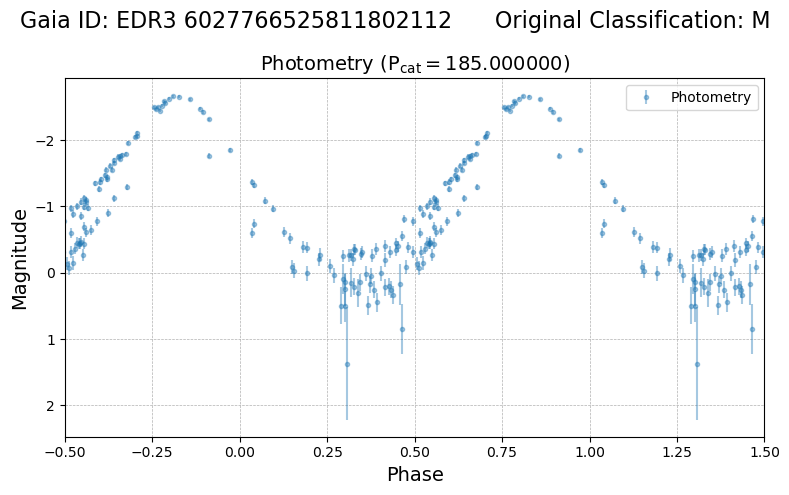

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
427727  791d0e45-2e36-5ca3-b87d-ff73ef02e1fc    205411   

                        asassn_name other_names   raj2000   dej2000  \
427727  ASASSN-VJ005909.08+634850.0   V0884 Cas  14.78782  63.81389   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
427727  2.457904e+06  5.241204e+17  J005909.08+634850.0     4532061.0   

                 edr3_source_id galex_id         tic_id  
427727  EDR3 524120429712680576      NaN  TIC 255976845   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
427727       2.19  480.467047            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
427727      12.21        10.329984           0.019528         12.811681   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
427727

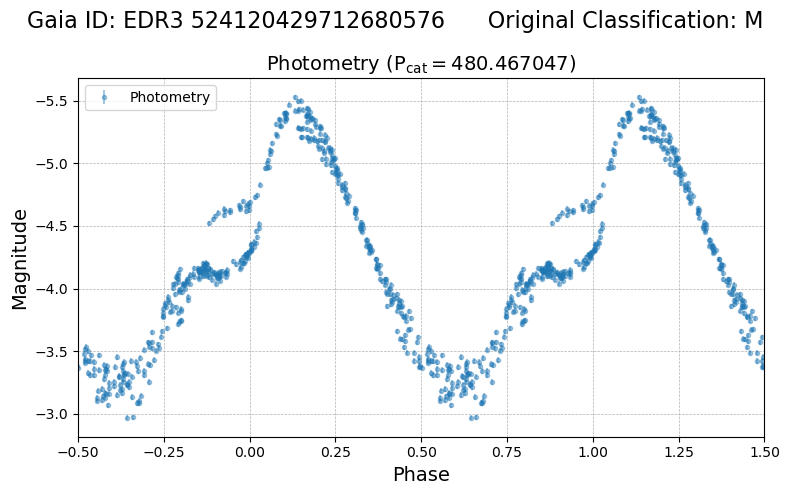

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
290084  da226c2c-8e9d-53b0-aeb9-9ebdcbbb93dd    247559   

                        asassn_name other_names    raj2000   dej2000  \
290084  ASASSN-VJ125144.03-264644.6      EP Hya  192.93345 -26.77905   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
290084  2.457104e+06  3.495819e+18  J125144.07-264644.3    26118524.0   

                  edr3_source_id galex_id       tic_id  
290084  EDR3 3495818953326002304      NaN  TIC 9522039   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
290084       4.29   167.3            0.15       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
290084      11.25         9.059938           0.031689         11.366473   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
290084        

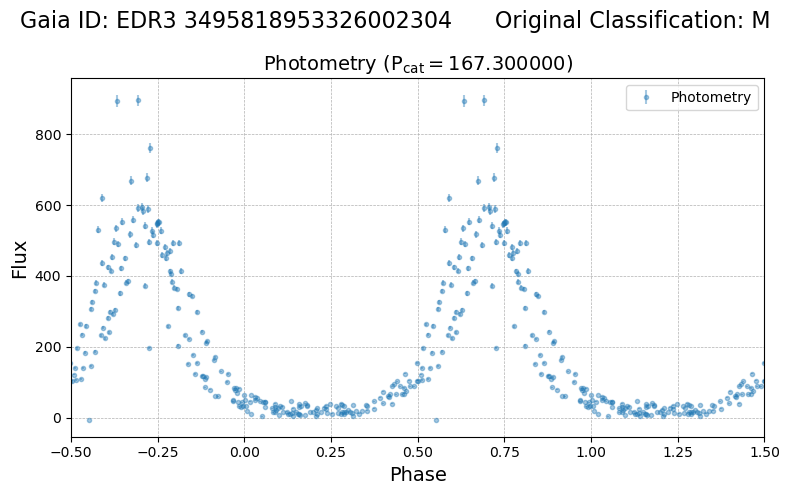

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
227002  df7e0f49-467b-5c33-b333-cb16e1626697    425740   

                        asassn_name other_names    raj2000   dej2000  \
227002  ASASSN-VJ150356.63-641342.9      EU Cir  225.98597 -64.22858   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
227002  2.457870e+06  5.873162e+18  J150356.62-641343.2    49576642.0   

                  edr3_source_id galex_id         tic_id  
227002  EDR3 5873162202967513344      NaN  TIC 454227295   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
227002       2.55  231.575878            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
227002      14.45          10.8101           0.004316         13.437342   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
22

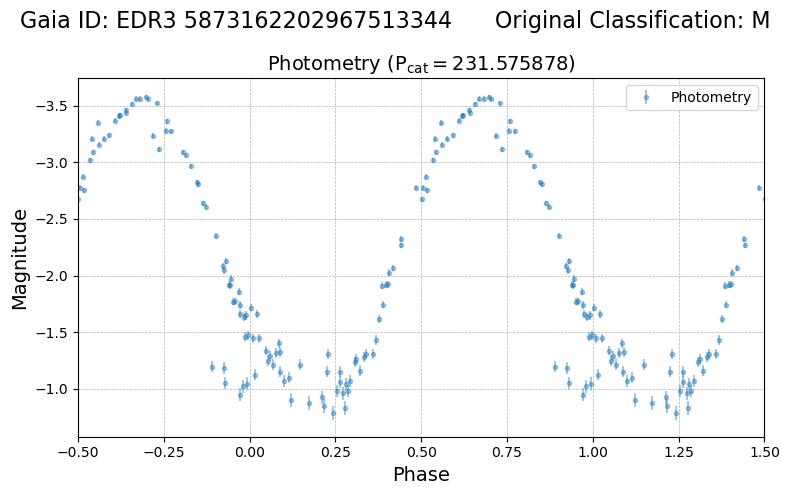

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
202248  083bfa6d-e9b7-5b13-8de6-eaad6867f5eb    391302   

                        asassn_name           other_names   raj2000   dej2000  \
202248  ASASSN-VJ044633.64+495623.7  NSVS J0446335+495623  71.64016  49.93992   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
202248  2.457232e+06  2.593969e+17  J044633.63+495623.9     1724071.0   

                 edr3_source_id galex_id         tic_id  
202248  EDR3 259396924964993536      NaN  TIC 286114049   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
202248        2.4  397.759795            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
202248      13.76        11.660412           0.015794         14.070788   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag

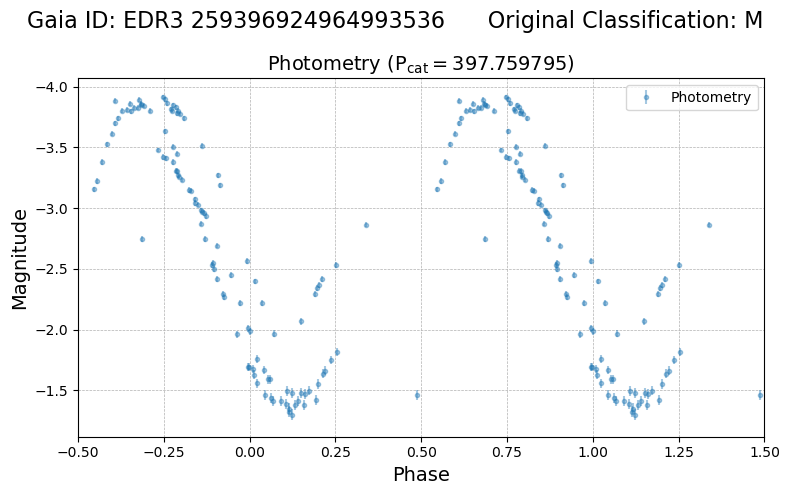

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
435325  a7deb7a4-1337-5810-b5cc-403aa9990be8    422047   

                        asassn_name other_names    raj2000   dej2000  \
435325  ASASSN-VJ174133.43-420248.3      NW Sco  265.38928 -42.04674   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
435325  2.457480e+06  5.957447e+18  J174133.55-420248.3    51882998.0   

                  edr3_source_id galex_id        tic_id  
435325  EDR3 5957447019140141568      NaN  TIC 30884404   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude      period  lksl_statistic  rfr_score
435325       2.28  130.129072            0.51       0.74 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
435325      15.18        13.158381            0.00749         14.832829   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4353

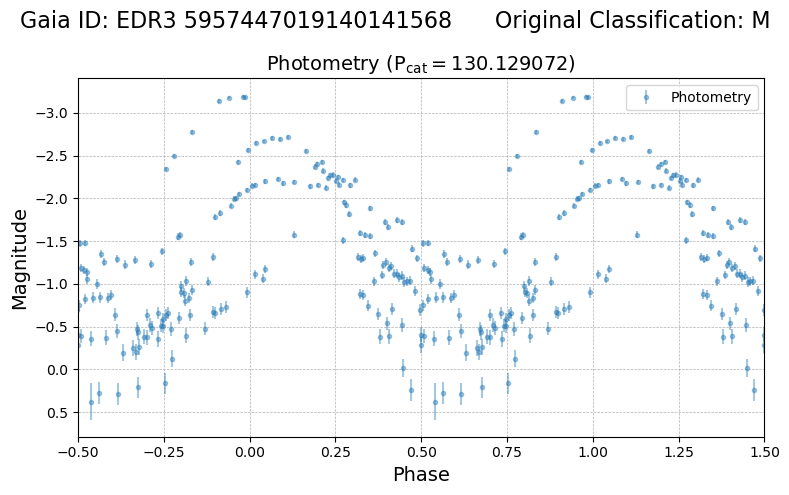

In [120]:
for name in eb_meta_out_names:
    if name not in eb_out_names:
        plot_photometry_flux(name, meta_warning=False)